# 你的第一个神经网络

在此项目中，你将构建你的第一个神经网络，并用该网络预测每日自行车租客人数。我们提供了一些代码，但是需要你来实现神经网络（大部分内容）。提交此项目后，欢迎进一步探索该数据和模型。

In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

## 加载和准备数据

构建神经网络的关键一步是正确地准备数据。不同尺度级别的变量使网络难以高效地掌握正确的权重。我们在下方已经提供了加载和准备数据的代码。你很快将进一步学习这些代码！

In [2]:
data_path = 'Bike-Sharing-Dataset/hour.csv'

rides = pd.read_csv(data_path)

In [3]:
rides.head()

,instant,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
0,1,2011-01-01,1,0,1,0,0,6,0,1,0.24,0.2879,0.81,0.0,3,13,16
1,2,2011-01-01,1,0,1,1,0,6,0,1,0.22,0.2727,0.80,0.0,8,32,40
2,3,2011-01-01,1,0,1,2,0,6,0,1,0.22,0.2727,0.80,0.0,5,27,32
3,4,2011-01-01,1,0,1,3,0,6,0,1,0.24,0.2879,0.75,0.0,3,10,13
4,5,2011-01-01,1,0,1,4,0,6,0,1,0.24,0.2879,0.75,0.0,0,1,1


## 数据简介

此数据集包含的是从 2011 年 1 月 1 日到 2012 年 12 月 31 日期间每天每小时的骑车人数。骑车用户分成临时用户和注册用户，cnt 列是骑车用户数汇总列。你可以在上方看到前几行数据。

下图展示的是数据集中前 10 天左右的骑车人数（某些天不一定是 24 个条目，所以不是精确的 10 天）。你可以在这里看到每小时租金。这些数据很复杂！周末的骑行人数少些，工作日上下班期间是骑行高峰期。我们还可以从上方的数据中看到温度、湿度和风速信息，所有这些信息都会影响骑行人数。你需要用你的模型展示所有这些数据。

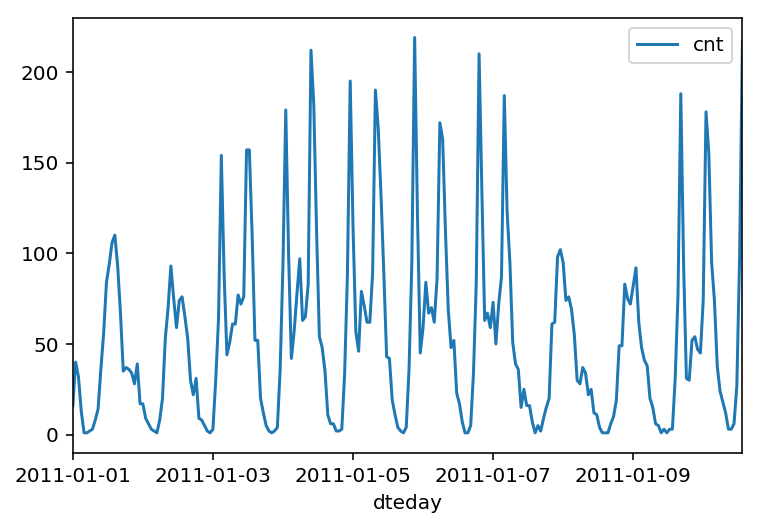

In [4]:
rides[:24*10].plot(x='dteday', y='cnt')

### 虚拟变量（哑变量）

下面是一些分类变量，例如季节、天气、月份。要在我们的模型中包含这些数据，我们需要创建二进制虚拟变量。用 Pandas 库中的 `get_dummies()` 就可以轻松实现。

In [5]:
dummy_fields = ['season', 'weathersit', 'mnth', 'hr', 'weekday']
for each in dummy_fields:
    dummies = pd.get_dummies(rides[each], prefix=each, drop_first=False)
    rides = pd.concat([rides, dummies], axis=1)

fields_to_drop = ['instant', 'dteday', 'season', 'weathersit', 
                  'weekday', 'atemp', 'mnth', 'workingday', 'hr']
data = rides.drop(fields_to_drop, axis=1)
data.head()

,yr,holiday,temp,hum,windspeed,casual,registered,cnt,season_1,season_2,...,hr_21,hr_22,hr_23,weekday_0,weekday_1,weekday_2,weekday_3,weekday_4,weekday_5,weekday_6
0,0,0,0.24,0.81,0.0,3,13,16,1,0,...,0,0,0,0,0,0,0,0,0,1
1,0,0,0.22,0.80,0.0,8,32,40,1,0,...,0,0,0,0,0,0,0,0,0,1
2,0,0,0.22,0.80,0.0,5,27,32,1,0,...,0,0,0,0,0,0,0,0,0,1
3,0,0,0.24,0.75,0.0,3,10,13,1,0,...,0,0,0,0,0,0,0,0,0,1
4,0,0,0.24,0.75,0.0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,1


### 调整目标变量

为了更轻松地训练网络，我们将对每个连续变量标准化，即转换和调整变量，使它们的均值为 0，标准差为 1。

我们会保存换算因子，以便当我们使用网络进行预测时可以还原数据。

In [6]:
quant_features = ['casual', 'registered', 'cnt', 'temp', 'hum', 'windspeed']
# Store scalings in a dictionary so we can convert back later
scaled_features = {}
for each in quant_features:
    mean, std = data[each].mean(), data[each].std()
    scaled_features[each] = [mean, std]
    data.loc[:, each] = (data[each] - mean)/std

### 将数据拆分为训练、测试和验证数据集

我们将大约最后 21 天的数据保存为测试数据集，这些数据集会在训练完网络后使用。我们将使用该数据集进行预测，并与实际的骑行人数进行对比。

In [7]:
# Save data for approximately the last 21 days 
test_data = data[-21*24:]

# Now remove the test data from the data set 
data = data[:-21*24]

# Separate the data into features and targets
target_fields = ['cnt', 'casual', 'registered']
features, targets = data.drop(target_fields, axis=1), data[target_fields]
test_features, test_targets = test_data.drop(target_fields, axis=1), test_data[target_fields]

我们将数据拆分为两个数据集，一个用作训练，一个在网络训练完后用来验证网络。因为数据是有时间序列特性的，所以我们用历史数据进行训练，然后尝试预测未来数据（验证数据集）。

In [8]:
# Hold out the last 60 days or so of the remaining data as a validation set
train_features, train_targets = features[:-60*24], targets[:-60*24]
val_features, val_targets = features[-60*24:], targets[-60*24:]

## 开始构建网络

下面你将构建自己的网络。我们已经构建好结构和反向传递部分。你将实现网络的前向传递部分。还需要设置超参数：学习速率、隐藏单元的数量，以及训练传递数量。

<img src="assets/neural_network.png" width=300px>

该网络有两个层级，一个隐藏层和一个输出层。隐藏层级将使用 S 型函数作为激活函数。输出层只有一个节点，用于递归，节点的输出和节点的输入相同。即激活函数是 $f(x)=x$。这种函数获得输入信号，并生成输出信号，但是会考虑阈值，称为激活函数。我们完成网络的每个层级，并计算每个神经元的输出。一个层级的所有输出变成下一层级神经元的输入。这一流程叫做前向传播（forward propagation）。

我们在神经网络中使用权重将信号从输入层传播到输出层。我们还使用权重将错误从输出层传播回网络，以便更新权重。这叫做反向传播（backpropagation）。

> **提示**：你需要为反向传播实现计算输出激活函数 ($f(x) = x$) 的导数。如果你不熟悉微积分，其实该函数就等同于等式 $y = x$。该等式的斜率是多少？也就是导数 $f(x)$。


你需要完成以下任务：

1. 实现 S 型激活函数。将 `__init__` 中的 `self.activation_function`  设为你的 S 型函数。
2. 在 `train` 方法中实现前向传递。
3. 在 `train` 方法中实现反向传播算法，包括计算输出错误。
4. 在 `run` 方法中实现前向传递。

  

In [135]:
class NeuralNetwork(object):
    
    def __init__(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Set number of nodes in input, hidden and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Initialize weights
        self.weights_input_to_hidden = np.random.normal(0.0, self.input_nodes**-0.5, 
                                       (self.input_nodes, self.hidden_nodes))

        self.weights_hidden_to_output = np.random.normal(0.0, self.hidden_nodes**-0.5, 
                                       (self.hidden_nodes, self.output_nodes))
        self.lr = learning_rate
        
        #### TODO: Set self.activation_function to your implemented sigmoid function ####
        #
        # Note: in Python, you can define a function with a lambda expression,
        # as shown below.
        self.activation_function = lambda x : 1 / (1 + np.exp(-x))  # Replace 0 with your sigmoid calculation.
        
        ### If the lambda code above is not something you're familiar with,
        # You can uncomment out the following three lines and put your 
        # implementation there instead.
        #
        #def sigmoid(x):
        #    return 0  # Replace 0 with your sigmoid calculation here
        #self.activation_function = sigmoid
                    
    
    def train(self, features, targets):
        ''' Train the network on batch of features and targets. 
        
            Arguments
            ---------
            
            features: 2D array, each row is one data record, each column is a feature
            targets: 1D array of target values
        
        '''
        n_records = features.shape[0]
        delta_weights_i_h = np.zeros(self.weights_input_to_hidden.shape)
        delta_weights_h_o = np.zeros(self.weights_hidden_to_output.shape)
        for X, y in zip(features, targets):
            #### Implement the forward pass here ####
            ### Forward pass ###
            # TODO: Hidden layer - Replace these values with your calculations.
            hidden_inputs = np.dot(X , self.weights_input_to_hidden) # signals into hidden layer
            hidden_outputs = self.activation_function(hidden_inputs) # signals from hidden layer

            # TODO: Output layer - Replace these values with your calculations.
            final_inputs = np.dot(hidden_outputs, self.weights_hidden_to_output) # signals into final output layer
            final_outputs = final_inputs # signals from final output layer f(x) = x
            
            #### Implement the backward pass here ####
            ### Backward pass ###

            # TODO: Output error - Replace this value with your calculations.
            output_error = y - final_outputs # Output layer error is the difference between desired target and actual output.
            output_error_term = output_error * 1
            
            # TODO: Calculate the hidden layer's contribution to the error
            hidden_error = np.dot(self.weights_hidden_to_output, output_error_term)
            hidden_error_term = hidden_error * hidden_outputs * (1 - hidden_outputs)
            
            # TODO: Backpropagated error terms - Replace these values with your calculations.
            # Weight step (hidden to output)
            delta_weights_h_o += output_error_term * hidden_outputs[:,None]
            # Weight step (input to hidden)
            delta_weights_i_h += hidden_error_term * X[:,None]
        
        # TODO: Update the weights - Replace these values with your calculations.
        self.weights_input_to_hidden += self.lr * delta_weights_i_h / n_records # update input-to-hidden weights with gradient descent step
        self.weights_hidden_to_output += self.lr * delta_weights_h_o / n_records # update hidden-to-output weights with gradient descent step
 
    def run(self, features):
        ''' Run a forward pass through the network with input features 
        
            Arguments
            ---------
            features: 1D array of feature values
        '''
        
        #### Implement the forward pass here ####
        # TODO: Hidden layer - replace these values with the appropriate calculations.
        hidden_inputs = np.dot(features, self.weights_input_to_hidden) # signals into hidden layer
        hidden_outputs = self.activation_function(hidden_inputs) # signals from hidden layer
        
        # TODO: Output layer - Replace these values with the appropriate calculations.
        final_inputs = np.dot(hidden_outputs, self.weights_hidden_to_output) # signals into final output layer
        final_outputs = final_inputs # signals from final output layer 
        
        return final_outputs
        

In [136]:
def MSE(y, Y):
    '''
    caculate the mean squra erros
    '''
    return np.mean((y-Y)**2)

## 单元测试

运行这些单元测试，检查你的网络实现是否正确。这样可以帮助你确保网络已正确实现，然后再开始训练网络。这些测试必须成功才能通过此项目。

In [137]:
import unittest

inputs = np.array([[0.5, -0.2, 0.1]])
targets = np.array([[0.4]])
test_w_i_h = np.array([[0.1, -0.2],
                       [0.4, 0.5],
                       [-0.3, 0.2]])
test_w_h_o = np.array([[0.3],
                       [-0.1]])

class TestMethods(unittest.TestCase):
    
    ##########
    # Unit tests for data loading
    ##########
    
    def test_data_path(self):
        # Test that file path to dataset has been unaltered
        self.assertTrue(data_path.lower() == 'bike-sharing-dataset/hour.csv')
        
    def test_data_loaded(self):
        # Test that data frame loaded
        self.assertTrue(isinstance(rides, pd.DataFrame))
    
    ##########
    # Unit tests for network functionality
    ##########

    def test_activation(self):
        network = NeuralNetwork(3, 2, 1, 0.5)
        # Test that the activation function is a sigmoid
        self.assertTrue(np.all(network.activation_function(0.5) == 1/(1+np.exp(-0.5))))

    def test_train(self):
        # Test that weights are updated correctly on training
        network = NeuralNetwork(3, 2, 1, 0.5)
        network.weights_input_to_hidden = test_w_i_h.copy()
        network.weights_hidden_to_output = test_w_h_o.copy()
        
        network.train(inputs, targets)
        self.assertTrue(np.allclose(network.weights_hidden_to_output, 
                                    np.array([[ 0.37275328], 
                                              [-0.03172939]])))
        self.assertTrue(np.allclose(network.weights_input_to_hidden,
                                    np.array([[ 0.10562014, -0.20185996], 
                                              [0.39775194, 0.50074398], 
                                              [-0.29887597, 0.19962801]])))

    def test_run(self):
        # Test correctness of run method
        network = NeuralNetwork(3, 2, 1, 0.5)
        network.weights_input_to_hidden = test_w_i_h.copy()
        network.weights_hidden_to_output = test_w_h_o.copy()

        self.assertTrue(np.allclose(network.run(inputs), 0.09998924))

suite = unittest.TestLoader().loadTestsFromModule(TestMethods())
unittest.TextTestRunner().run(suite)

.....
----------------------------------------------------------------------
Ran 5 tests in 0.006s

OK


<unittest.runner.TextTestResult run=5 errors=0 failures=0>

## 训练网络

现在你将设置网络的超参数。策略是设置的超参数使训练集上的错误很小但是数据不会过拟合。如果网络训练时间太长，或者有太多的隐藏节点，可能就会过于针对特定训练集，无法泛化到验证数据集。即当训练集的损失降低时，验证集的损失将开始增大。

你还将采用随机梯度下降 (SGD) 方法训练网络。对于每次训练，都获取随机样本数据，而不是整个数据集。与普通梯度下降相比，训练次数要更多，但是每次时间更短。这样的话，网络训练效率更高。稍后你将详细了解 SGD。


### 选择迭代次数

也就是训练网络时从训练数据中抽样的批次数量。迭代次数越多，模型就与数据越拟合。但是，如果迭代次数太多，模型就无法很好地泛化到其他数据，这叫做过拟合。你需要选择一个使训练损失很低并且验证损失保持中等水平的数字。当你开始**过拟合**时，你会发现训练损失继续下降，但是验证损失开始上升。

### 选择学习速率

速率可以调整权重更新幅度。如果速率太大，权重就会太大，导致网络无法与数据相拟合。建议从 0.1 开始。如果网络在与数据拟合时遇到问题，尝试降低学习速率。注意，学习速率越低，权重更新的步长就越小，神经网络收敛的时间就越长。


### 选择隐藏节点数量

隐藏节点越多，模型的预测结果就越准确。尝试不同的隐藏节点的数量，看看对性能有何影响。你可以查看损失字典，寻找网络性能指标。如果隐藏单元的数量太少，那么模型就没有足够的空间进行学习，如果太多，则学习方向就有太多的选择。选择隐藏单元数量的技巧在于找到合适的平衡点。

In [191]:
import sys

def grid_search(iterations=5000,
                learning_rate=0.1,
                hidden_nodes=2,
                output_nodes=1):
    print("Start train for params iterations:%d,learning_rate:%.2f,hidden_nodes:%d,output_nodes:%d" \
          %(iterations, learning_rate, hidden_nodes, output_nodes))
    N_i = train_features.shape[1]
    network = NeuralNetwork(N_i, hidden_nodes, output_nodes, learning_rate)
    losses = {'train':[], 'validation':[]}
    for ii in range(iterations):
        # Go through a random batch of 128 records from the training data set
        batch = np.random.choice(train_features.index, size=128)
        X, y = train_features.ix[batch].values, train_targets.ix[batch]['cnt']

        network.train(X, y)

        # Printing out the training progress
        train_loss = MSE(network.run(train_features).T, train_targets['cnt'].values)
        val_loss = MSE(network.run(val_features).T, val_targets['cnt'].values)
        sys.stdout.write("\rProgress: {:2.1f}".format(100 * ii/float(iterations)) \
                         + "% ... Training loss: " + str(train_loss)[:5] \
                         + " ... Validation loss: " + str(val_loss)[:5])
        sys.stdout.flush()

        losses['train'].append(train_loss)
        losses['validation'].append(val_loss)
    
    plt.plot(losses['train'], label='Training loss')
    plt.plot(losses['validation'], label='Validation loss')
    plt.legend()
    _ = plt.ylim()
    plt.show()
    result = dict()
    result['params'] = {'iterations':iterations,'learning_rate':learning_rate, \
                        'hidden_nodes':hidden_nodes,'output_nodes':output_nodes}
    result['losses'] = losses
    result['network'] = network
    return result

Start train for params iterations:1000,learning_rate:0.90,hidden_nodes:20,output_nodes:1
Progress: 99.9% ... Training loss: 0.235 ... Validation loss: 0.403

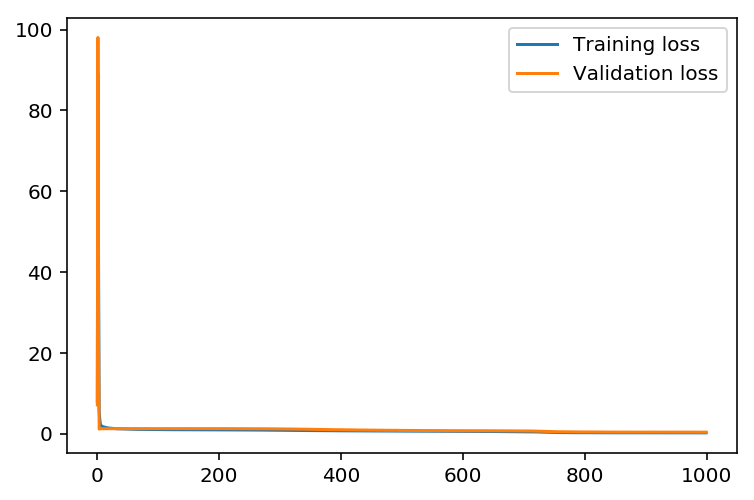

Start train for params iterations:1500,learning_rate:0.90,hidden_nodes:20,output_nodes:1
Progress: 99.9% ... Training loss: 0.752 ... Validation loss: 1.229

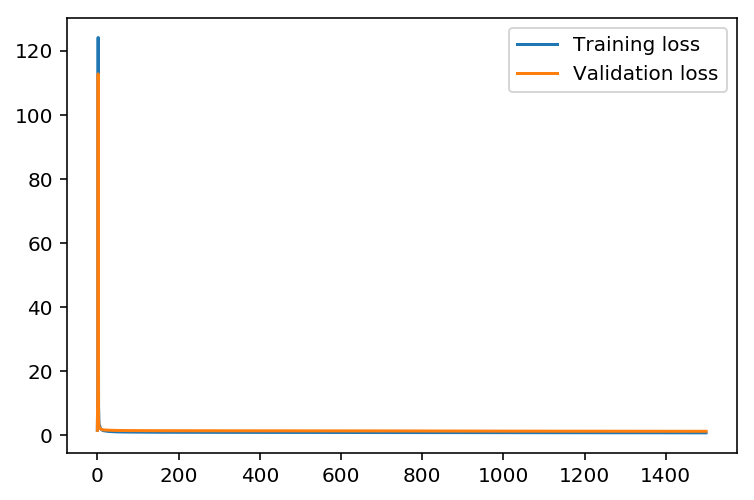

Start train for params iterations:2000,learning_rate:0.90,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.136 ... Validation loss: 0.248

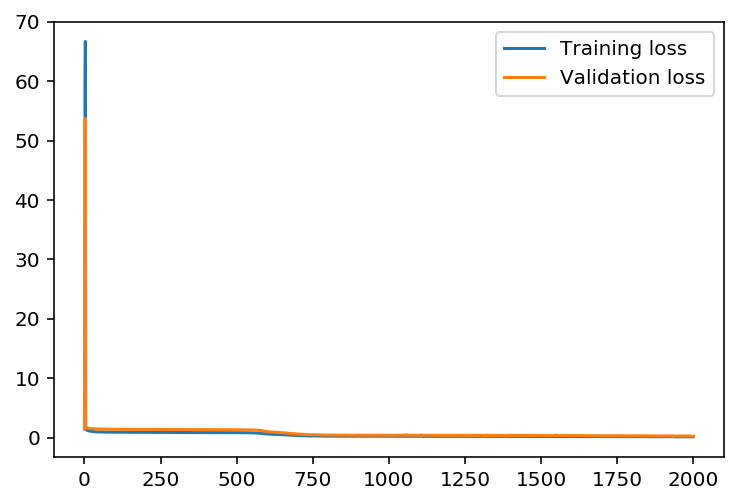

Start train for params iterations:3000,learning_rate:0.90,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.100 ... Validation loss: 0.182

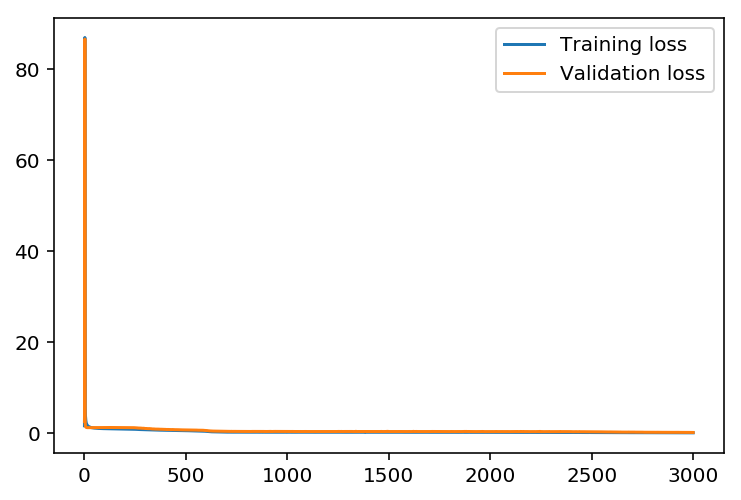

Start train for params iterations:5000,learning_rate:0.90,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.059 ... Validation loss: 0.131

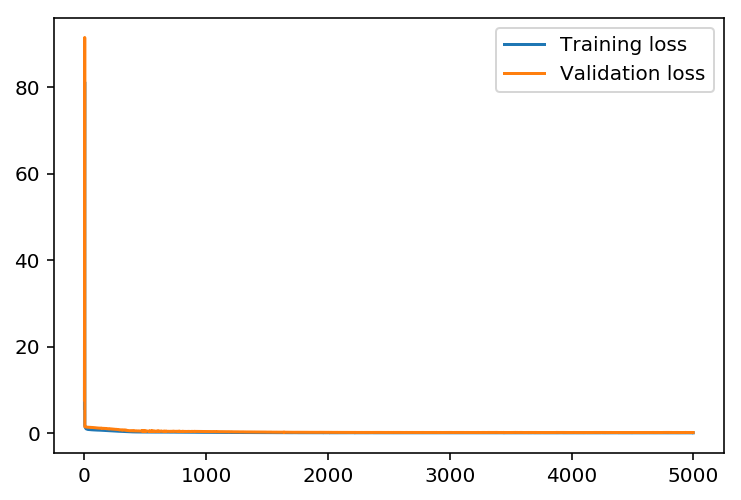

Start train for params iterations:8000,learning_rate:0.90,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.058 ... Validation loss: 0.130

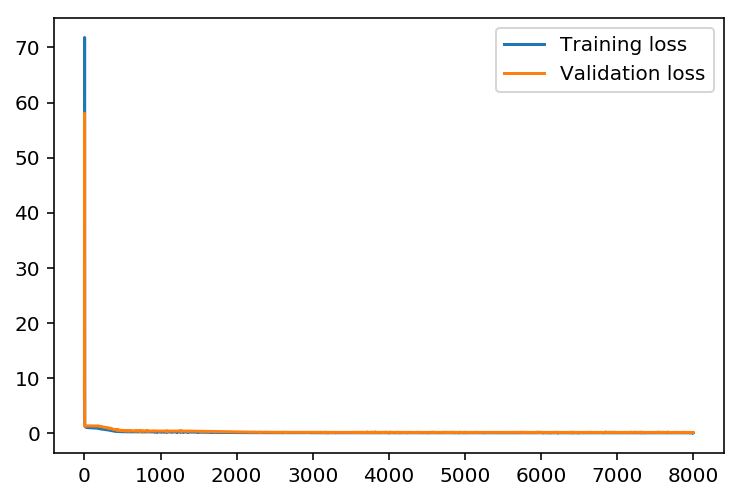

Start train for params iterations:10000,learning_rate:0.90,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.096 ... Validation loss: 0.183

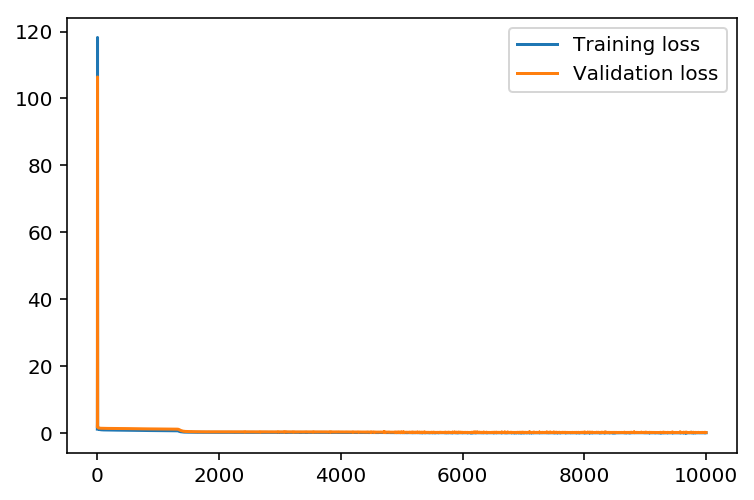

Start train for params iterations:1000,learning_rate:0.70,hidden_nodes:20,output_nodes:1
Progress: 99.9% ... Training loss: 0.217 ... Validation loss: 0.382

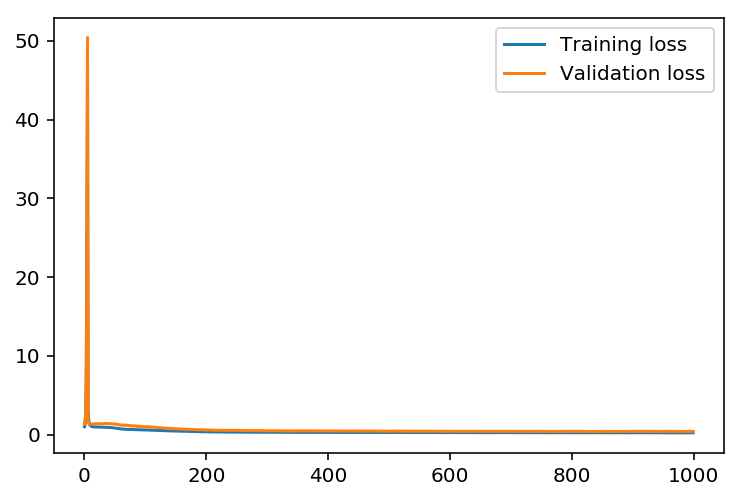

Start train for params iterations:1500,learning_rate:0.70,hidden_nodes:20,output_nodes:1
Progress: 99.9% ... Training loss: 0.145 ... Validation loss: 0.277

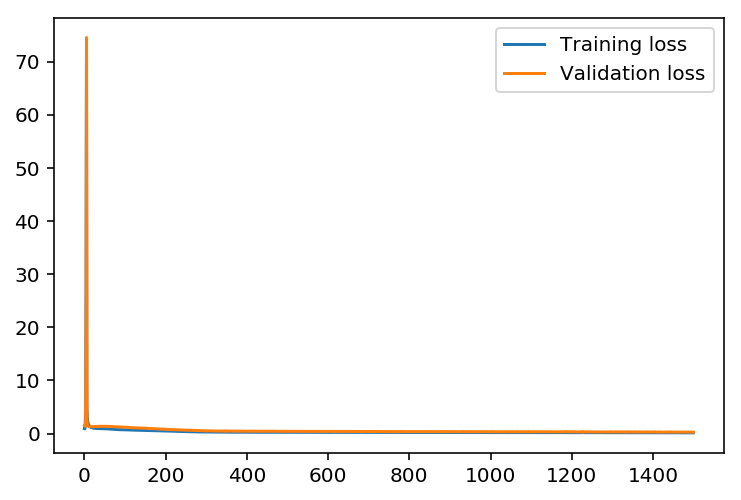

Start train for params iterations:2000,learning_rate:0.70,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.084 ... Validation loss: 0.176

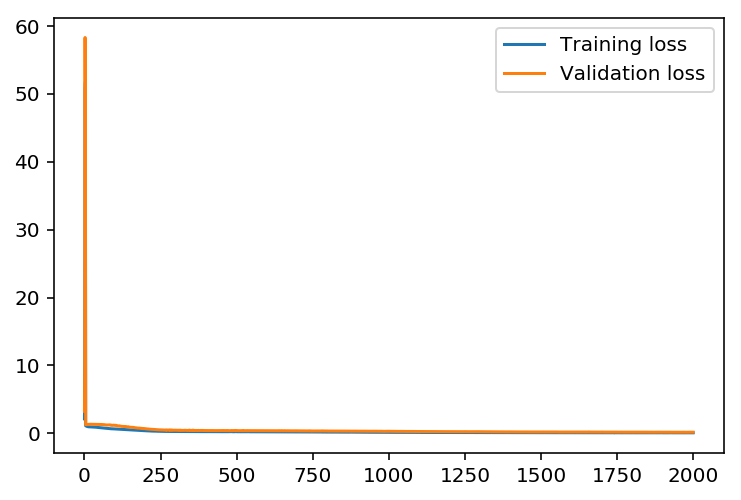

Start train for params iterations:3000,learning_rate:0.70,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.091 ... Validation loss: 0.195

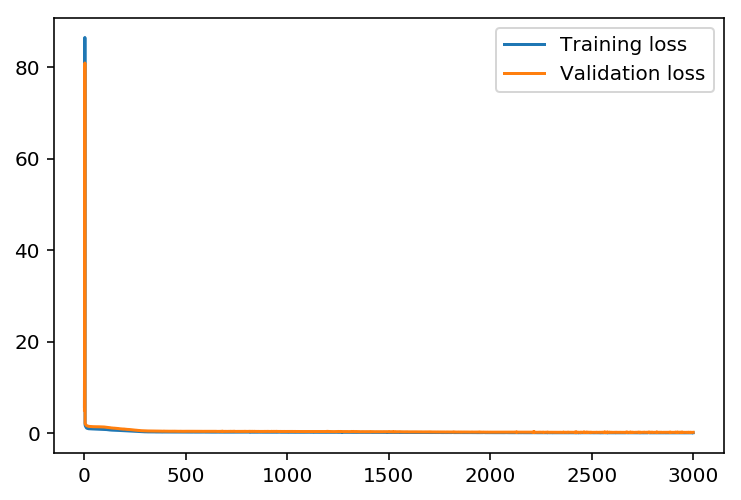

Start train for params iterations:5000,learning_rate:0.70,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.059 ... Validation loss: 0.139

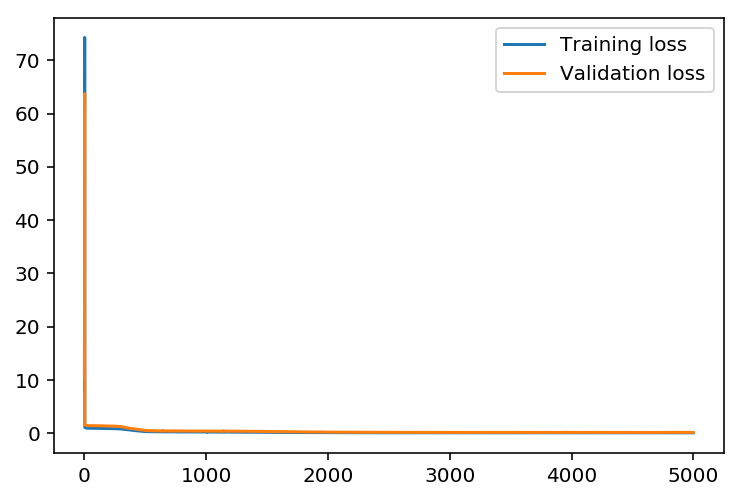

Start train for params iterations:8000,learning_rate:0.70,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.054 ... Validation loss: 0.148

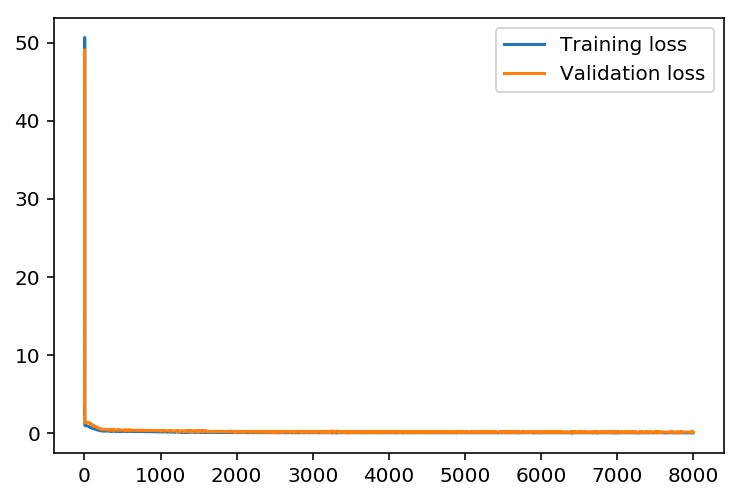

Start train for params iterations:10000,learning_rate:0.70,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.057 ... Validation loss: 0.130

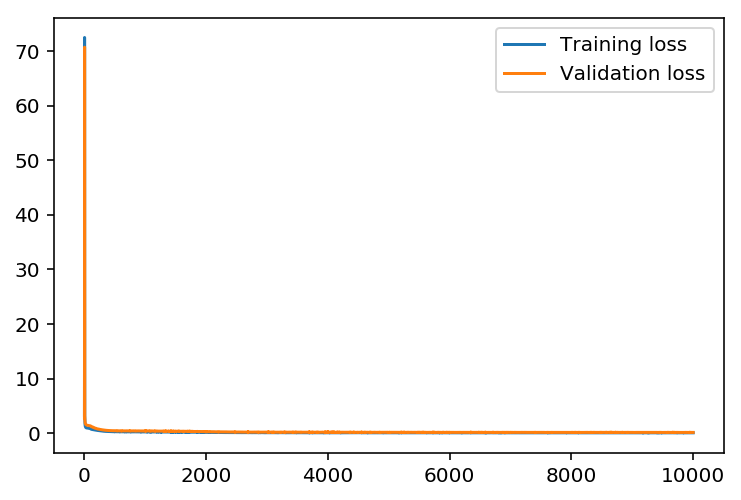

Start train for params iterations:1000,learning_rate:0.50,hidden_nodes:20,output_nodes:1
Progress: 99.9% ... Training loss: 0.247 ... Validation loss: 0.425

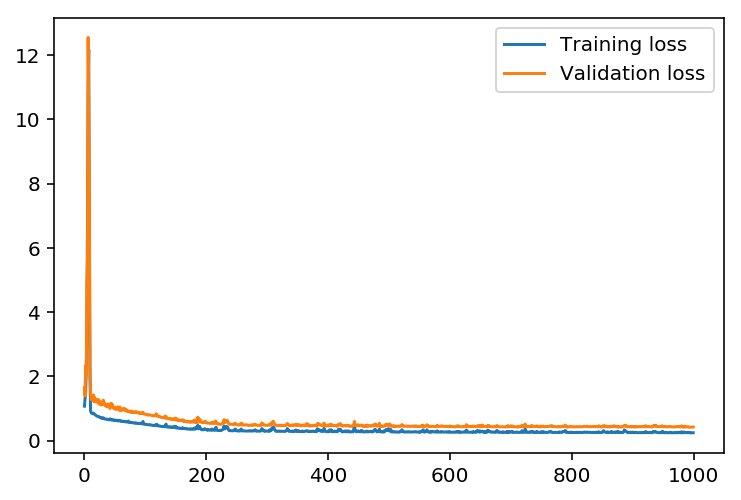

Start train for params iterations:1500,learning_rate:0.50,hidden_nodes:20,output_nodes:1
Progress: 99.9% ... Training loss: 0.188 ... Validation loss: 0.334

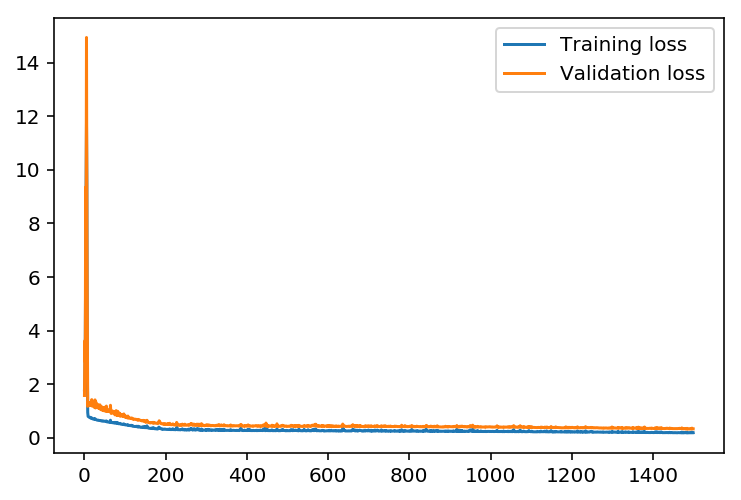

Start train for params iterations:2000,learning_rate:0.50,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.150 ... Validation loss: 0.278

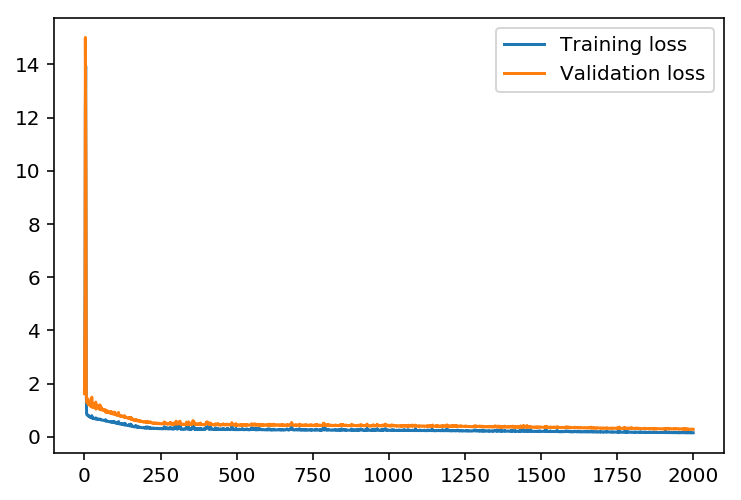

Start train for params iterations:3000,learning_rate:0.50,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.082 ... Validation loss: 0.182

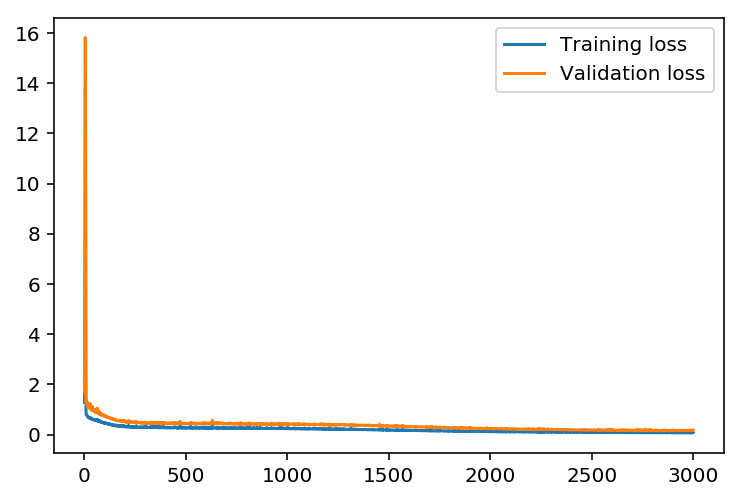

Start train for params iterations:5000,learning_rate:0.50,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.063 ... Validation loss: 0.156

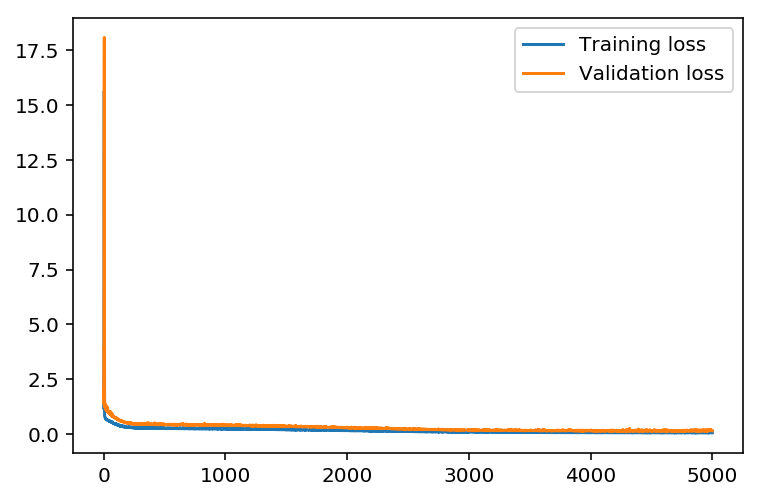

Start train for params iterations:8000,learning_rate:0.50,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.059 ... Validation loss: 0.146

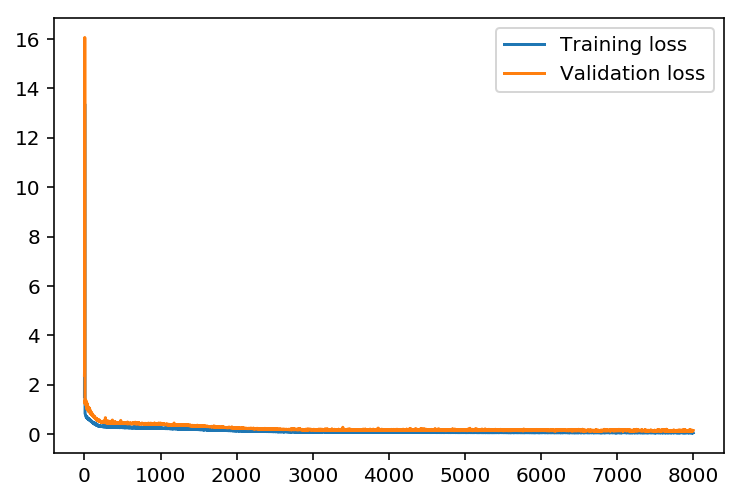

Start train for params iterations:10000,learning_rate:0.50,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.049 ... Validation loss: 0.175

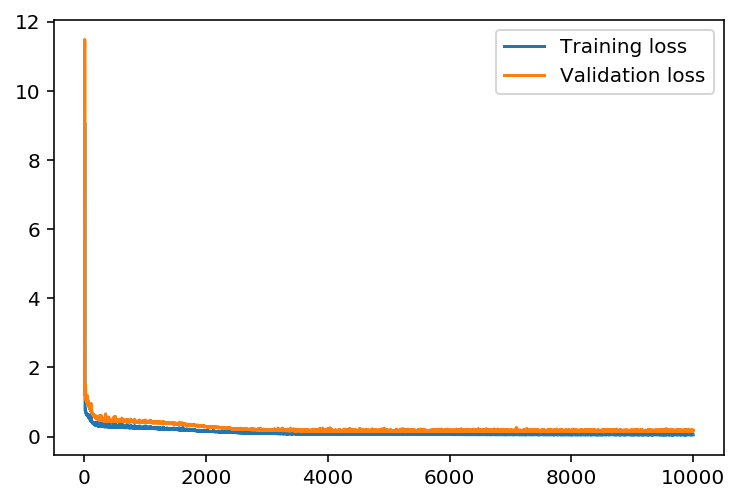

Start train for params iterations:1000,learning_rate:0.30,hidden_nodes:20,output_nodes:1
Progress: 99.9% ... Training loss: 0.269 ... Validation loss: 0.448

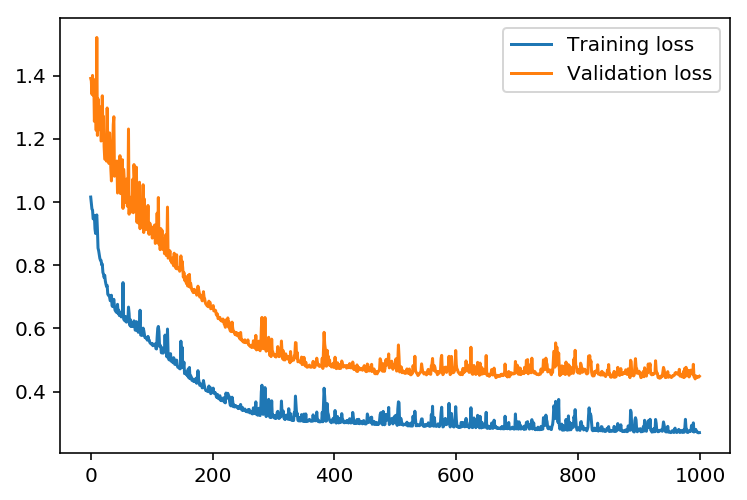

Start train for params iterations:1500,learning_rate:0.30,hidden_nodes:20,output_nodes:1
Progress: 99.9% ... Training loss: 0.301 ... Validation loss: 0.492

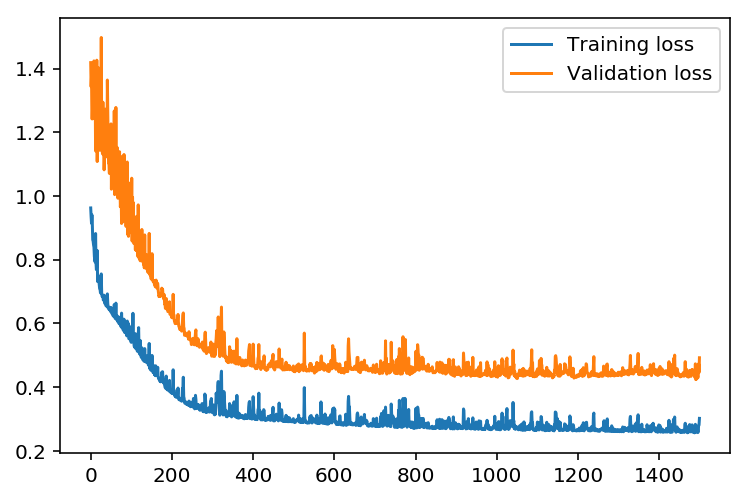

Start train for params iterations:2000,learning_rate:0.30,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.220 ... Validation loss: 0.396

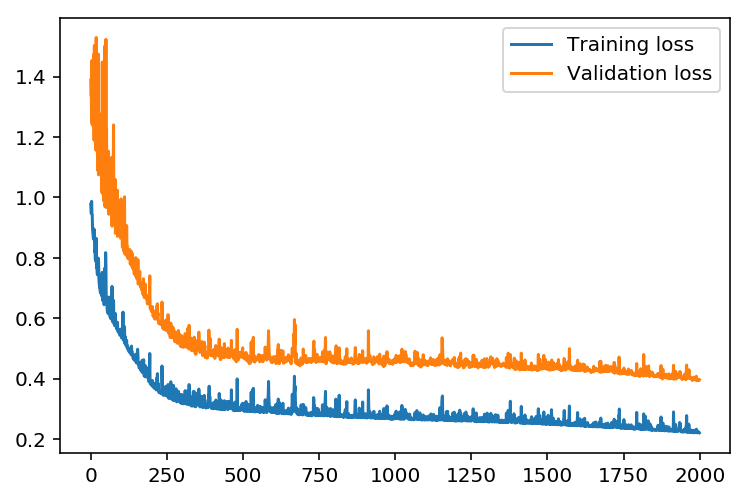

Start train for params iterations:3000,learning_rate:0.30,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.185 ... Validation loss: 0.328

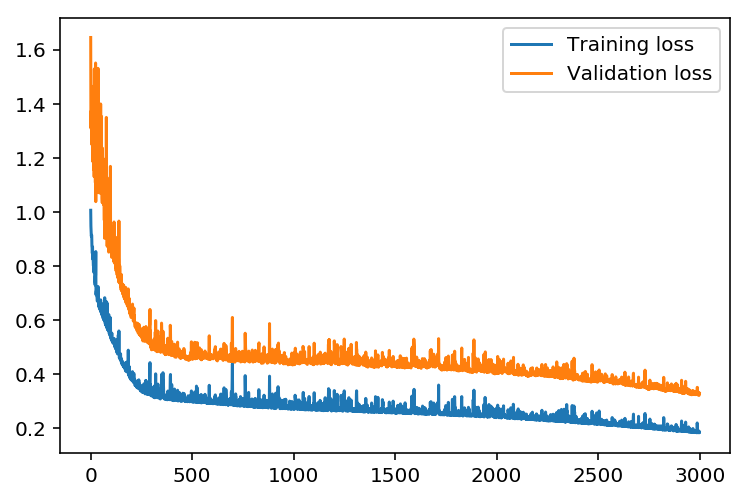

Start train for params iterations:5000,learning_rate:0.30,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.101 ... Validation loss: 0.224

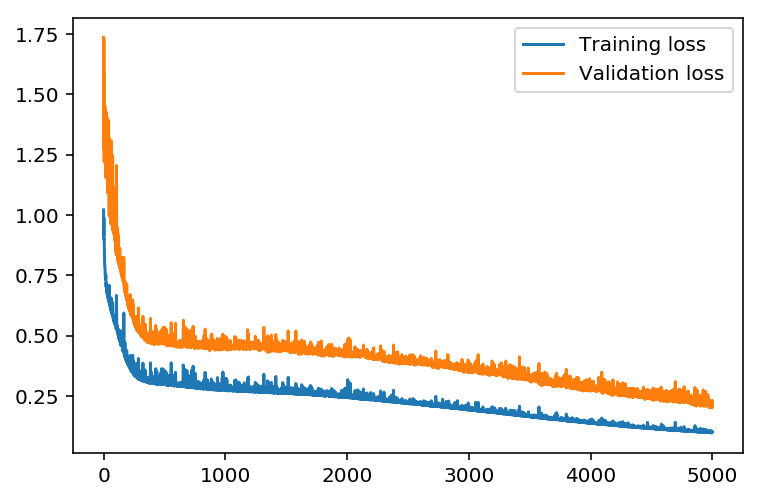

Start train for params iterations:8000,learning_rate:0.30,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.064 ... Validation loss: 0.170

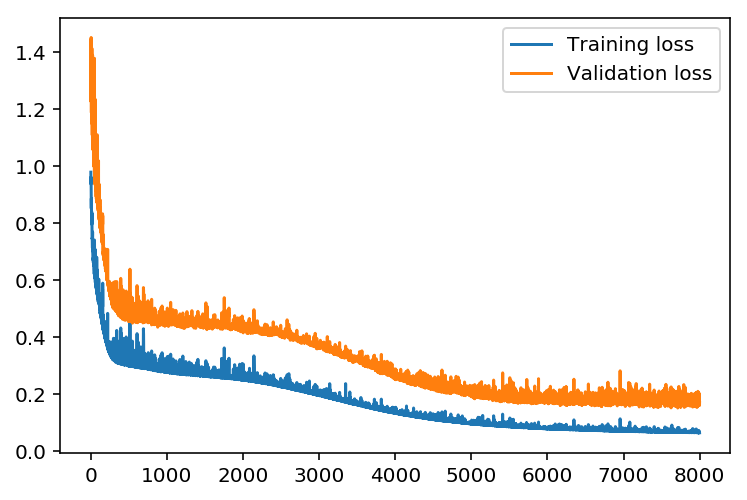

Start train for params iterations:10000,learning_rate:0.30,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.062 ... Validation loss: 0.162

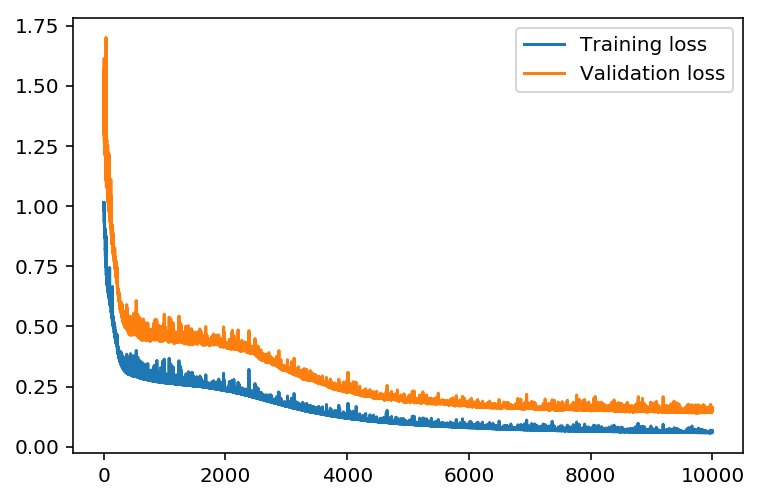

Start train for params iterations:1000,learning_rate:0.10,hidden_nodes:20,output_nodes:1
Progress: 99.9% ... Training loss: 0.312 ... Validation loss: 0.493

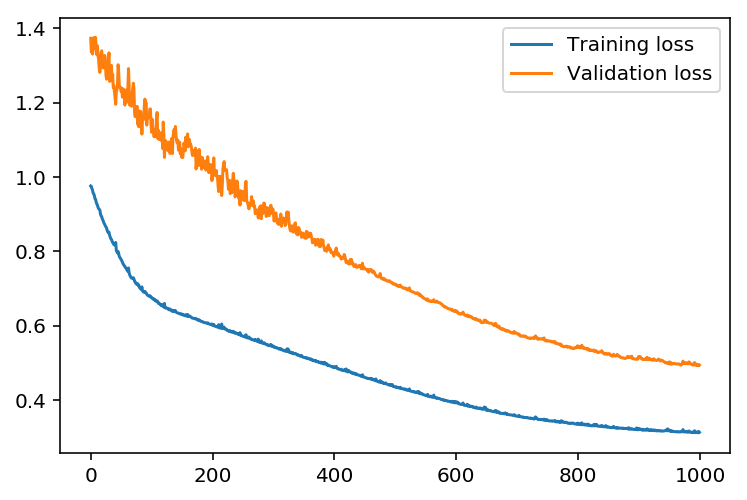

Start train for params iterations:1500,learning_rate:0.10,hidden_nodes:20,output_nodes:1
Progress: 99.9% ... Training loss: 0.297 ... Validation loss: 0.464

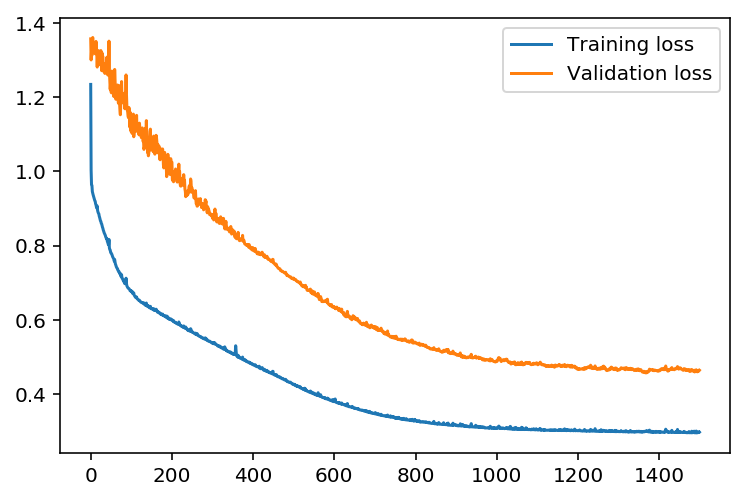

Start train for params iterations:2000,learning_rate:0.10,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.290 ... Validation loss: 0.461

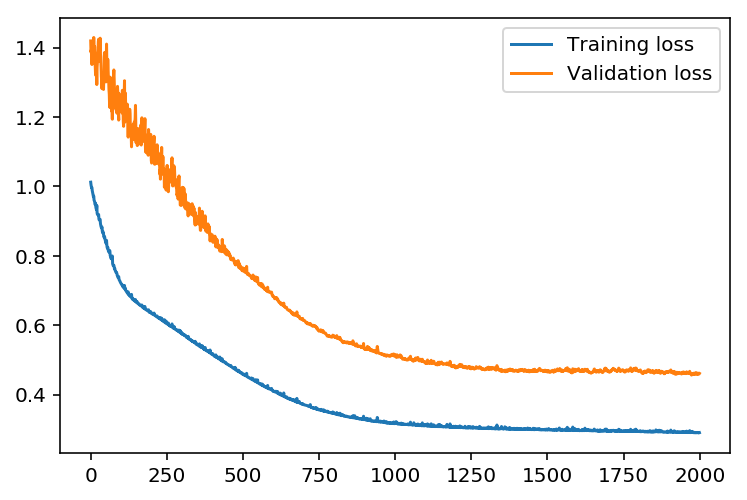

Start train for params iterations:3000,learning_rate:0.10,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.266 ... Validation loss: 0.434

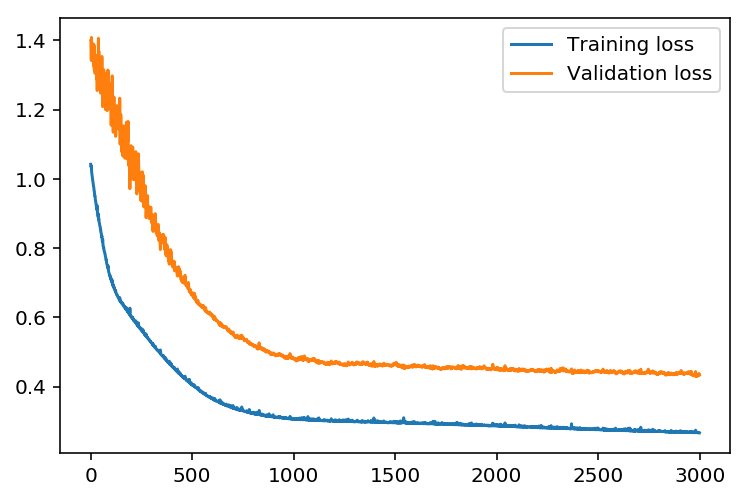

Start train for params iterations:5000,learning_rate:0.10,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.258 ... Validation loss: 0.438

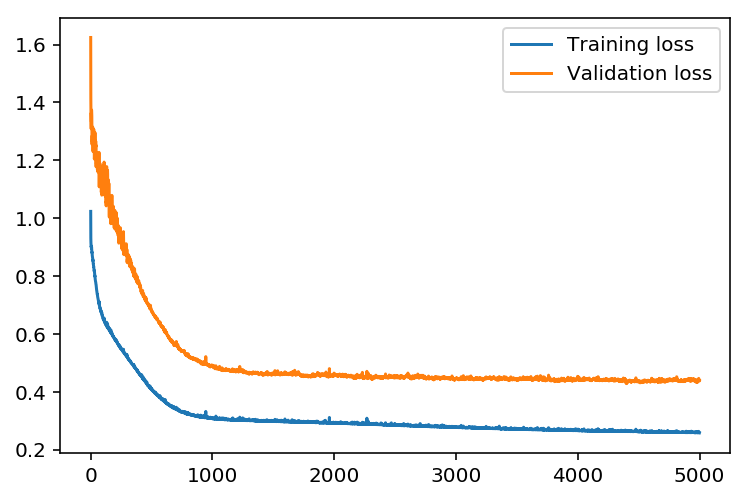

Start train for params iterations:8000,learning_rate:0.10,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.236 ... Validation loss: 0.409

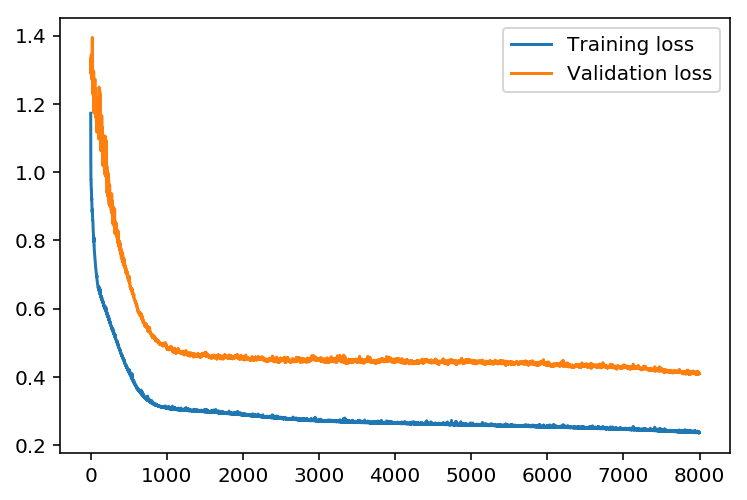

Start train for params iterations:10000,learning_rate:0.10,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.166 ... Validation loss: 0.321

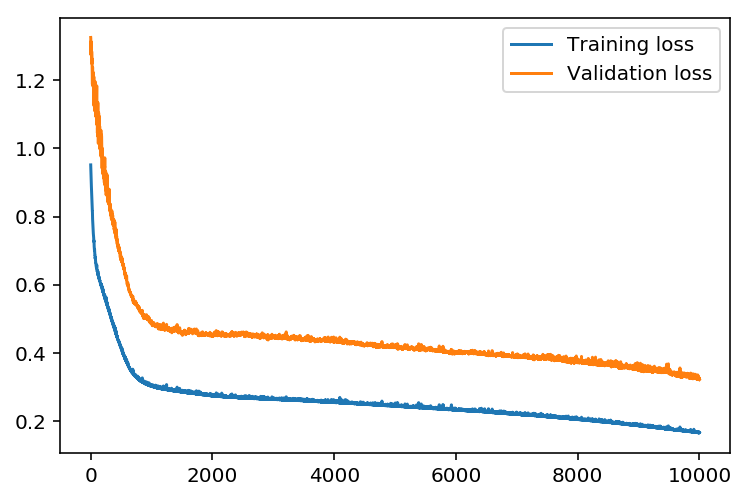

Start train for params iterations:1000,learning_rate:0.90,hidden_nodes:18,output_nodes:1
Progress: 99.9% ... Training loss: 0.226 ... Validation loss: 0.402

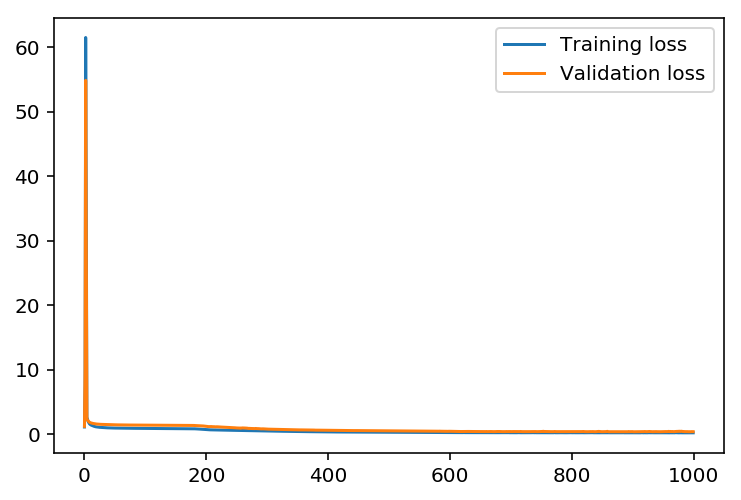

Start train for params iterations:1500,learning_rate:0.90,hidden_nodes:18,output_nodes:1
Progress: 99.9% ... Training loss: 0.128 ... Validation loss: 0.240

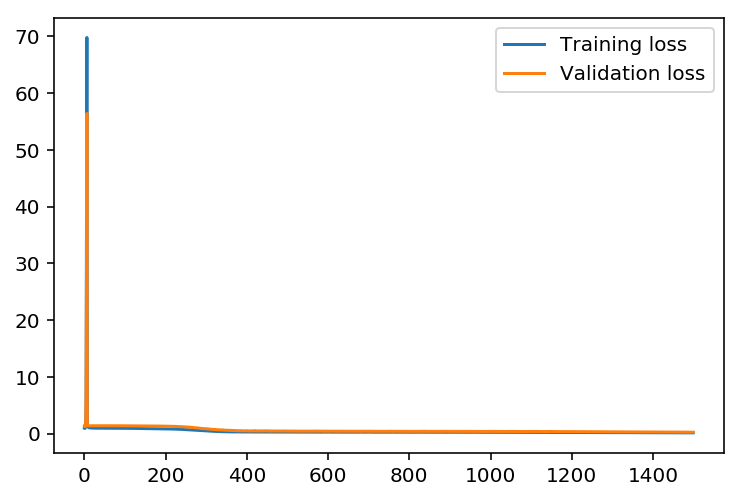

Start train for params iterations:2000,learning_rate:0.90,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.151 ... Validation loss: 0.289

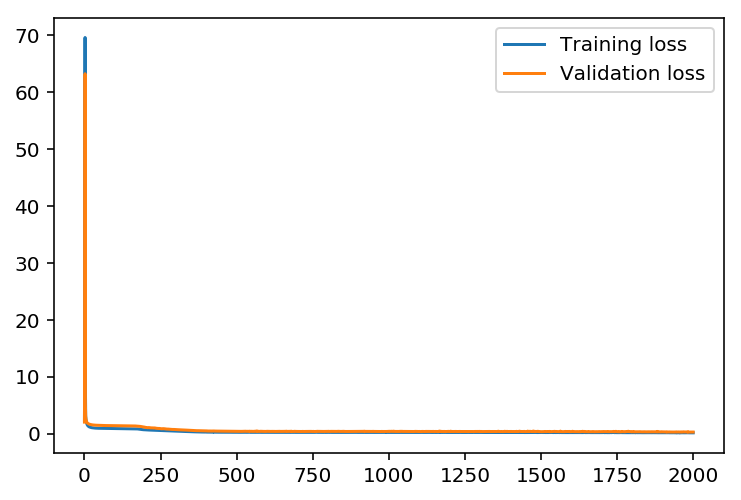

Start train for params iterations:3000,learning_rate:0.90,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.066 ... Validation loss: 0.144

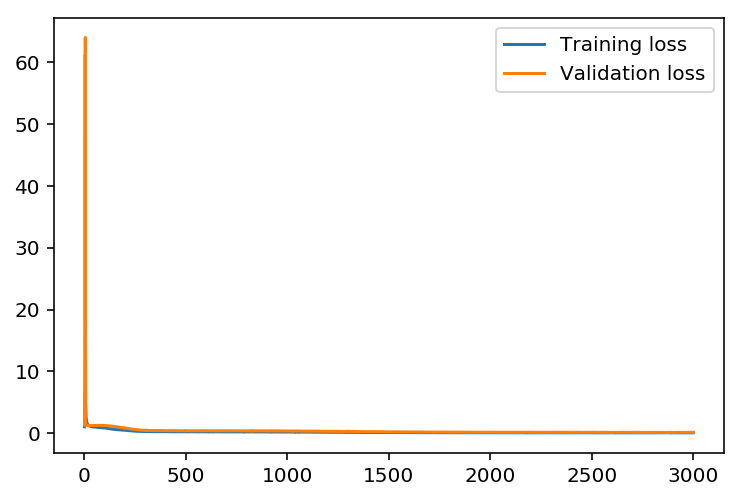

Start train for params iterations:5000,learning_rate:0.90,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.074 ... Validation loss: 0.182

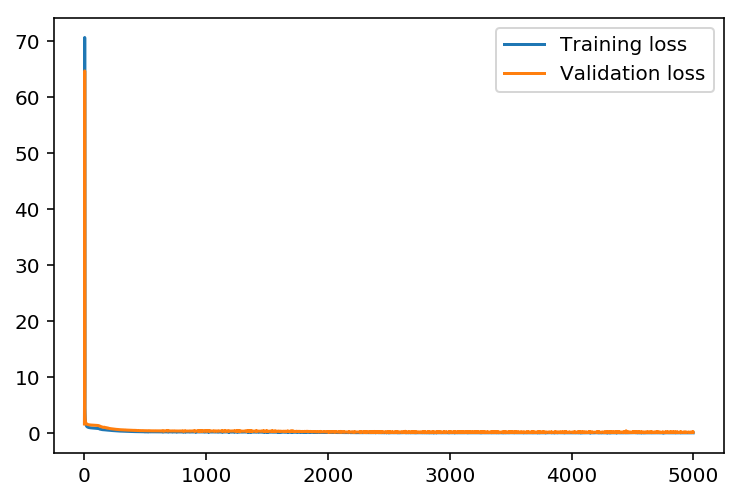

Start train for params iterations:8000,learning_rate:0.90,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.065 ... Validation loss: 0.176

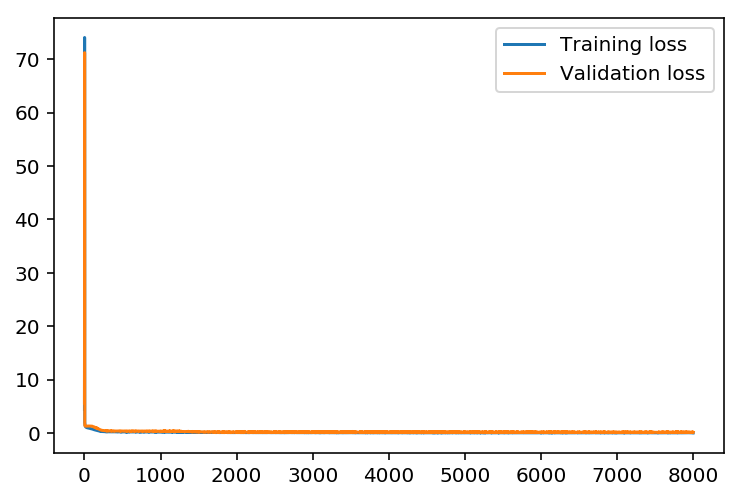

Start train for params iterations:10000,learning_rate:0.90,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.070 ... Validation loss: 0.157

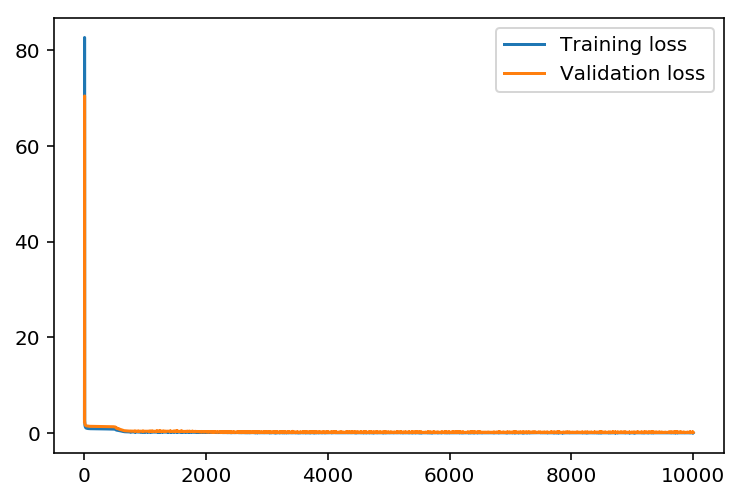

Start train for params iterations:1000,learning_rate:0.70,hidden_nodes:18,output_nodes:1
Progress: 99.9% ... Training loss: 0.173 ... Validation loss: 0.325

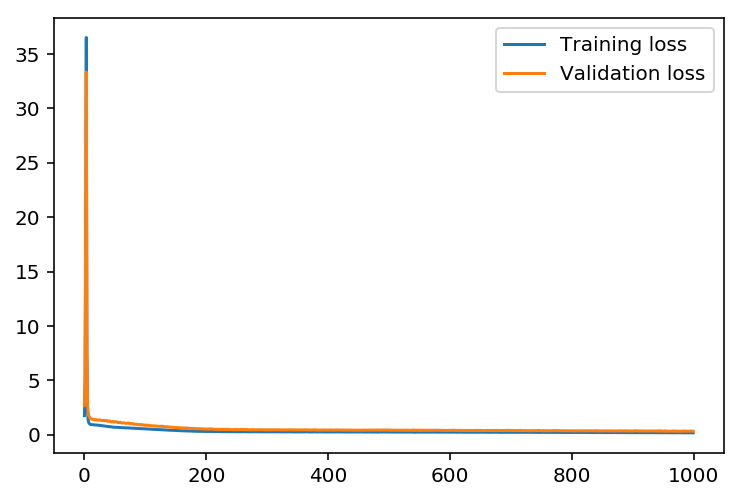

Start train for params iterations:1500,learning_rate:0.70,hidden_nodes:18,output_nodes:1
Progress: 99.9% ... Training loss: 0.100 ... Validation loss: 0.216

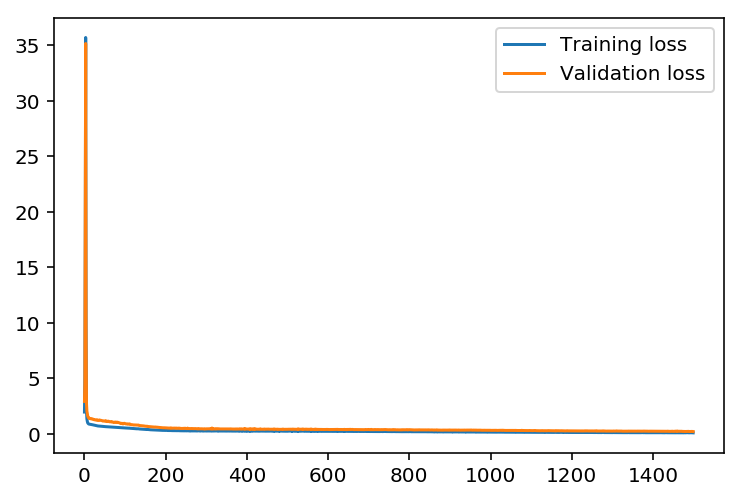

Start train for params iterations:2000,learning_rate:0.70,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.129 ... Validation loss: 0.213

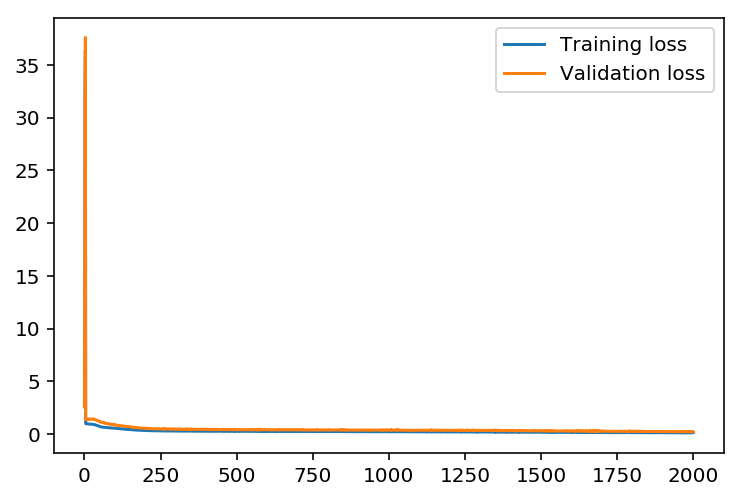

Start train for params iterations:3000,learning_rate:0.70,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.066 ... Validation loss: 0.151

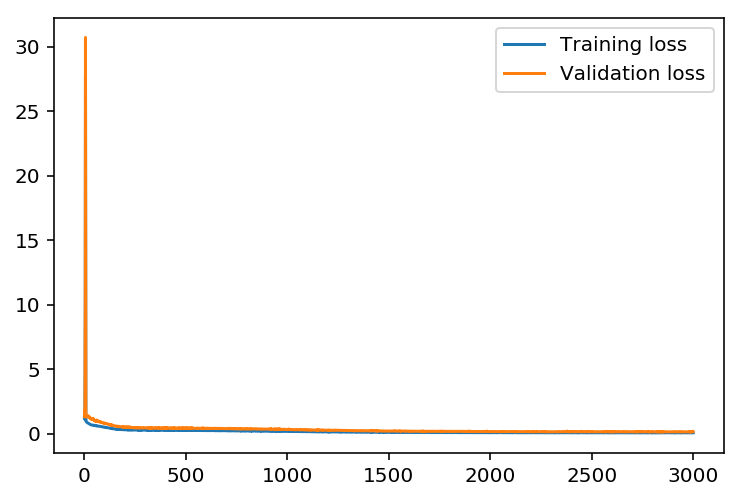

Start train for params iterations:5000,learning_rate:0.70,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.052 ... Validation loss: 0.144

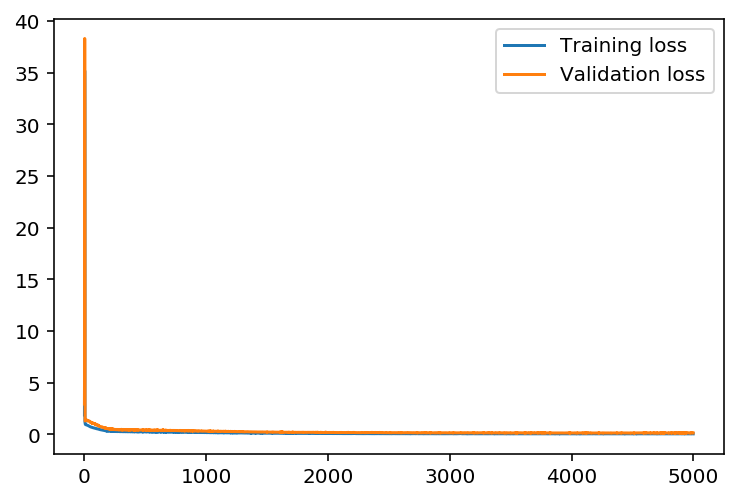

Start train for params iterations:8000,learning_rate:0.70,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.055 ... Validation loss: 0.133

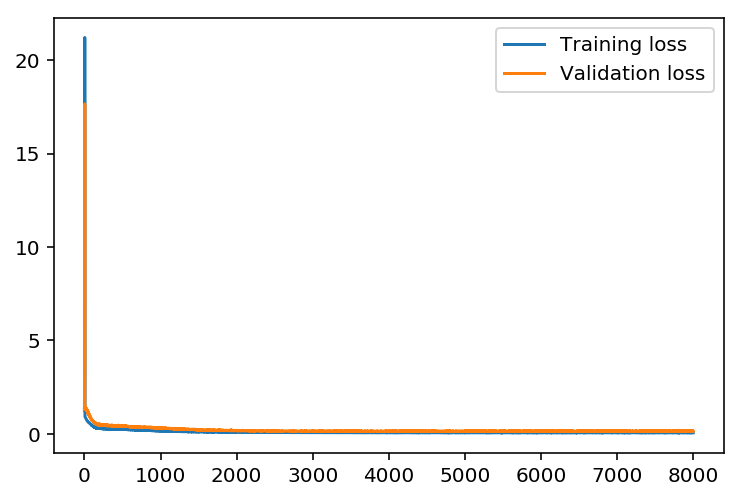

Start train for params iterations:10000,learning_rate:0.70,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.050 ... Validation loss: 0.137

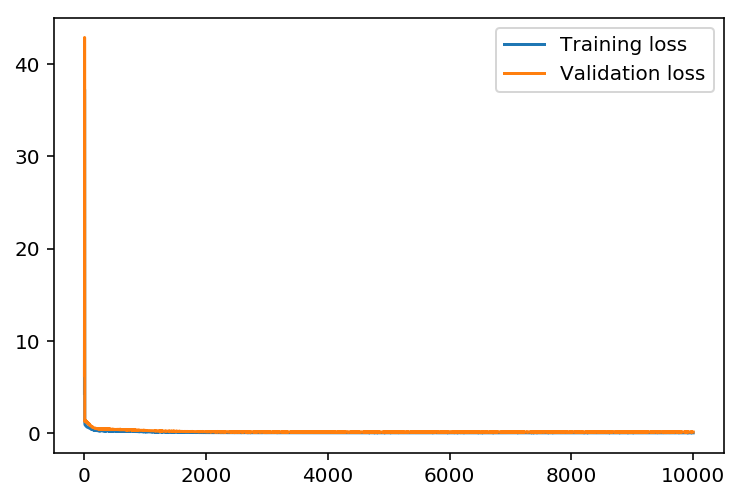

Start train for params iterations:1000,learning_rate:0.50,hidden_nodes:18,output_nodes:1
Progress: 99.9% ... Training loss: 0.242 ... Validation loss: 0.411

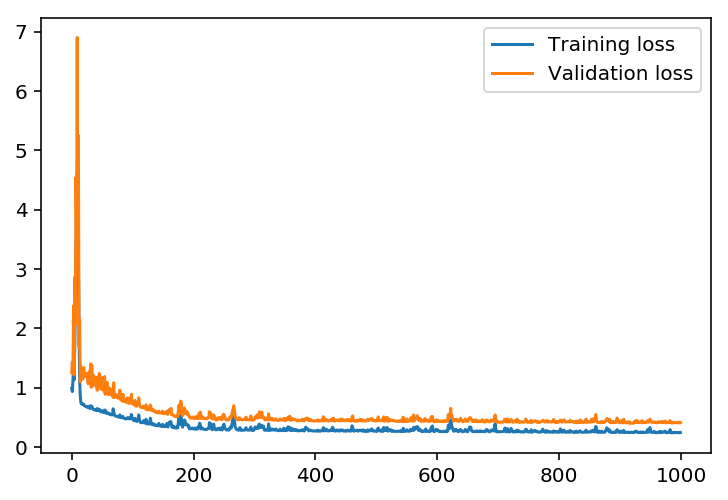

Start train for params iterations:1500,learning_rate:0.50,hidden_nodes:18,output_nodes:1
Progress: 99.9% ... Training loss: 0.203 ... Validation loss: 0.350

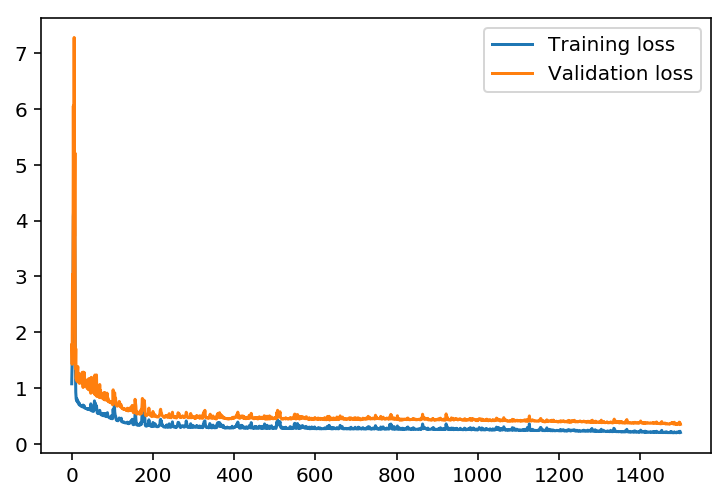

Start train for params iterations:2000,learning_rate:0.50,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.123 ... Validation loss: 0.232

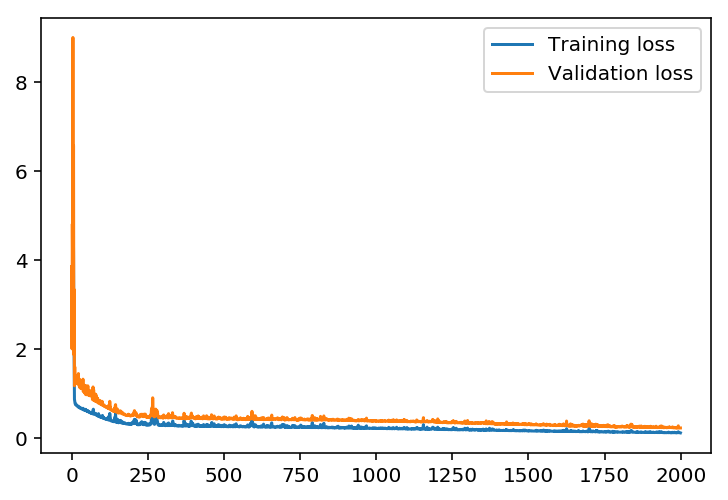

Start train for params iterations:3000,learning_rate:0.50,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.093 ... Validation loss: 0.156

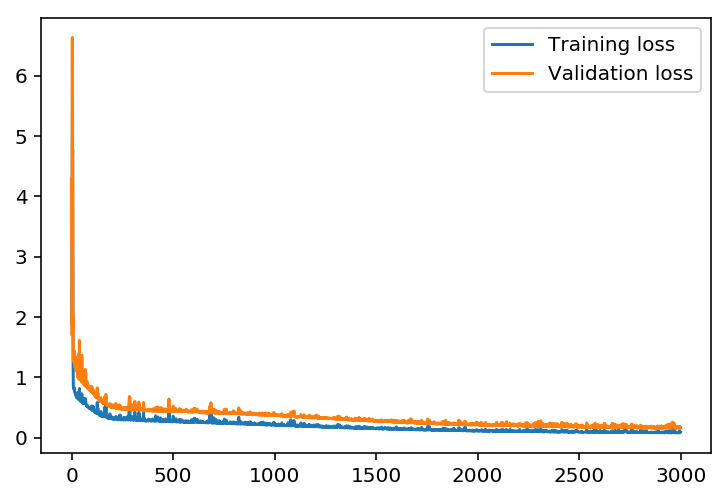

Start train for params iterations:5000,learning_rate:0.50,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.061 ... Validation loss: 0.162

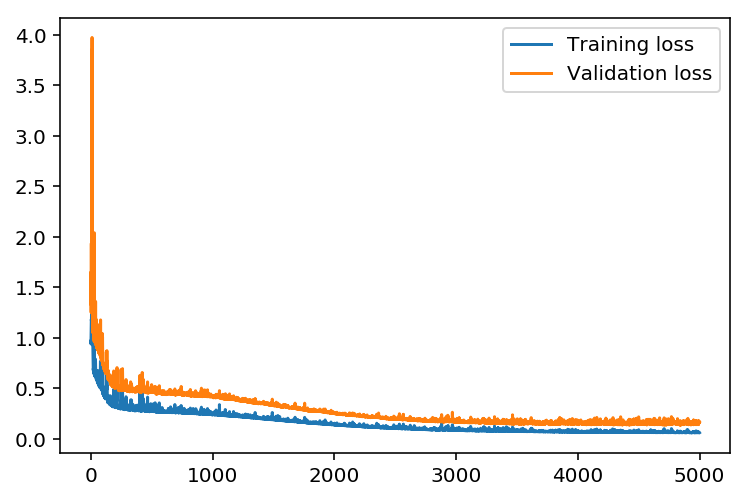

Start train for params iterations:8000,learning_rate:0.50,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.060 ... Validation loss: 0.145

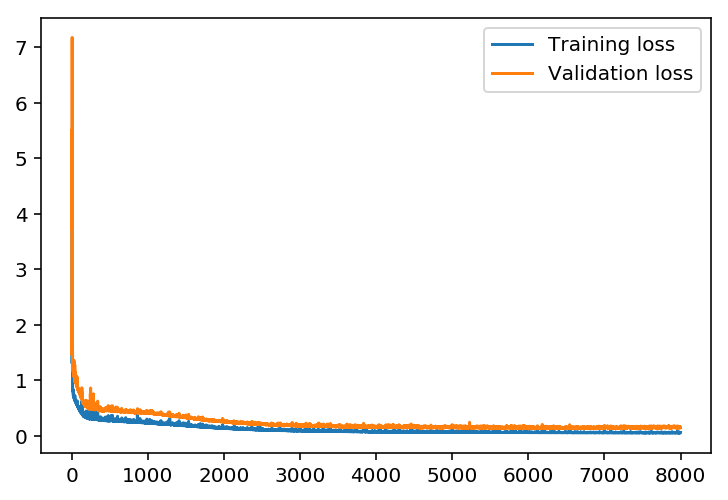

Start train for params iterations:10000,learning_rate:0.50,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.055 ... Validation loss: 0.147

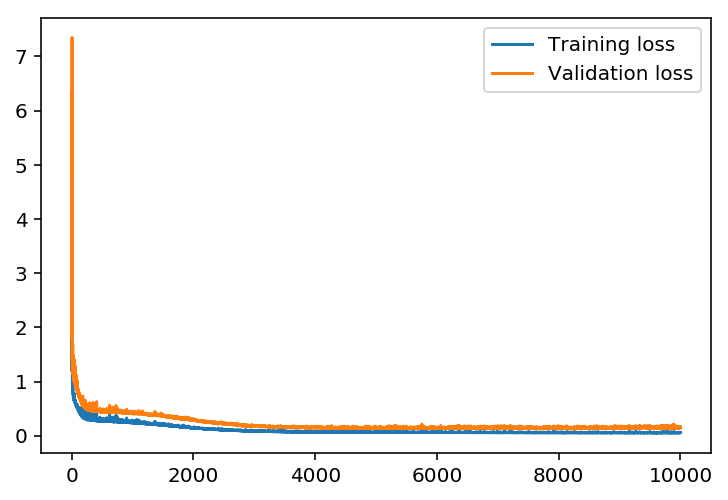

Start train for params iterations:1000,learning_rate:0.30,hidden_nodes:18,output_nodes:1
Progress: 99.9% ... Training loss: 0.265 ... Validation loss: 0.448

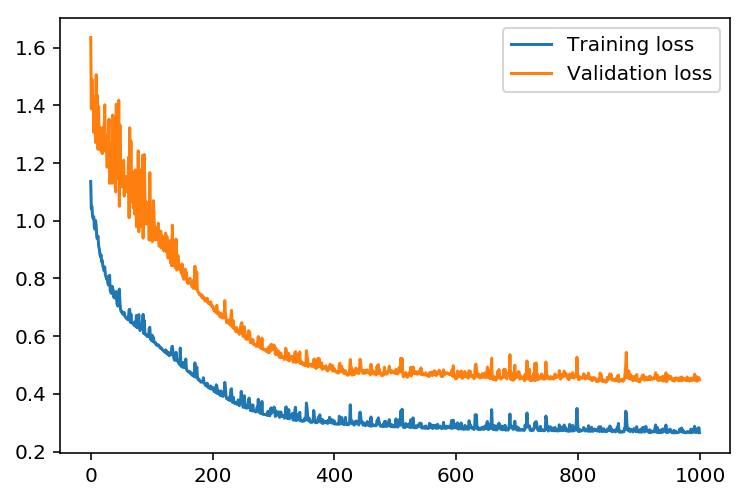

Start train for params iterations:1500,learning_rate:0.30,hidden_nodes:18,output_nodes:1
Progress: 99.9% ... Training loss: 0.259 ... Validation loss: 0.422

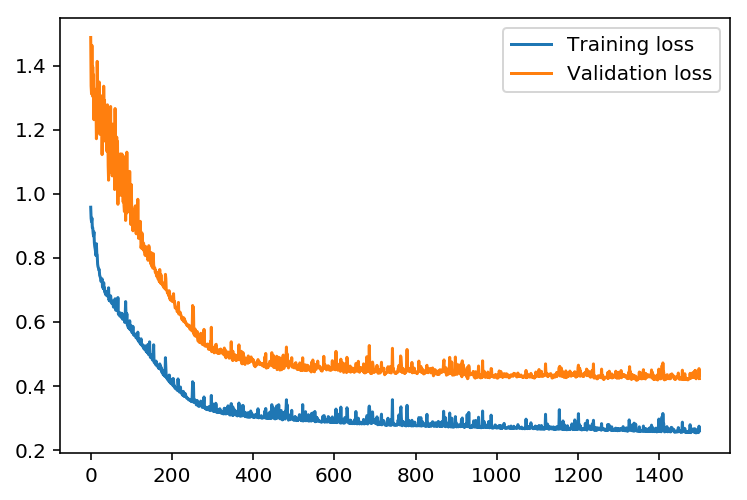

Start train for params iterations:2000,learning_rate:0.30,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.254 ... Validation loss: 0.419

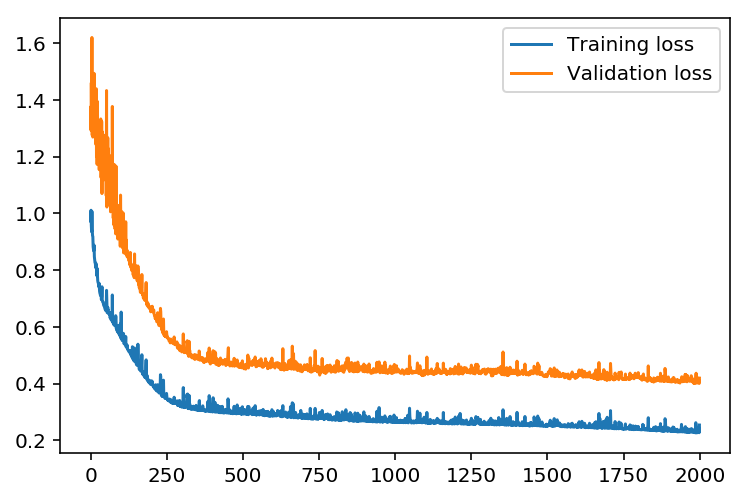

Start train for params iterations:3000,learning_rate:0.30,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.165 ... Validation loss: 0.301

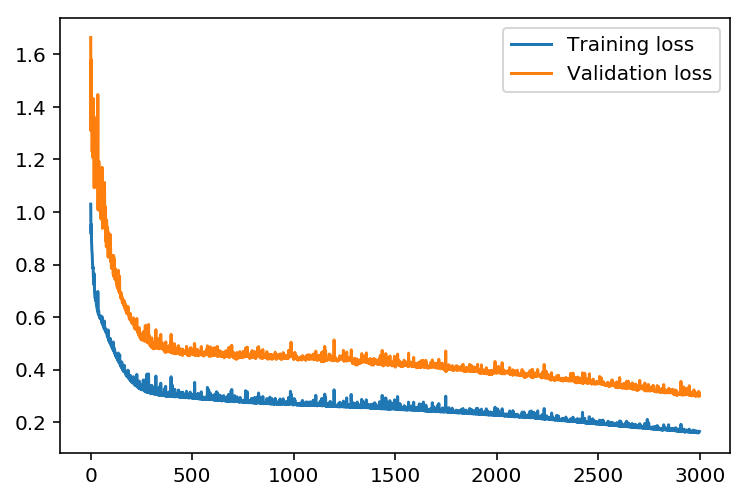

Start train for params iterations:5000,learning_rate:0.30,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.087 ... Validation loss: 0.183

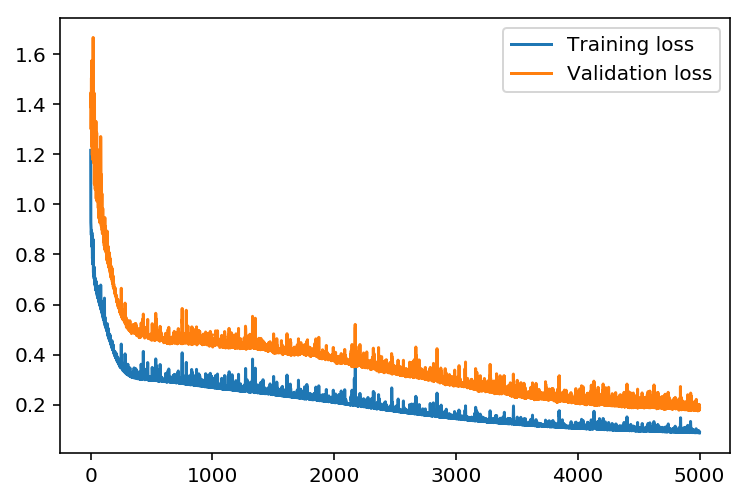

Start train for params iterations:8000,learning_rate:0.30,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.068 ... Validation loss: 0.148

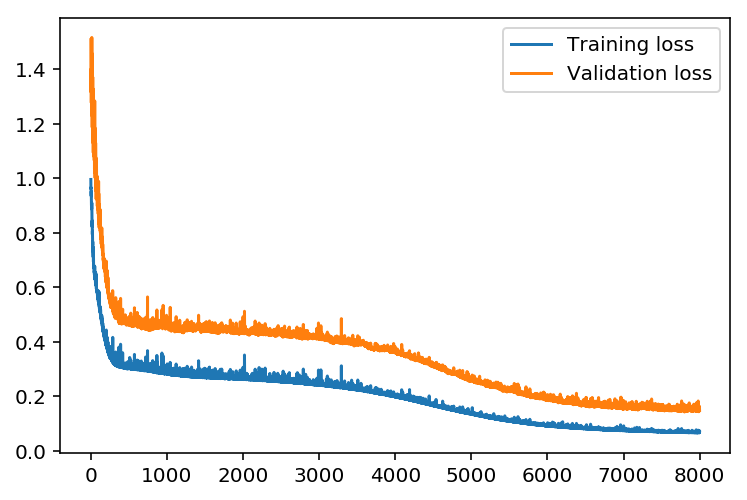

Start train for params iterations:10000,learning_rate:0.30,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.067 ... Validation loss: 0.148

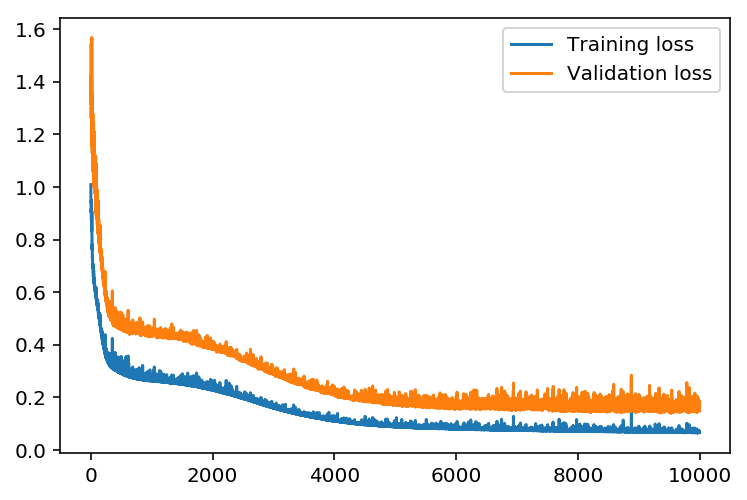

Start train for params iterations:1000,learning_rate:0.10,hidden_nodes:18,output_nodes:1
Progress: 99.9% ... Training loss: 0.312 ... Validation loss: 0.499

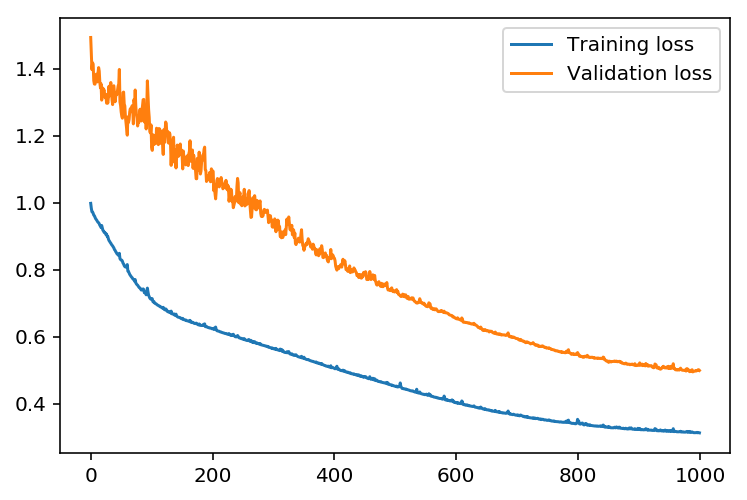

Start train for params iterations:1500,learning_rate:0.10,hidden_nodes:18,output_nodes:1
Progress: 99.9% ... Training loss: 0.301 ... Validation loss: 0.464

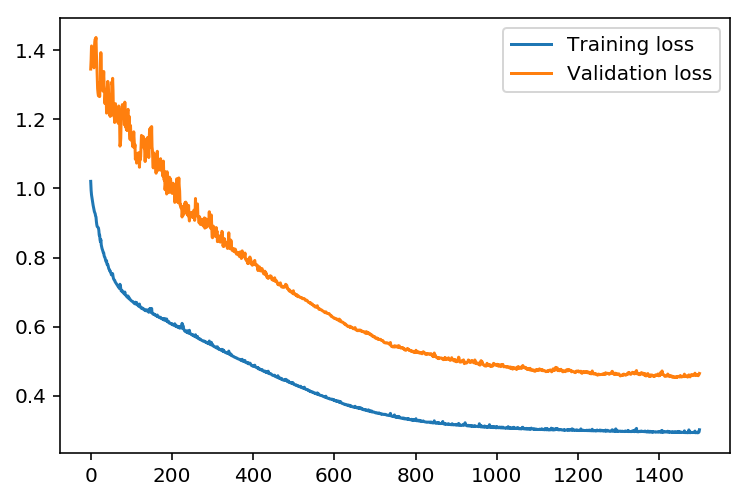

Start train for params iterations:2000,learning_rate:0.10,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.276 ... Validation loss: 0.443

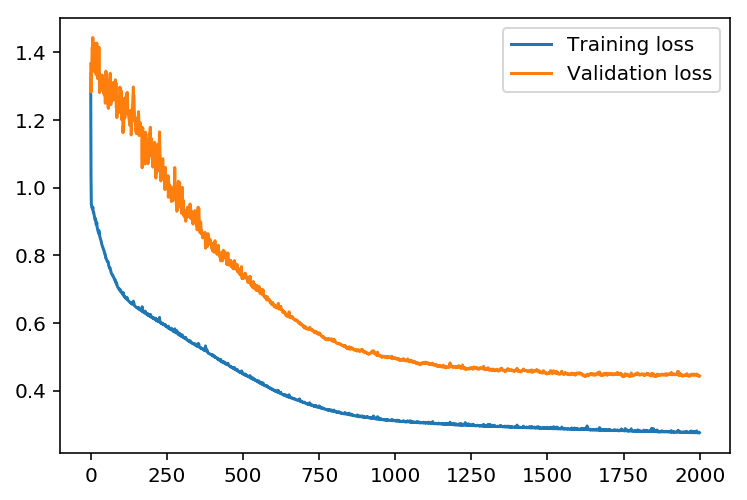

Start train for params iterations:3000,learning_rate:0.10,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.259 ... Validation loss: 0.431

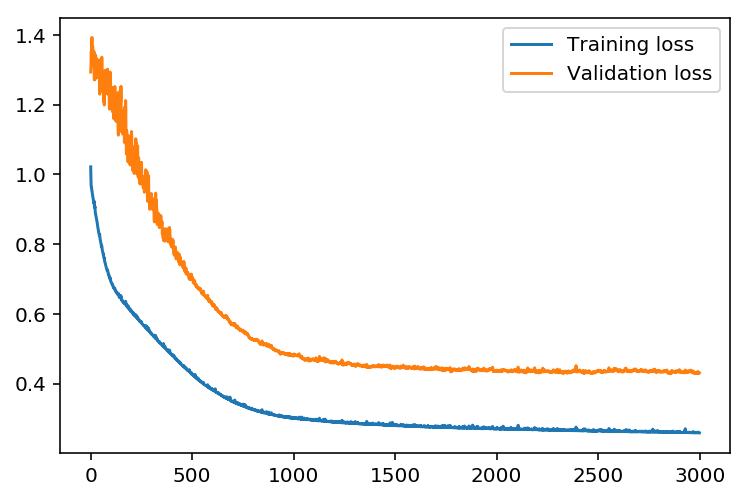

Start train for params iterations:5000,learning_rate:0.10,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.248 ... Validation loss: 0.426

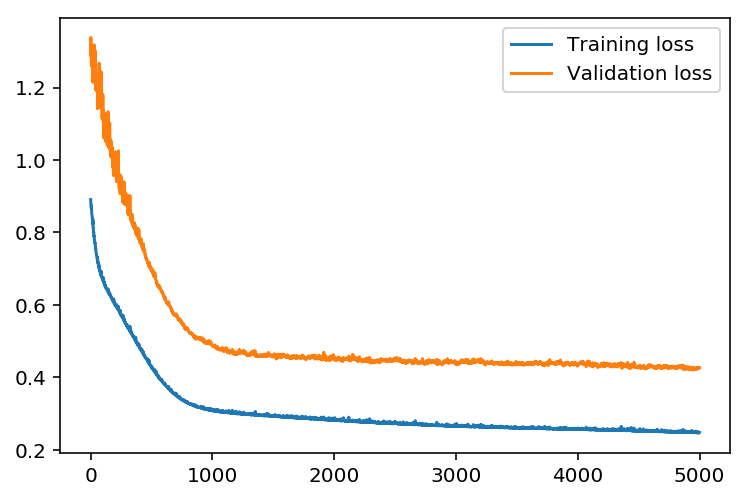

Start train for params iterations:8000,learning_rate:0.10,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.150 ... Validation loss: 0.282

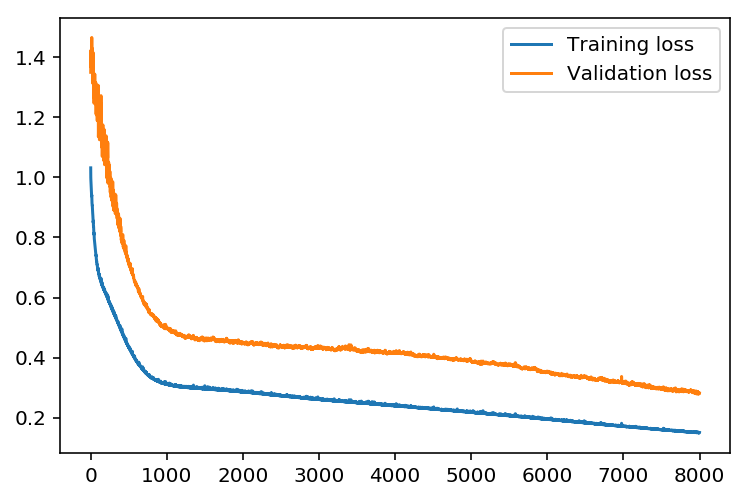

Start train for params iterations:10000,learning_rate:0.10,hidden_nodes:18,output_nodes:1
Progress: 100.0% ... Training loss: 0.130 ... Validation loss: 0.260

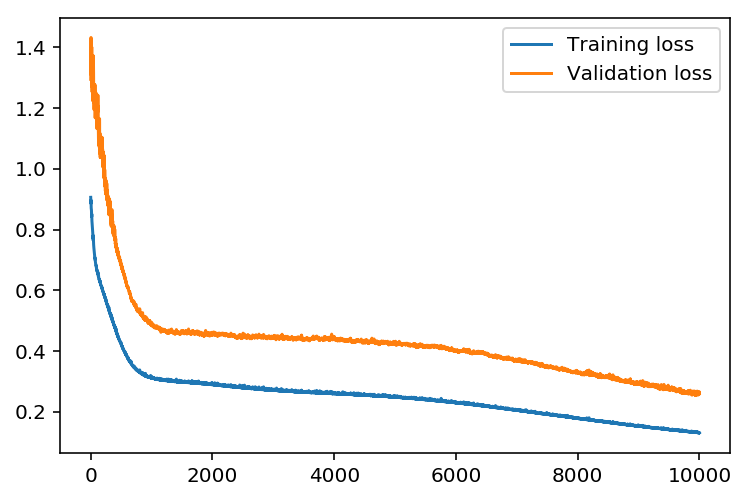

Start train for params iterations:1000,learning_rate:0.90,hidden_nodes:16,output_nodes:1
Progress: 99.9% ... Training loss: 0.137 ... Validation loss: 0.276

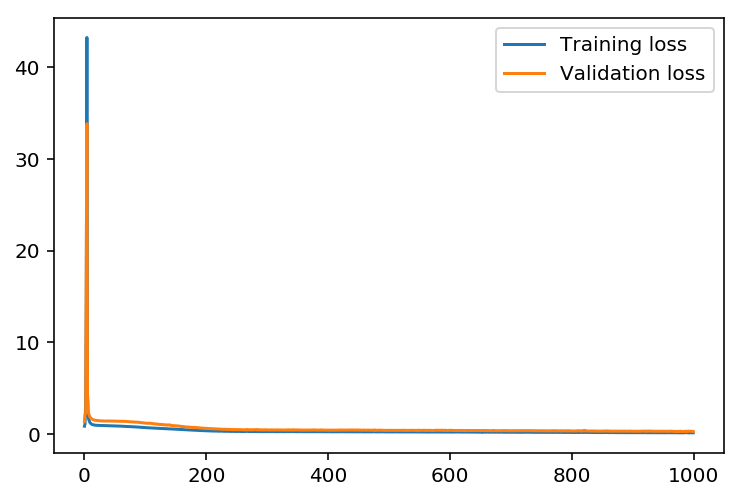

Start train for params iterations:1500,learning_rate:0.90,hidden_nodes:16,output_nodes:1
Progress: 99.9% ... Training loss: 0.168 ... Validation loss: 0.292

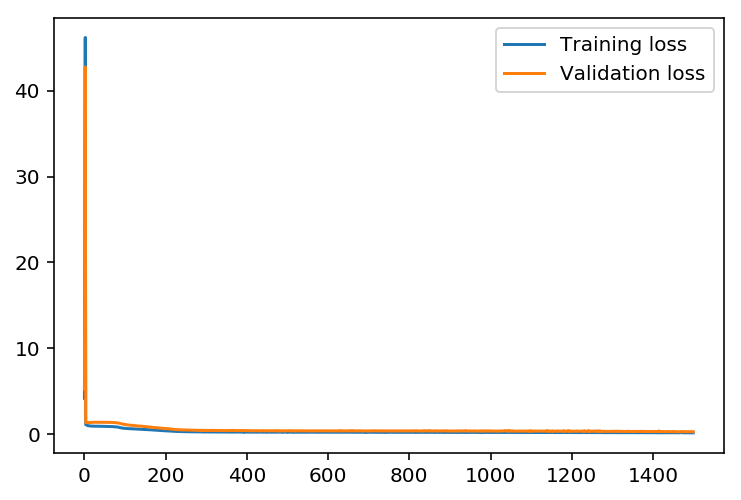

Start train for params iterations:2000,learning_rate:0.90,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.101 ... Validation loss: 0.195

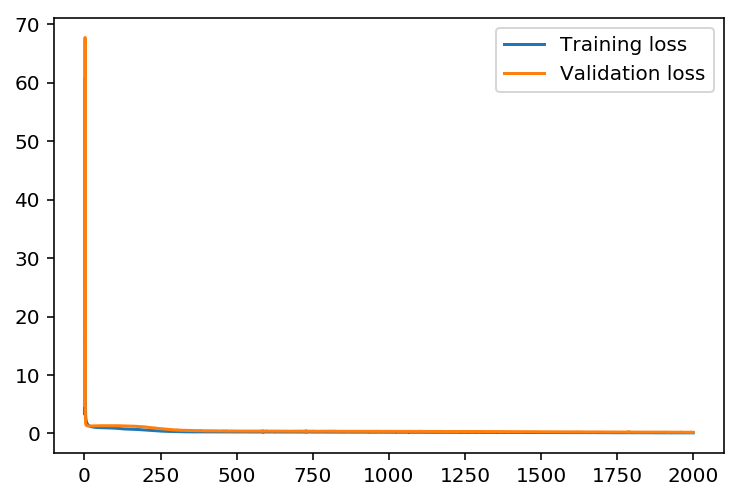

Start train for params iterations:3000,learning_rate:0.90,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.066 ... Validation loss: 0.142

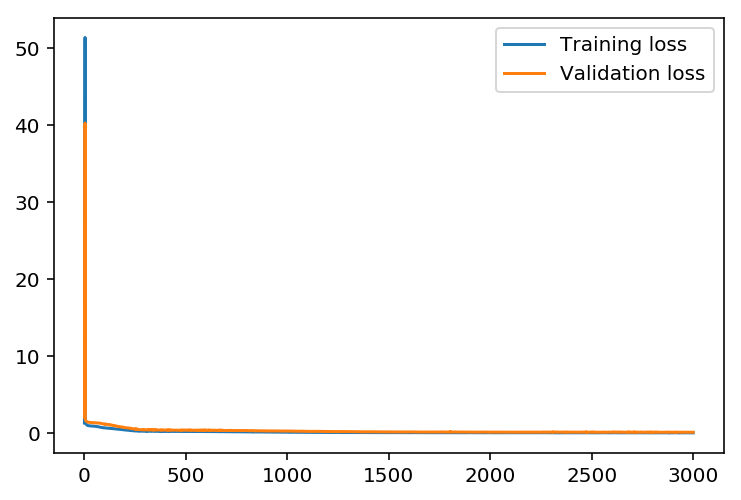

Start train for params iterations:5000,learning_rate:0.90,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.055 ... Validation loss: 0.137

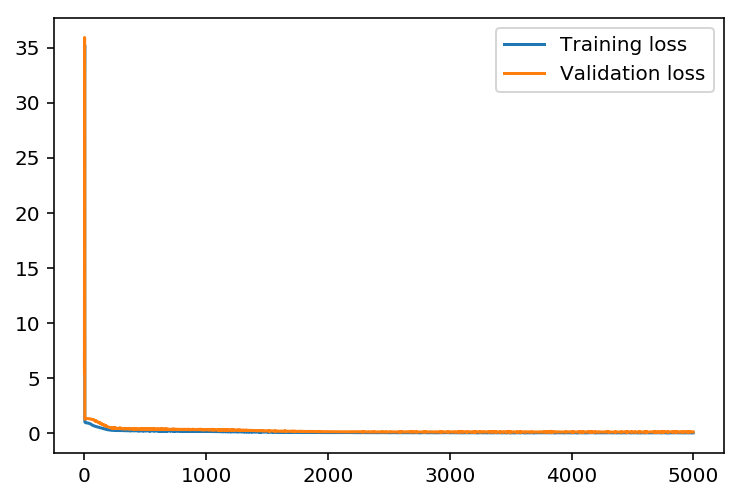

Start train for params iterations:8000,learning_rate:0.90,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.060 ... Validation loss: 0.168

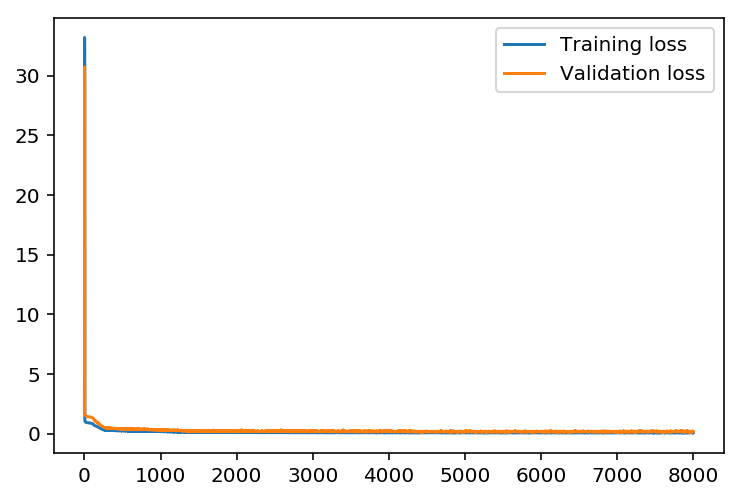

Start train for params iterations:10000,learning_rate:0.90,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.053 ... Validation loss: 0.132

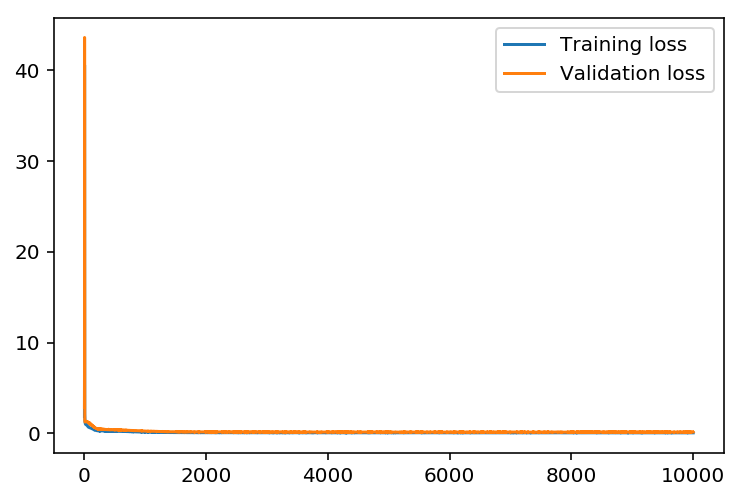

Start train for params iterations:1000,learning_rate:0.70,hidden_nodes:16,output_nodes:1
Progress: 99.9% ... Training loss: 0.200 ... Validation loss: 0.345

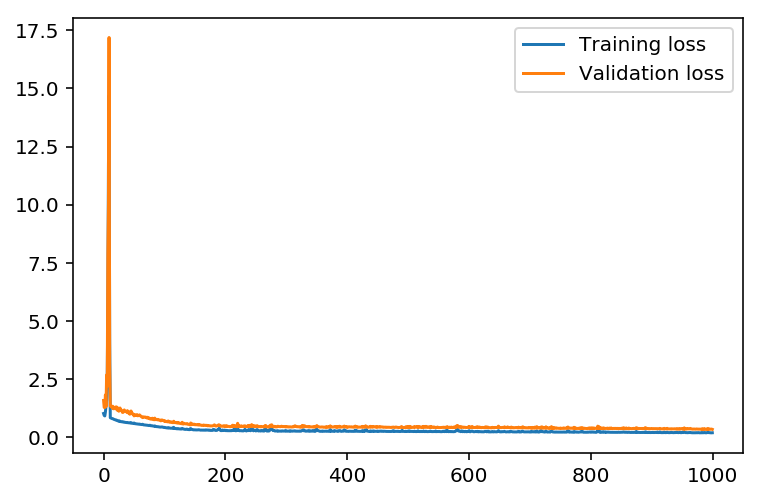

Start train for params iterations:1500,learning_rate:0.70,hidden_nodes:16,output_nodes:1
Progress: 99.9% ... Training loss: 0.112 ... Validation loss: 0.224

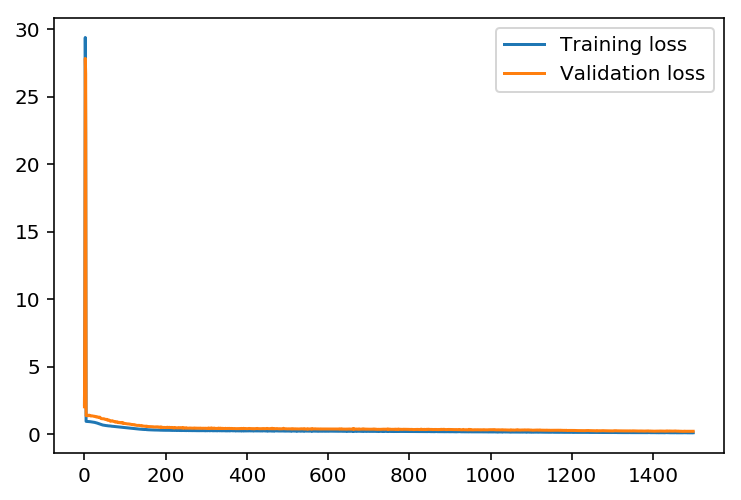

Start train for params iterations:2000,learning_rate:0.70,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.077 ... Validation loss: 0.162

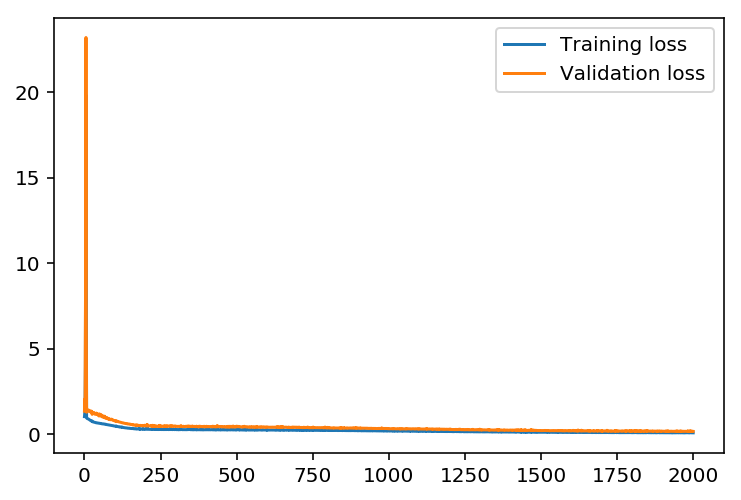

Start train for params iterations:3000,learning_rate:0.70,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.064 ... Validation loss: 0.152

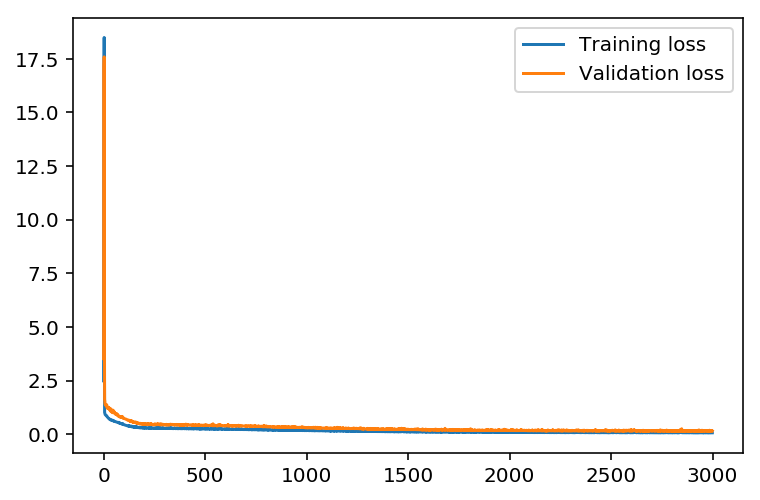

Start train for params iterations:5000,learning_rate:0.70,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.059 ... Validation loss: 0.167

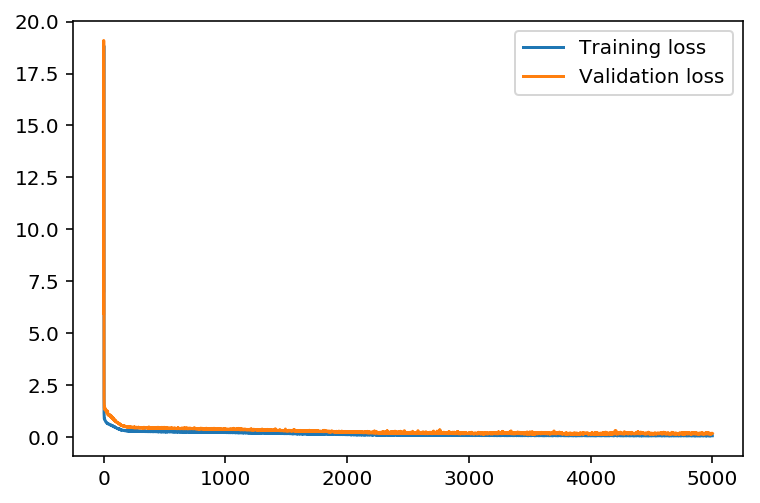

Start train for params iterations:8000,learning_rate:0.70,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.049 ... Validation loss: 0.129

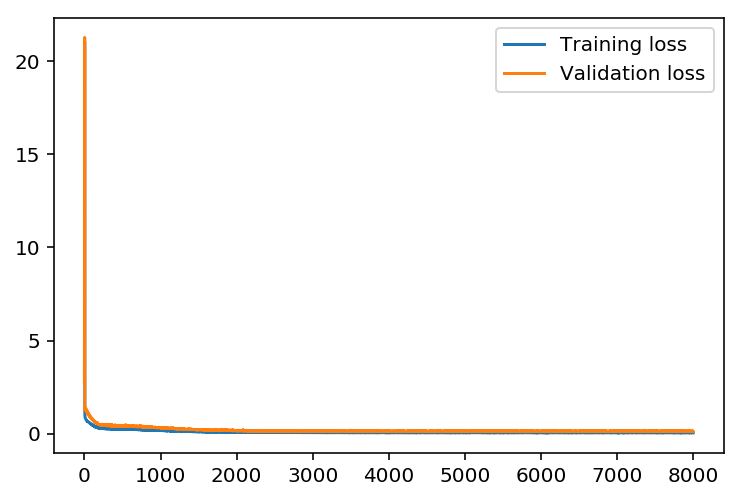

Start train for params iterations:10000,learning_rate:0.70,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.057 ... Validation loss: 0.157

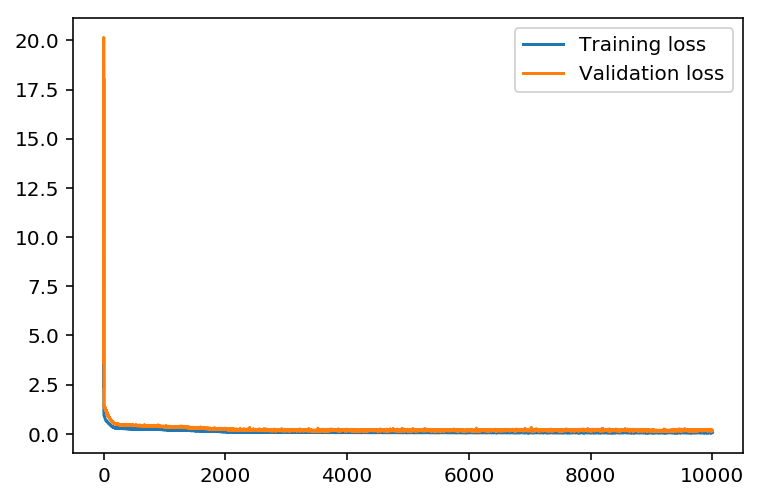

Start train for params iterations:1000,learning_rate:0.50,hidden_nodes:16,output_nodes:1
Progress: 99.9% ... Training loss: 0.253 ... Validation loss: 0.434

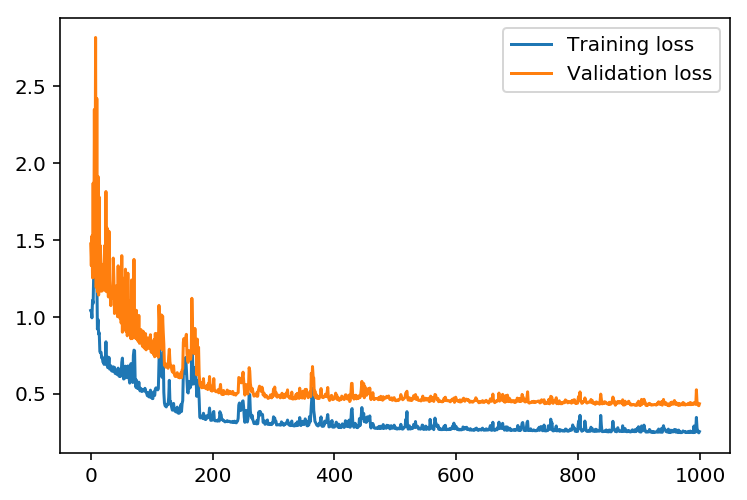

Start train for params iterations:1500,learning_rate:0.50,hidden_nodes:16,output_nodes:1
Progress: 99.9% ... Training loss: 0.243 ... Validation loss: 0.398

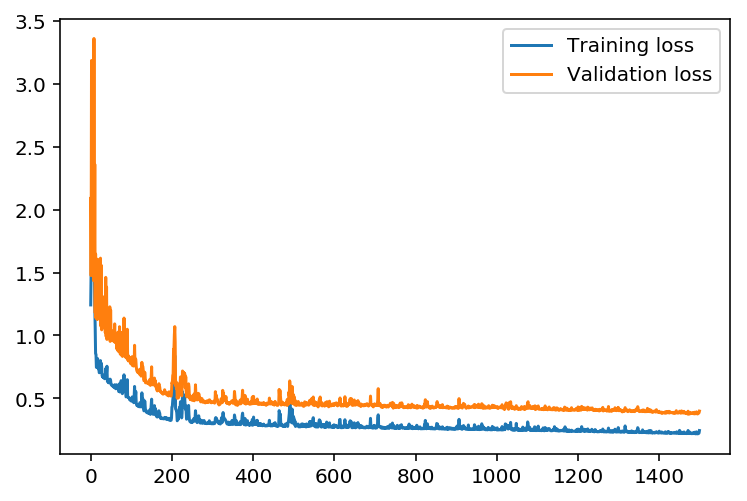

Start train for params iterations:2000,learning_rate:0.50,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.172 ... Validation loss: 0.312

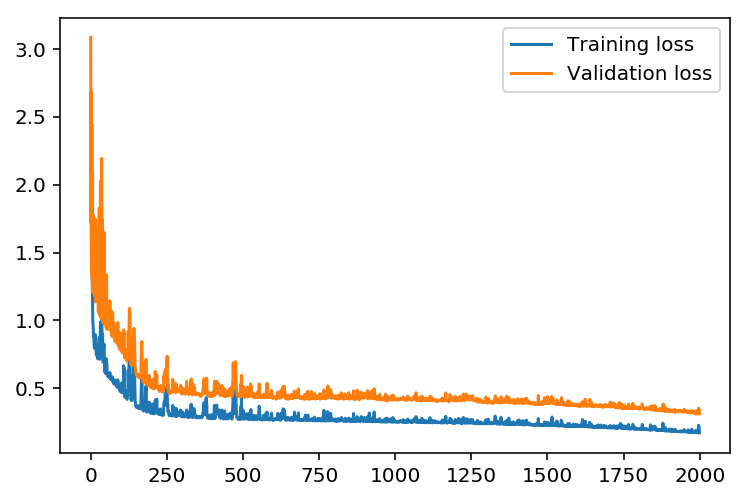

Start train for params iterations:3000,learning_rate:0.50,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.097 ... Validation loss: 0.186

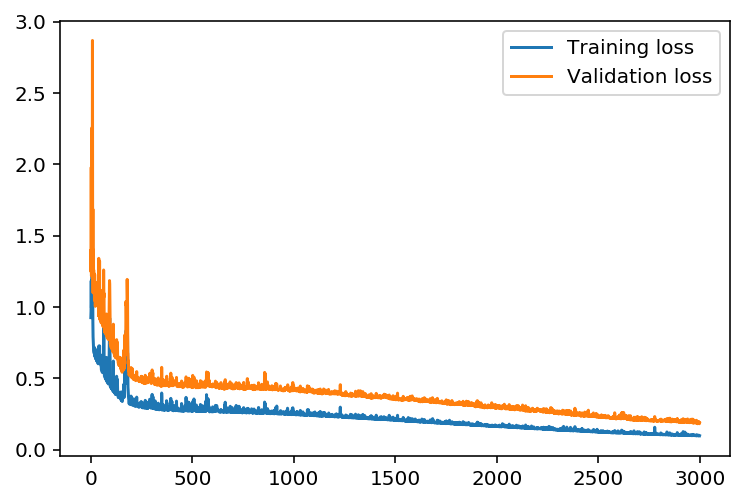

Start train for params iterations:5000,learning_rate:0.50,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.069 ... Validation loss: 0.173

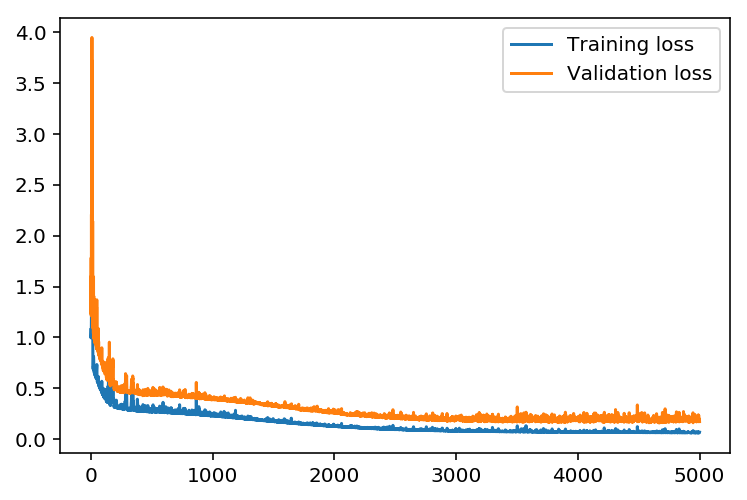

Start train for params iterations:8000,learning_rate:0.50,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.062 ... Validation loss: 0.132

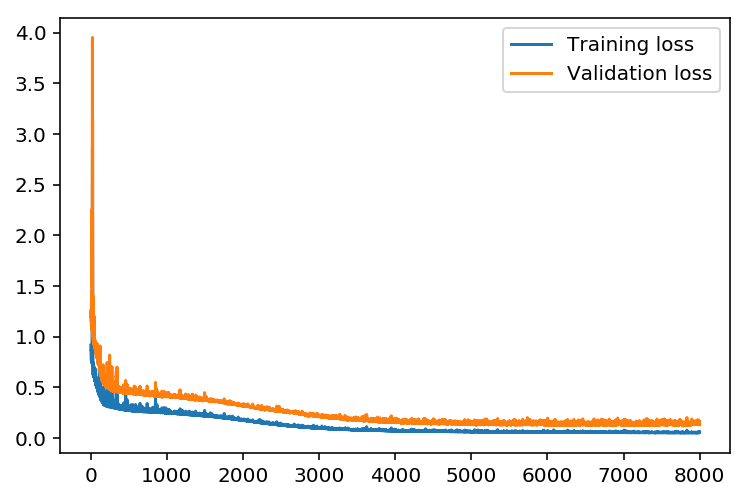

Start train for params iterations:10000,learning_rate:0.50,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.052 ... Validation loss: 0.144

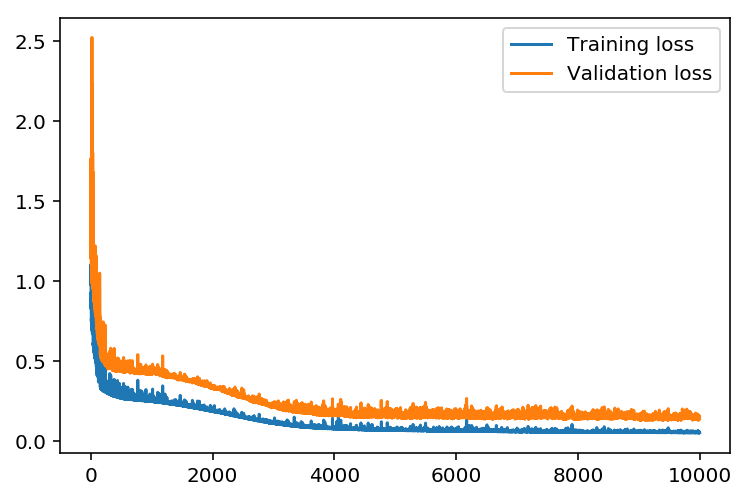

Start train for params iterations:1000,learning_rate:0.30,hidden_nodes:16,output_nodes:1
Progress: 99.9% ... Training loss: 0.269 ... Validation loss: 0.449

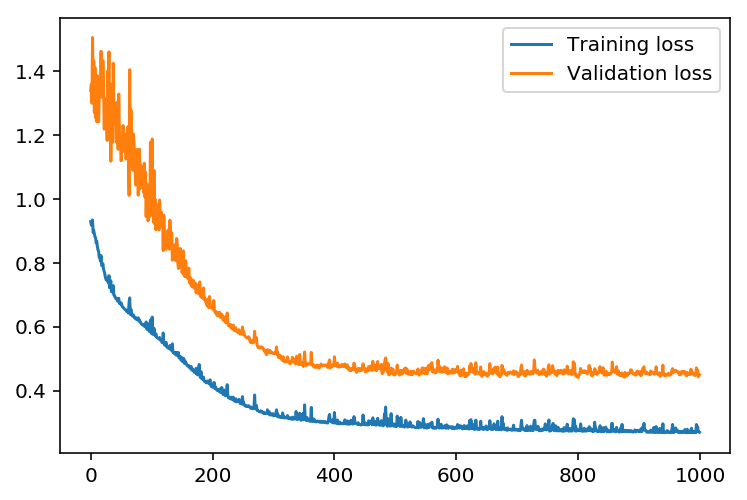

Start train for params iterations:1500,learning_rate:0.30,hidden_nodes:16,output_nodes:1
Progress: 99.9% ... Training loss: 0.257 ... Validation loss: 0.438

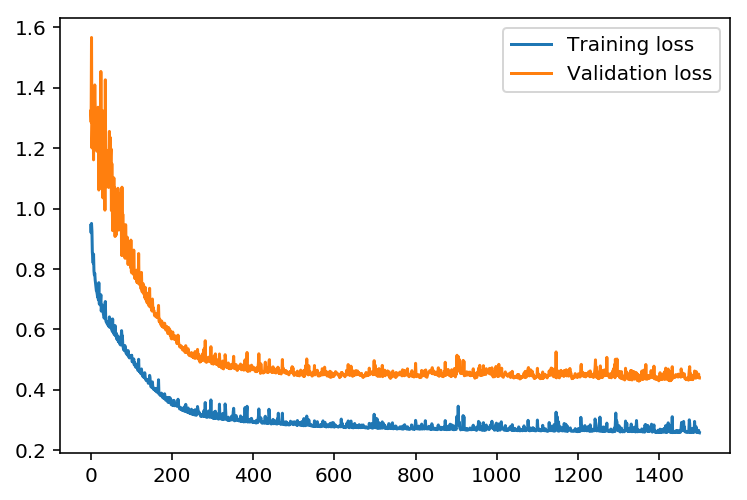

Start train for params iterations:2000,learning_rate:0.30,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.233 ... Validation loss: 0.400

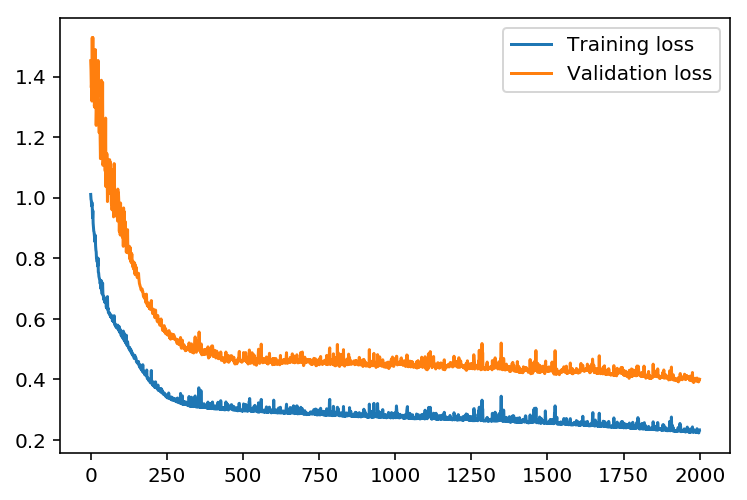

Start train for params iterations:3000,learning_rate:0.30,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.159 ... Validation loss: 0.295

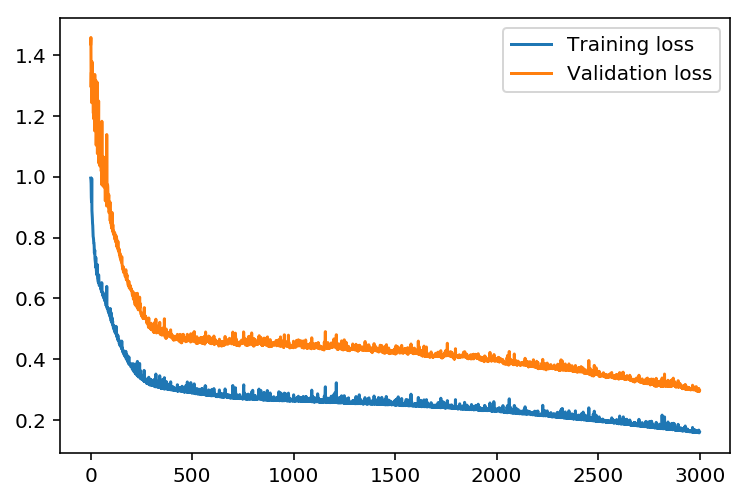

Start train for params iterations:5000,learning_rate:0.30,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.089 ... Validation loss: 0.155

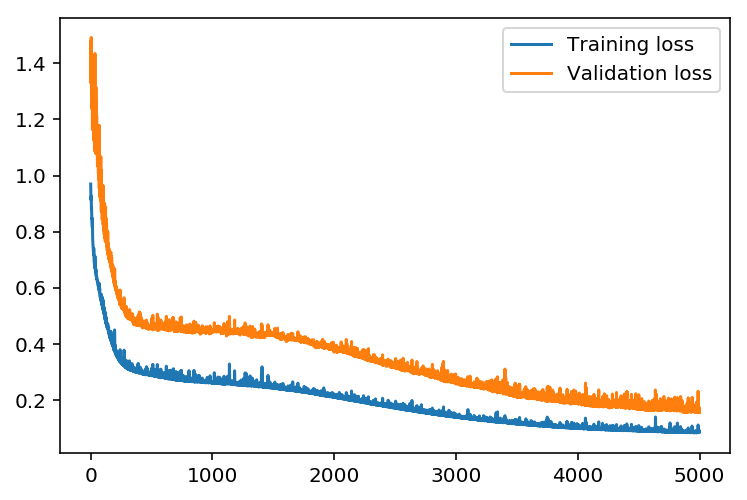

Start train for params iterations:8000,learning_rate:0.30,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.065 ... Validation loss: 0.148

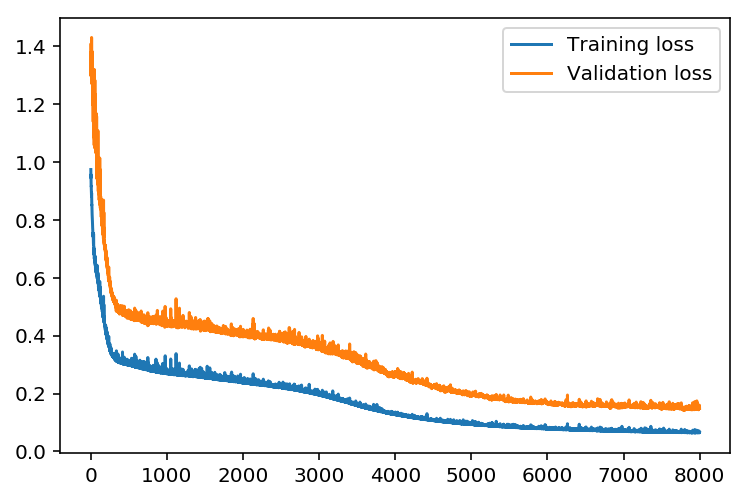

Start train for params iterations:10000,learning_rate:0.30,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.063 ... Validation loss: 0.158

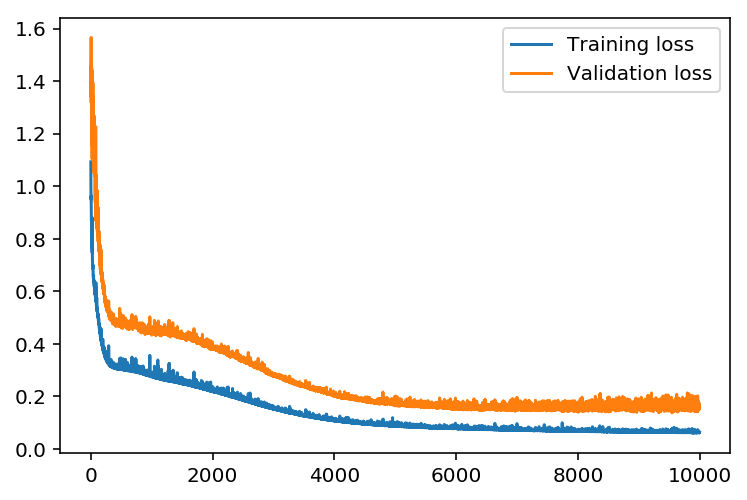

Start train for params iterations:1000,learning_rate:0.10,hidden_nodes:16,output_nodes:1
Progress: 99.9% ... Training loss: 0.307 ... Validation loss: 0.483

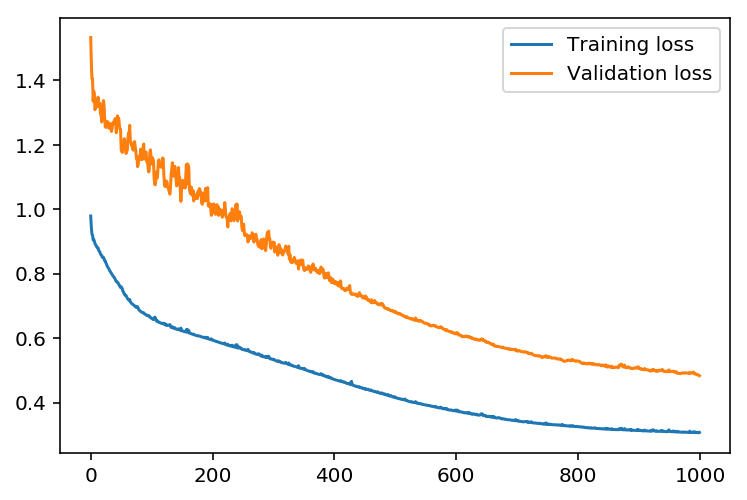

Start train for params iterations:1500,learning_rate:0.10,hidden_nodes:16,output_nodes:1
Progress: 99.9% ... Training loss: 0.287 ... Validation loss: 0.463

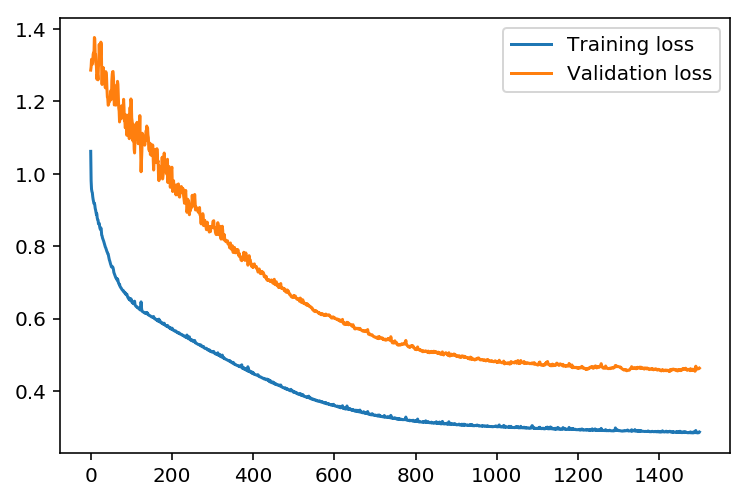

Start train for params iterations:2000,learning_rate:0.10,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.275 ... Validation loss: 0.443

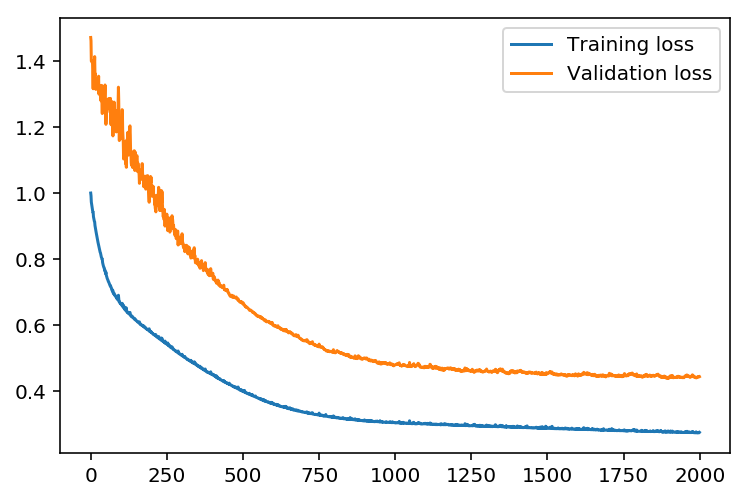

Start train for params iterations:3000,learning_rate:0.10,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.257 ... Validation loss: 0.425

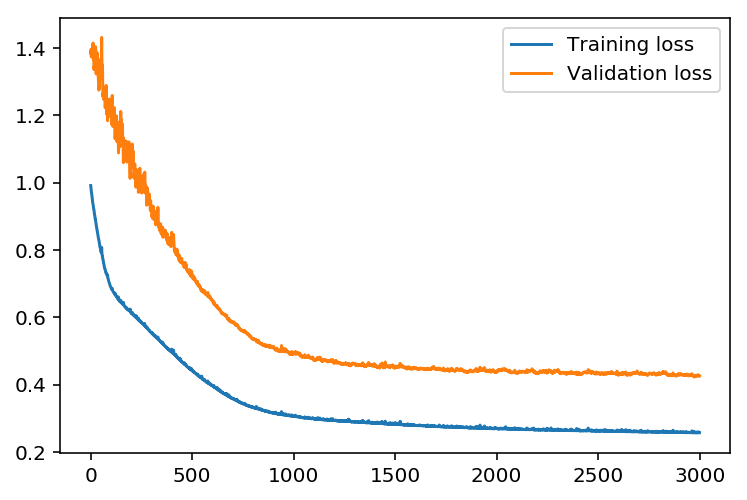

Start train for params iterations:5000,learning_rate:0.10,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.219 ... Validation loss: 0.382

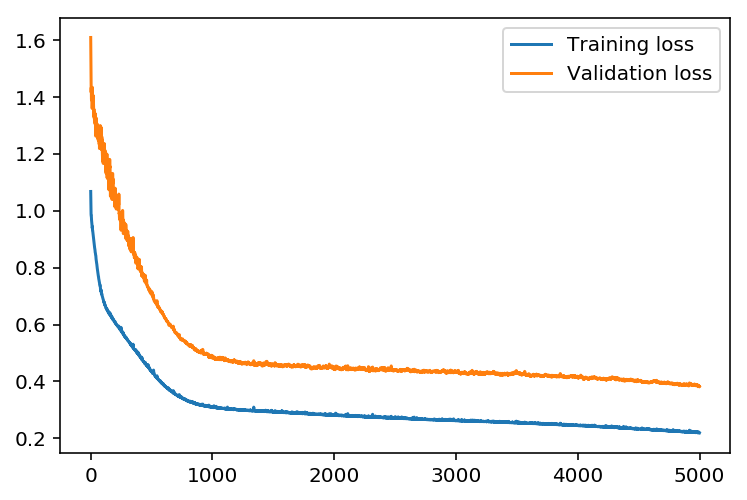

Start train for params iterations:8000,learning_rate:0.10,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.193 ... Validation loss: 0.359

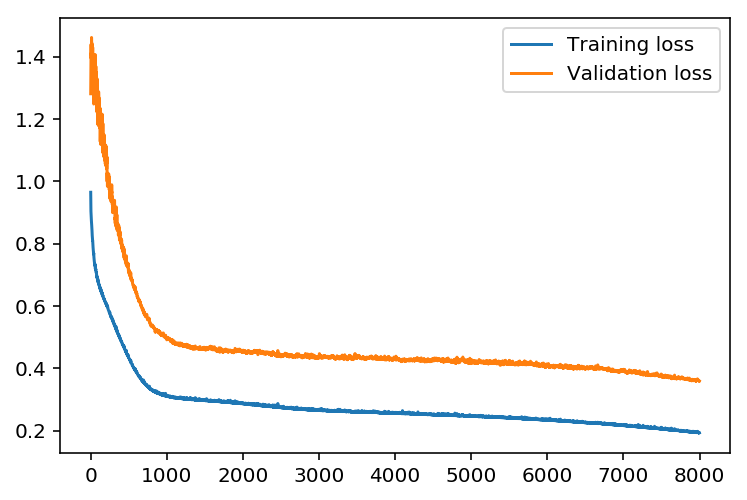

Start train for params iterations:10000,learning_rate:0.10,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.161 ... Validation loss: 0.297

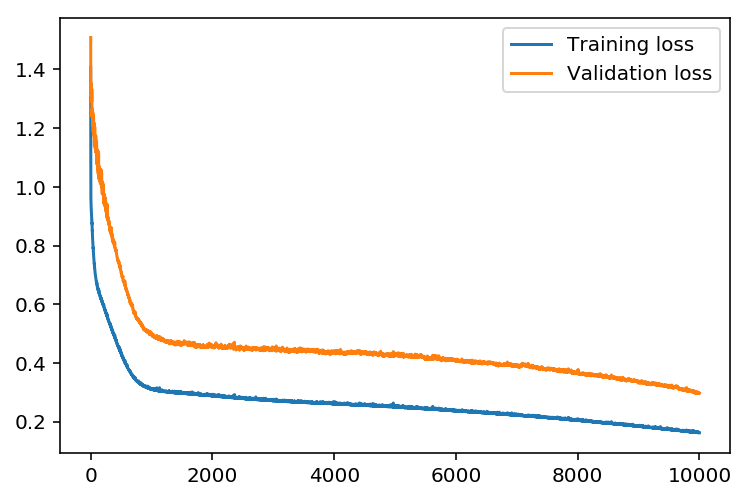

Start train for params iterations:1000,learning_rate:0.90,hidden_nodes:14,output_nodes:1
Progress: 99.9% ... Training loss: 0.136 ... Validation loss: 0.305

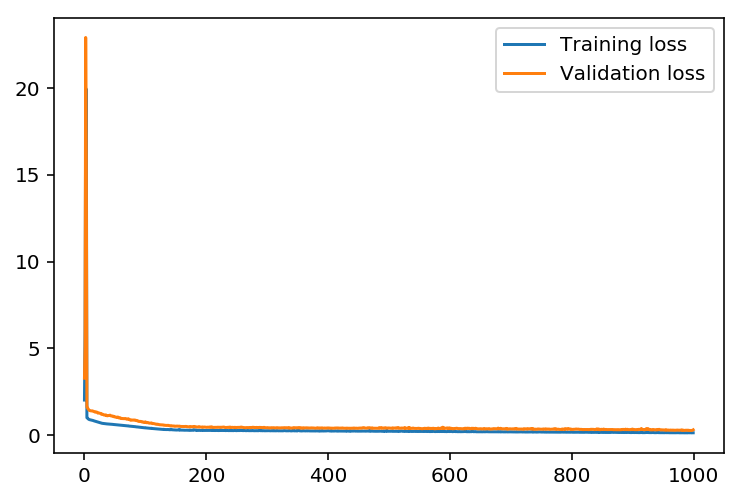

Start train for params iterations:1500,learning_rate:0.90,hidden_nodes:14,output_nodes:1
Progress: 99.9% ... Training loss: 0.087 ... Validation loss: 0.192

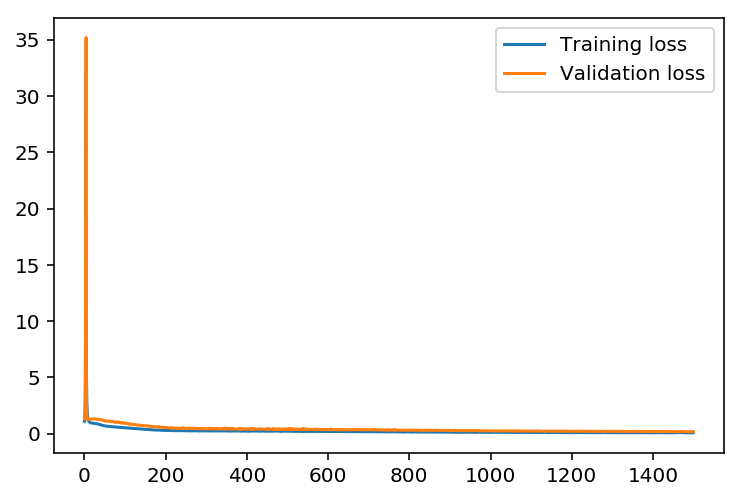

Start train for params iterations:2000,learning_rate:0.90,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.106 ... Validation loss: 0.227

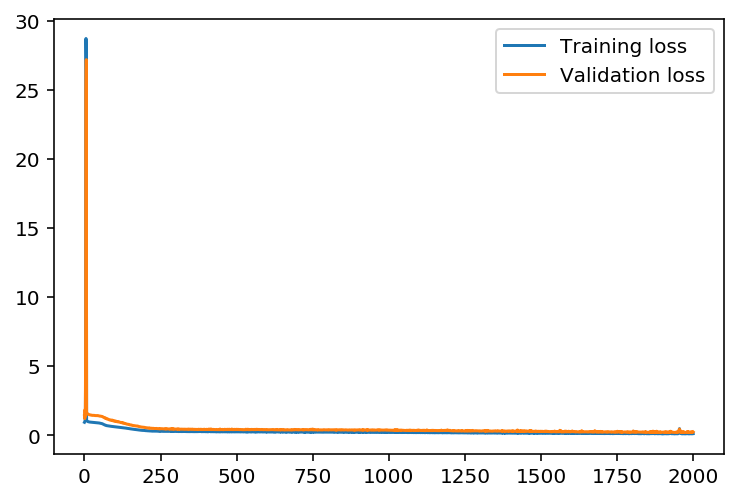

Start train for params iterations:3000,learning_rate:0.90,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.076 ... Validation loss: 0.140

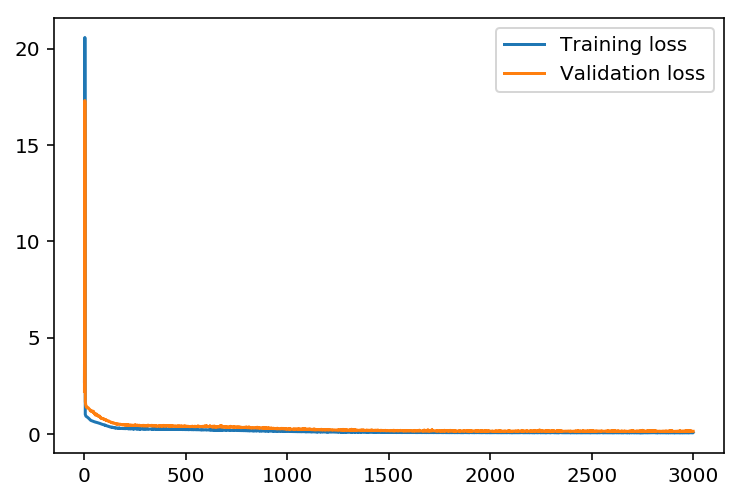

Start train for params iterations:5000,learning_rate:0.90,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.061 ... Validation loss: 0.151

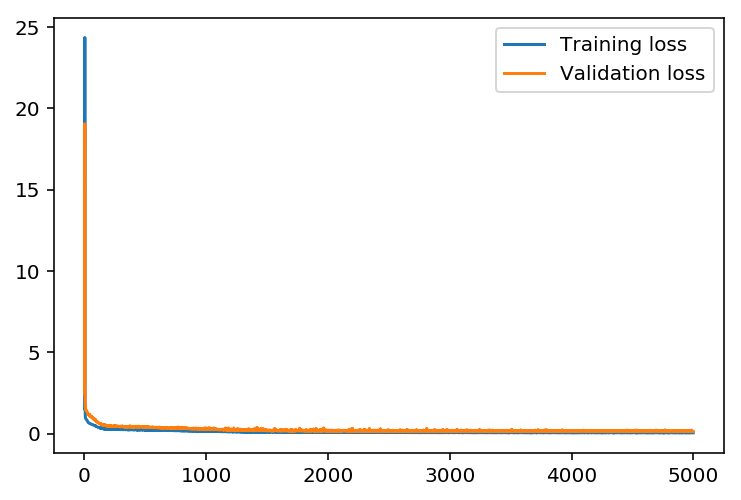

Start train for params iterations:8000,learning_rate:0.90,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.051 ... Validation loss: 0.118

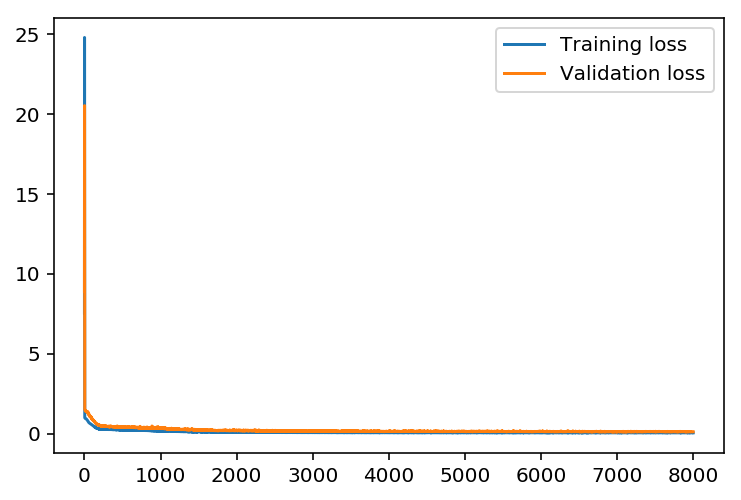

Start train for params iterations:10000,learning_rate:0.90,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.049 ... Validation loss: 0.162

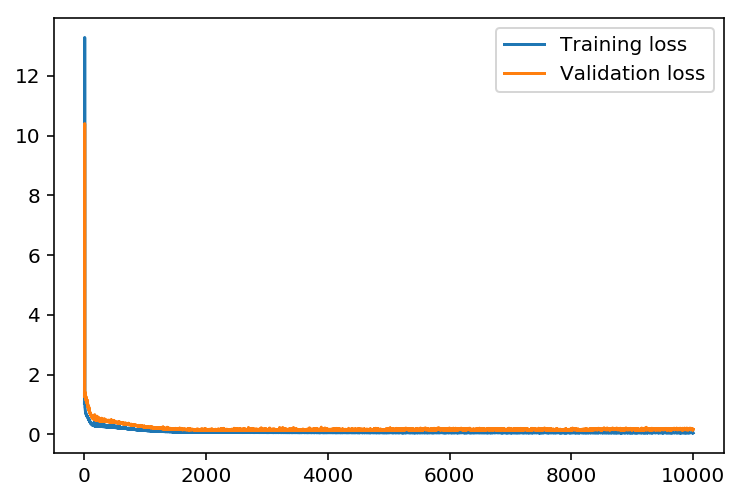

Start train for params iterations:1000,learning_rate:0.70,hidden_nodes:14,output_nodes:1
Progress: 99.9% ... Training loss: 0.178 ... Validation loss: 0.321

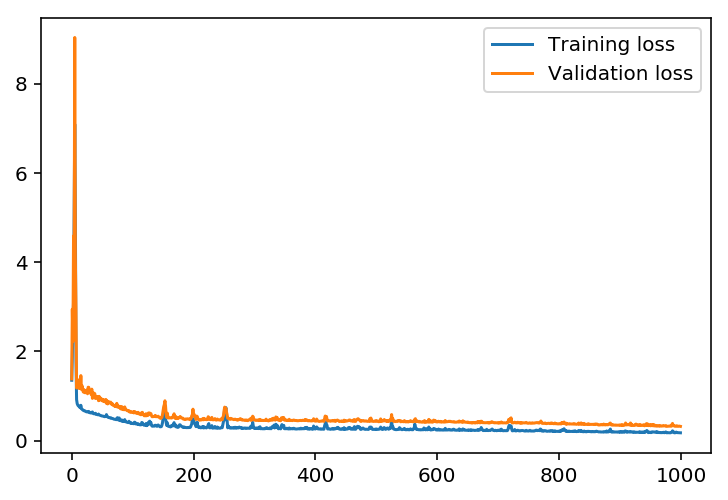

Start train for params iterations:1500,learning_rate:0.70,hidden_nodes:14,output_nodes:1
Progress: 99.9% ... Training loss: 0.106 ... Validation loss: 0.232

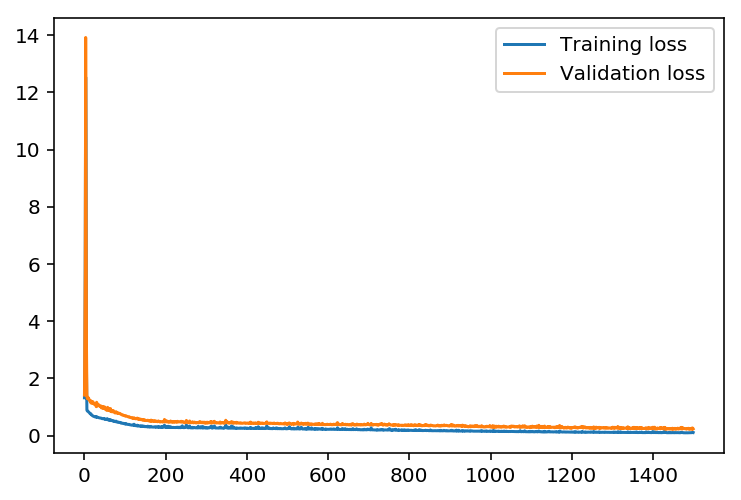

Start train for params iterations:2000,learning_rate:0.70,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.090 ... Validation loss: 0.182

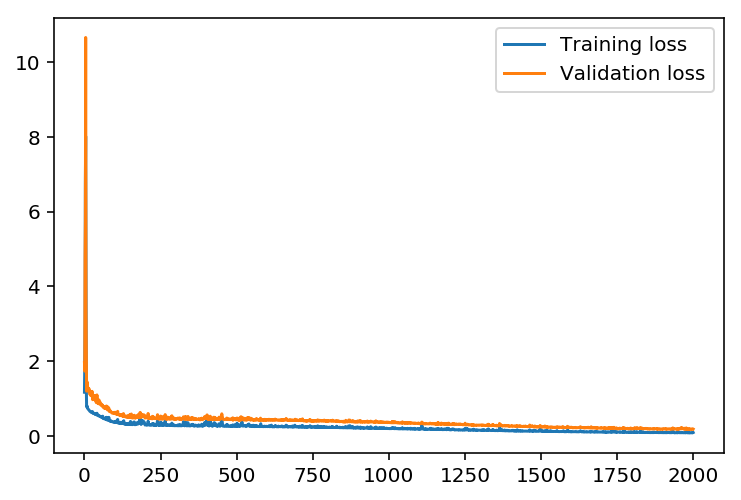

Start train for params iterations:3000,learning_rate:0.70,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.070 ... Validation loss: 0.149

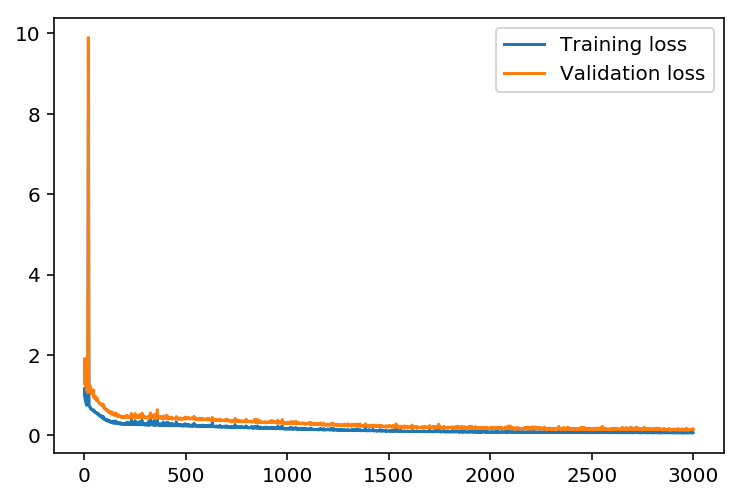

Start train for params iterations:5000,learning_rate:0.70,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.063 ... Validation loss: 0.170

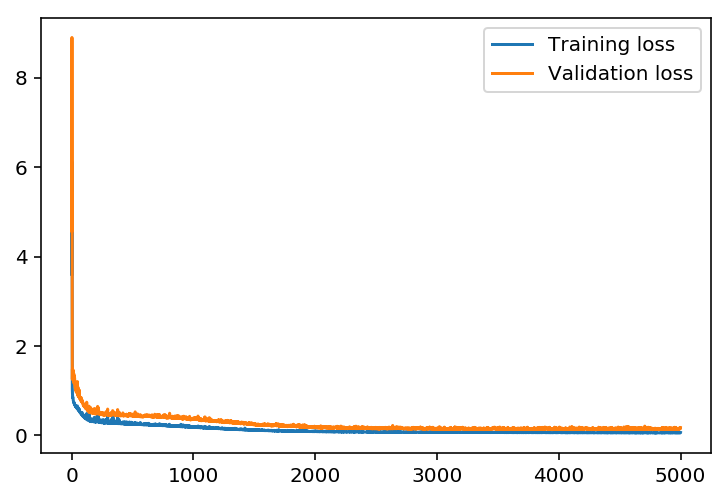

Start train for params iterations:8000,learning_rate:0.70,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.049 ... Validation loss: 0.121

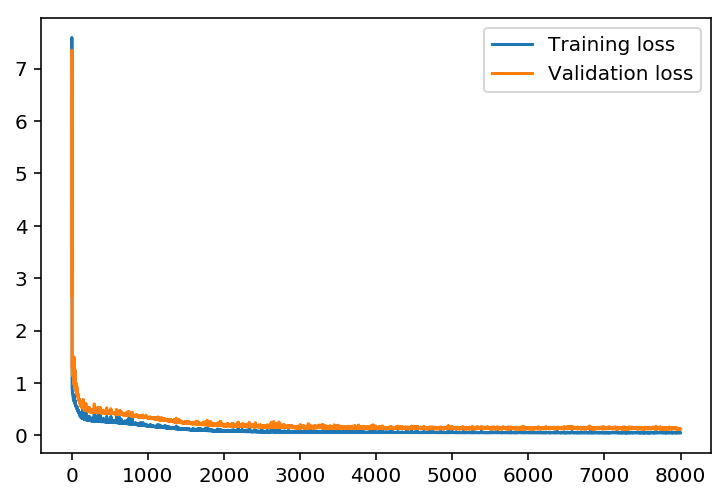

Start train for params iterations:10000,learning_rate:0.70,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.051 ... Validation loss: 0.153

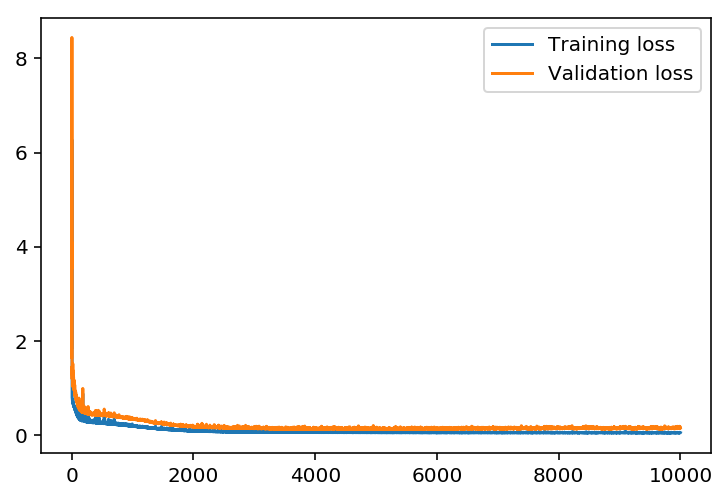

Start train for params iterations:1000,learning_rate:0.50,hidden_nodes:14,output_nodes:1
Progress: 99.9% ... Training loss: 0.258 ... Validation loss: 0.439

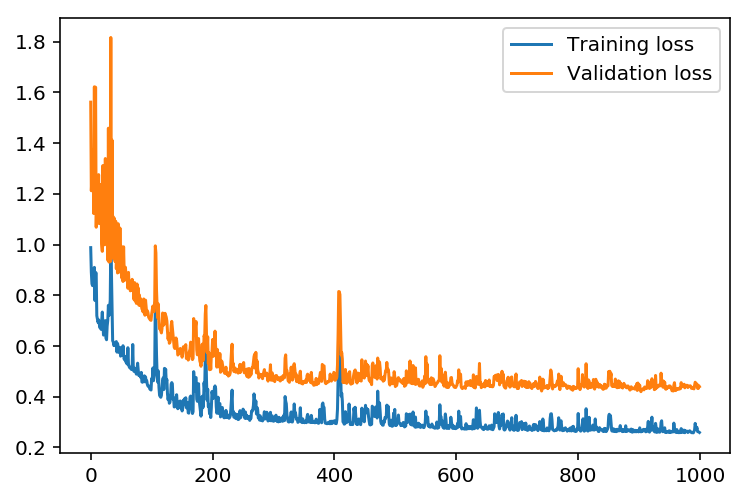

Start train for params iterations:1500,learning_rate:0.50,hidden_nodes:14,output_nodes:1
Progress: 99.9% ... Training loss: 0.231 ... Validation loss: 0.401

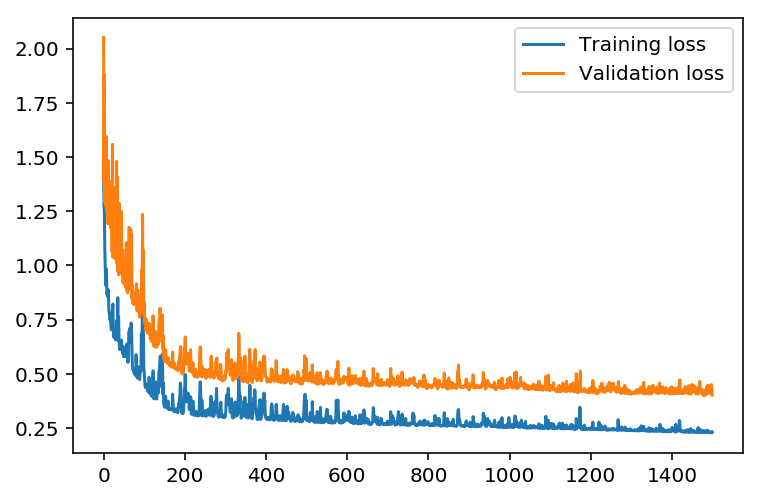

Start train for params iterations:2000,learning_rate:0.50,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.135 ... Validation loss: 0.238

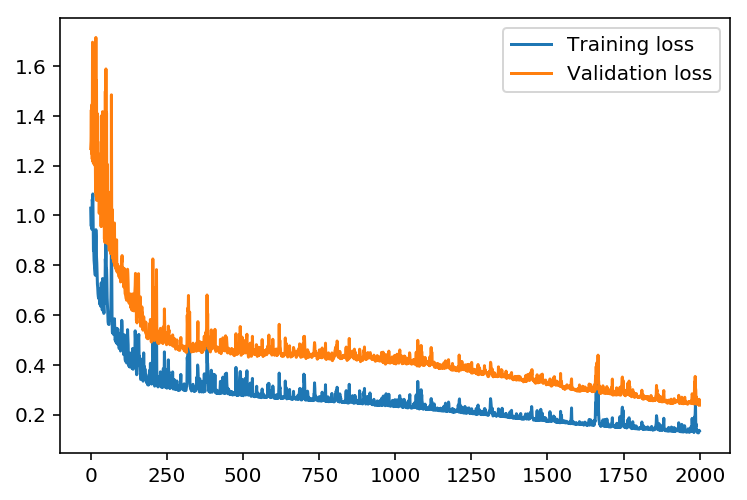

Start train for params iterations:3000,learning_rate:0.50,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.099 ... Validation loss: 0.202

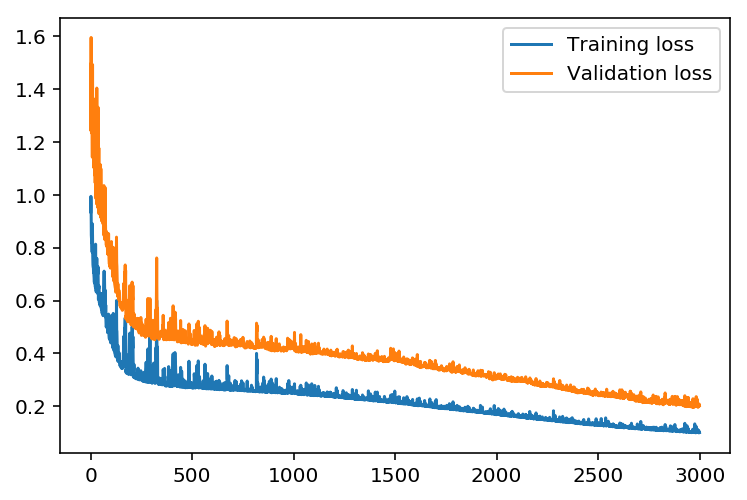

Start train for params iterations:5000,learning_rate:0.50,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.069 ... Validation loss: 0.248

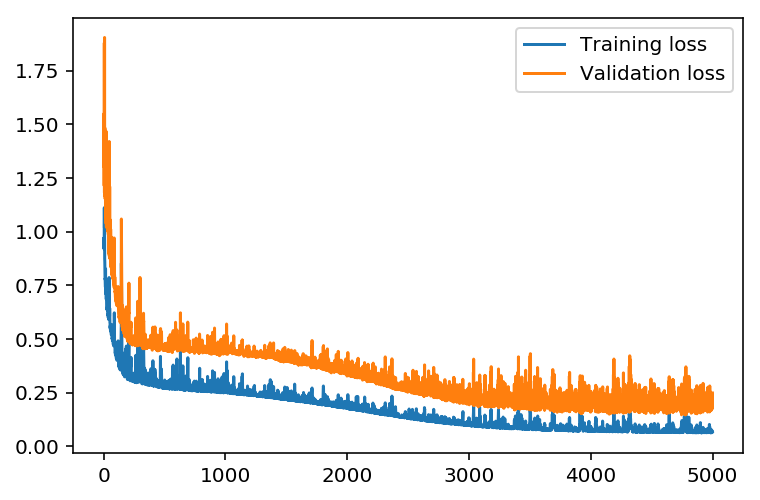

Start train for params iterations:8000,learning_rate:0.50,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.057 ... Validation loss: 0.157

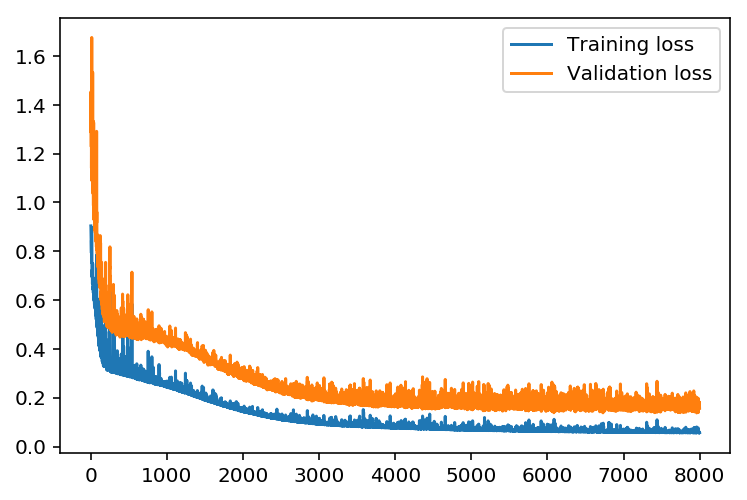

Start train for params iterations:10000,learning_rate:0.50,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.053 ... Validation loss: 0.166

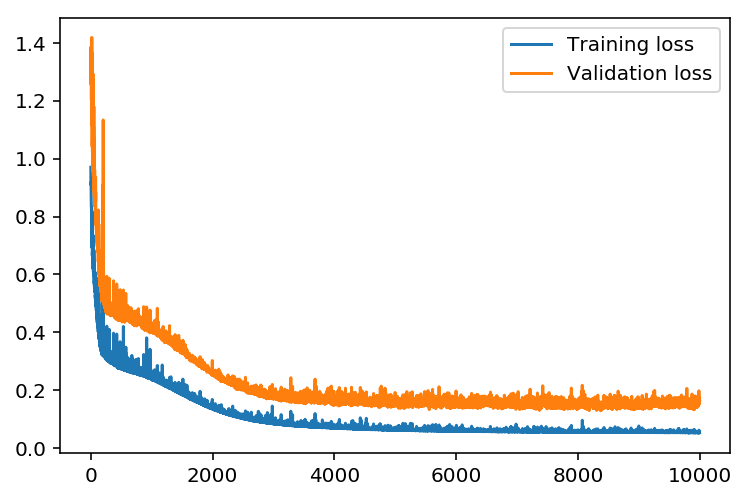

Start train for params iterations:1000,learning_rate:0.30,hidden_nodes:14,output_nodes:1
Progress: 99.9% ... Training loss: 0.265 ... Validation loss: 0.434

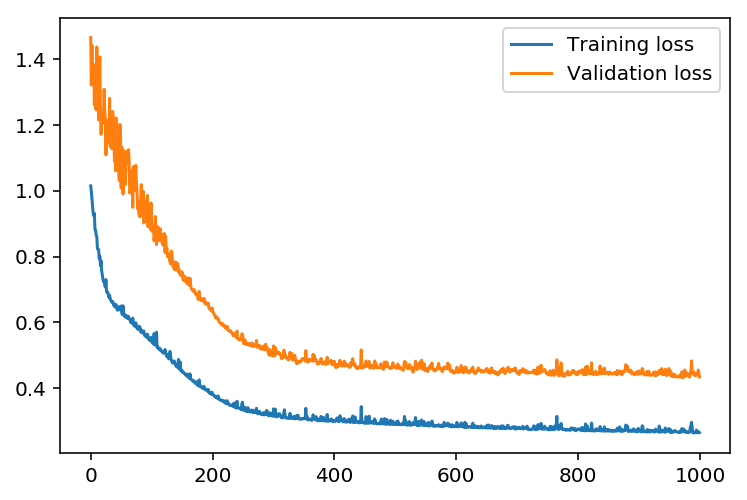

Start train for params iterations:1500,learning_rate:0.30,hidden_nodes:14,output_nodes:1
Progress: 99.9% ... Training loss: 0.266 ... Validation loss: 0.442

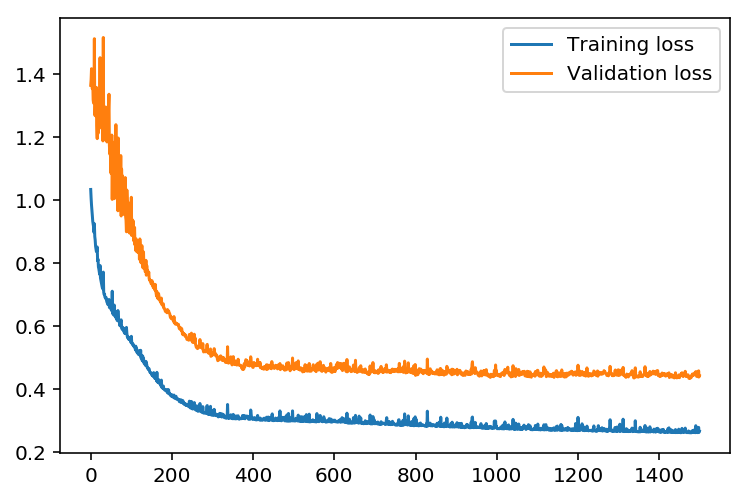

Start train for params iterations:2000,learning_rate:0.30,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.223 ... Validation loss: 0.378

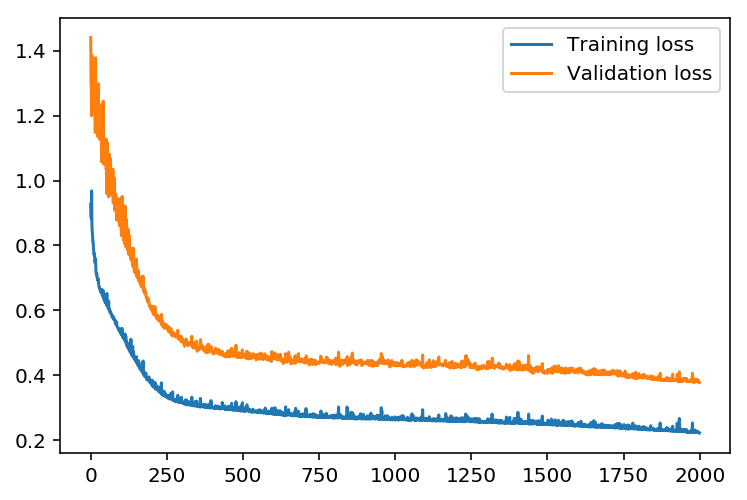

Start train for params iterations:3000,learning_rate:0.30,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.192 ... Validation loss: 0.358

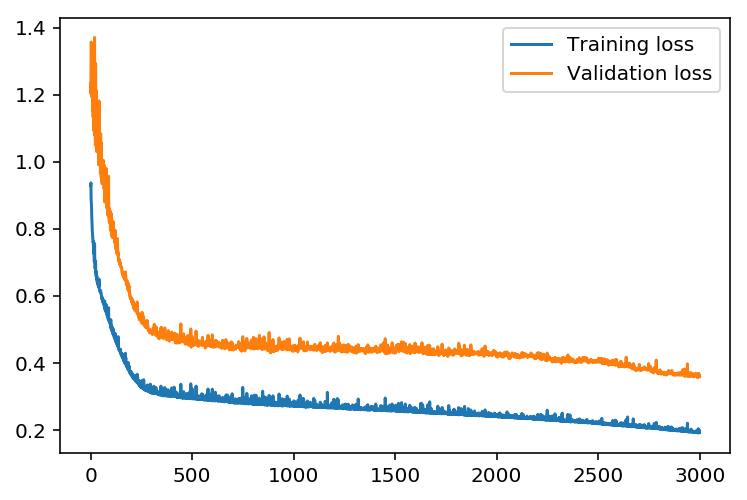

Start train for params iterations:5000,learning_rate:0.30,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.100 ... Validation loss: 0.215

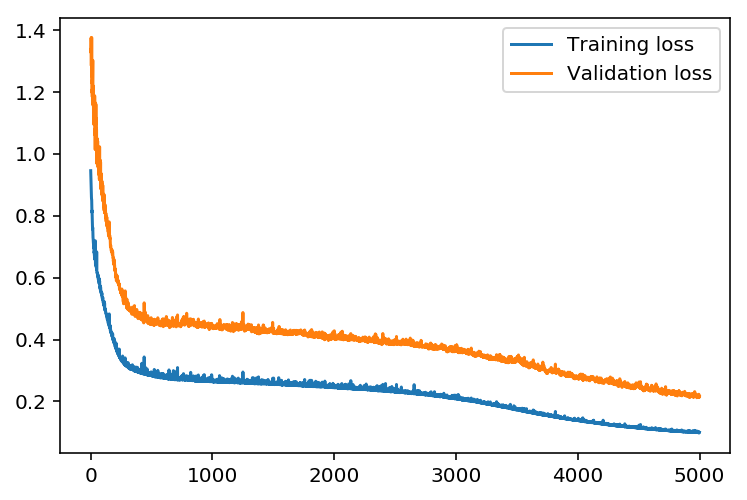

Start train for params iterations:8000,learning_rate:0.30,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.065 ... Validation loss: 0.167

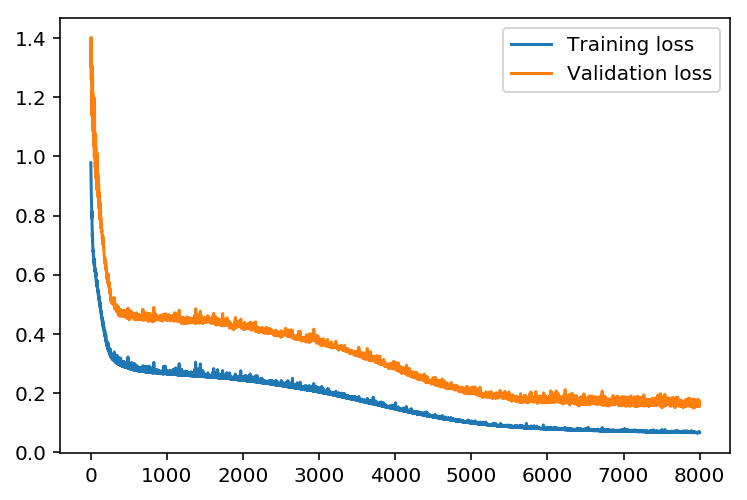

Start train for params iterations:10000,learning_rate:0.30,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.064 ... Validation loss: 0.167

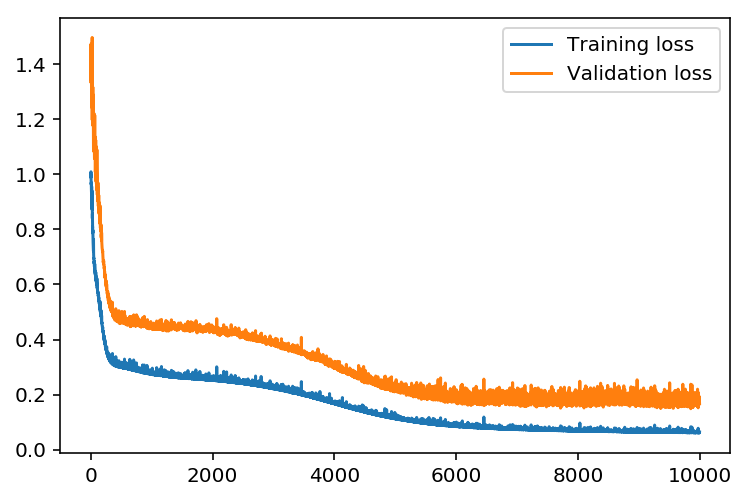

Start train for params iterations:1000,learning_rate:0.10,hidden_nodes:14,output_nodes:1
Progress: 99.9% ... Training loss: 0.315 ... Validation loss: 0.495

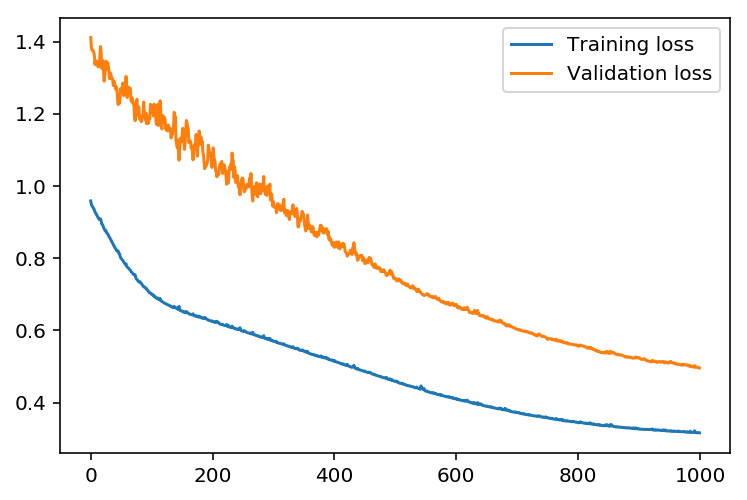

Start train for params iterations:1500,learning_rate:0.10,hidden_nodes:14,output_nodes:1
Progress: 99.9% ... Training loss: 0.276 ... Validation loss: 0.456

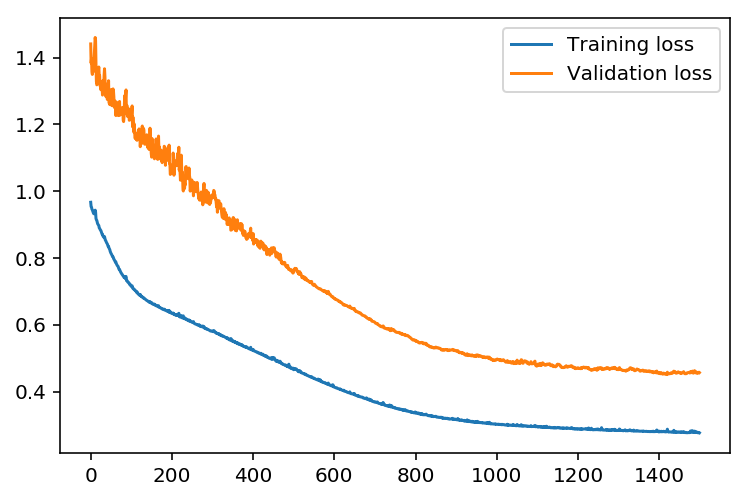

Start train for params iterations:2000,learning_rate:0.10,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.276 ... Validation loss: 0.443

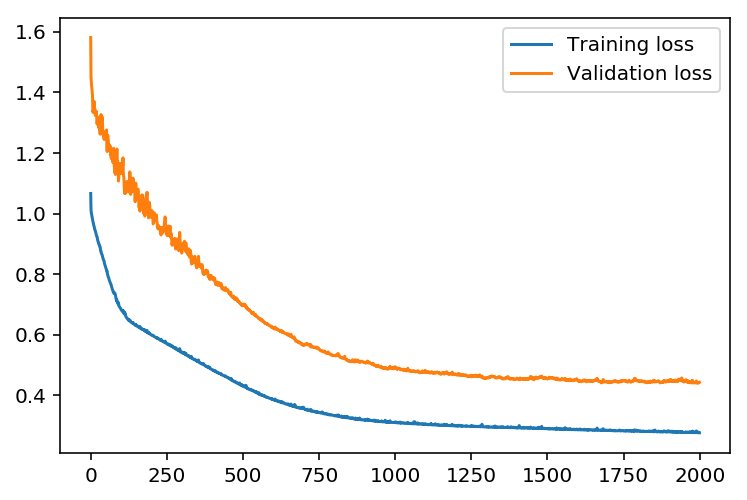

Start train for params iterations:3000,learning_rate:0.10,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.264 ... Validation loss: 0.440

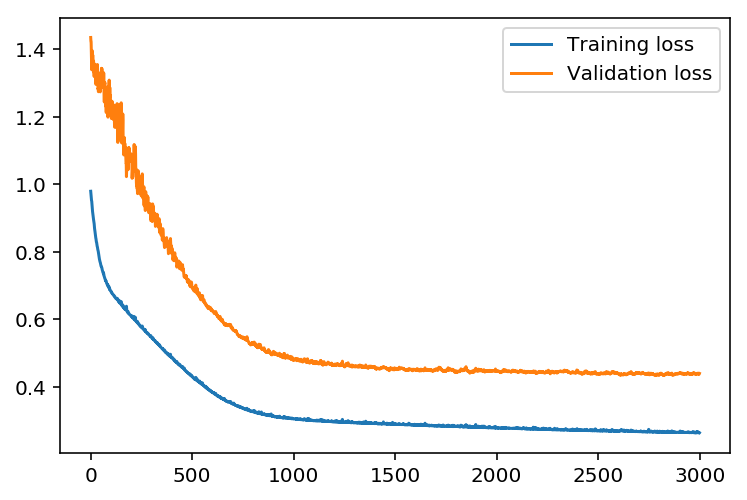

Start train for params iterations:5000,learning_rate:0.10,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.237 ... Validation loss: 0.423

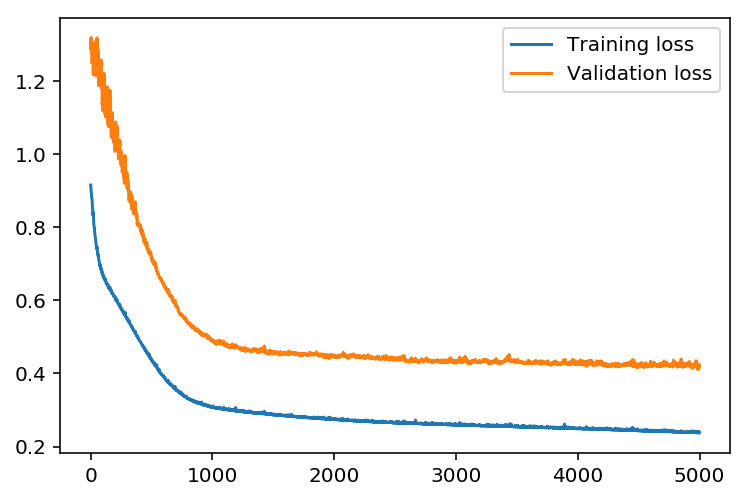

Start train for params iterations:8000,learning_rate:0.10,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.164 ... Validation loss: 0.302

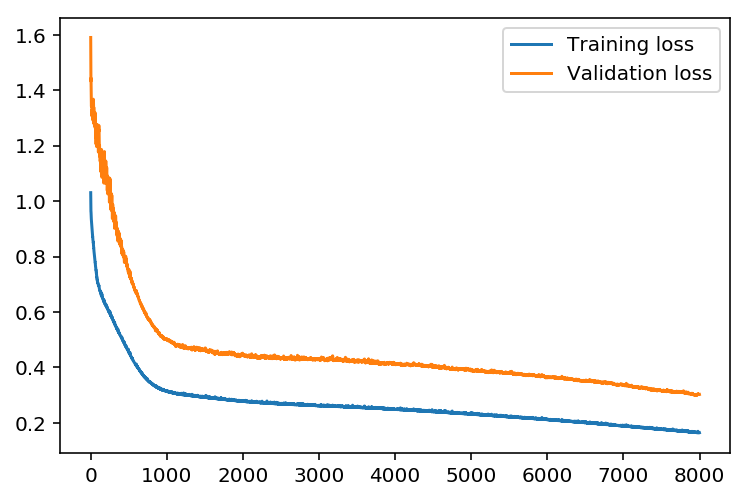

Start train for params iterations:10000,learning_rate:0.10,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.164 ... Validation loss: 0.309

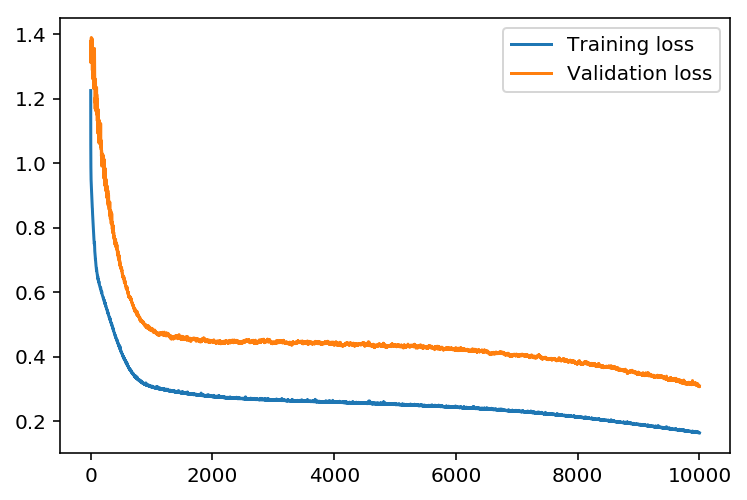

Start train for params iterations:1000,learning_rate:0.90,hidden_nodes:12,output_nodes:1
Progress: 99.9% ... Training loss: 0.129 ... Validation loss: 0.279

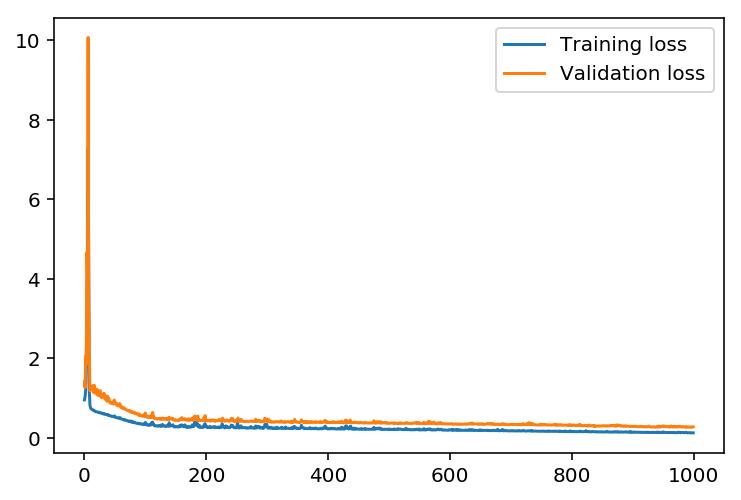

Start train for params iterations:1500,learning_rate:0.90,hidden_nodes:12,output_nodes:1
Progress: 99.9% ... Training loss: 0.084 ... Validation loss: 0.200

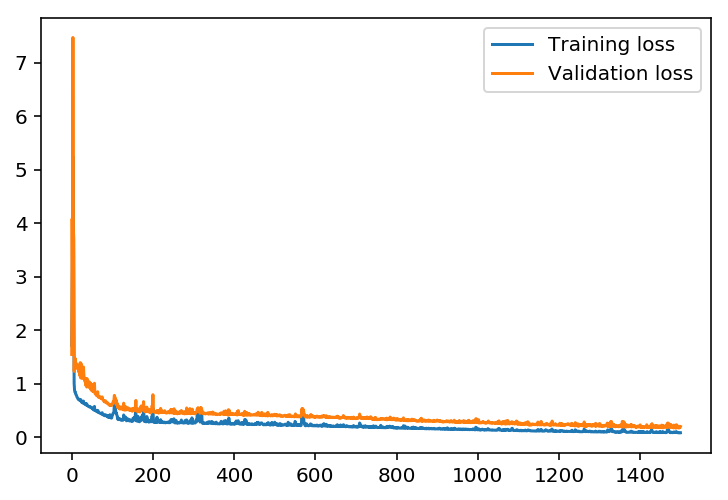

Start train for params iterations:2000,learning_rate:0.90,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.072 ... Validation loss: 0.148

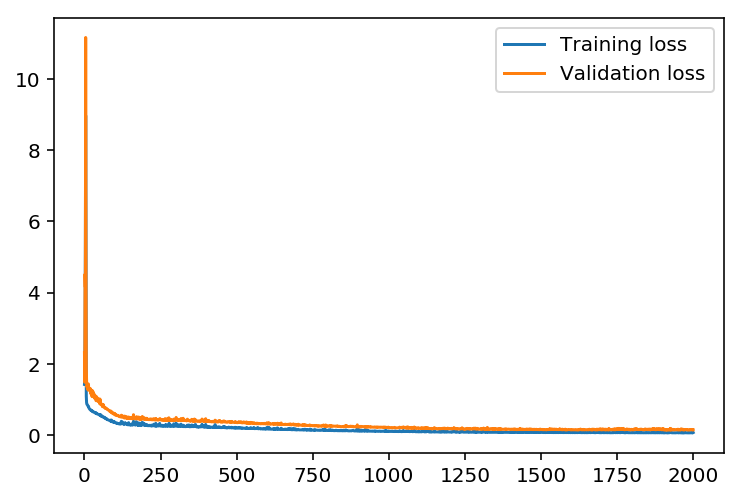

Start train for params iterations:3000,learning_rate:0.90,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.066 ... Validation loss: 0.159

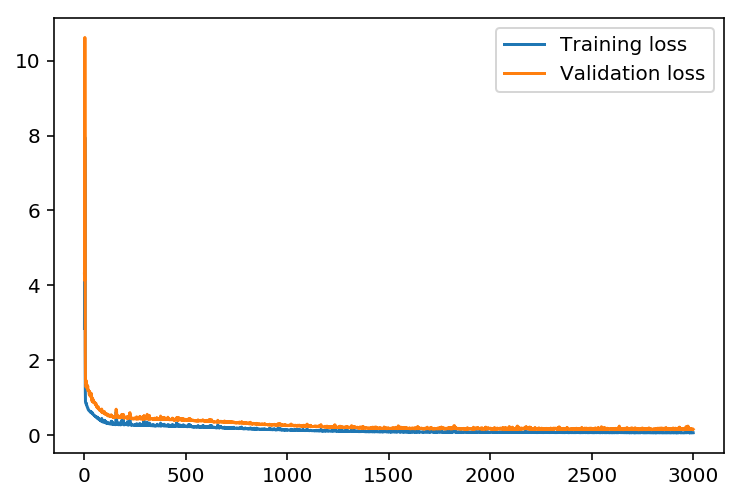

Start train for params iterations:5000,learning_rate:0.90,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.058 ... Validation loss: 0.135

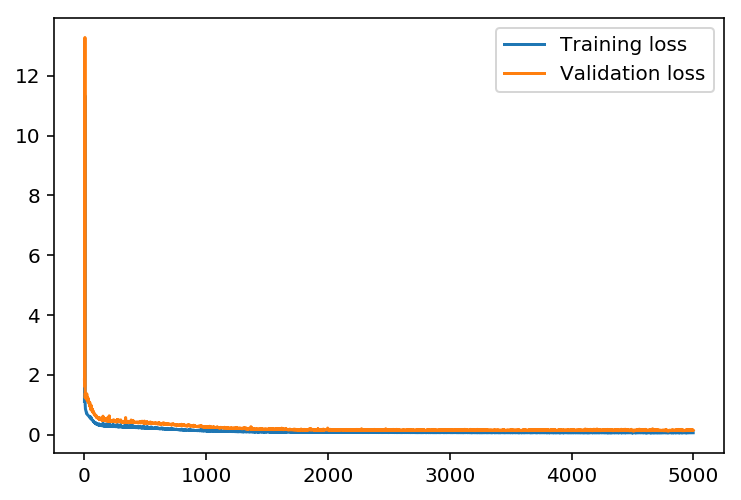

Start train for params iterations:8000,learning_rate:0.90,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.053 ... Validation loss: 0.155

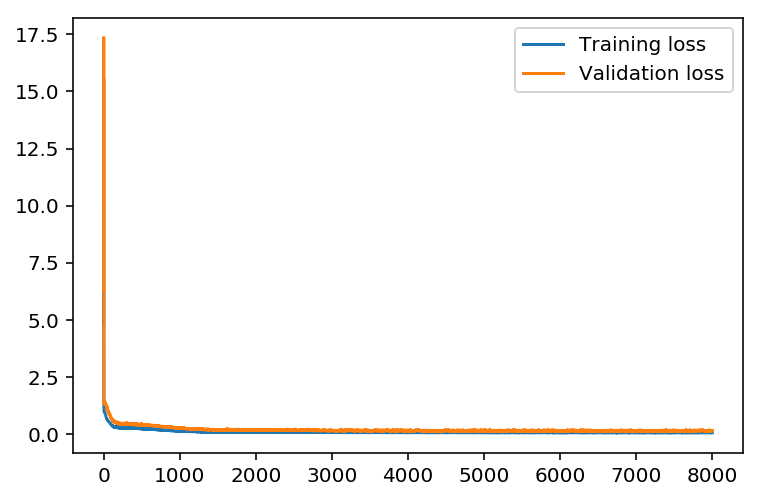

Start train for params iterations:10000,learning_rate:0.90,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.052 ... Validation loss: 0.157

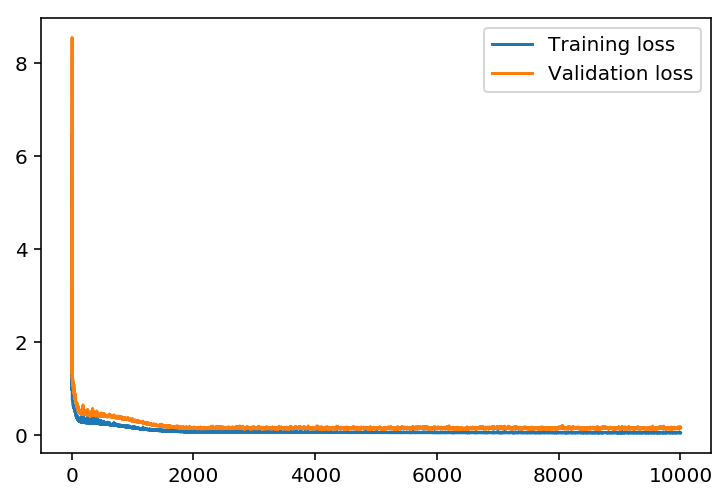

Start train for params iterations:1000,learning_rate:0.70,hidden_nodes:12,output_nodes:1
Progress: 99.9% ... Training loss: 0.231 ... Validation loss: 0.390

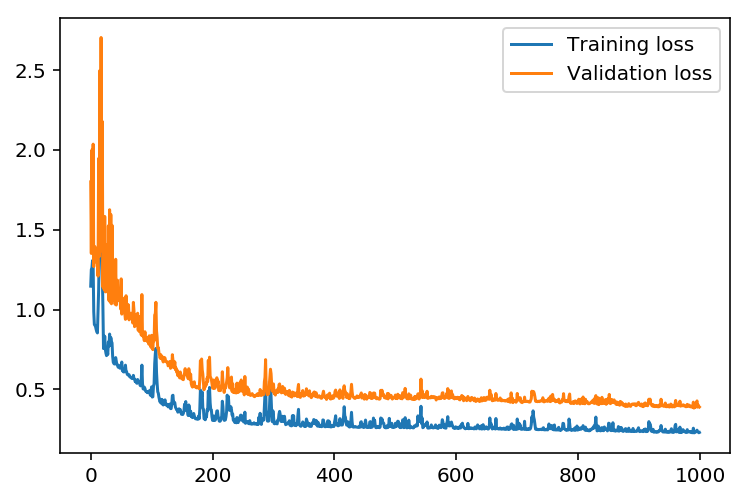

Start train for params iterations:1500,learning_rate:0.70,hidden_nodes:12,output_nodes:1
Progress: 99.9% ... Training loss: 0.108 ... Validation loss: 0.201

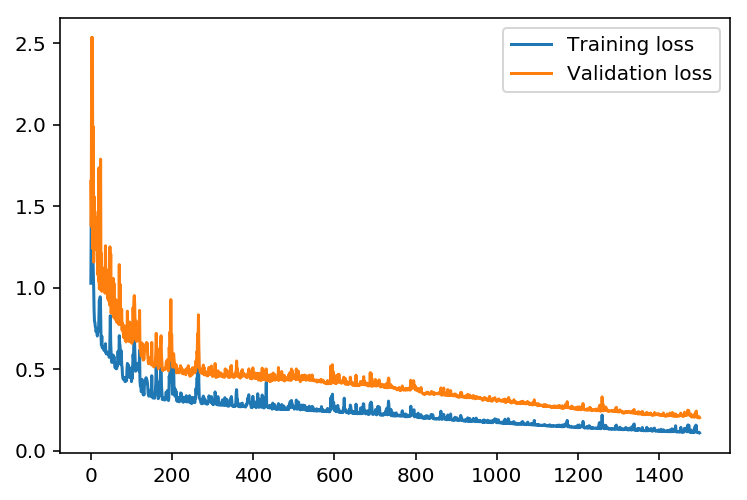

Start train for params iterations:2000,learning_rate:0.70,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.094 ... Validation loss: 0.231

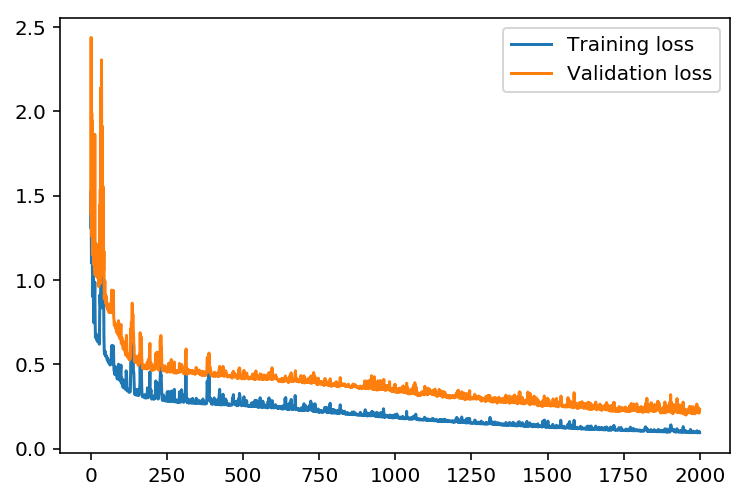

Start train for params iterations:3000,learning_rate:0.70,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.066 ... Validation loss: 0.192

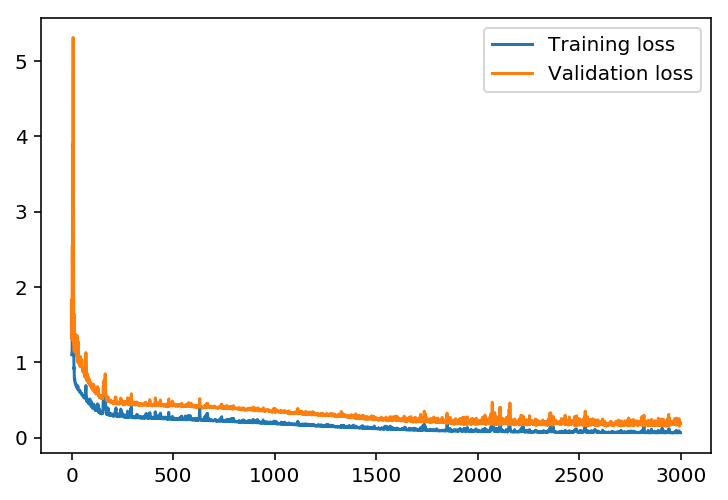

Start train for params iterations:5000,learning_rate:0.70,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.057 ... Validation loss: 0.138

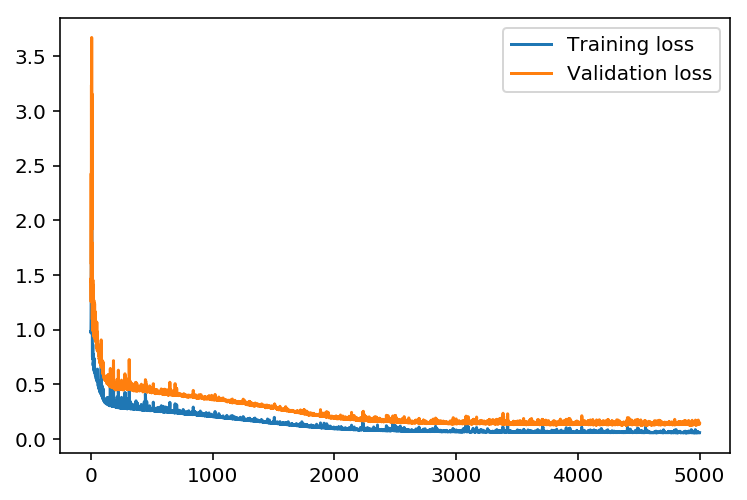

Start train for params iterations:8000,learning_rate:0.70,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.056 ... Validation loss: 0.153

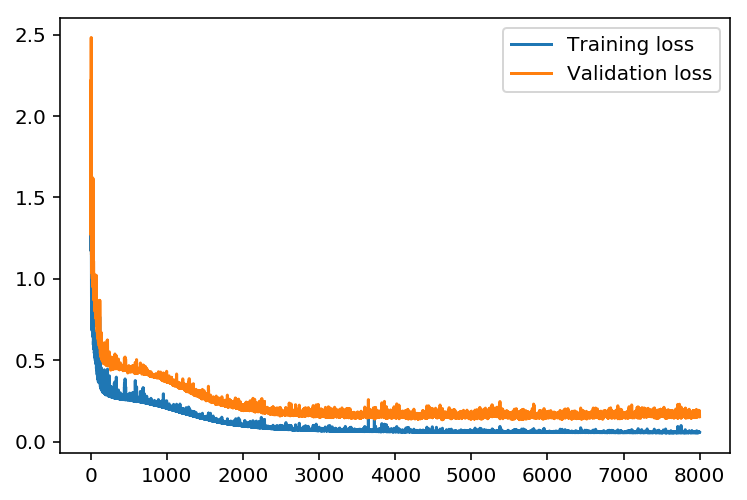

Start train for params iterations:10000,learning_rate:0.70,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.051 ... Validation loss: 0.145

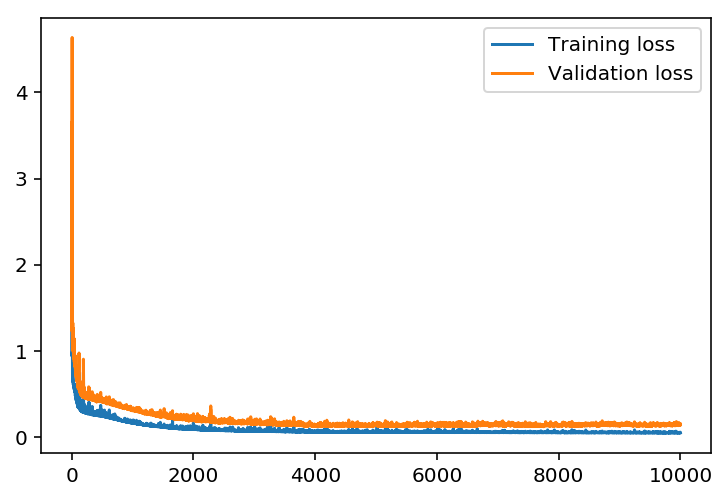

Start train for params iterations:1000,learning_rate:0.50,hidden_nodes:12,output_nodes:1
Progress: 99.9% ... Training loss: 0.262 ... Validation loss: 0.454

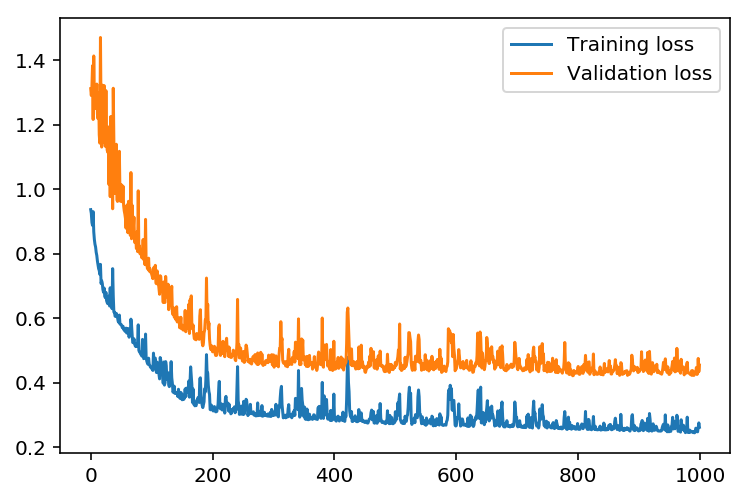

Start train for params iterations:1500,learning_rate:0.50,hidden_nodes:12,output_nodes:1
Progress: 99.9% ... Training loss: 0.216 ... Validation loss: 0.385

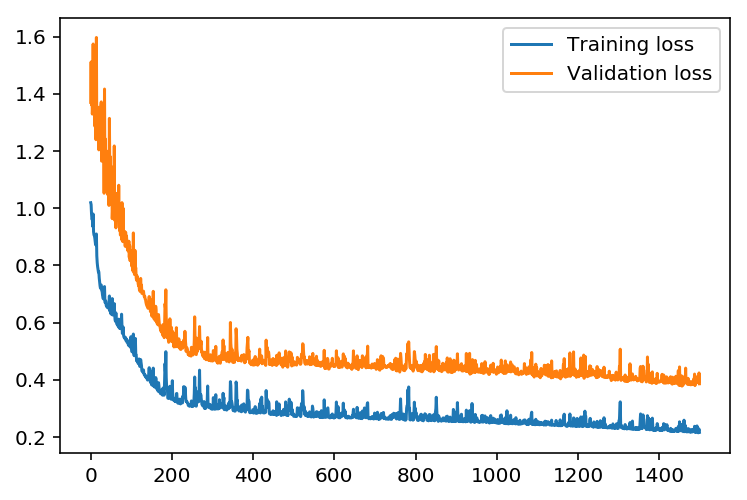

Start train for params iterations:2000,learning_rate:0.50,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.120 ... Validation loss: 0.223

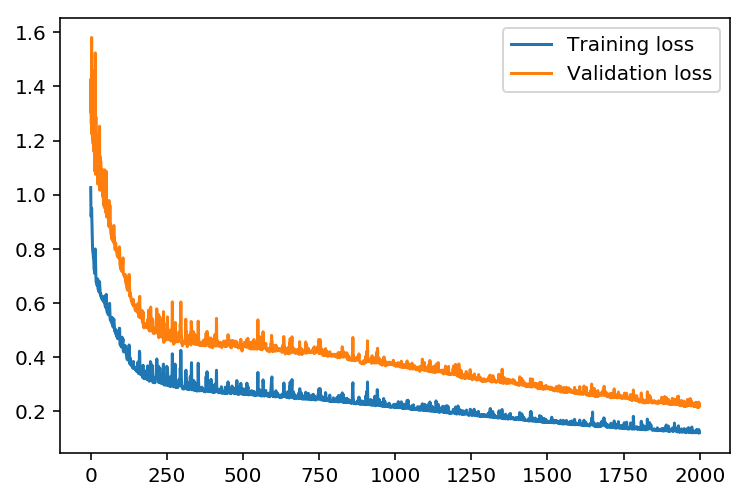

Start train for params iterations:3000,learning_rate:0.50,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.100 ... Validation loss: 0.217

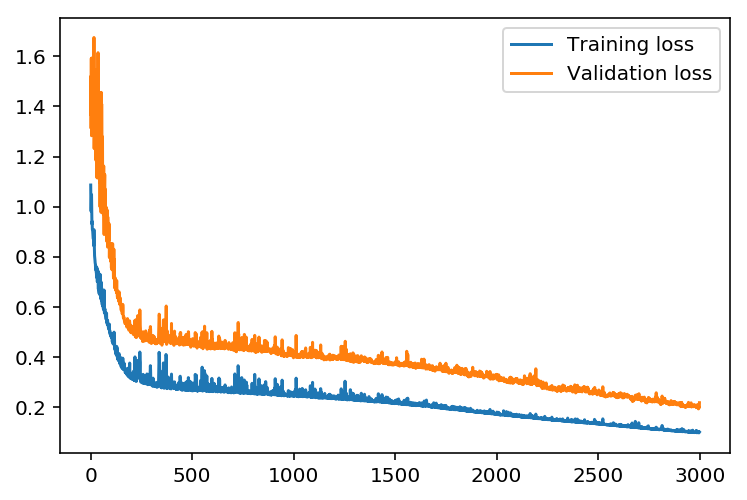

Start train for params iterations:5000,learning_rate:0.50,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.075 ... Validation loss: 0.165

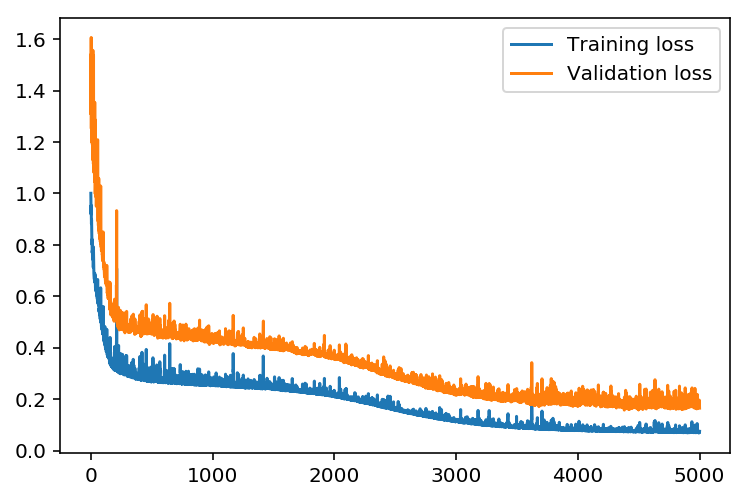

Start train for params iterations:8000,learning_rate:0.50,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.055 ... Validation loss: 0.154

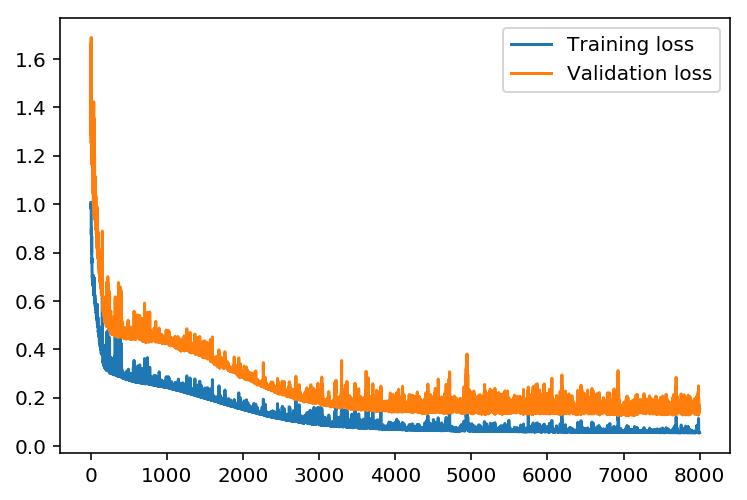

Start train for params iterations:10000,learning_rate:0.50,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.062 ... Validation loss: 0.165

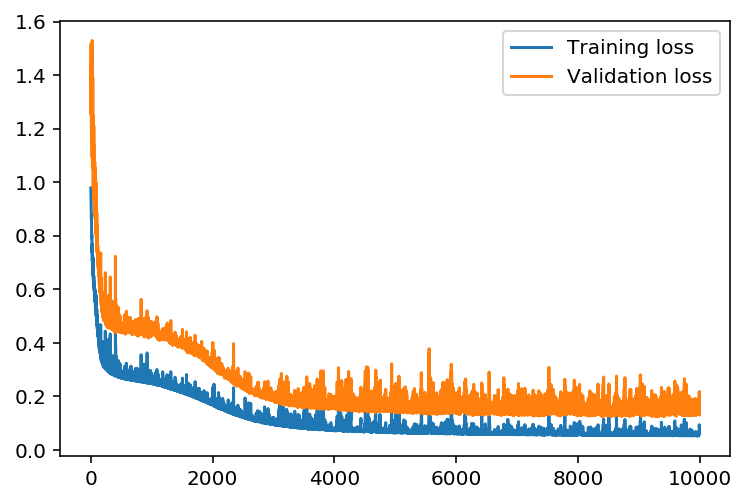

Start train for params iterations:1000,learning_rate:0.30,hidden_nodes:12,output_nodes:1
Progress: 99.9% ... Training loss: 0.266 ... Validation loss: 0.448

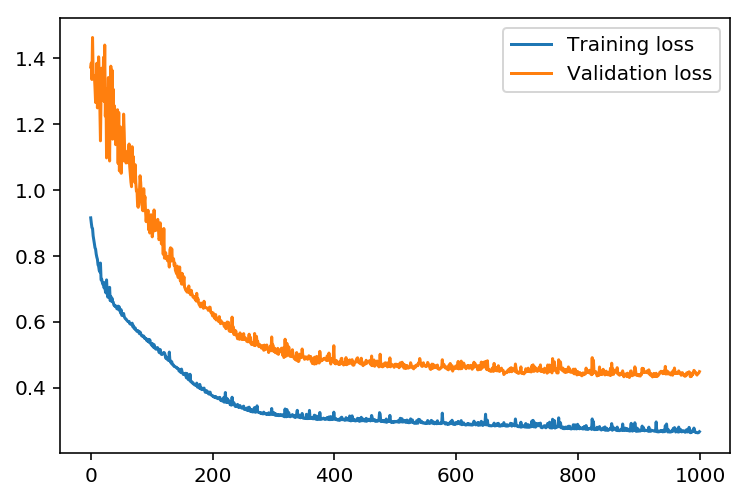

Start train for params iterations:1500,learning_rate:0.30,hidden_nodes:12,output_nodes:1
Progress: 99.9% ... Training loss: 0.258 ... Validation loss: 0.438

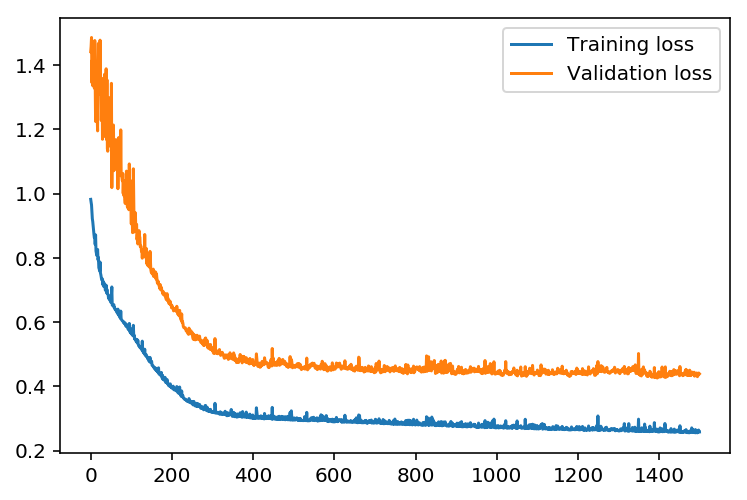

Start train for params iterations:2000,learning_rate:0.30,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.231 ... Validation loss: 0.383

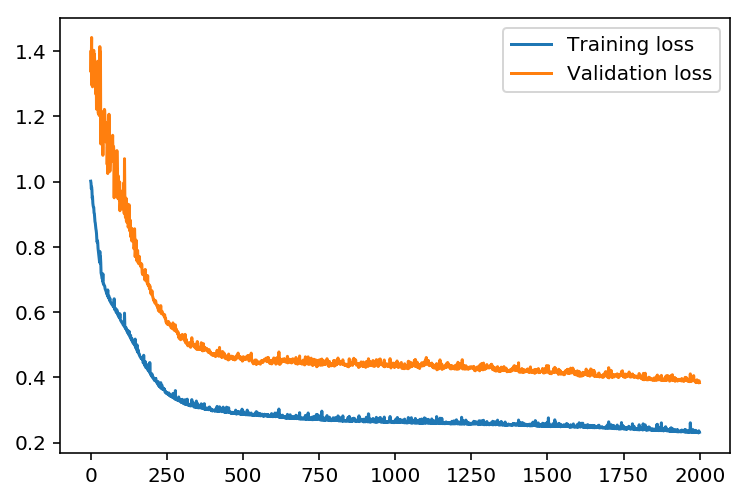

Start train for params iterations:3000,learning_rate:0.30,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.164 ... Validation loss: 0.338

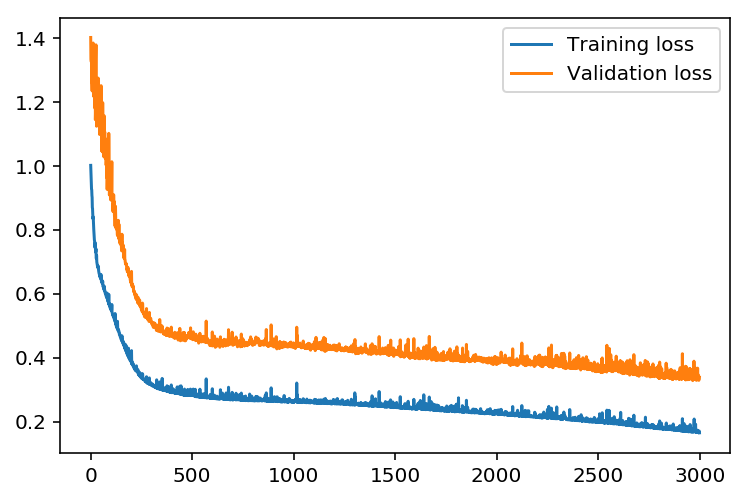

Start train for params iterations:5000,learning_rate:0.30,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.090 ... Validation loss: 0.190

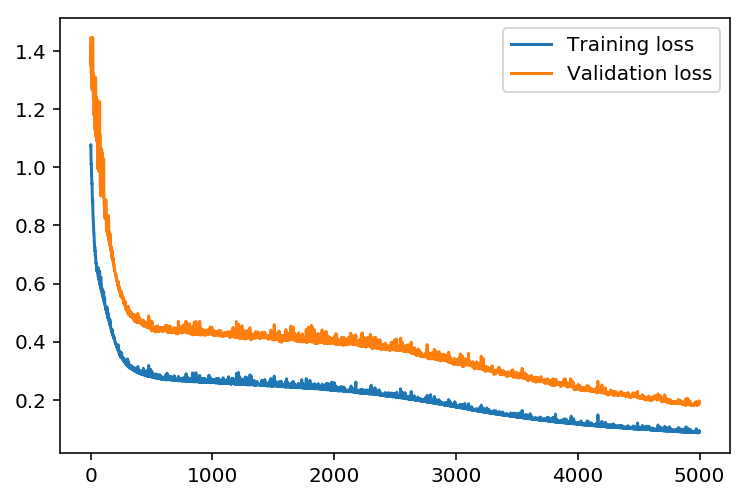

Start train for params iterations:8000,learning_rate:0.30,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.062 ... Validation loss: 0.153

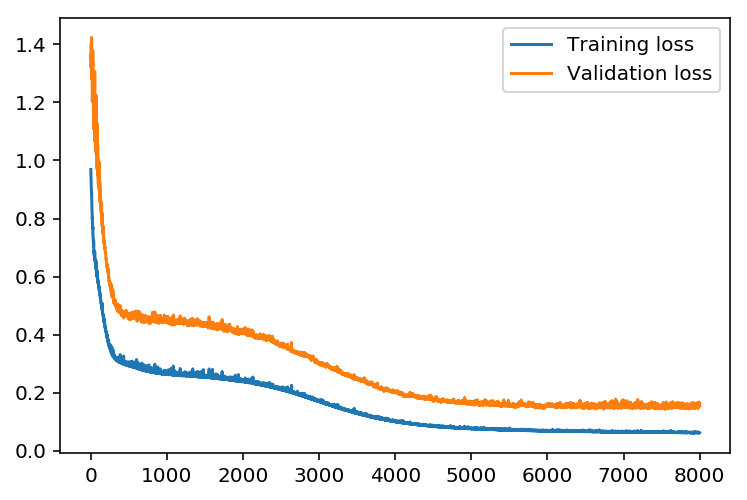

Start train for params iterations:10000,learning_rate:0.30,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.062 ... Validation loss: 0.166

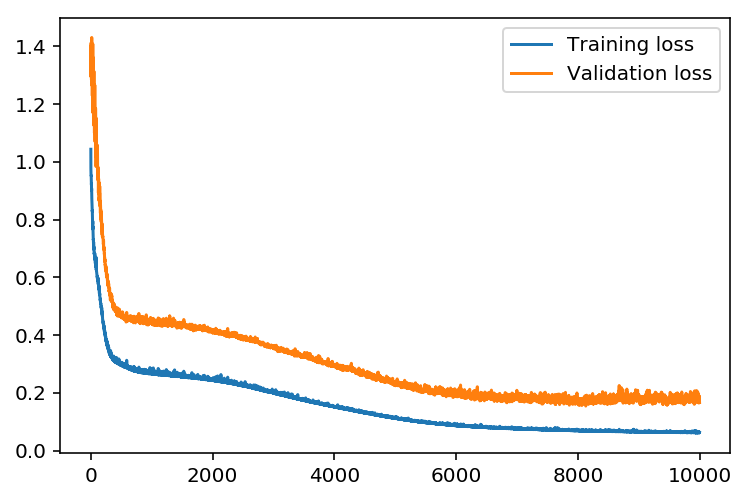

Start train for params iterations:1000,learning_rate:0.10,hidden_nodes:12,output_nodes:1
Progress: 99.9% ... Training loss: 0.304 ... Validation loss: 0.477

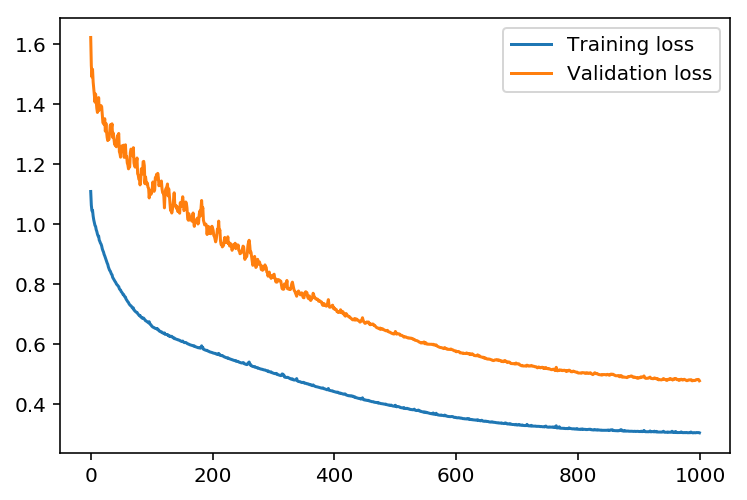

Start train for params iterations:1500,learning_rate:0.10,hidden_nodes:12,output_nodes:1
Progress: 99.9% ... Training loss: 0.276 ... Validation loss: 0.450

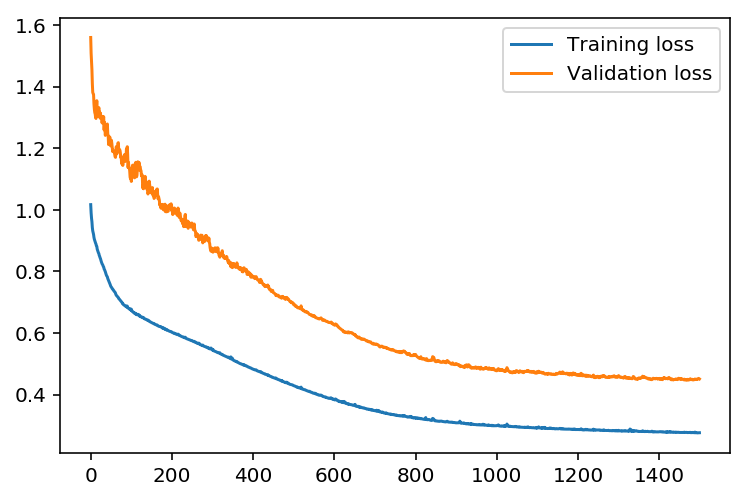

Start train for params iterations:2000,learning_rate:0.10,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.277 ... Validation loss: 0.445

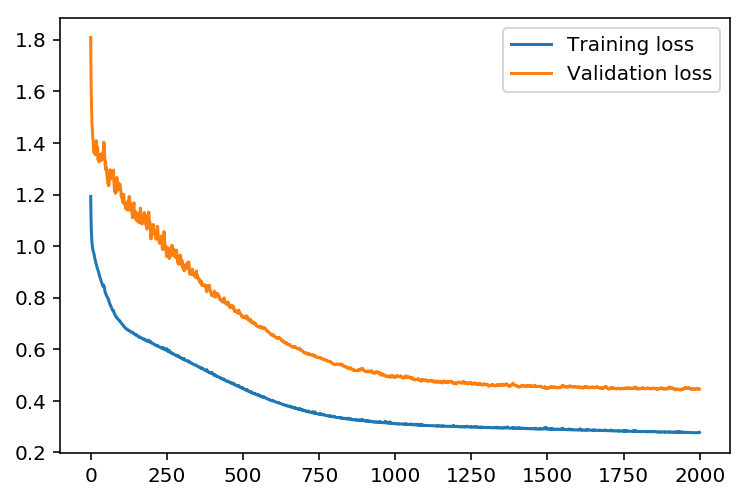

Start train for params iterations:3000,learning_rate:0.10,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.270 ... Validation loss: 0.445

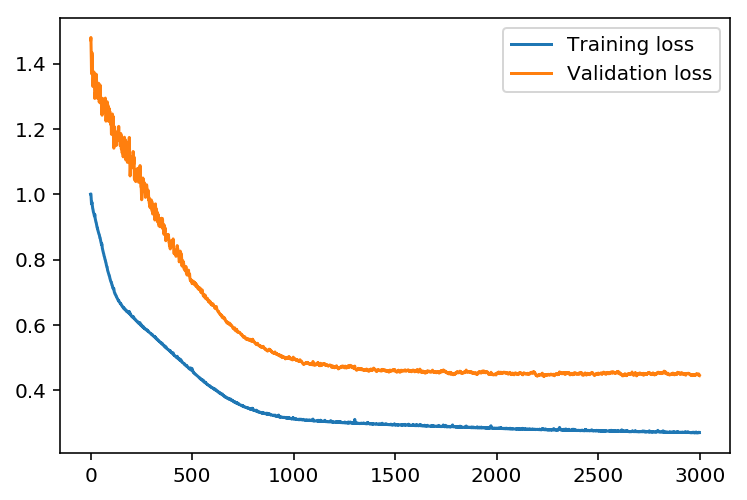

Start train for params iterations:5000,learning_rate:0.10,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.195 ... Validation loss: 0.348

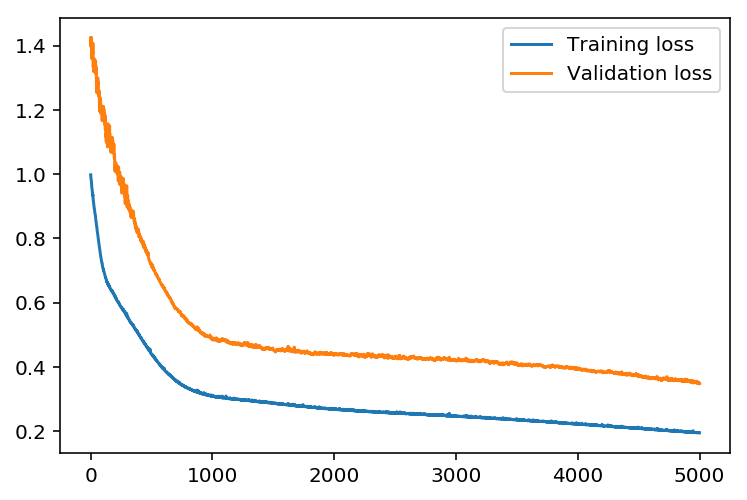

Start train for params iterations:8000,learning_rate:0.10,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.171 ... Validation loss: 0.322

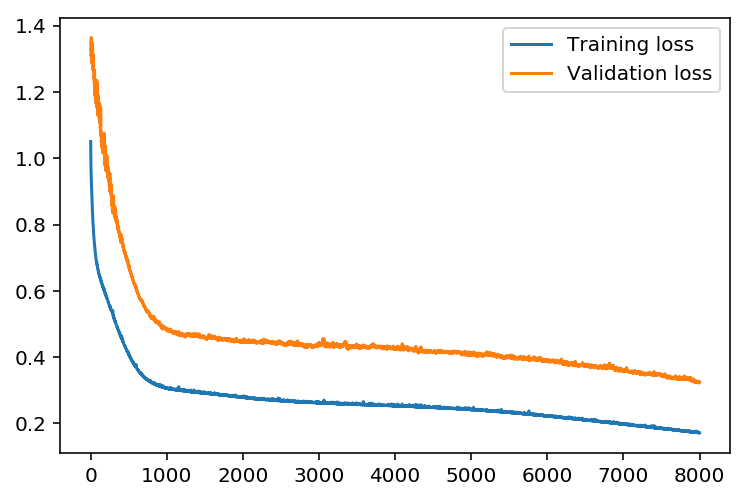

Start train for params iterations:10000,learning_rate:0.10,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.137 ... Validation loss: 0.270

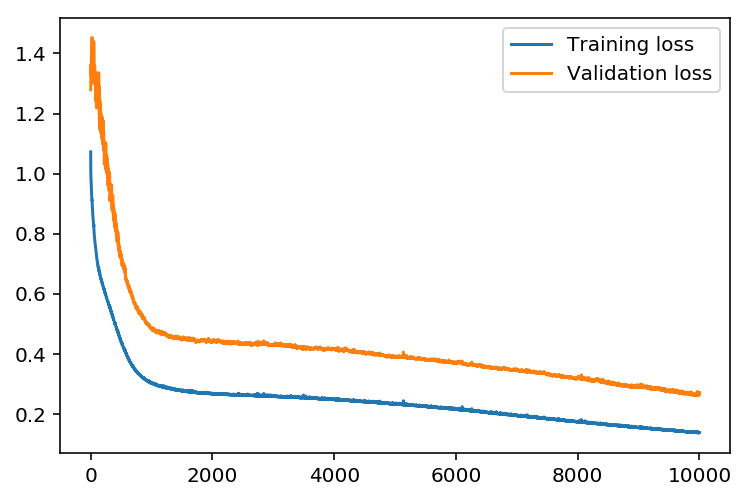

Start train for params iterations:1000,learning_rate:0.90,hidden_nodes:10,output_nodes:1
Progress: 99.9% ... Training loss: 0.130 ... Validation loss: 0.270

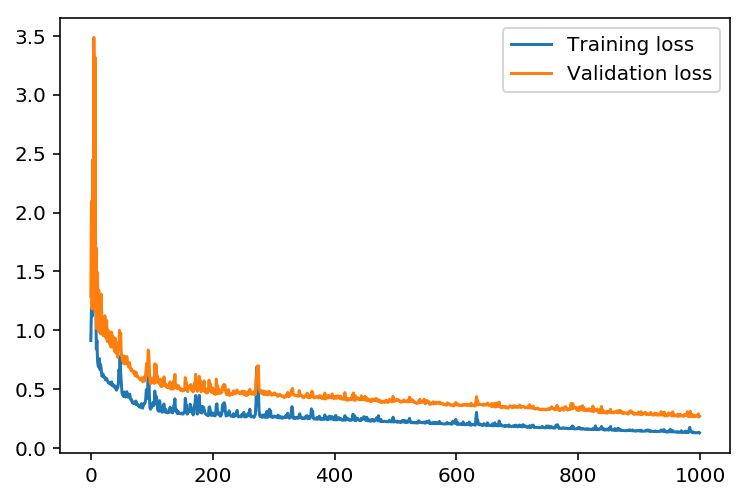

Start train for params iterations:1500,learning_rate:0.90,hidden_nodes:10,output_nodes:1
Progress: 99.9% ... Training loss: 0.100 ... Validation loss: 0.209

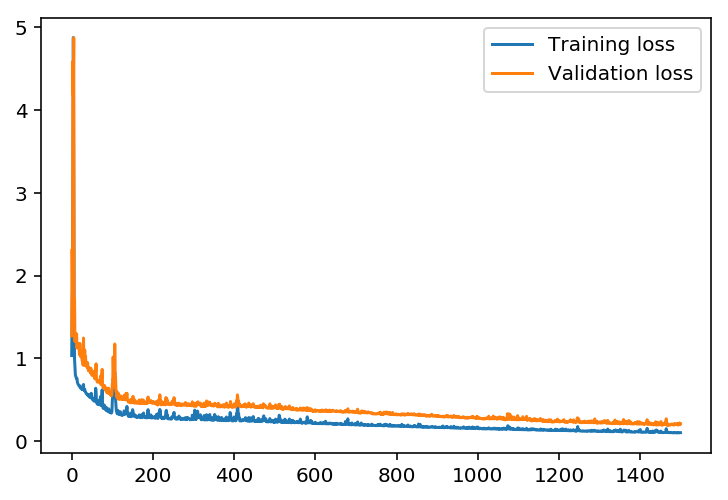

Start train for params iterations:2000,learning_rate:0.90,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.094 ... Validation loss: 0.217

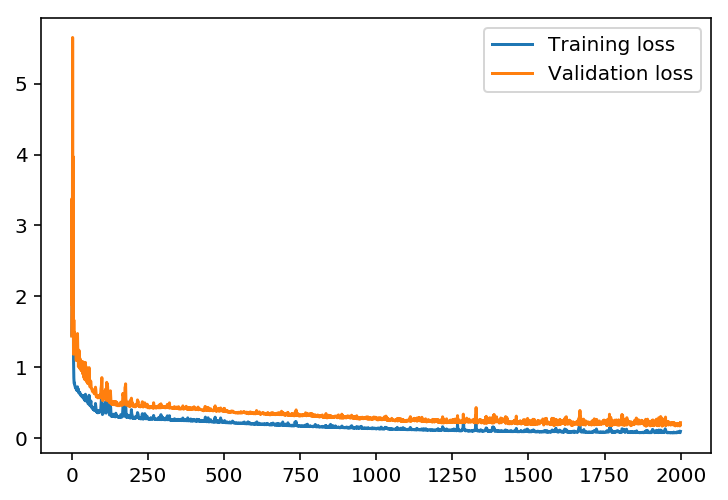

Start train for params iterations:3000,learning_rate:0.90,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.063 ... Validation loss: 0.148

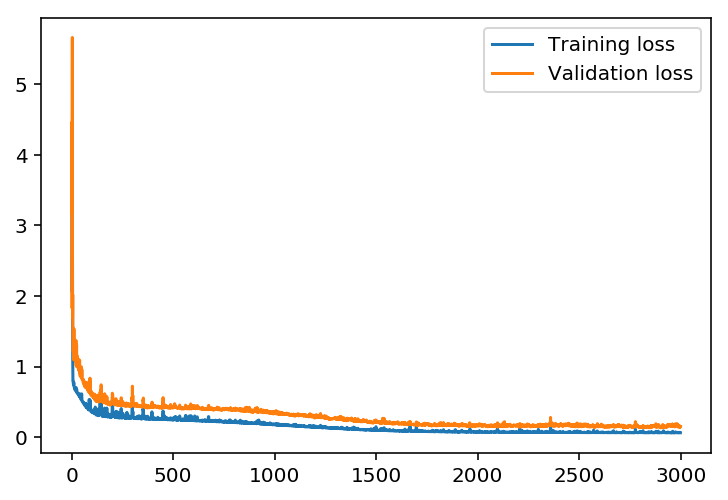

Start train for params iterations:5000,learning_rate:0.90,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.054 ... Validation loss: 0.162

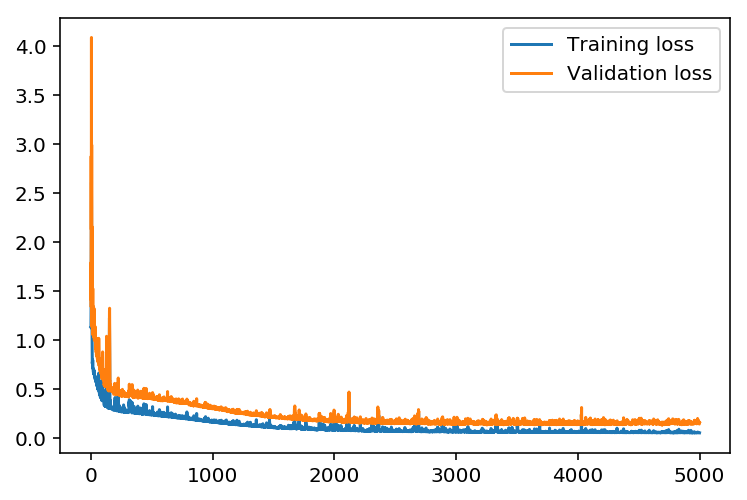

Start train for params iterations:8000,learning_rate:0.90,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.057 ... Validation loss: 0.126

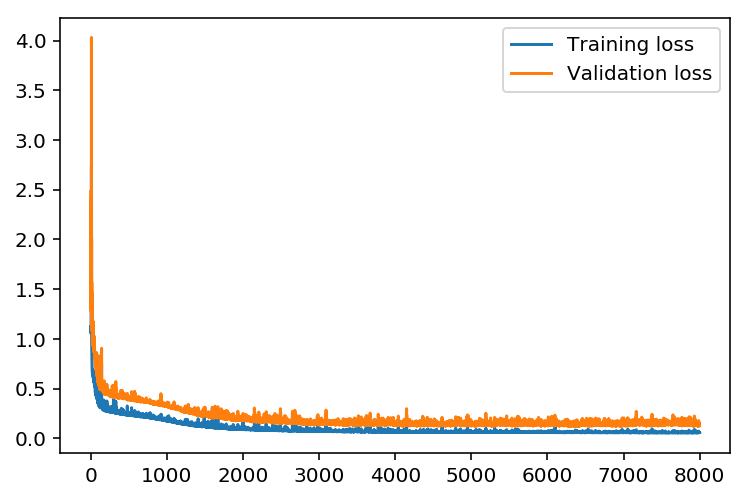

Start train for params iterations:10000,learning_rate:0.90,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.052 ... Validation loss: 0.151

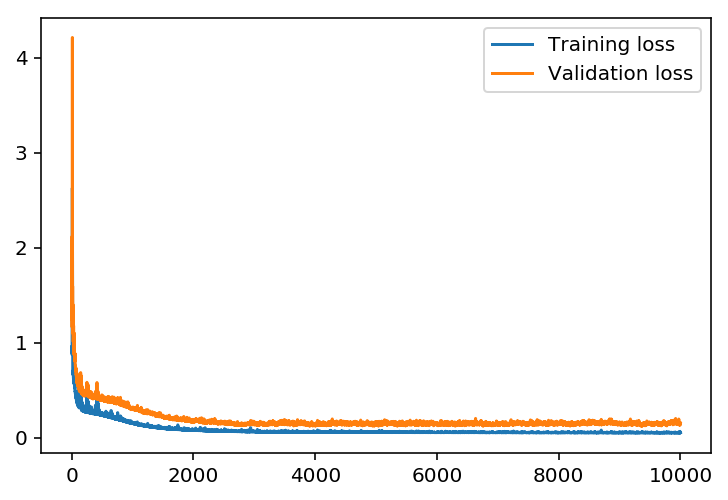

Start train for params iterations:1000,learning_rate:0.70,hidden_nodes:10,output_nodes:1
Progress: 99.9% ... Training loss: 0.185 ... Validation loss: 0.321

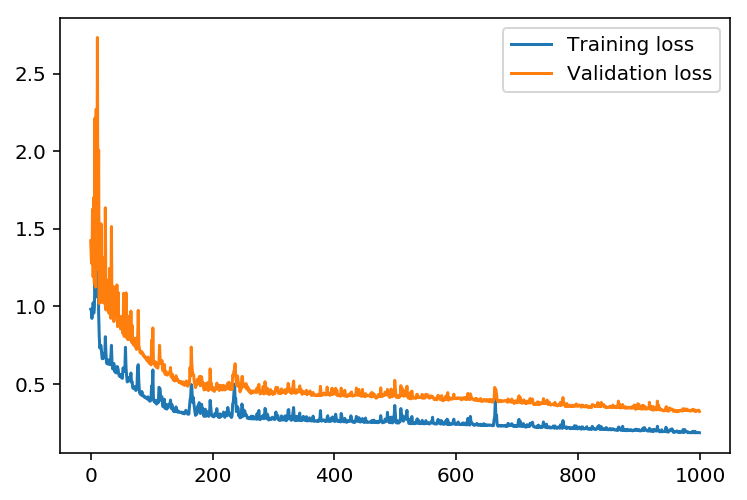

Start train for params iterations:1500,learning_rate:0.70,hidden_nodes:10,output_nodes:1
Progress: 99.9% ... Training loss: 0.128 ... Validation loss: 0.239

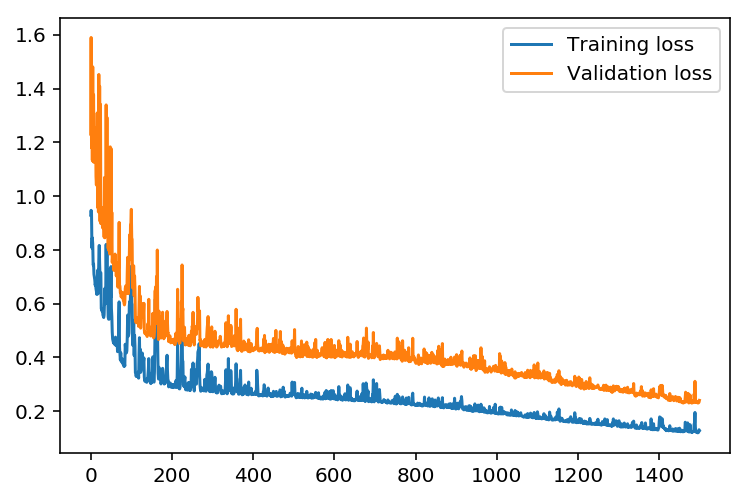

Start train for params iterations:2000,learning_rate:0.70,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.094 ... Validation loss: 0.192

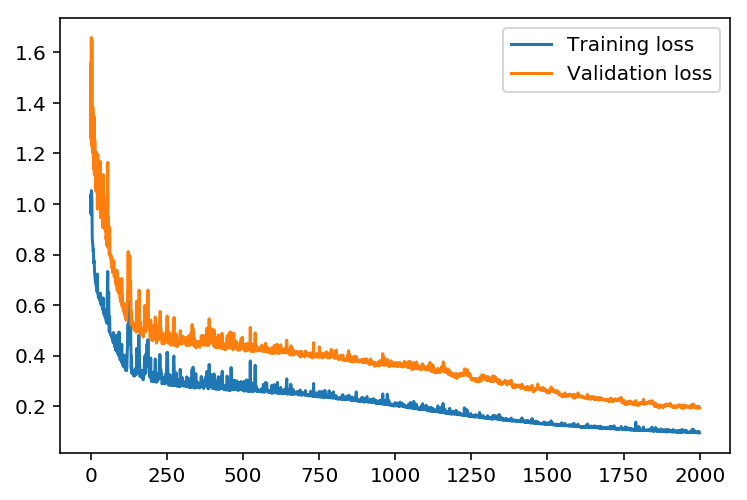

Start train for params iterations:3000,learning_rate:0.70,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.094 ... Validation loss: 0.203

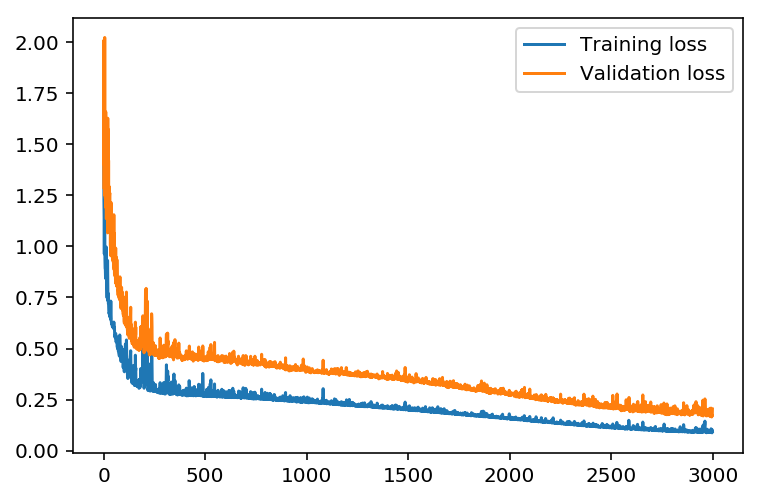

Start train for params iterations:5000,learning_rate:0.70,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.062 ... Validation loss: 0.155

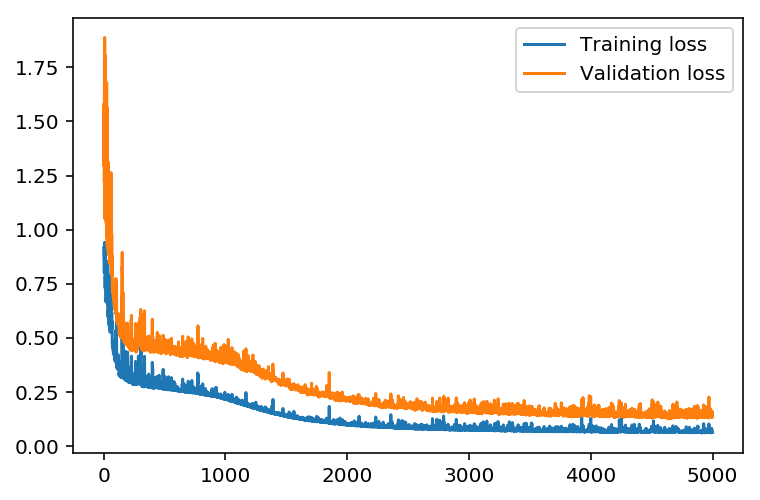

Start train for params iterations:8000,learning_rate:0.70,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.053 ... Validation loss: 0.193

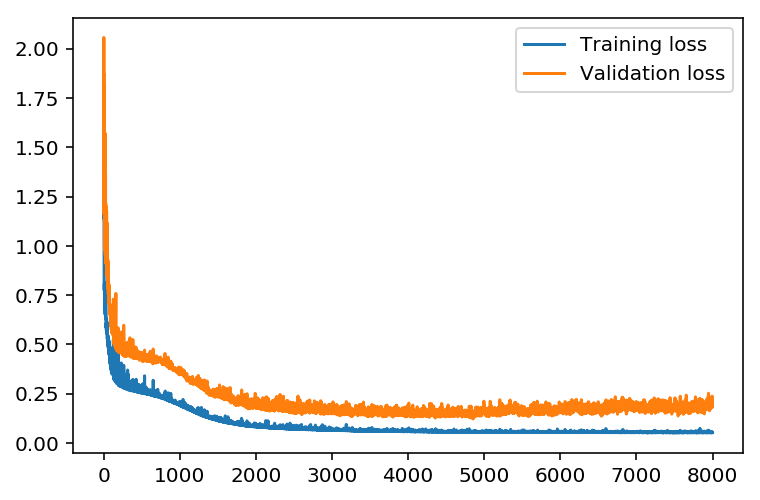

Start train for params iterations:10000,learning_rate:0.70,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.056 ... Validation loss: 0.138

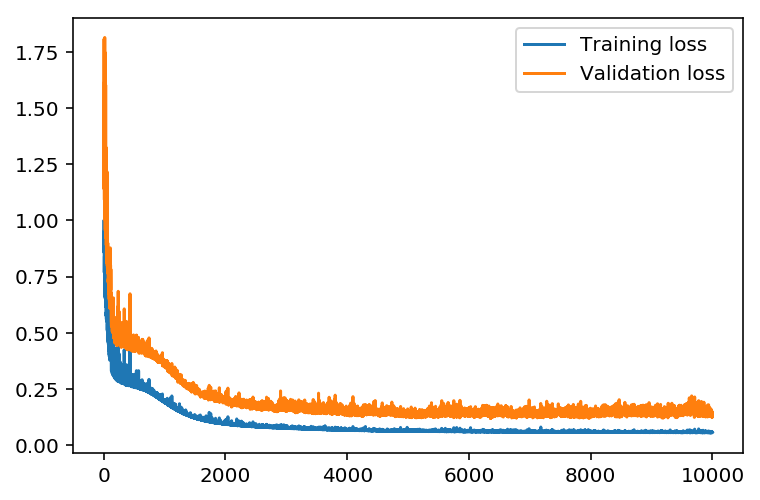

Start train for params iterations:1000,learning_rate:0.50,hidden_nodes:10,output_nodes:1
Progress: 99.9% ... Training loss: 0.273 ... Validation loss: 0.461

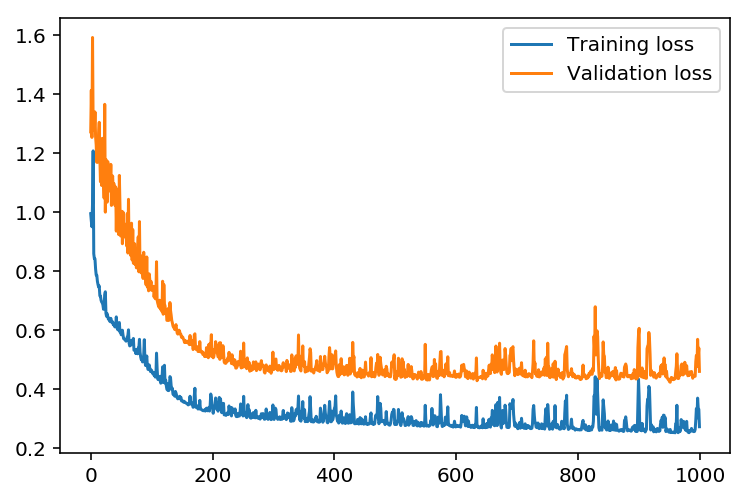

Start train for params iterations:1500,learning_rate:0.50,hidden_nodes:10,output_nodes:1
Progress: 99.9% ... Training loss: 0.206 ... Validation loss: 0.363

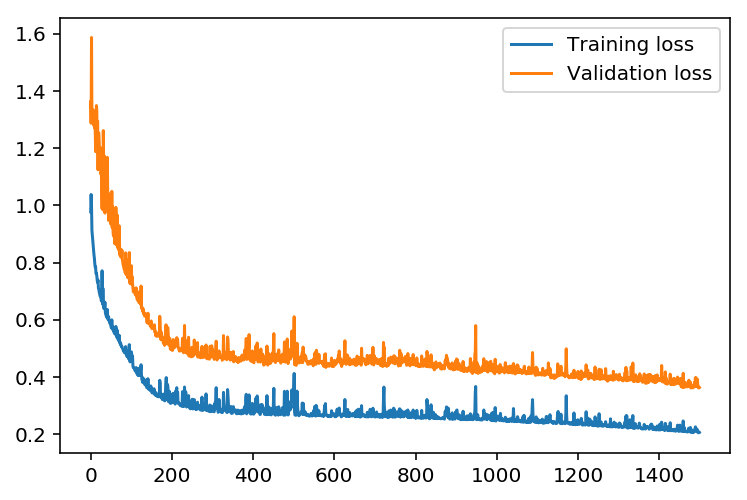

Start train for params iterations:2000,learning_rate:0.50,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.148 ... Validation loss: 0.279

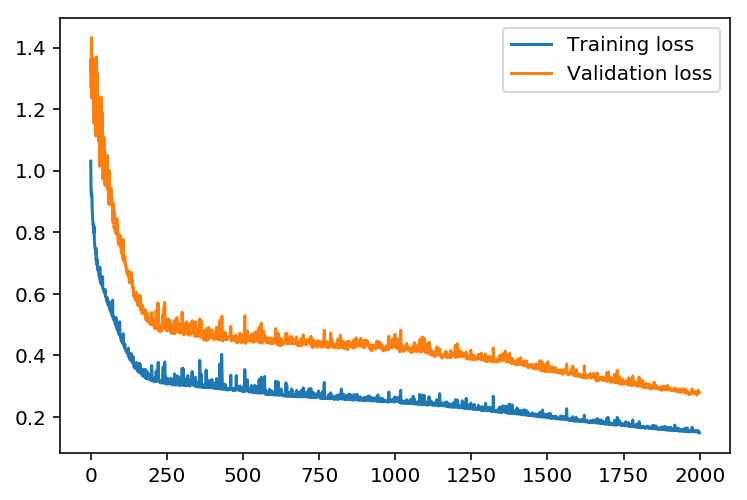

Start train for params iterations:3000,learning_rate:0.50,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.101 ... Validation loss: 0.176

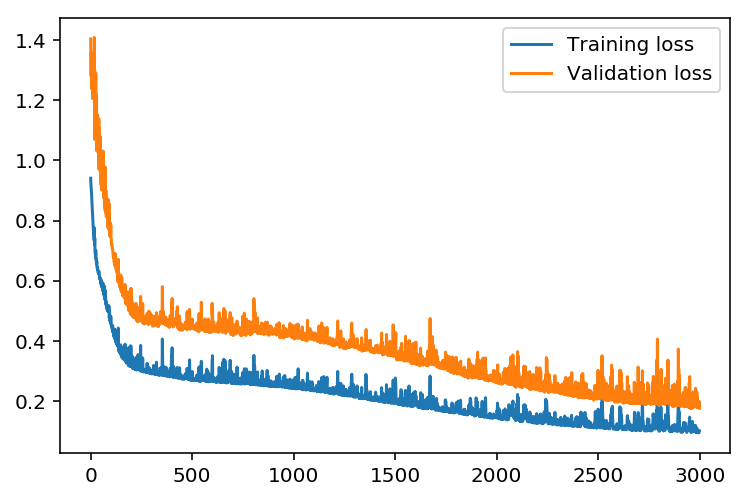

Start train for params iterations:5000,learning_rate:0.50,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.074 ... Validation loss: 0.145

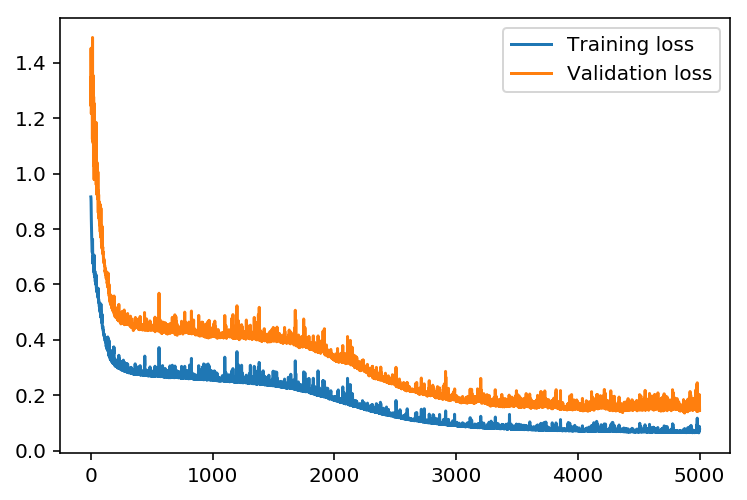

Start train for params iterations:8000,learning_rate:0.50,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.055 ... Validation loss: 0.168

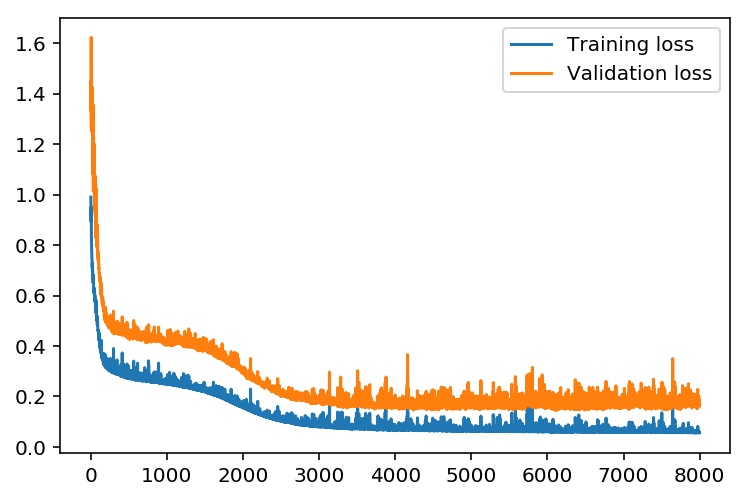

Start train for params iterations:10000,learning_rate:0.50,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.055 ... Validation loss: 0.142

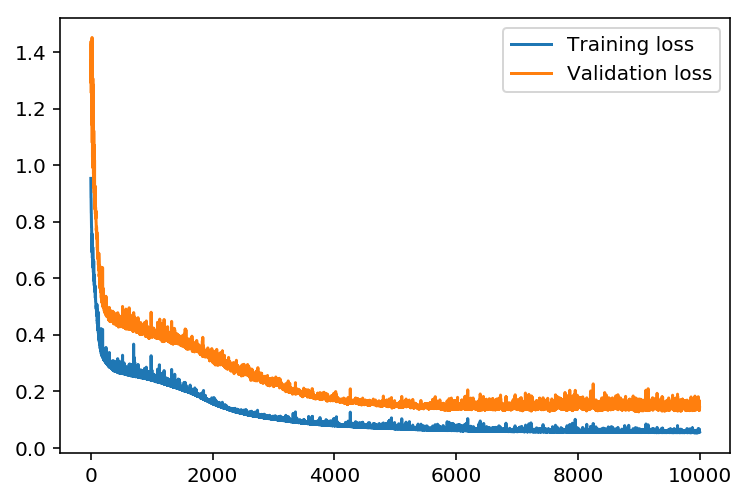

Start train for params iterations:1000,learning_rate:0.30,hidden_nodes:10,output_nodes:1
Progress: 99.9% ... Training loss: 0.260 ... Validation loss: 0.434

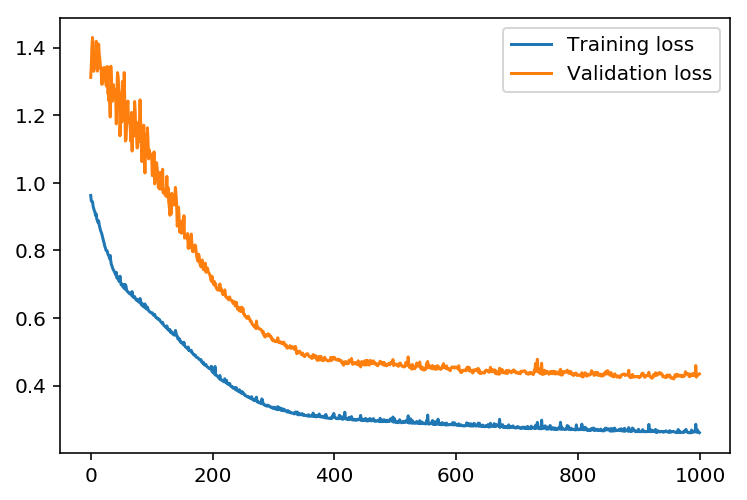

Start train for params iterations:1500,learning_rate:0.30,hidden_nodes:10,output_nodes:1
Progress: 99.9% ... Training loss: 0.232 ... Validation loss: 0.398

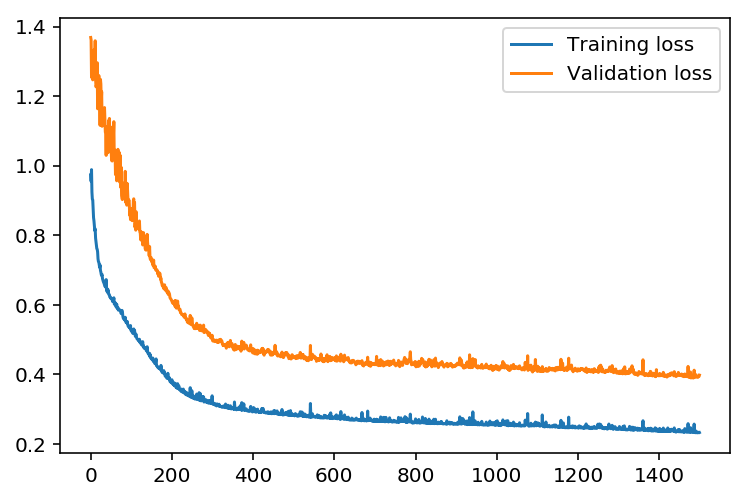

Start train for params iterations:2000,learning_rate:0.30,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.213 ... Validation loss: 0.383

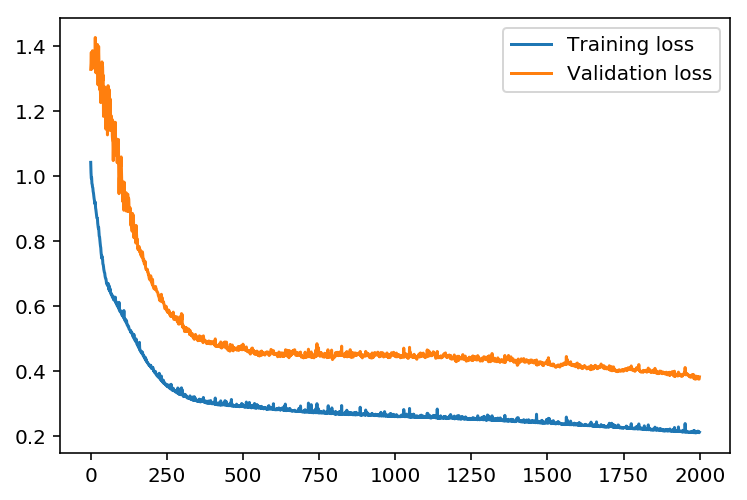

Start train for params iterations:3000,learning_rate:0.30,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.133 ... Validation loss: 0.256

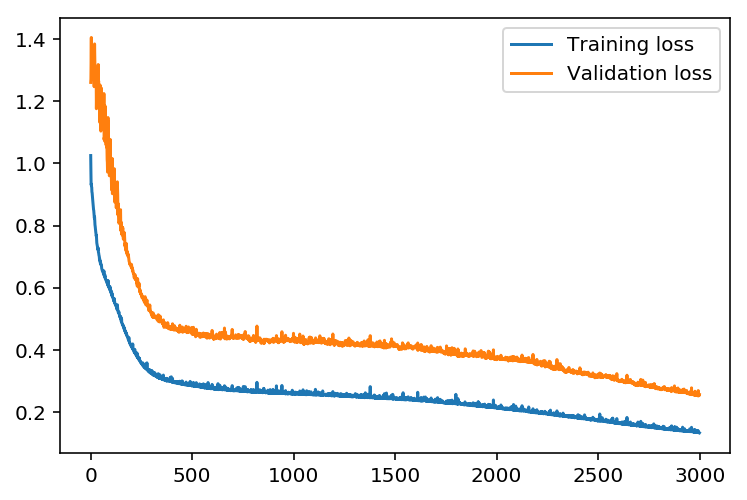

Start train for params iterations:5000,learning_rate:0.30,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.106 ... Validation loss: 0.190

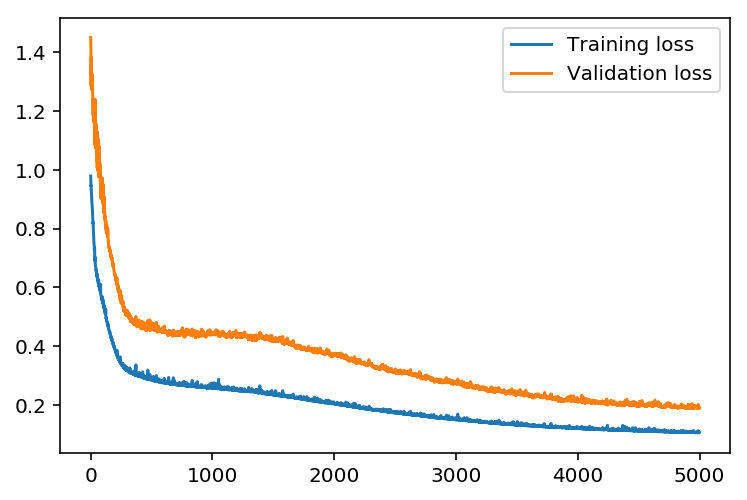

Start train for params iterations:8000,learning_rate:0.30,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.063 ... Validation loss: 0.168

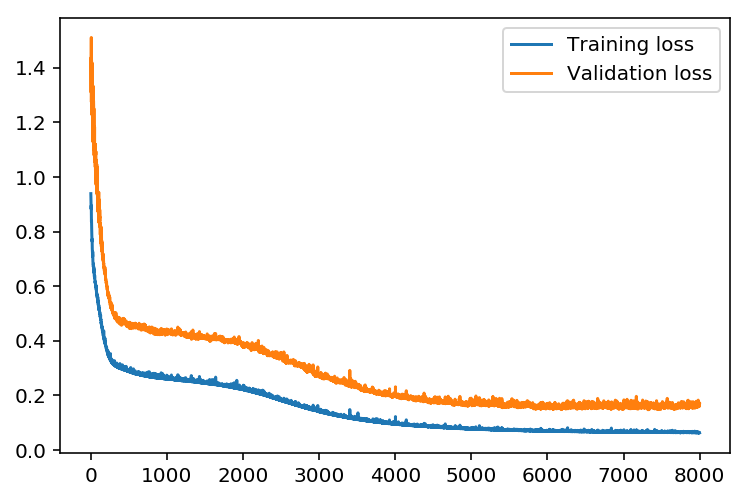

Start train for params iterations:10000,learning_rate:0.30,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.066 ... Validation loss: 0.156

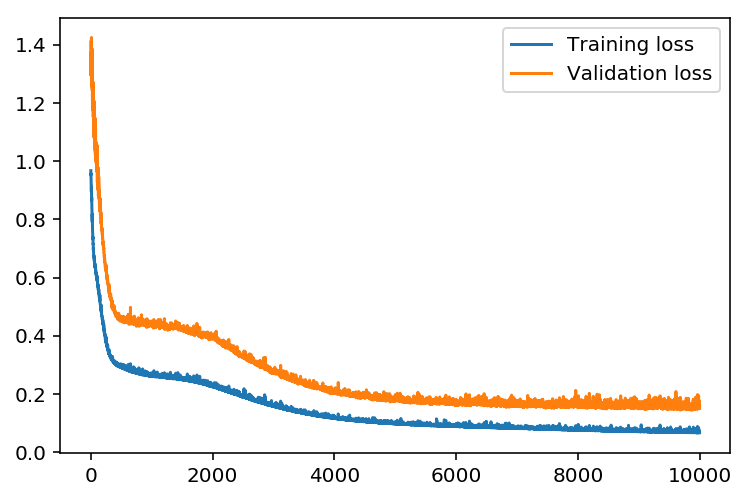

Start train for params iterations:1000,learning_rate:0.10,hidden_nodes:10,output_nodes:1
Progress: 99.9% ... Training loss: 0.300 ... Validation loss: 0.479

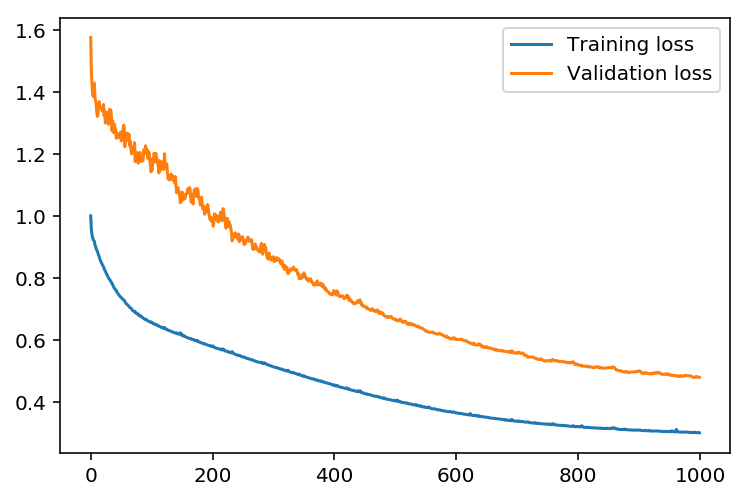

Start train for params iterations:1500,learning_rate:0.10,hidden_nodes:10,output_nodes:1
Progress: 99.9% ... Training loss: 0.290 ... Validation loss: 0.450

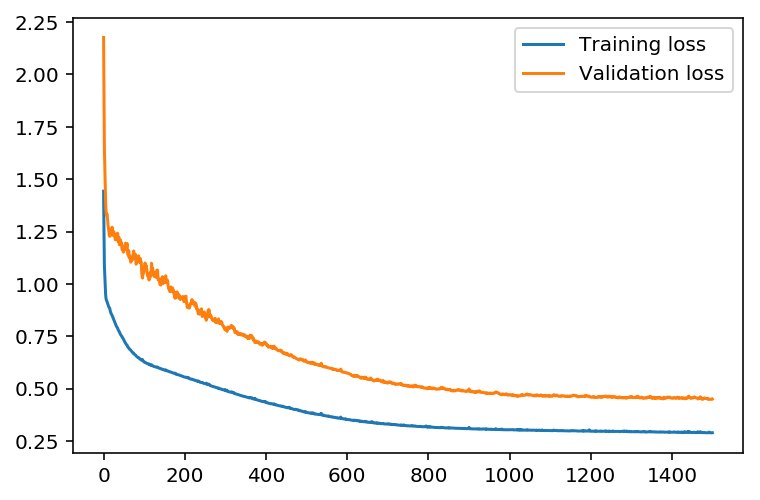

Start train for params iterations:2000,learning_rate:0.10,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.267 ... Validation loss: 0.433

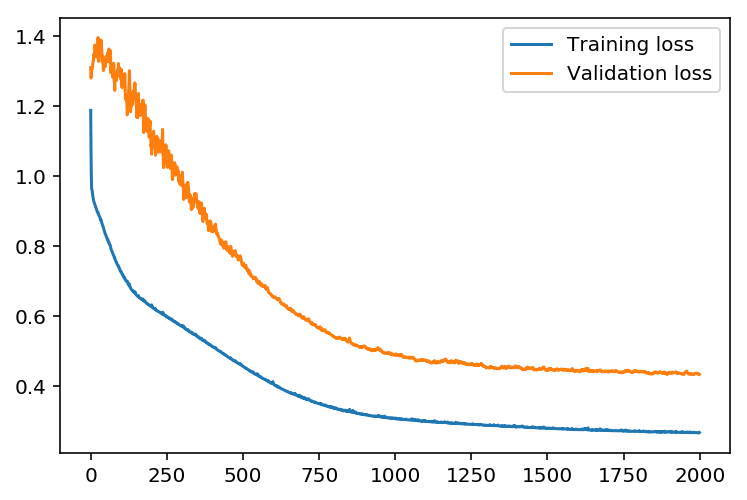

Start train for params iterations:3000,learning_rate:0.10,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.261 ... Validation loss: 0.432

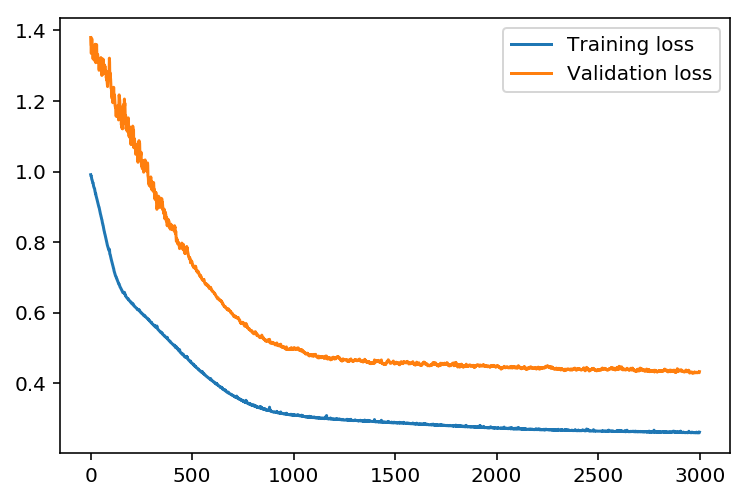

Start train for params iterations:5000,learning_rate:0.10,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.231 ... Validation loss: 0.412

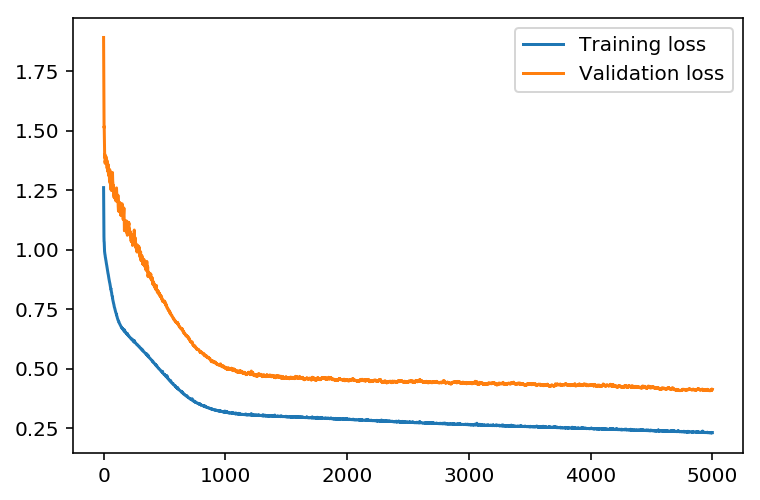

Start train for params iterations:8000,learning_rate:0.10,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.146 ... Validation loss: 0.276

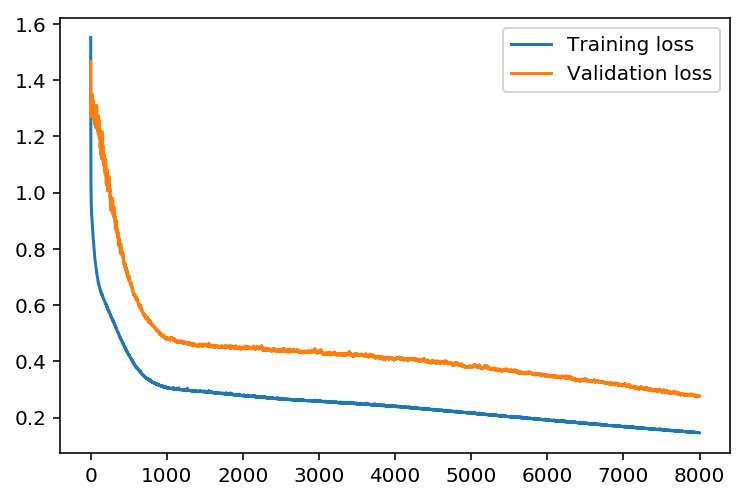

Start train for params iterations:10000,learning_rate:0.10,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.149 ... Validation loss: 0.278

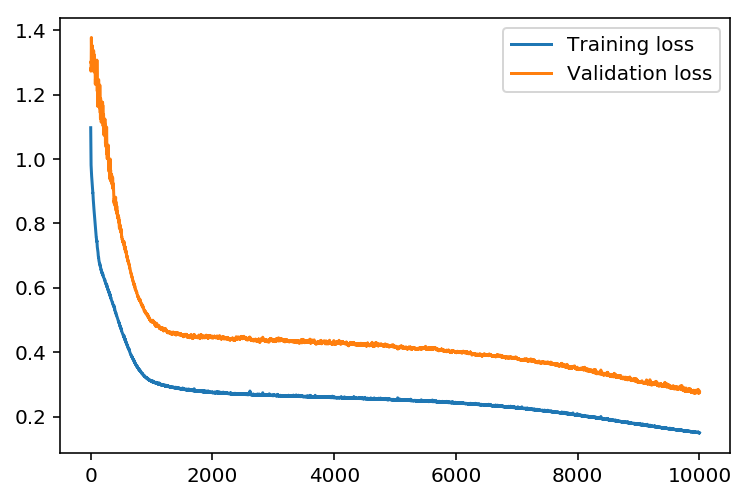

In [192]:
# search the best param for network
iterations_array = [1000, 1500, 2000, 3000, 5000, 8000, 10000]
learning_rate_array = sorted(map(lambda x:x/10.0, range(1,11,2)),reverse=True)
hidden_nodes_array = sorted(range(10, 21, 2),reverse=True)

results = list() # save the train param

# use the mutil thread

for hn in hidden_nodes_array:
    for lr in learning_rate_array:
        for its in iterations_array:
            result = grid_search(its, lr, hn)
            results.append(result)

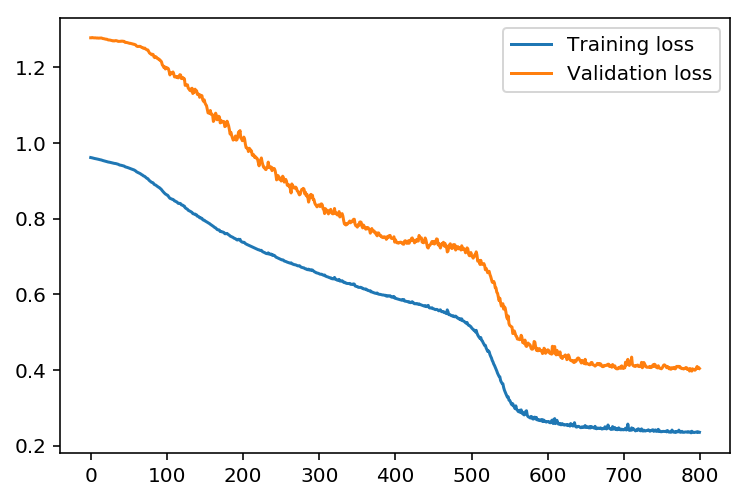

{'iterations': 1000, 'learning_rate': 0.9, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.235 validation loss: train loss :0.403


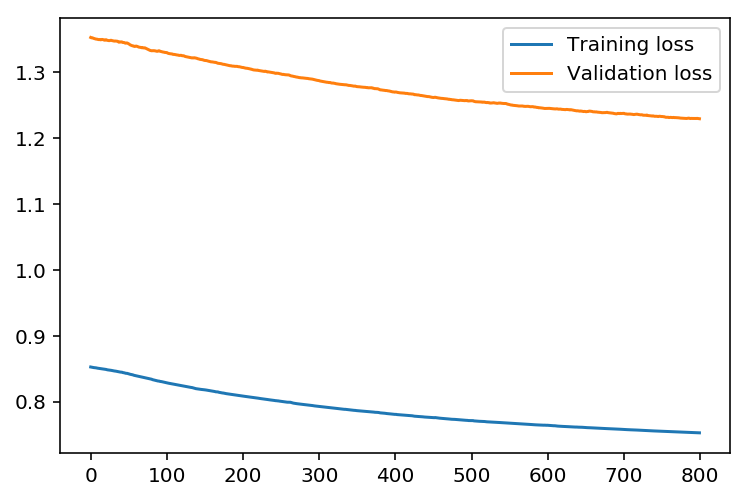

{'iterations': 1500, 'learning_rate': 0.9, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.752 validation loss: train loss :1.229


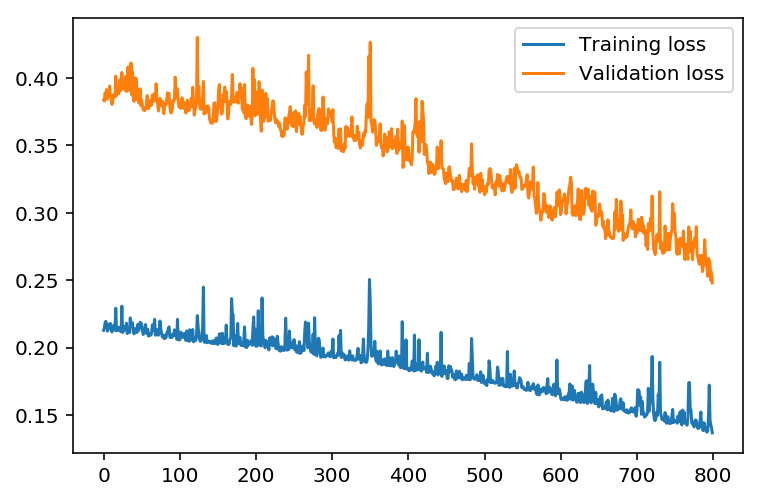

{'iterations': 2000, 'learning_rate': 0.9, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.136 validation loss: train loss :0.248


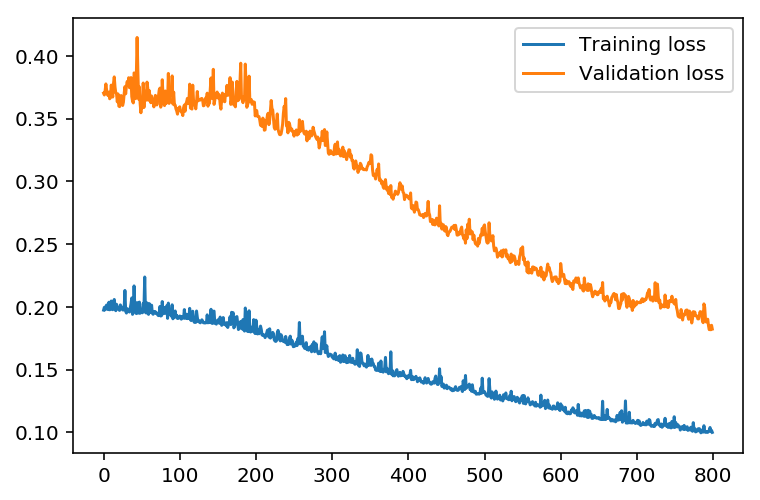

{'iterations': 3000, 'learning_rate': 0.9, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.100 validation loss: train loss :0.182


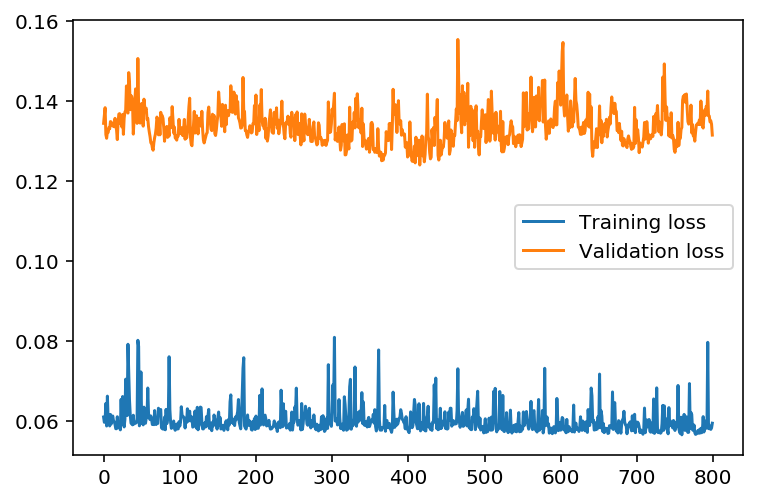

{'iterations': 5000, 'learning_rate': 0.9, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.059 validation loss: train loss :0.131


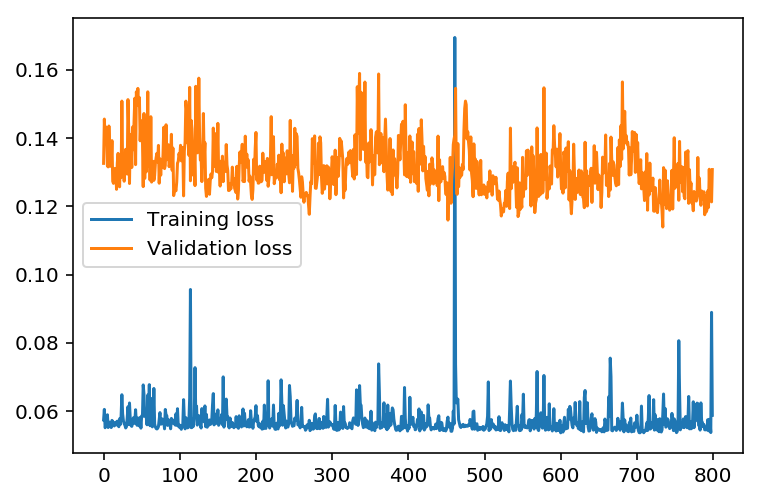

{'iterations': 8000, 'learning_rate': 0.9, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.058 validation loss: train loss :0.130


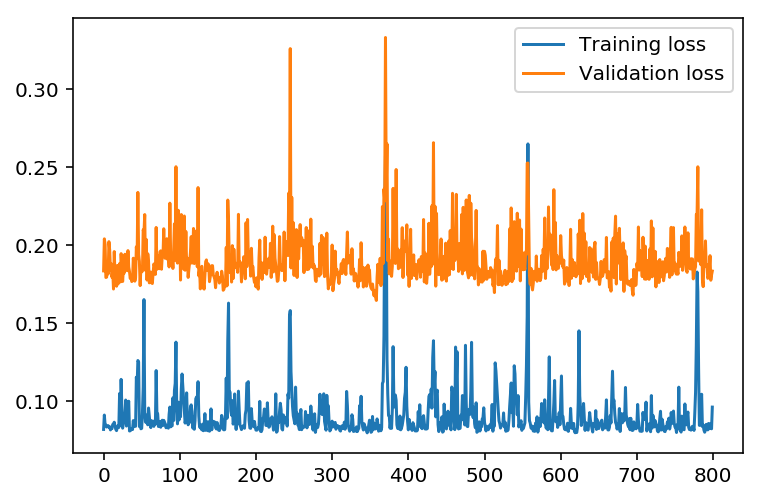

{'iterations': 10000, 'learning_rate': 0.9, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.096 validation loss: train loss :0.183


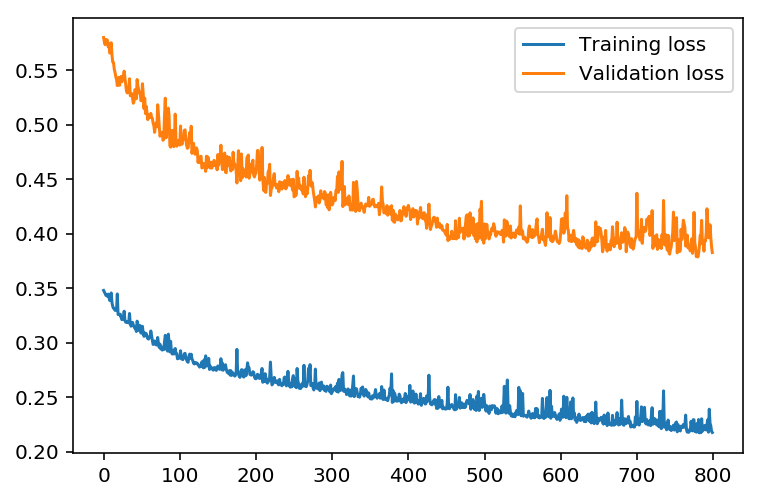

{'iterations': 1000, 'learning_rate': 0.7, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.217 validation loss: train loss :0.382


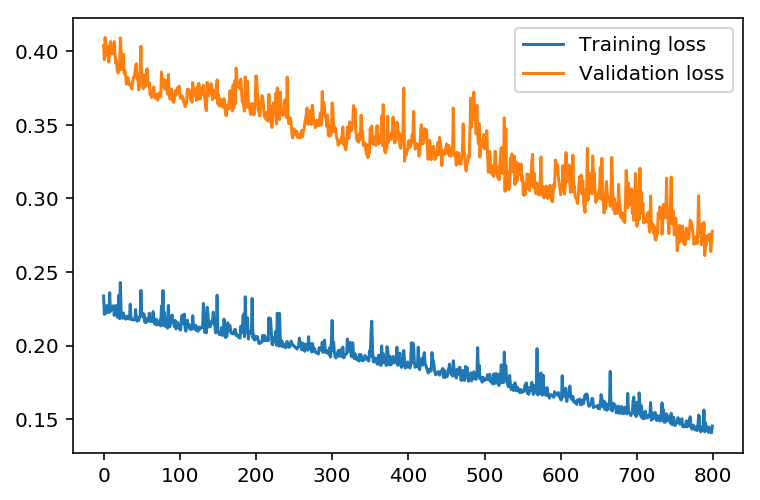

{'iterations': 1500, 'learning_rate': 0.7, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.145 validation loss: train loss :0.277


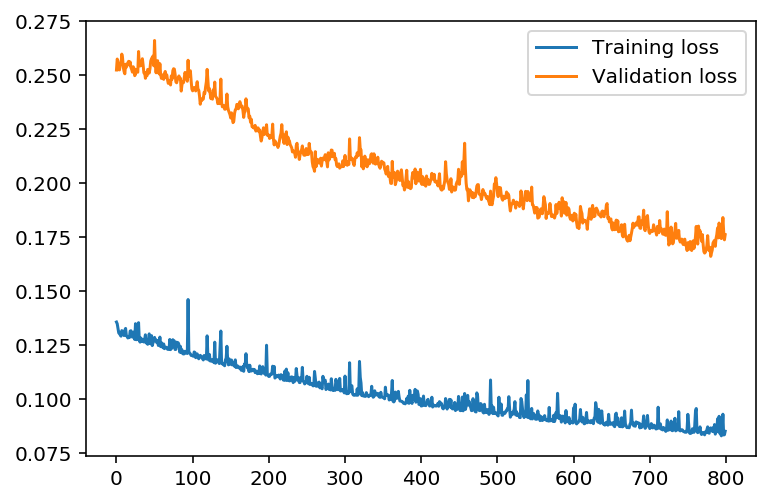

{'iterations': 2000, 'learning_rate': 0.7, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.084 validation loss: train loss :0.176


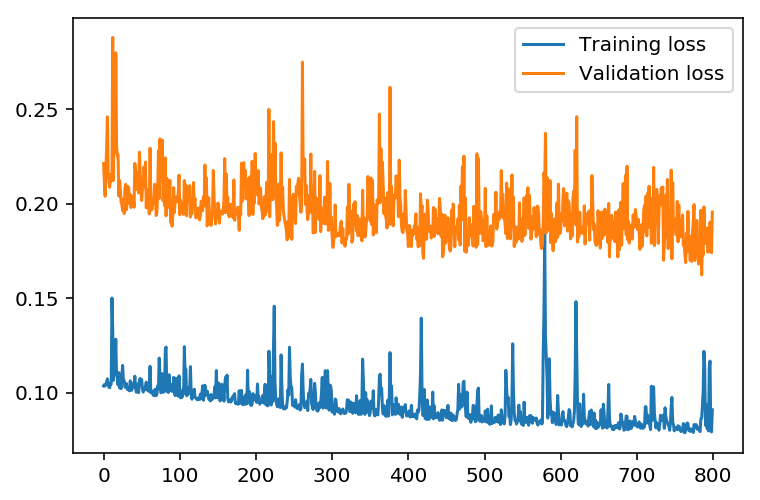

{'iterations': 3000, 'learning_rate': 0.7, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.091 validation loss: train loss :0.195


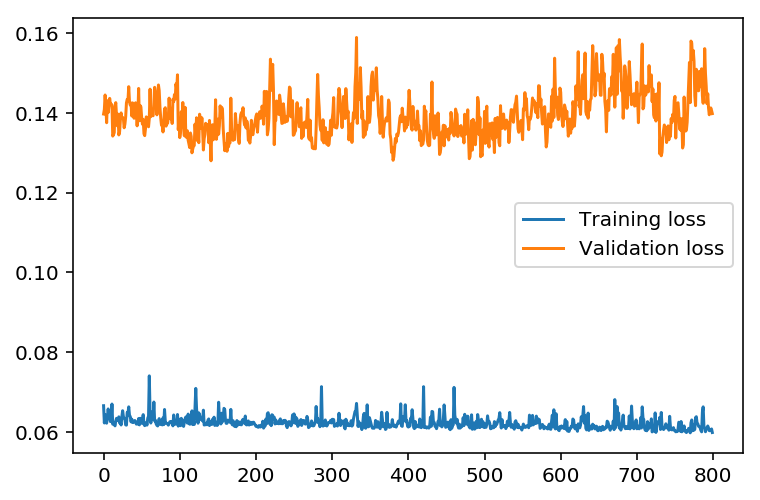

{'iterations': 5000, 'learning_rate': 0.7, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.059 validation loss: train loss :0.139


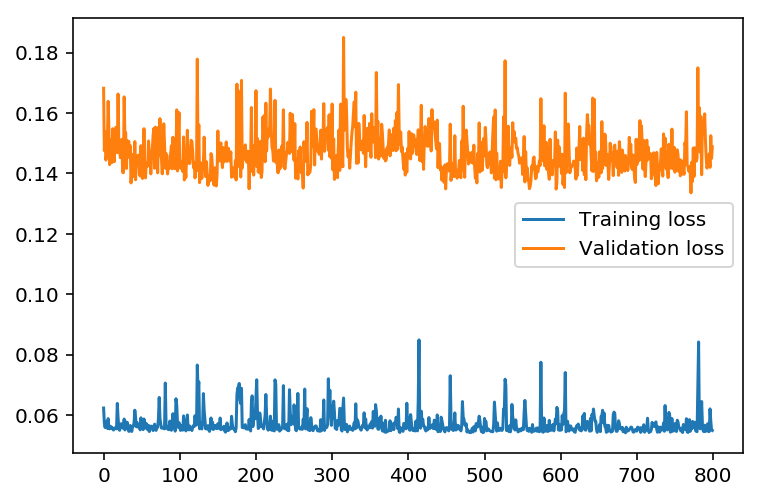

{'iterations': 8000, 'learning_rate': 0.7, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.054 validation loss: train loss :0.148


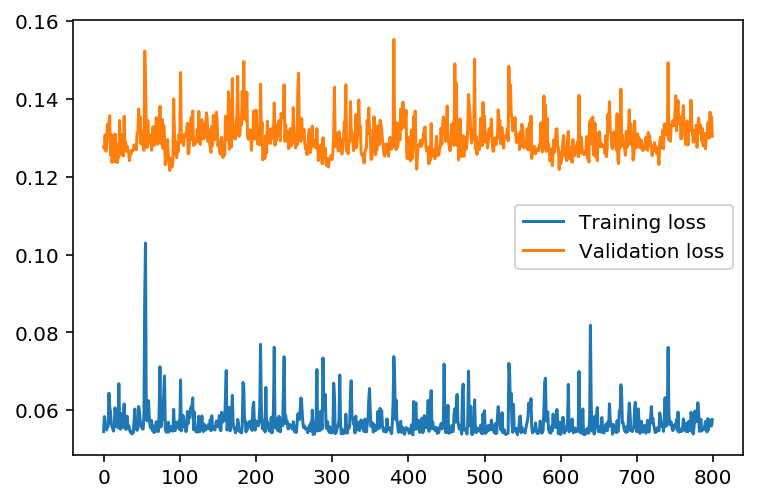

{'iterations': 10000, 'learning_rate': 0.7, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.057 validation loss: train loss :0.130


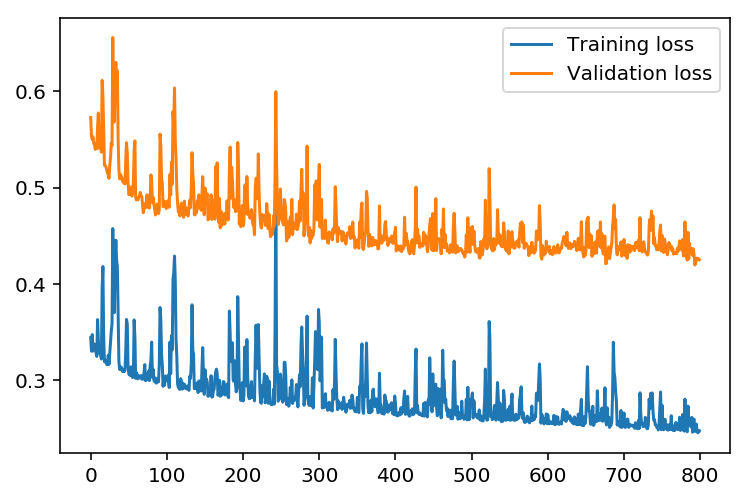

{'iterations': 1000, 'learning_rate': 0.5, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.247 validation loss: train loss :0.425


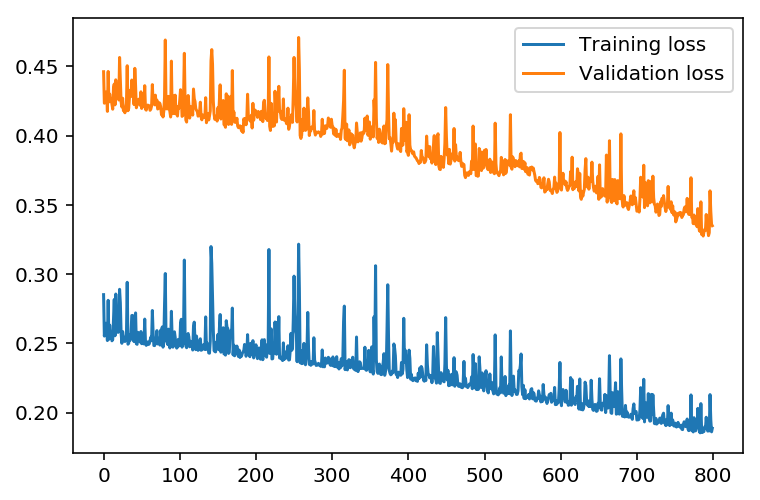

{'iterations': 1500, 'learning_rate': 0.5, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.188 validation loss: train loss :0.334


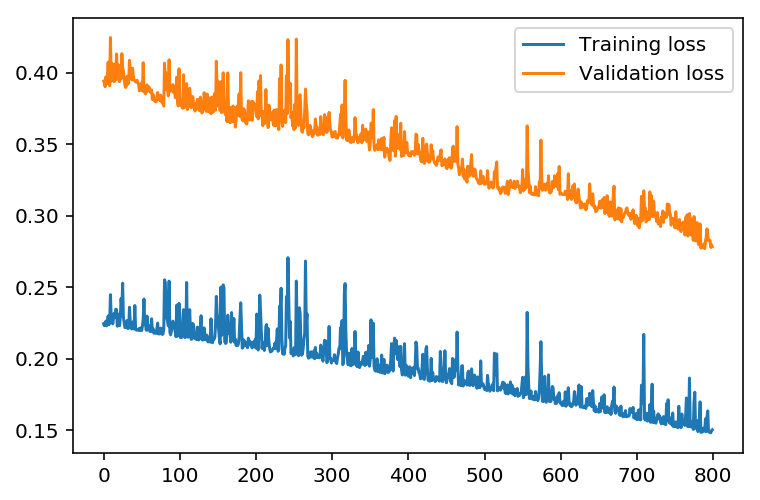

{'iterations': 2000, 'learning_rate': 0.5, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.150 validation loss: train loss :0.278


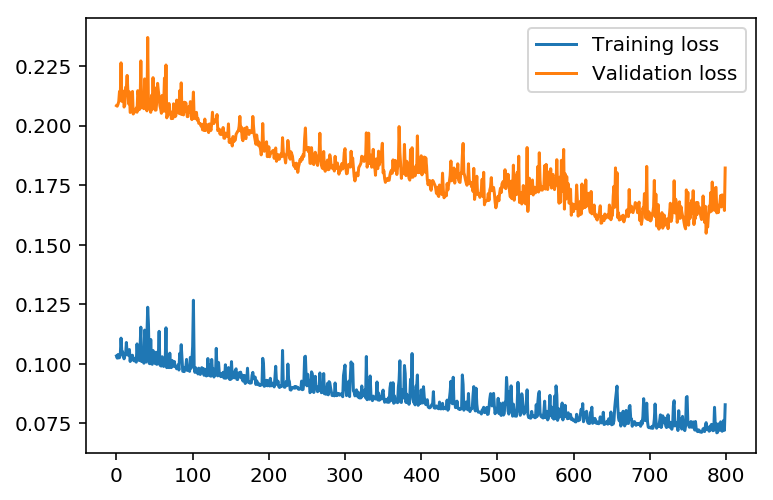

{'iterations': 3000, 'learning_rate': 0.5, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.082 validation loss: train loss :0.182


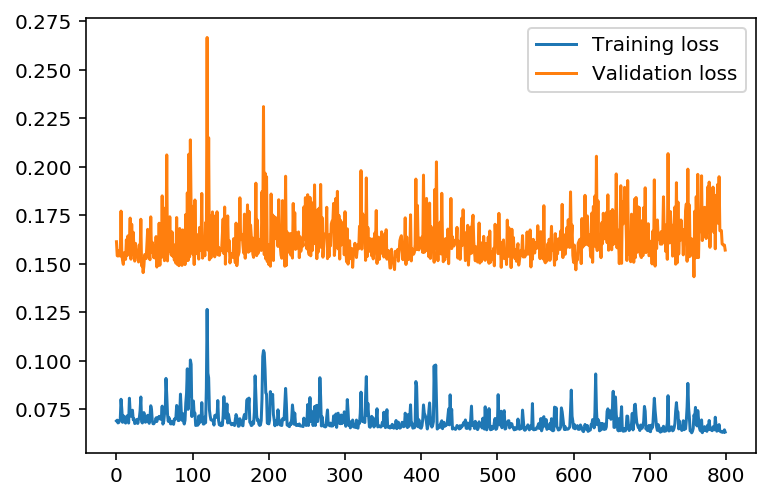

{'iterations': 5000, 'learning_rate': 0.5, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.063 validation loss: train loss :0.156


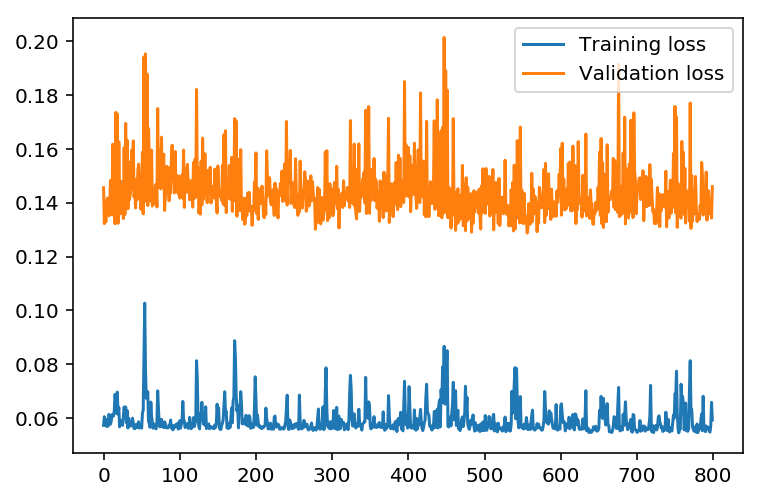

{'iterations': 8000, 'learning_rate': 0.5, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.059 validation loss: train loss :0.146


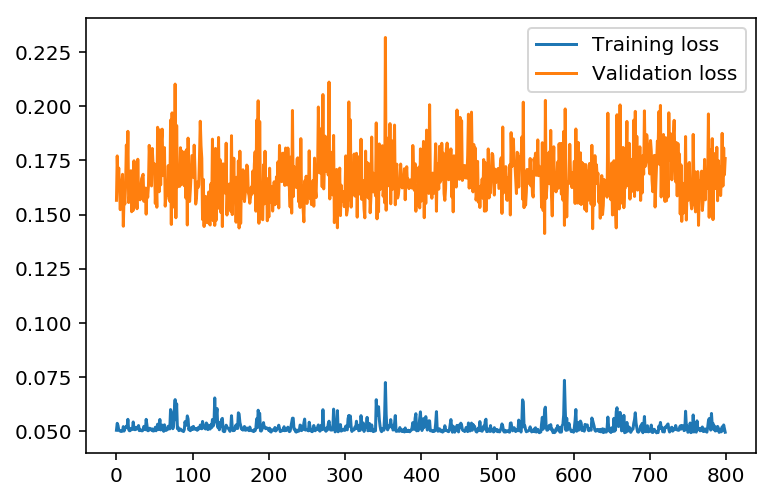

{'iterations': 10000, 'learning_rate': 0.5, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.049 validation loss: train loss :0.175


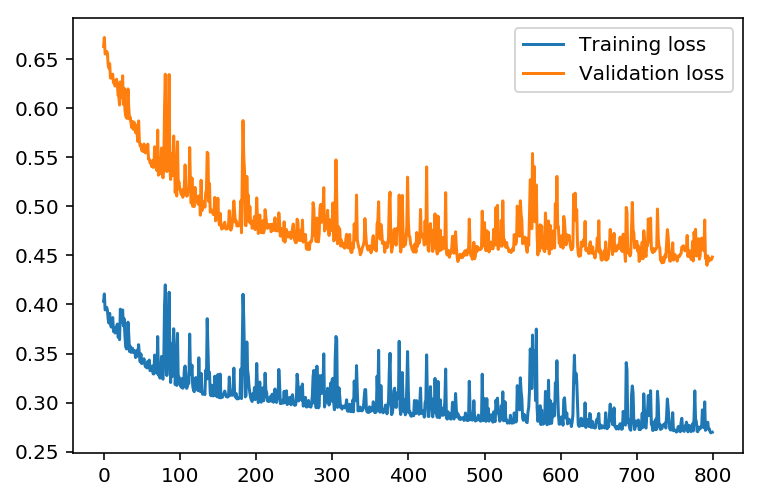

{'iterations': 1000, 'learning_rate': 0.3, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.269 validation loss: train loss :0.448


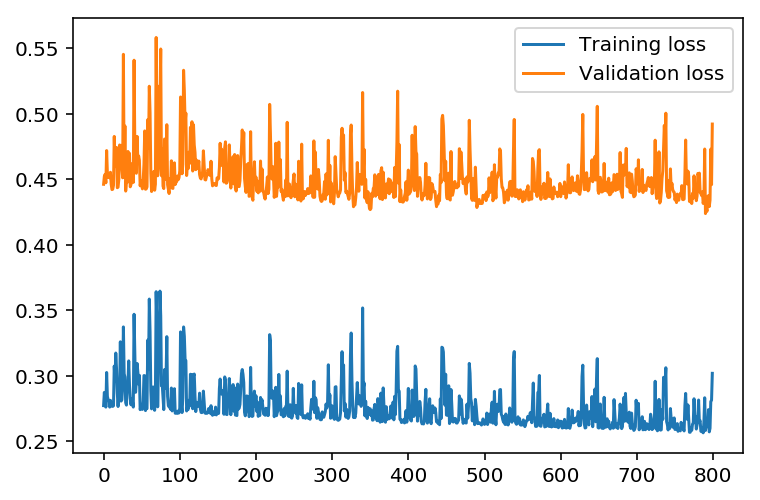

{'iterations': 1500, 'learning_rate': 0.3, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.301 validation loss: train loss :0.492


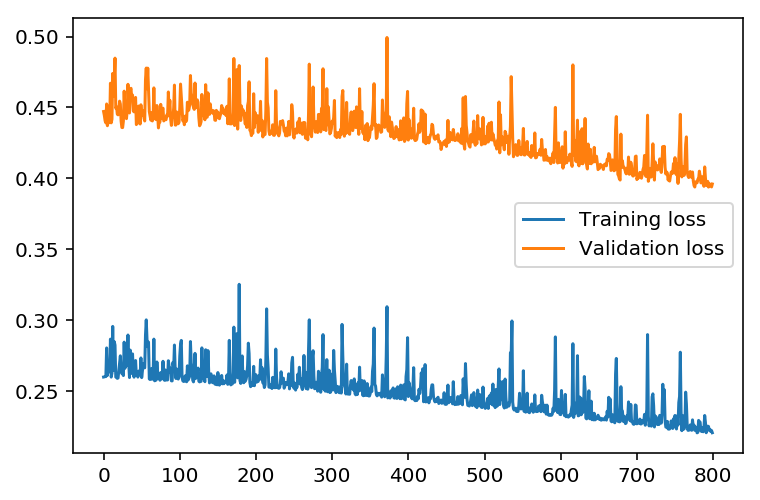

{'iterations': 2000, 'learning_rate': 0.3, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.220 validation loss: train loss :0.396


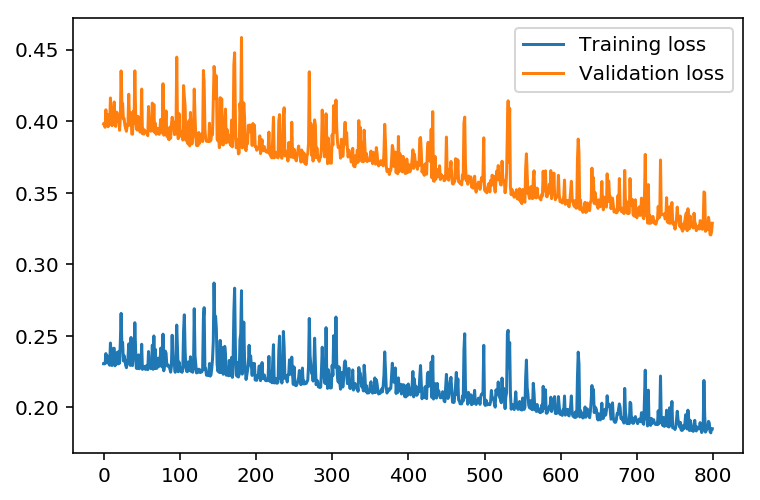

{'iterations': 3000, 'learning_rate': 0.3, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.185 validation loss: train loss :0.328


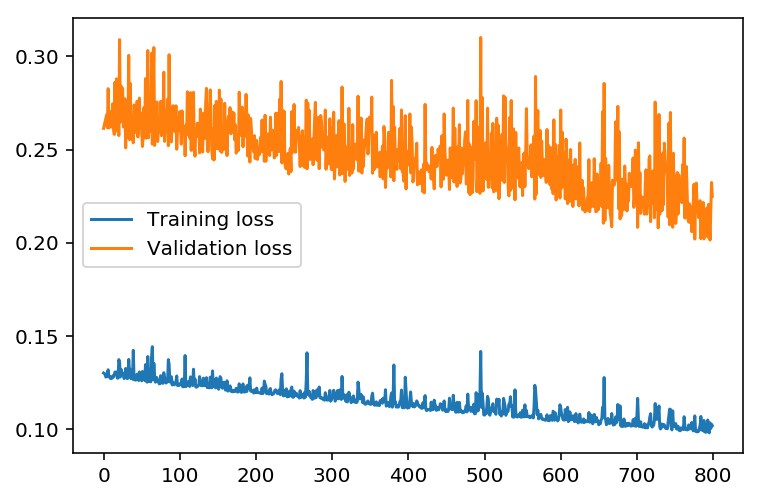

{'iterations': 5000, 'learning_rate': 0.3, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.101 validation loss: train loss :0.224


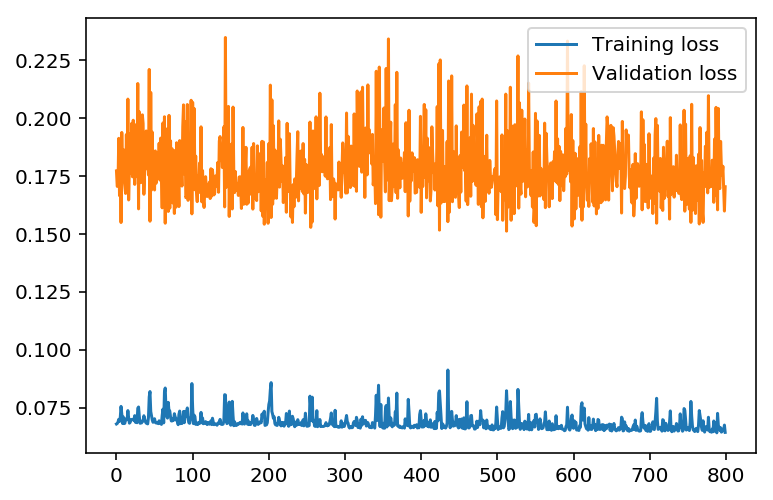

{'iterations': 8000, 'learning_rate': 0.3, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.064 validation loss: train loss :0.170


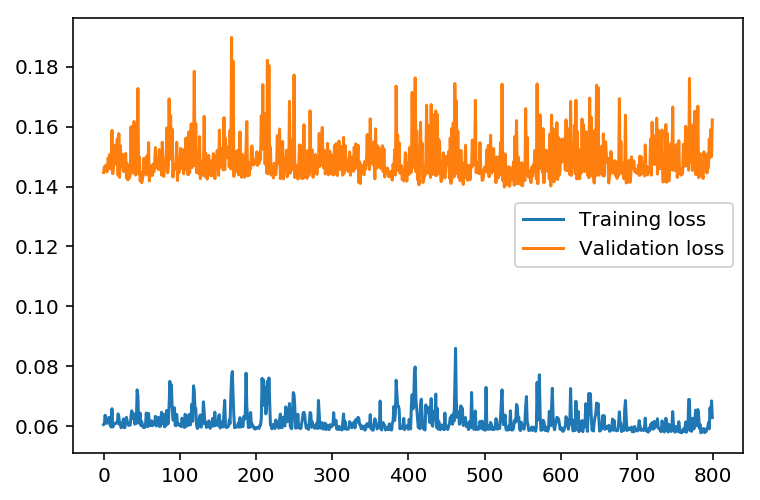

{'iterations': 10000, 'learning_rate': 0.3, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.062 validation loss: train loss :0.162


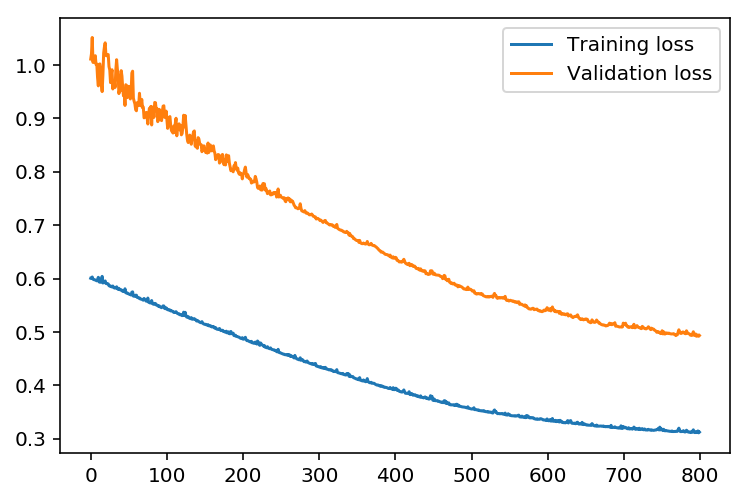

{'iterations': 1000, 'learning_rate': 0.1, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.312 validation loss: train loss :0.493


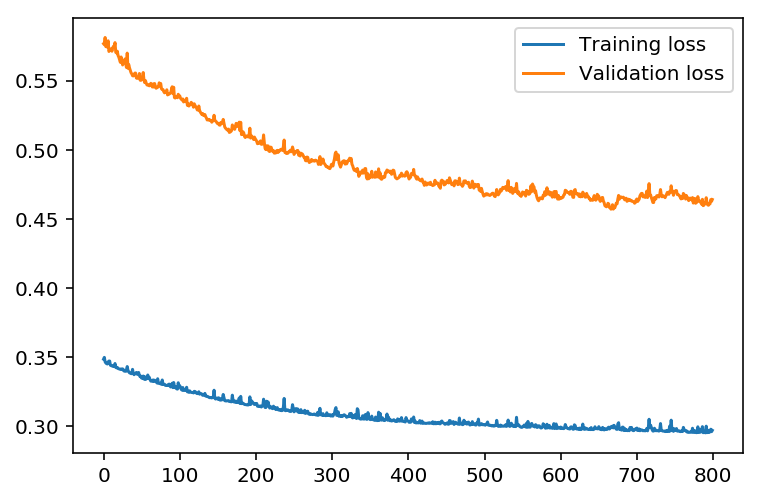

{'iterations': 1500, 'learning_rate': 0.1, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.297 validation loss: train loss :0.464


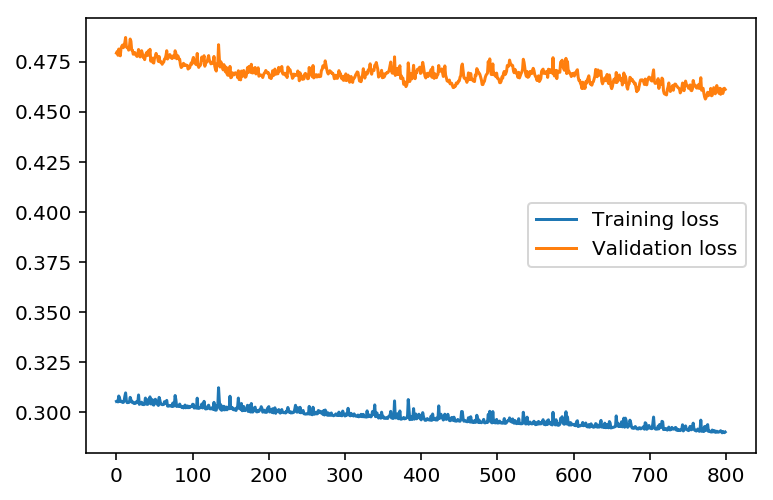

{'iterations': 2000, 'learning_rate': 0.1, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.290 validation loss: train loss :0.461


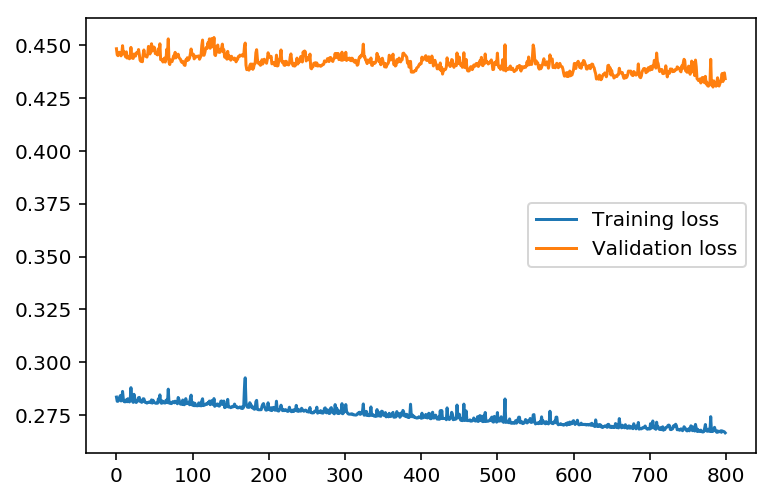

{'iterations': 3000, 'learning_rate': 0.1, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.266 validation loss: train loss :0.434


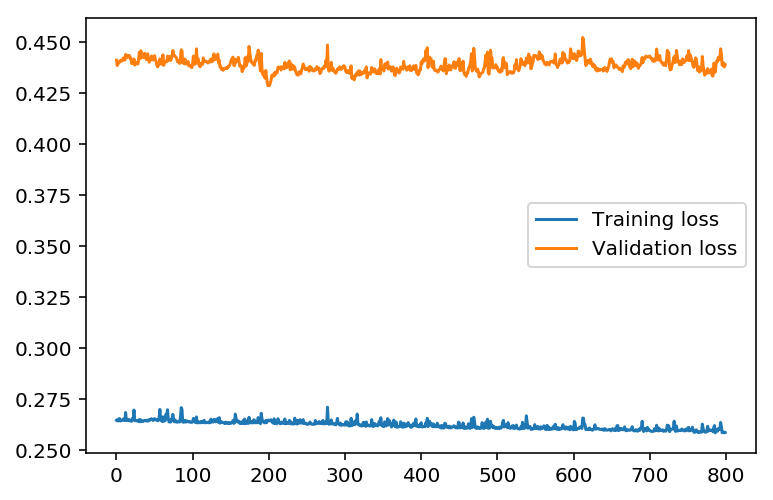

{'iterations': 5000, 'learning_rate': 0.1, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.258 validation loss: train loss :0.438


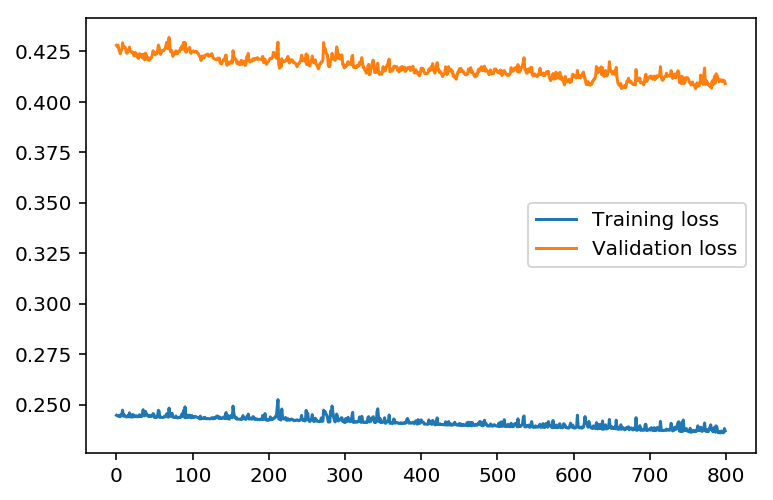

{'iterations': 8000, 'learning_rate': 0.1, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.236 validation loss: train loss :0.409


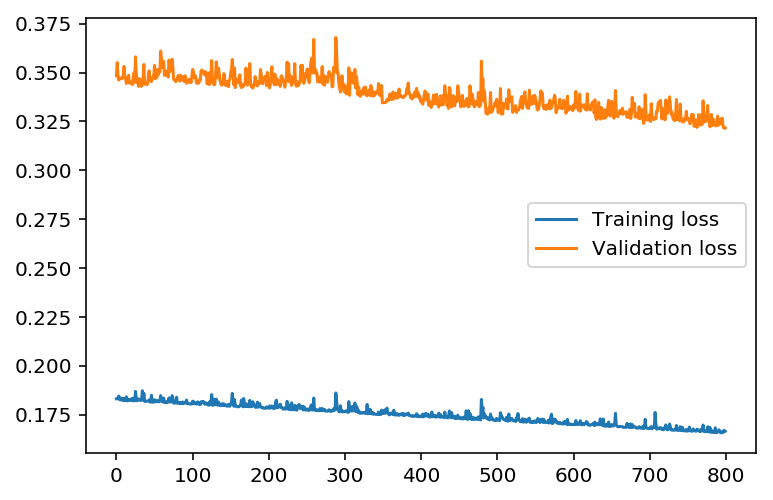

{'iterations': 10000, 'learning_rate': 0.1, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.166 validation loss: train loss :0.321


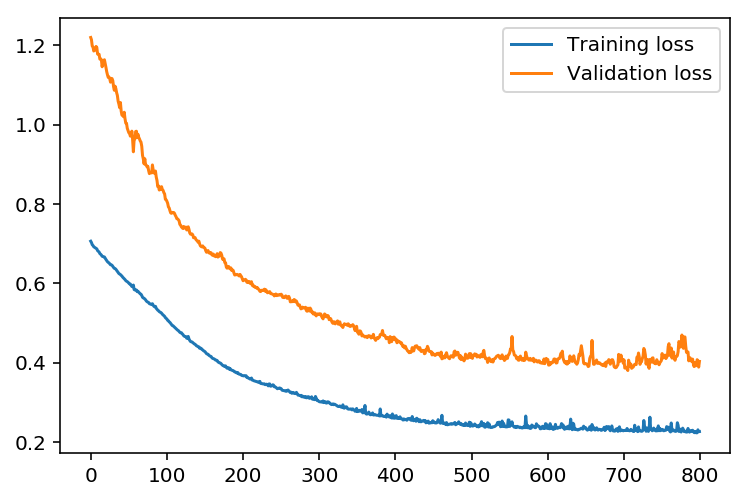

{'iterations': 1000, 'learning_rate': 0.9, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.226 validation loss: train loss :0.402


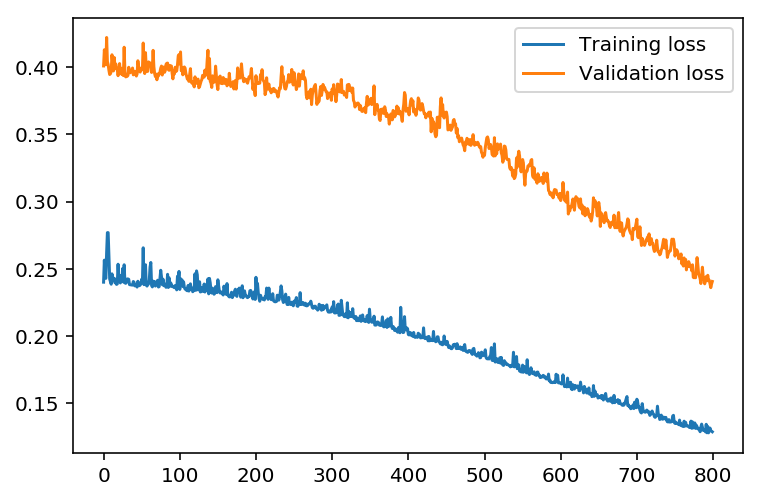

{'iterations': 1500, 'learning_rate': 0.9, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.128 validation loss: train loss :0.240


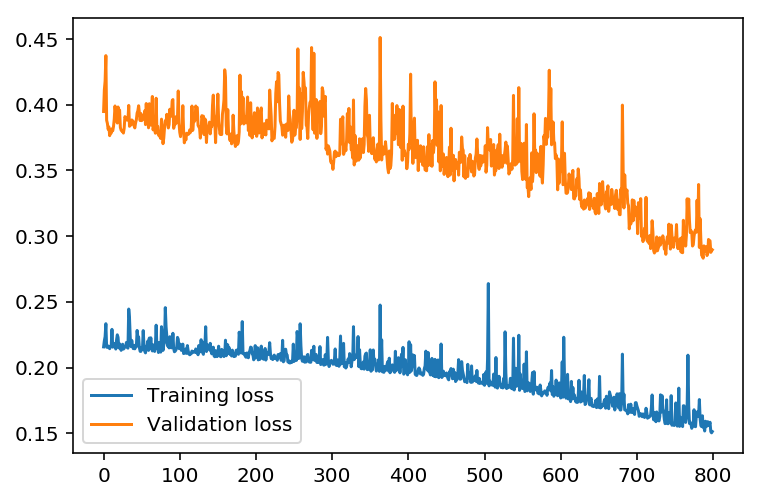

{'iterations': 2000, 'learning_rate': 0.9, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.151 validation loss: train loss :0.289


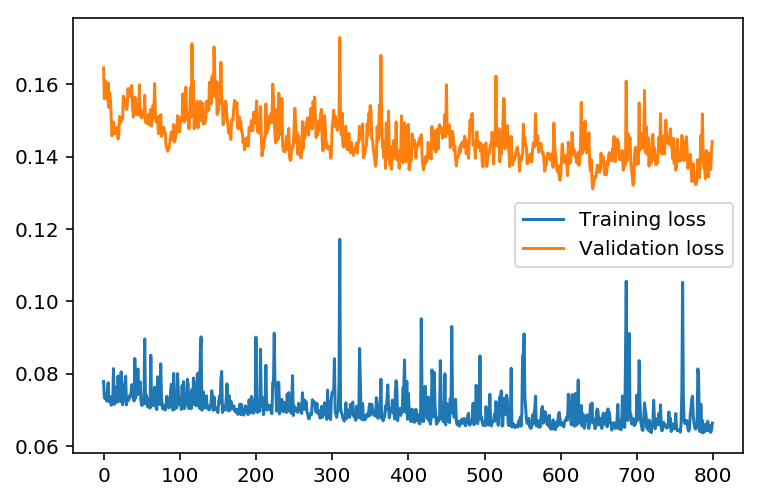

{'iterations': 3000, 'learning_rate': 0.9, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.066 validation loss: train loss :0.144


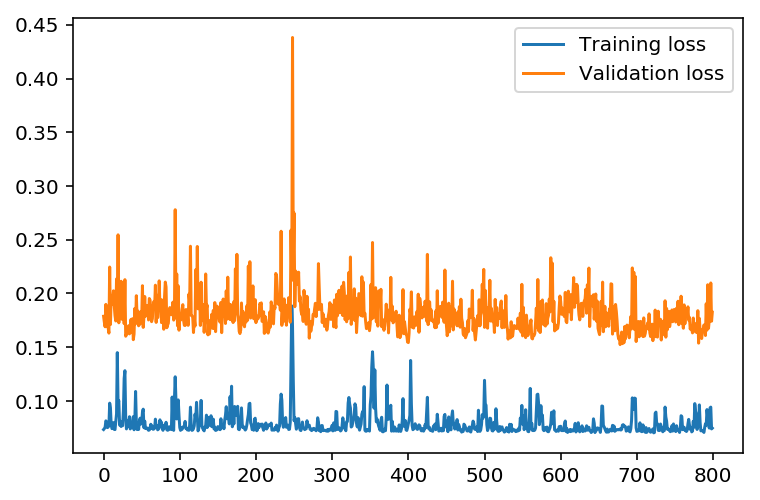

{'iterations': 5000, 'learning_rate': 0.9, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.074 validation loss: train loss :0.182


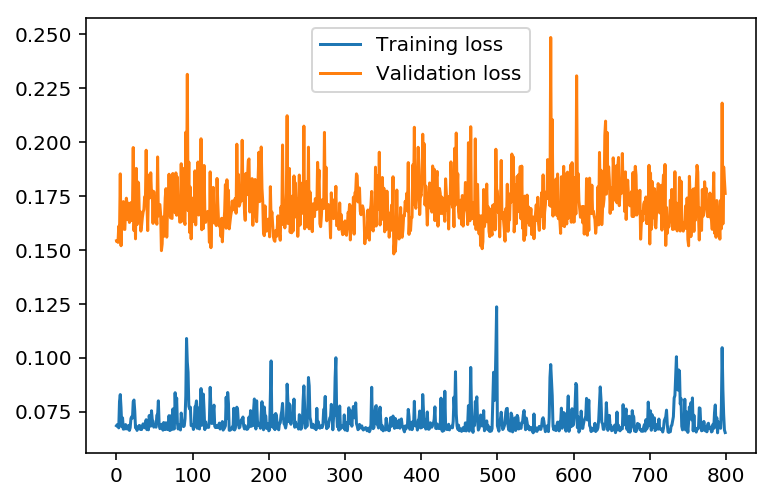

{'iterations': 8000, 'learning_rate': 0.9, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.065 validation loss: train loss :0.176


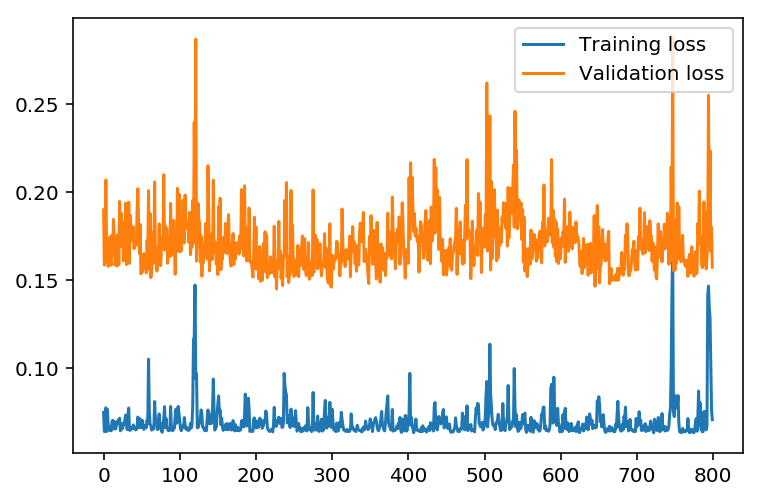

{'iterations': 10000, 'learning_rate': 0.9, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.070 validation loss: train loss :0.157


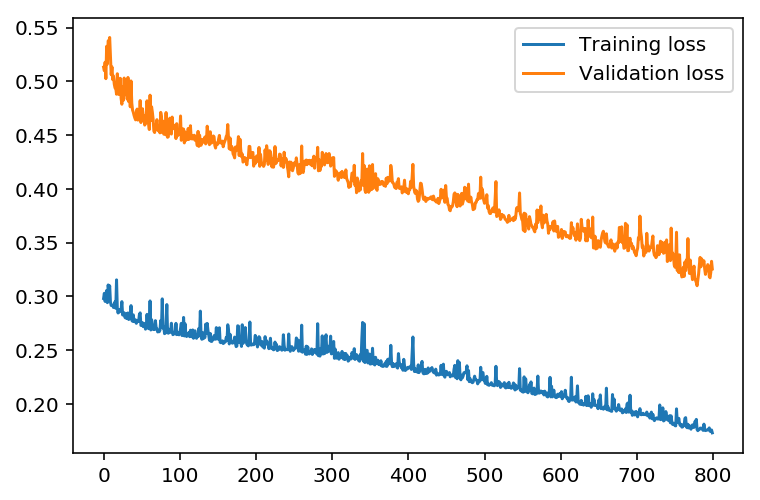

{'iterations': 1000, 'learning_rate': 0.7, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.173 validation loss: train loss :0.325


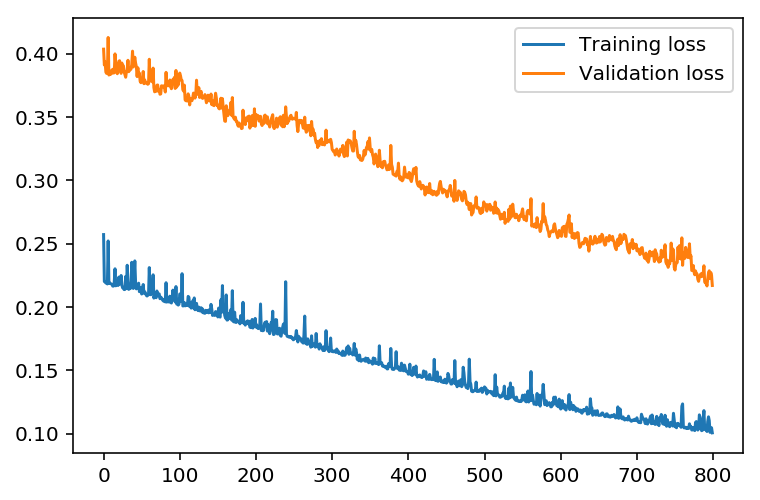

{'iterations': 1500, 'learning_rate': 0.7, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.100 validation loss: train loss :0.216


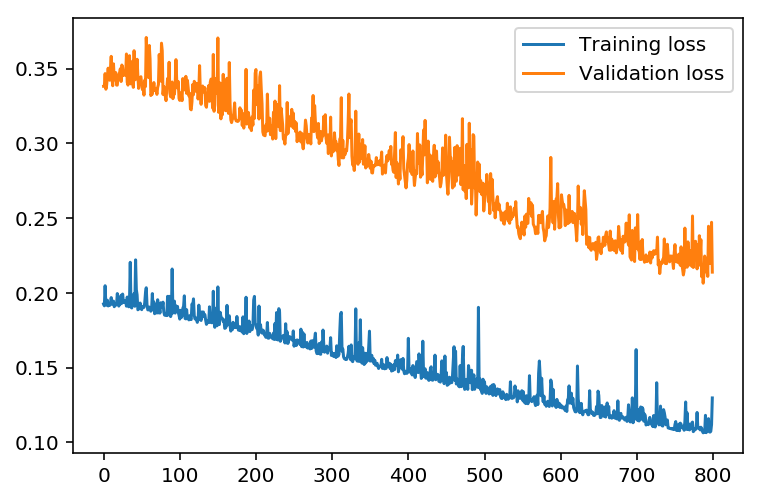

{'iterations': 2000, 'learning_rate': 0.7, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.129 validation loss: train loss :0.213


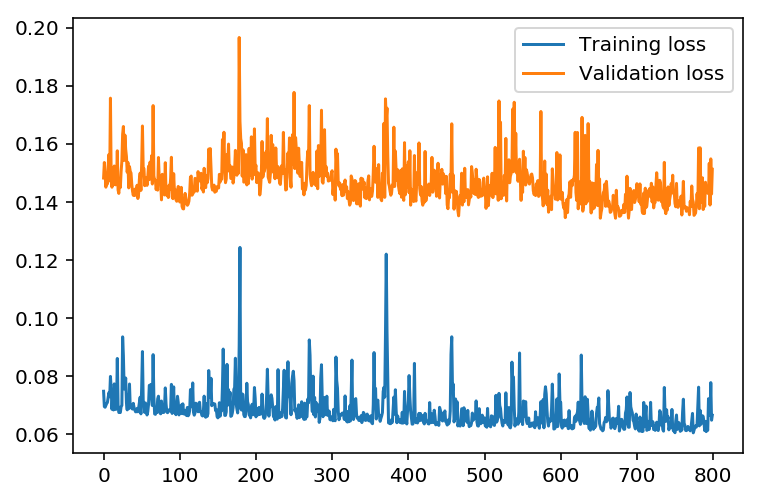

{'iterations': 3000, 'learning_rate': 0.7, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.066 validation loss: train loss :0.151


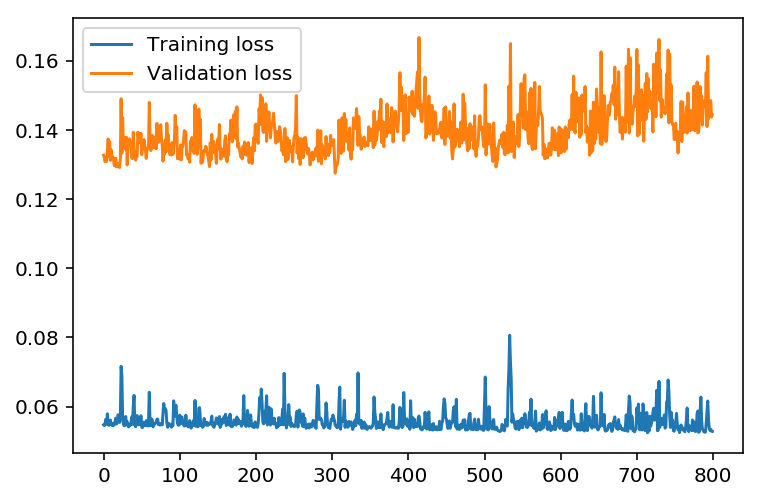

{'iterations': 5000, 'learning_rate': 0.7, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.052 validation loss: train loss :0.144


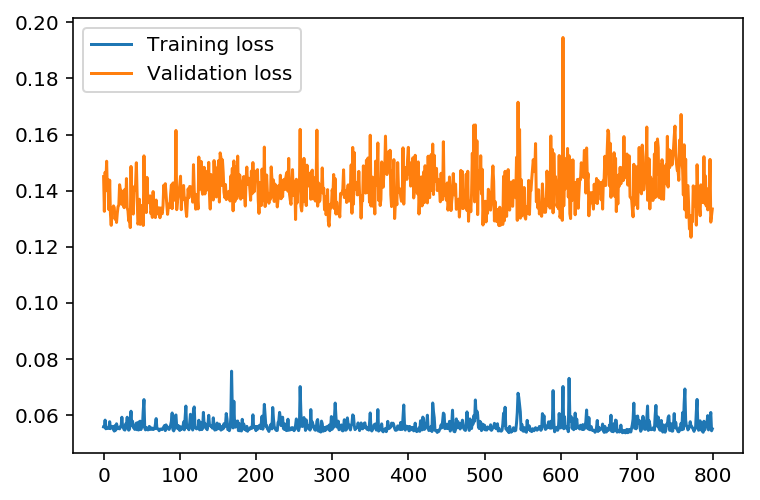

{'iterations': 8000, 'learning_rate': 0.7, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.055 validation loss: train loss :0.133


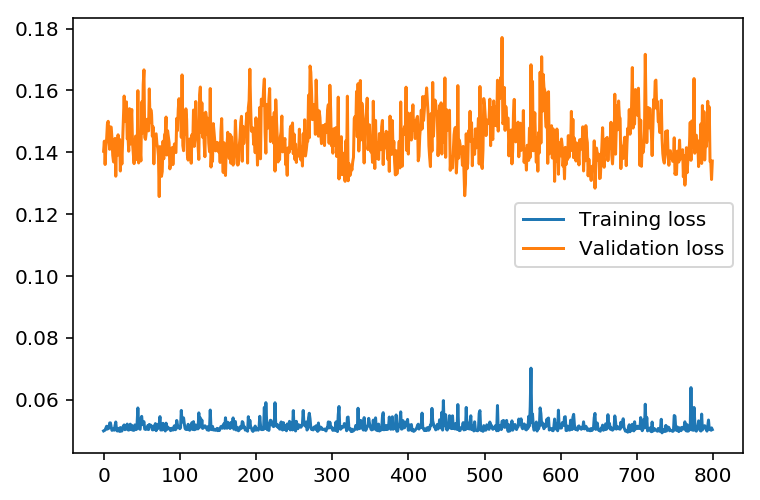

{'iterations': 10000, 'learning_rate': 0.7, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.050 validation loss: train loss :0.137


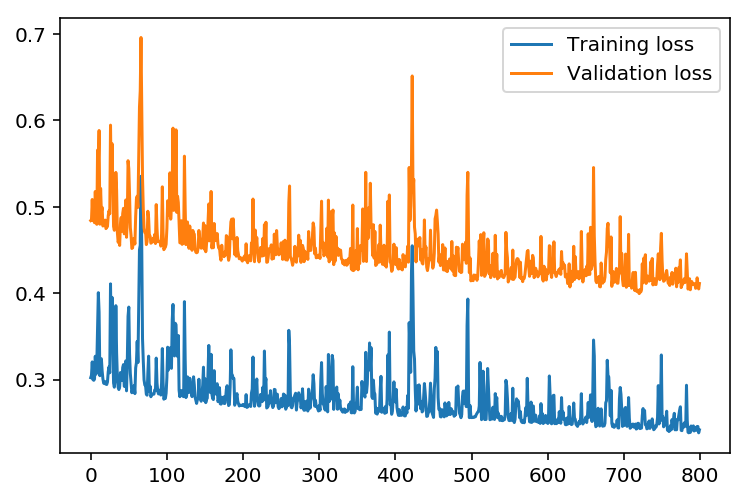

{'iterations': 1000, 'learning_rate': 0.5, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.242 validation loss: train loss :0.411


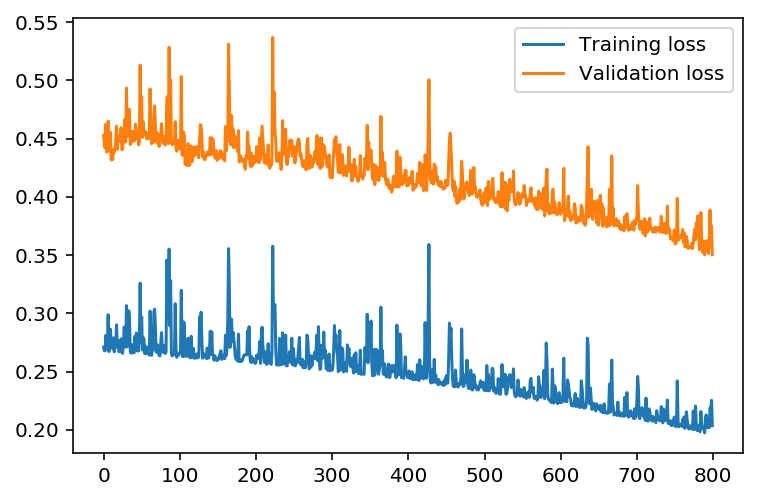

{'iterations': 1500, 'learning_rate': 0.5, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.203 validation loss: train loss :0.350


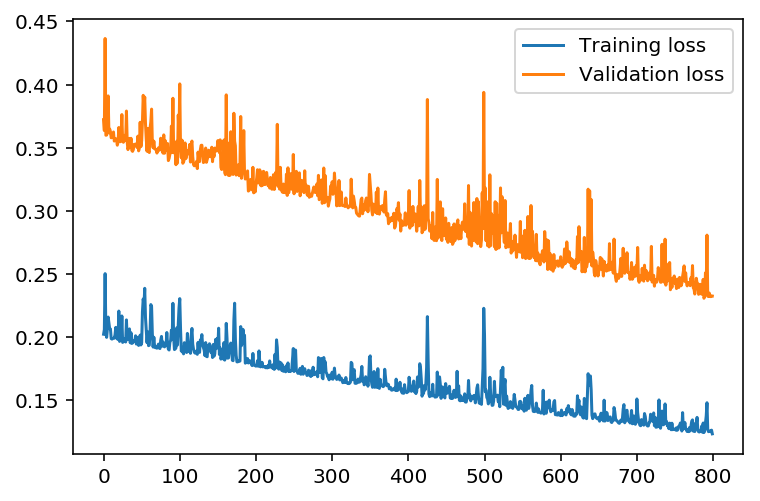

{'iterations': 2000, 'learning_rate': 0.5, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.123 validation loss: train loss :0.232


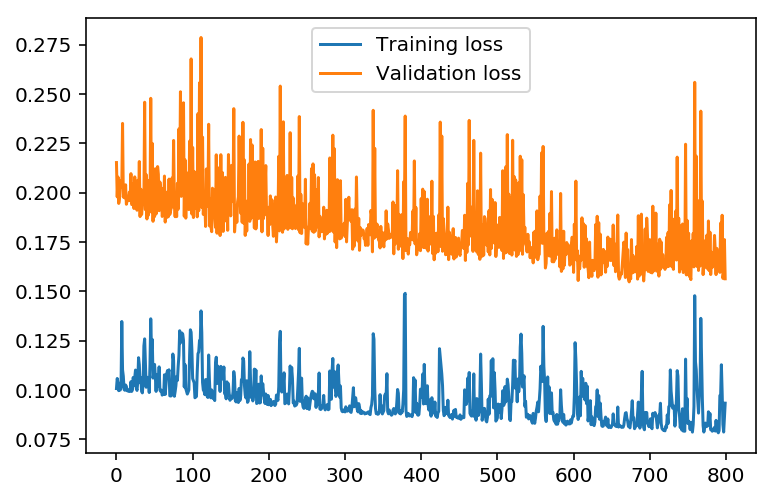

{'iterations': 3000, 'learning_rate': 0.5, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.093 validation loss: train loss :0.156


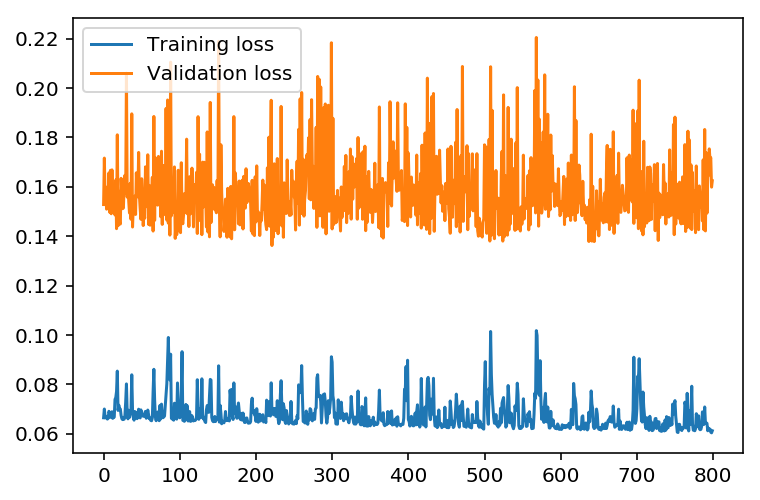

{'iterations': 5000, 'learning_rate': 0.5, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.061 validation loss: train loss :0.162


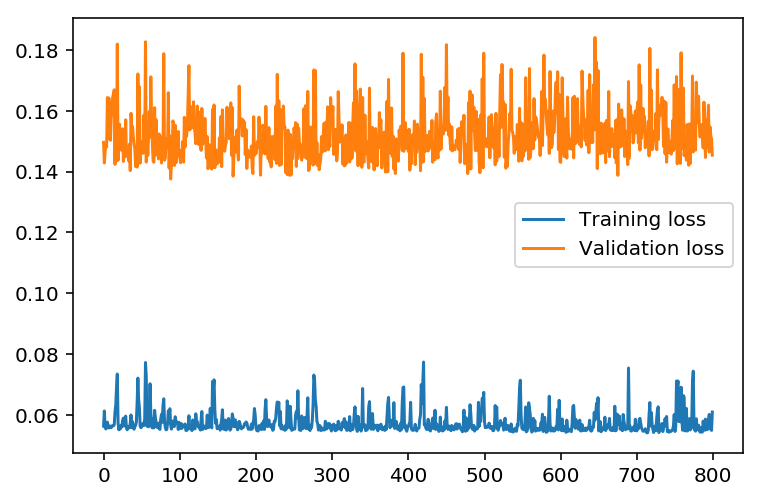

{'iterations': 8000, 'learning_rate': 0.5, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.060 validation loss: train loss :0.145


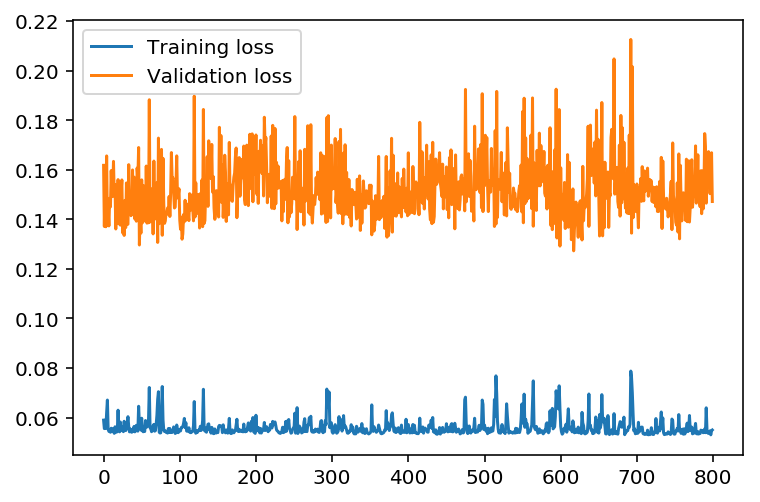

{'iterations': 10000, 'learning_rate': 0.5, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.055 validation loss: train loss :0.147


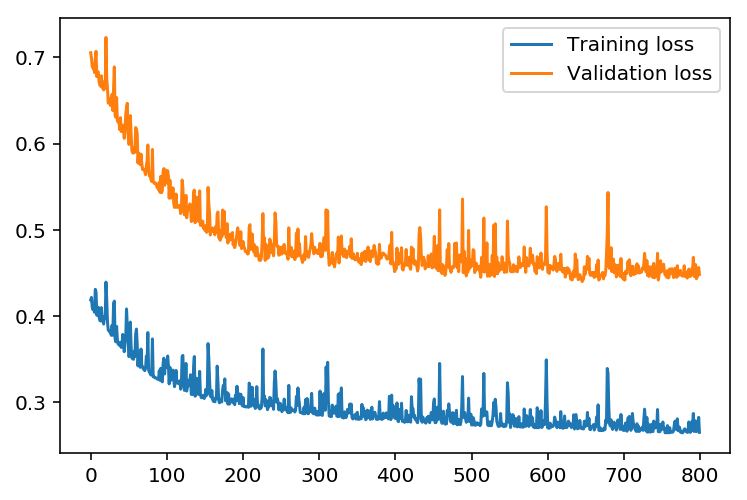

{'iterations': 1000, 'learning_rate': 0.3, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.265 validation loss: train loss :0.448


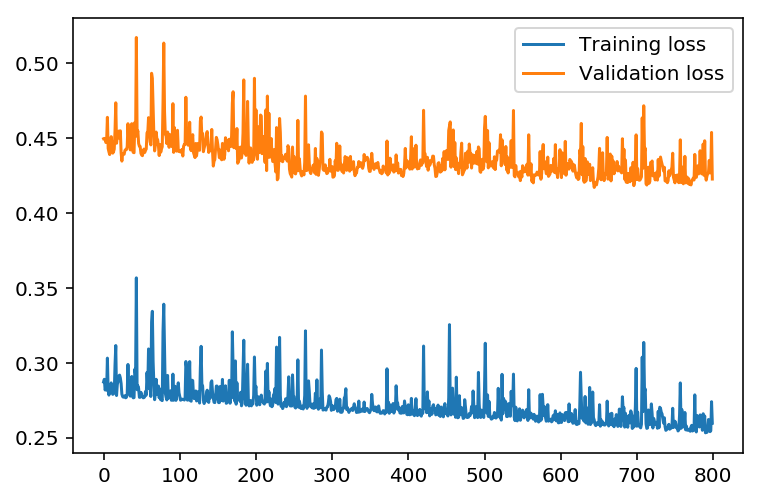

{'iterations': 1500, 'learning_rate': 0.3, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.259 validation loss: train loss :0.422


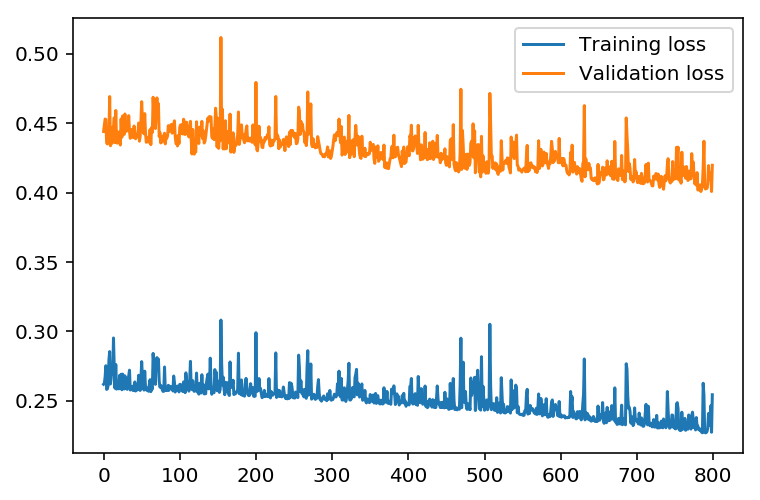

{'iterations': 2000, 'learning_rate': 0.3, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.254 validation loss: train loss :0.419


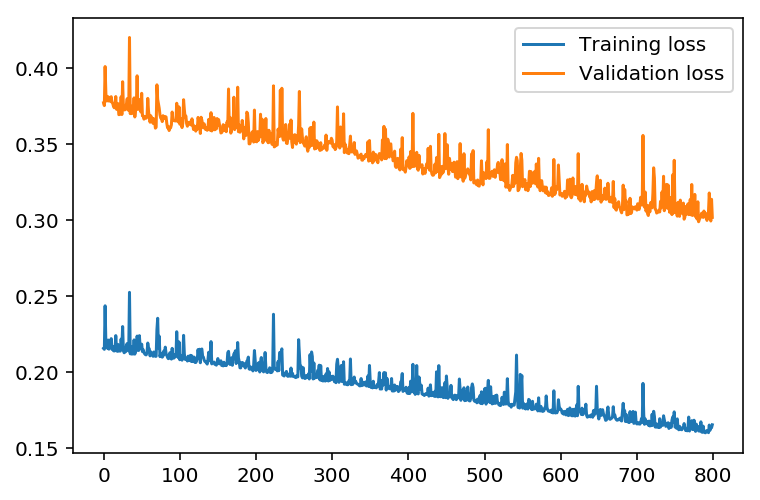

{'iterations': 3000, 'learning_rate': 0.3, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.165 validation loss: train loss :0.301


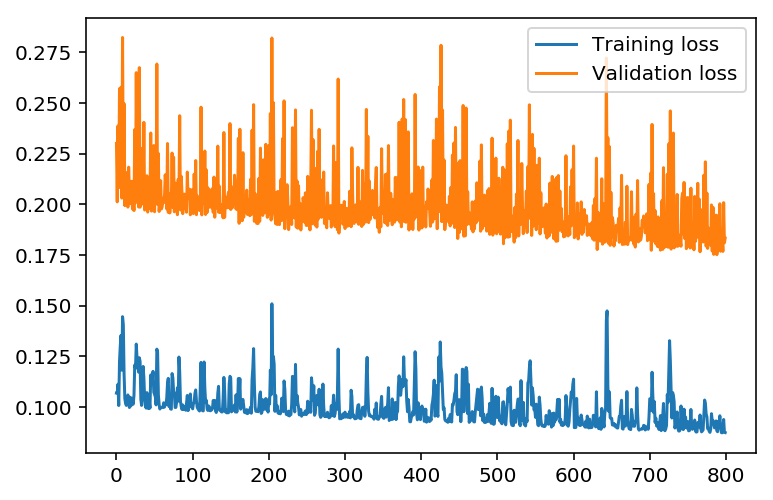

{'iterations': 5000, 'learning_rate': 0.3, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.087 validation loss: train loss :0.183


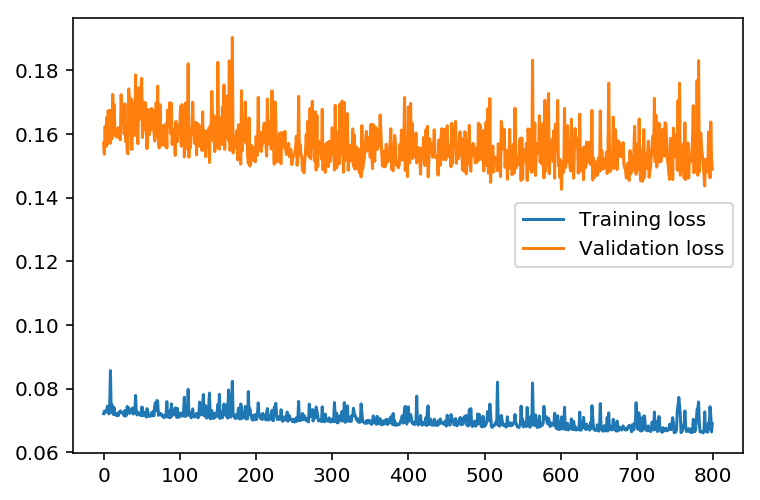

{'iterations': 8000, 'learning_rate': 0.3, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.068 validation loss: train loss :0.148


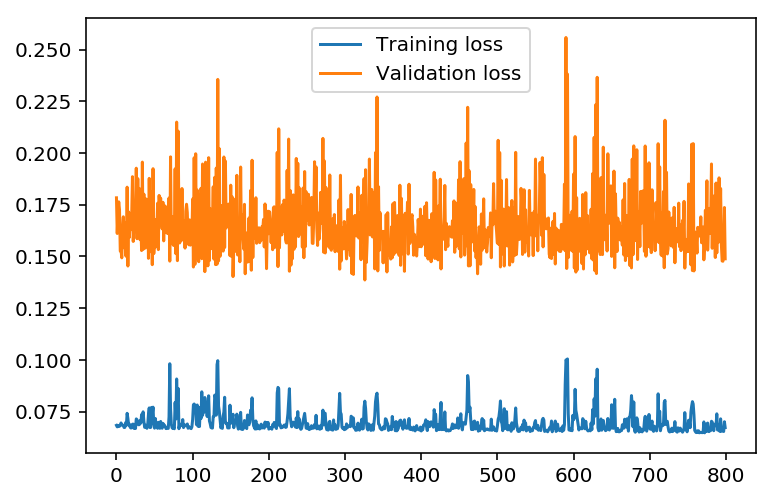

{'iterations': 10000, 'learning_rate': 0.3, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.067 validation loss: train loss :0.148


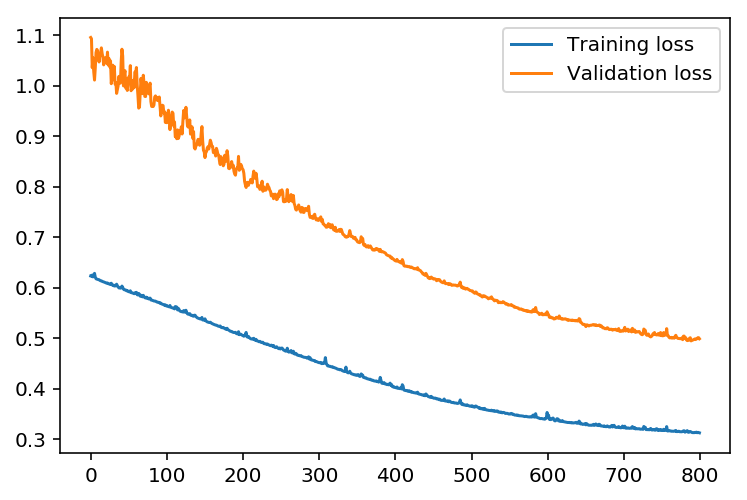

{'iterations': 1000, 'learning_rate': 0.1, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.312 validation loss: train loss :0.499


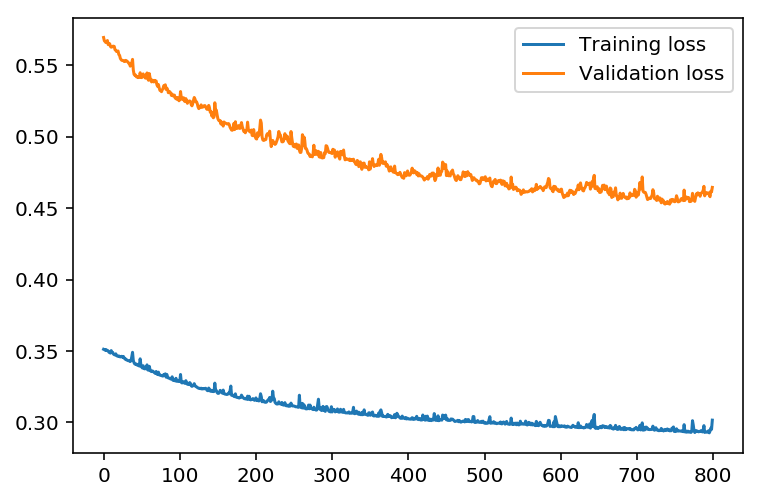

{'iterations': 1500, 'learning_rate': 0.1, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.301 validation loss: train loss :0.464


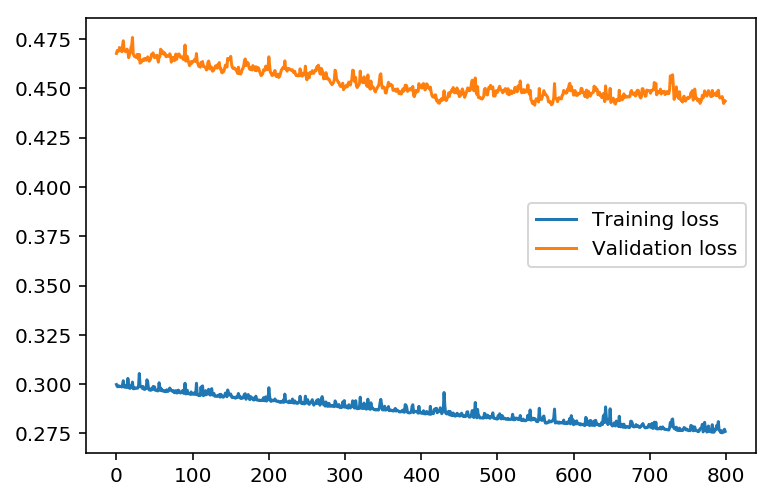

{'iterations': 2000, 'learning_rate': 0.1, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.276 validation loss: train loss :0.443


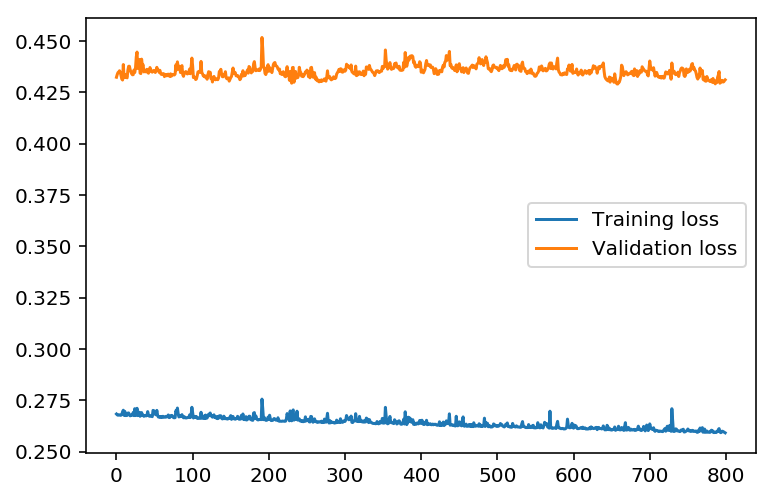

{'iterations': 3000, 'learning_rate': 0.1, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.259 validation loss: train loss :0.431


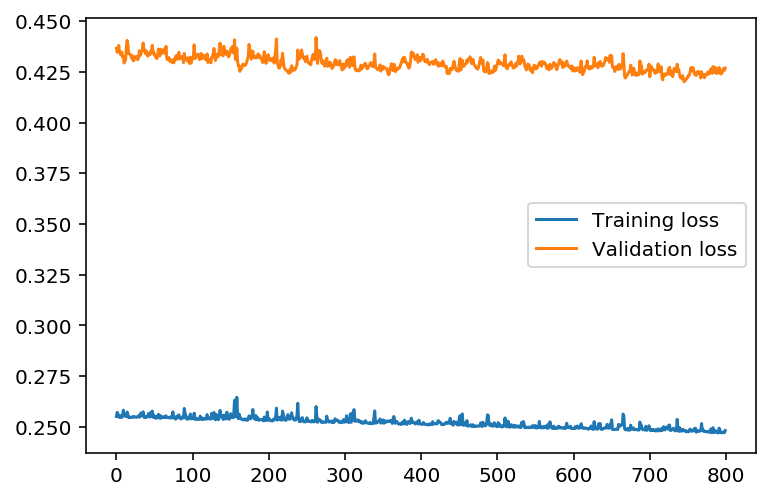

{'iterations': 5000, 'learning_rate': 0.1, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.248 validation loss: train loss :0.426


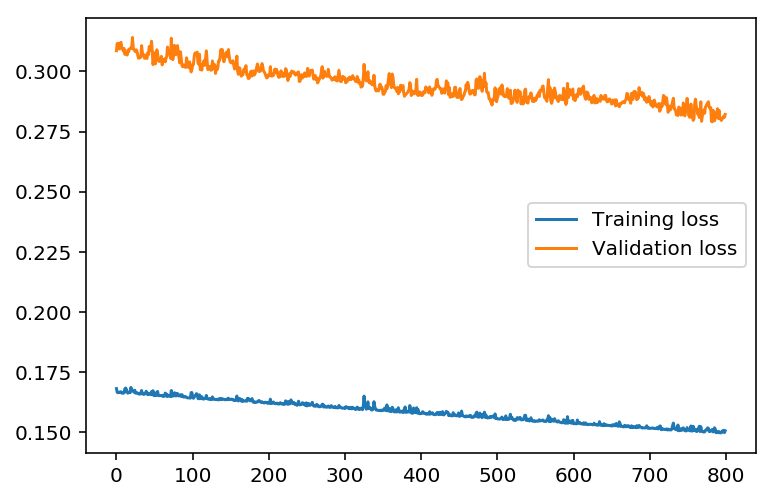

{'iterations': 8000, 'learning_rate': 0.1, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.150 validation loss: train loss :0.282


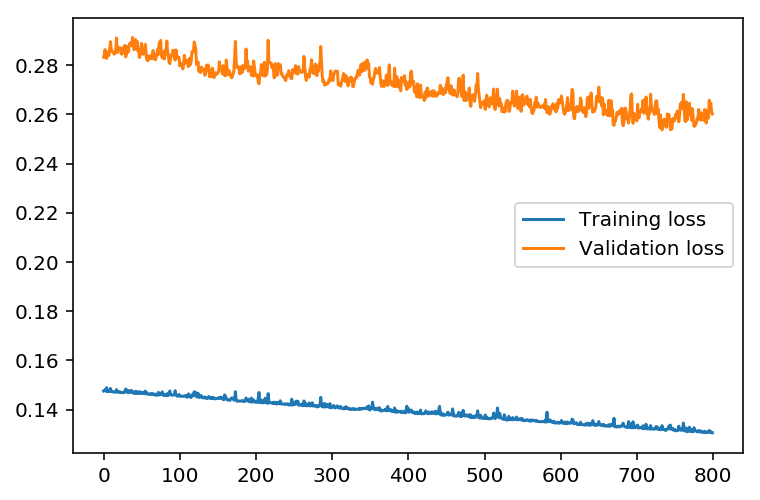

{'iterations': 10000, 'learning_rate': 0.1, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.130 validation loss: train loss :0.260


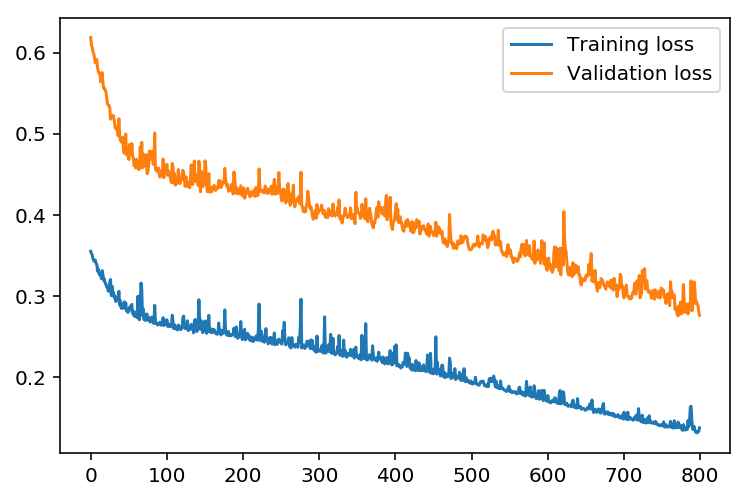

{'iterations': 1000, 'learning_rate': 0.9, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.137 validation loss: train loss :0.276


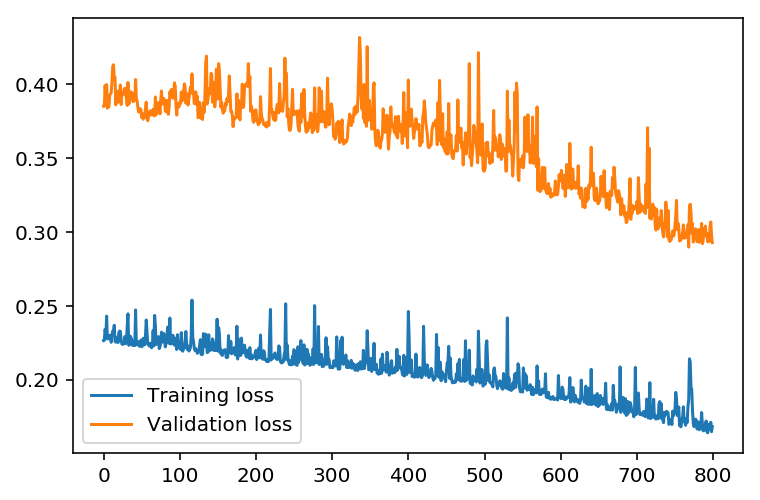

{'iterations': 1500, 'learning_rate': 0.9, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.168 validation loss: train loss :0.292


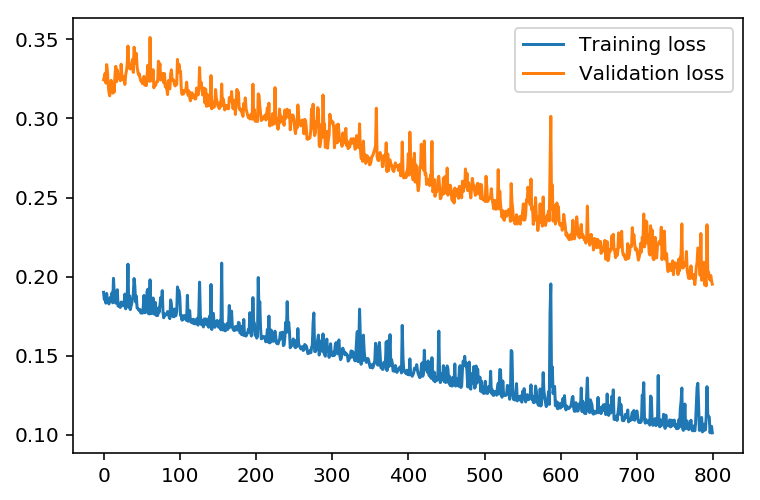

{'iterations': 2000, 'learning_rate': 0.9, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.101 validation loss: train loss :0.195


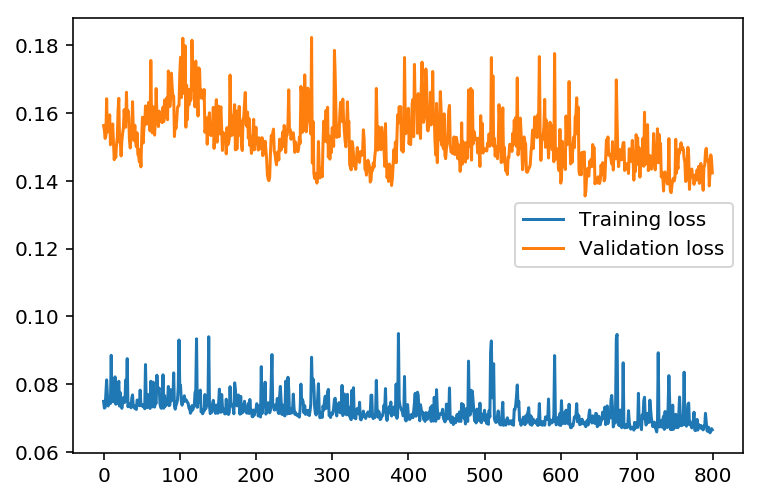

{'iterations': 3000, 'learning_rate': 0.9, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.066 validation loss: train loss :0.142


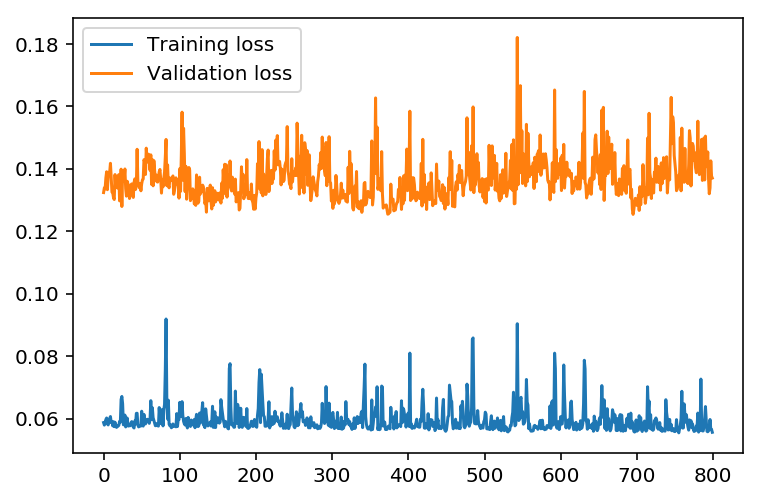

{'iterations': 5000, 'learning_rate': 0.9, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.055 validation loss: train loss :0.137


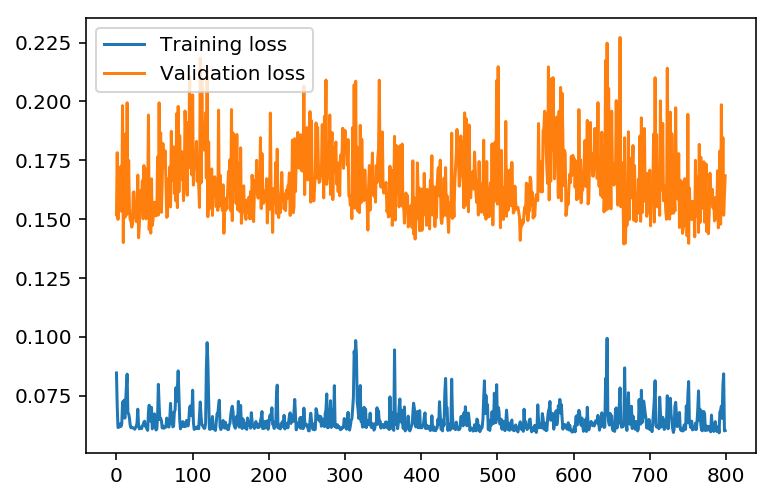

{'iterations': 8000, 'learning_rate': 0.9, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.060 validation loss: train loss :0.168


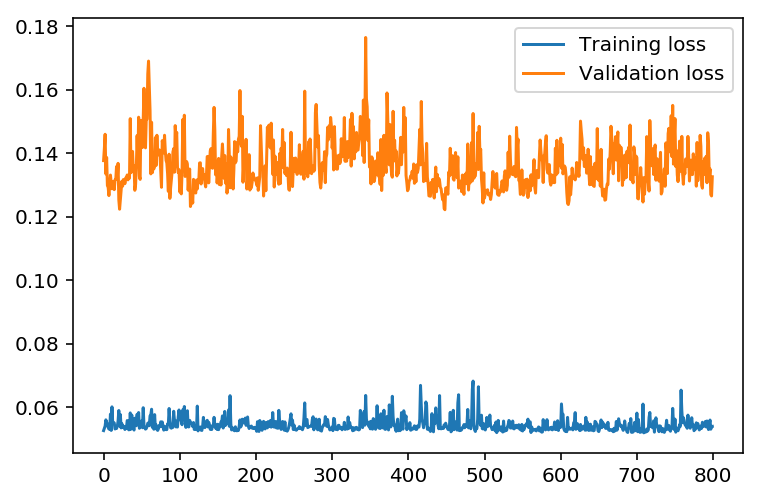

{'iterations': 10000, 'learning_rate': 0.9, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.053 validation loss: train loss :0.132


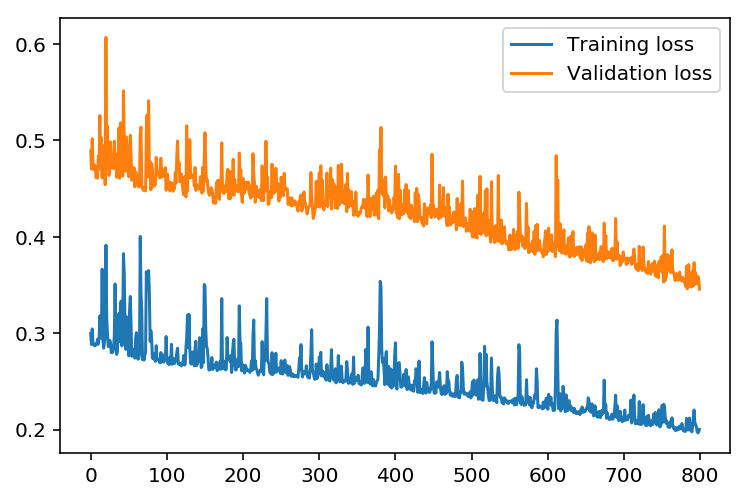

{'iterations': 1000, 'learning_rate': 0.7, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.200 validation loss: train loss :0.345


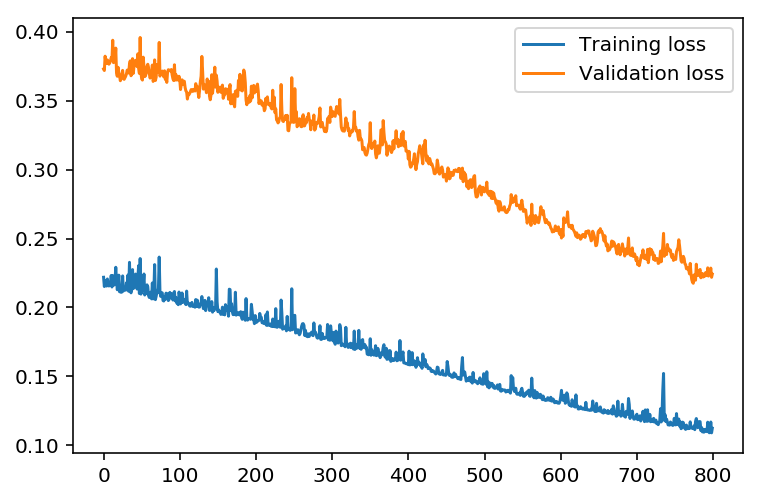

{'iterations': 1500, 'learning_rate': 0.7, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.112 validation loss: train loss :0.224


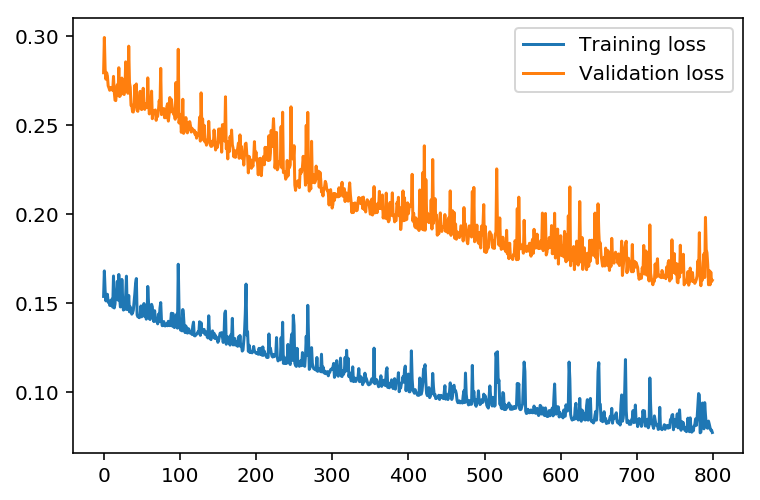

{'iterations': 2000, 'learning_rate': 0.7, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.077 validation loss: train loss :0.162


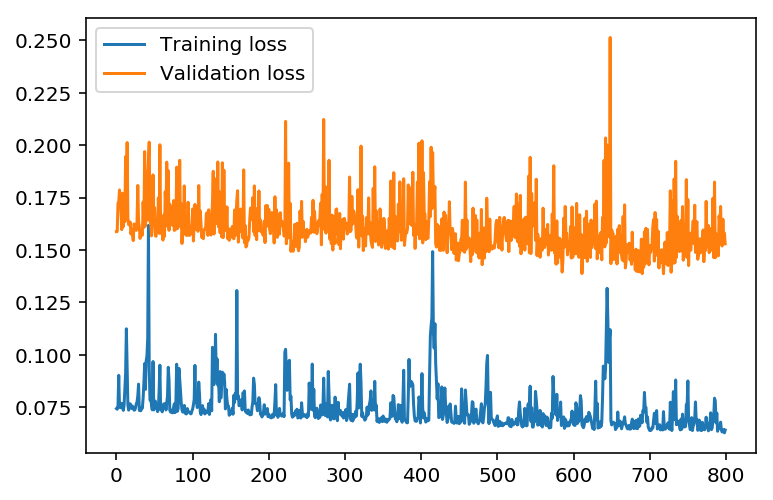

{'iterations': 3000, 'learning_rate': 0.7, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.064 validation loss: train loss :0.152


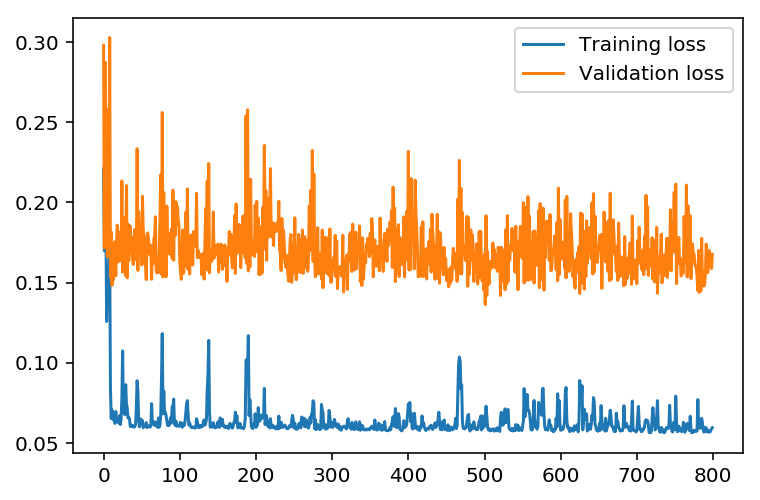

{'iterations': 5000, 'learning_rate': 0.7, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.059 validation loss: train loss :0.167


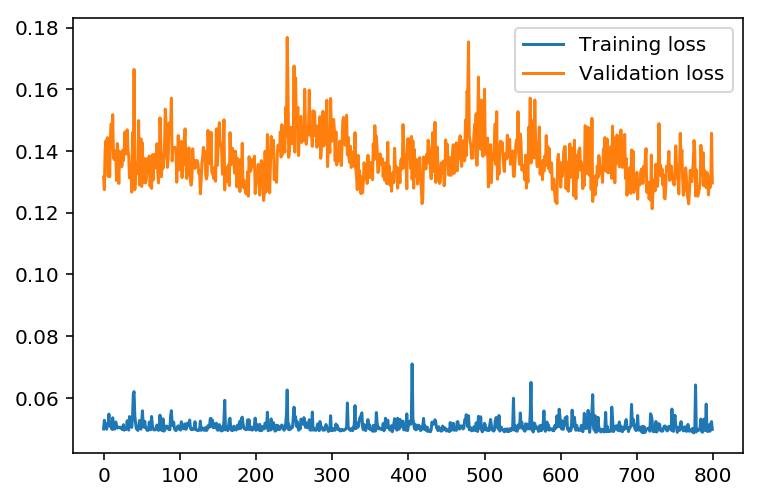

{'iterations': 8000, 'learning_rate': 0.7, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.049 validation loss: train loss :0.129


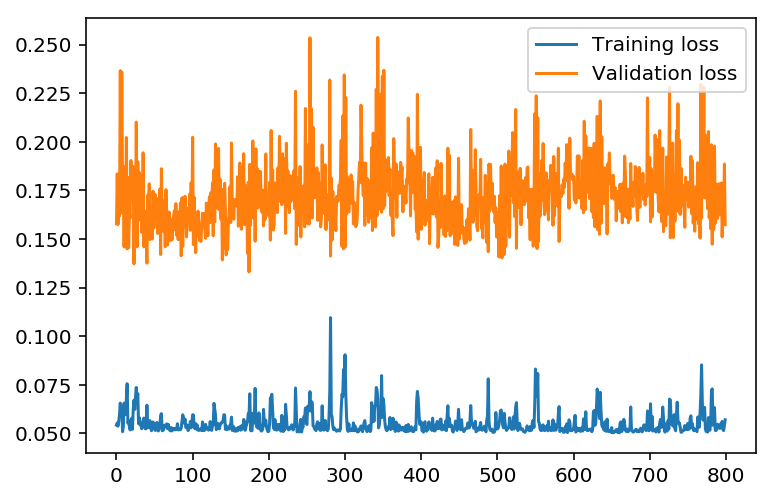

{'iterations': 10000, 'learning_rate': 0.7, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.057 validation loss: train loss :0.157


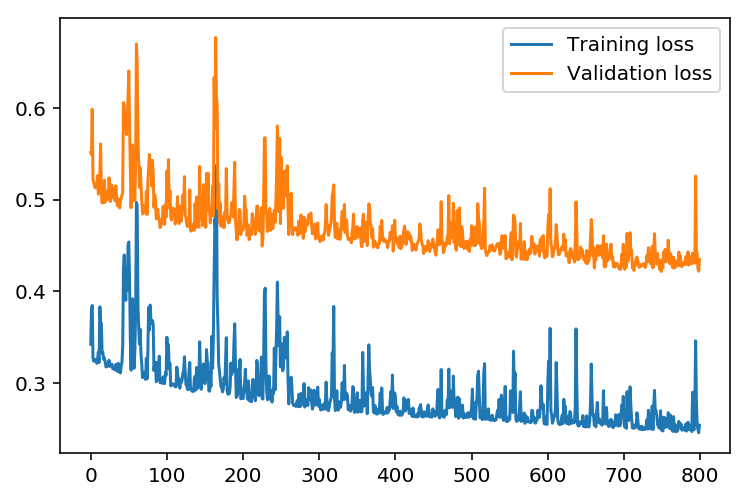

{'iterations': 1000, 'learning_rate': 0.5, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.253 validation loss: train loss :0.434


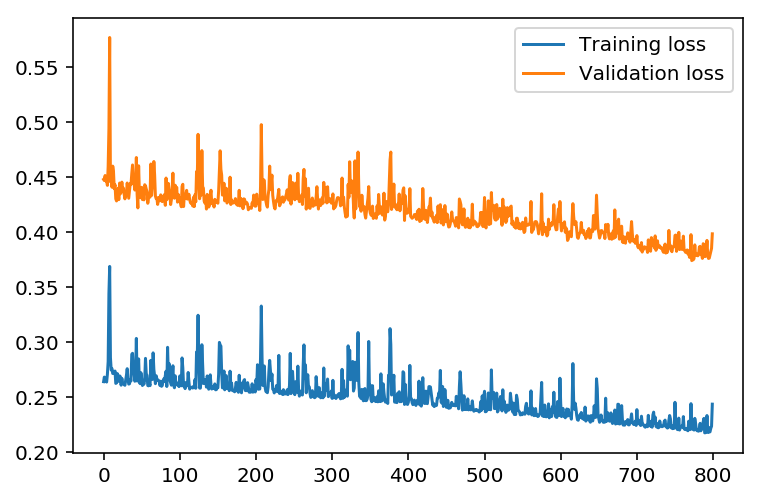

{'iterations': 1500, 'learning_rate': 0.5, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.243 validation loss: train loss :0.398


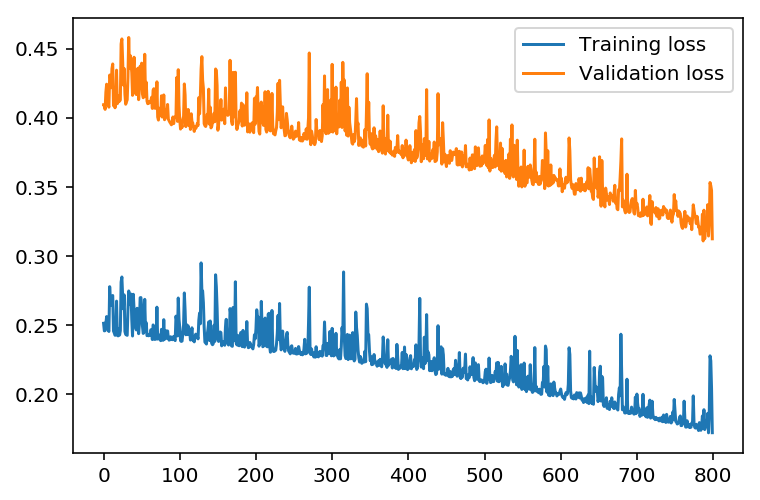

{'iterations': 2000, 'learning_rate': 0.5, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.172 validation loss: train loss :0.312


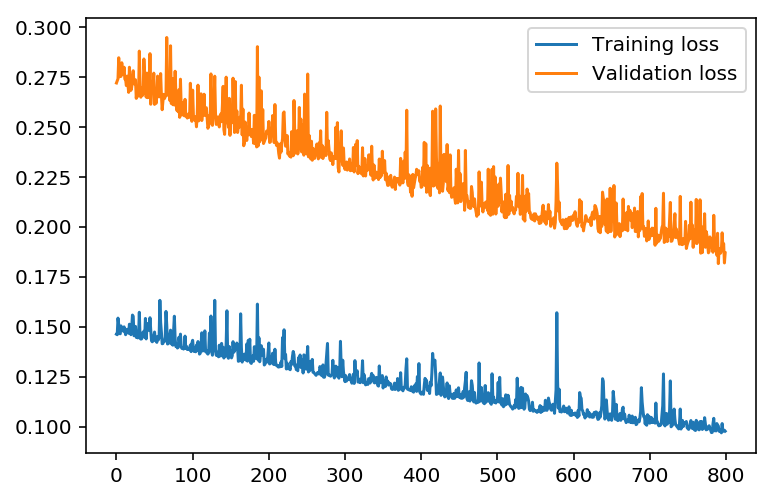

{'iterations': 3000, 'learning_rate': 0.5, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.097 validation loss: train loss :0.186


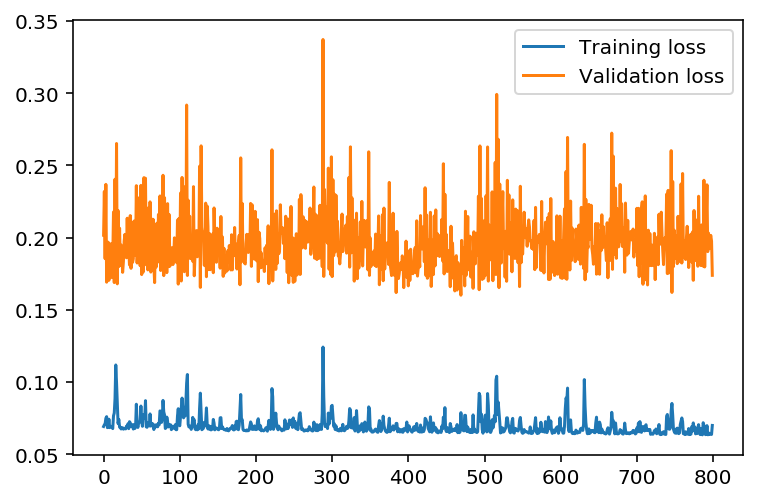

{'iterations': 5000, 'learning_rate': 0.5, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.069 validation loss: train loss :0.173


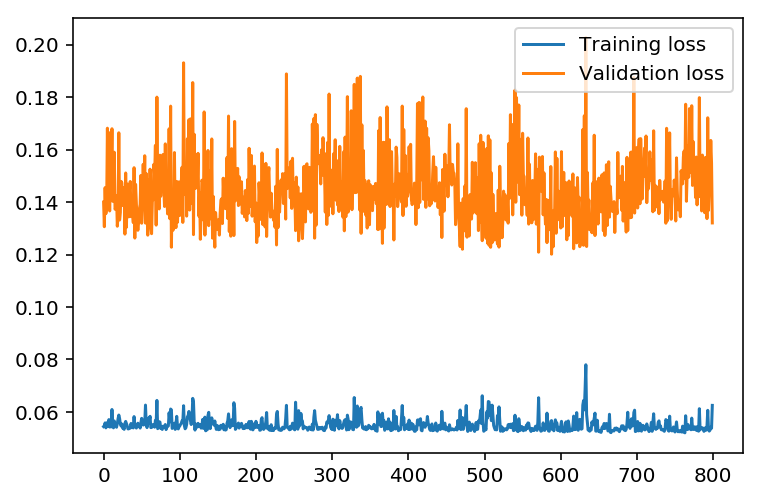

{'iterations': 8000, 'learning_rate': 0.5, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.062 validation loss: train loss :0.132


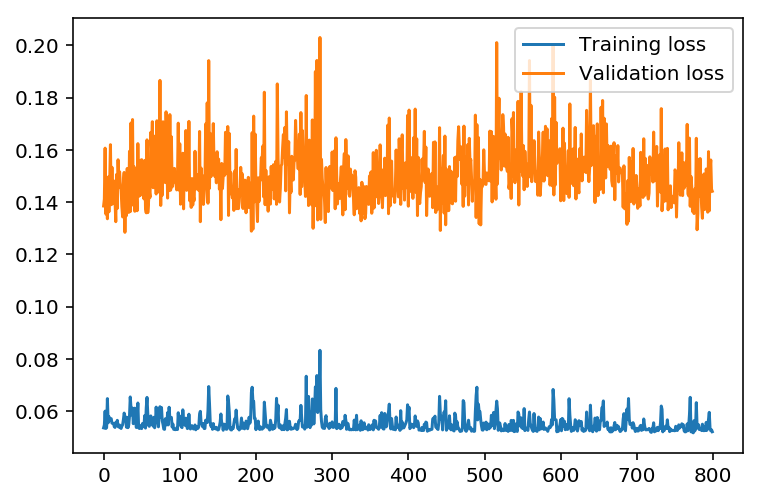

{'iterations': 10000, 'learning_rate': 0.5, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.052 validation loss: train loss :0.144


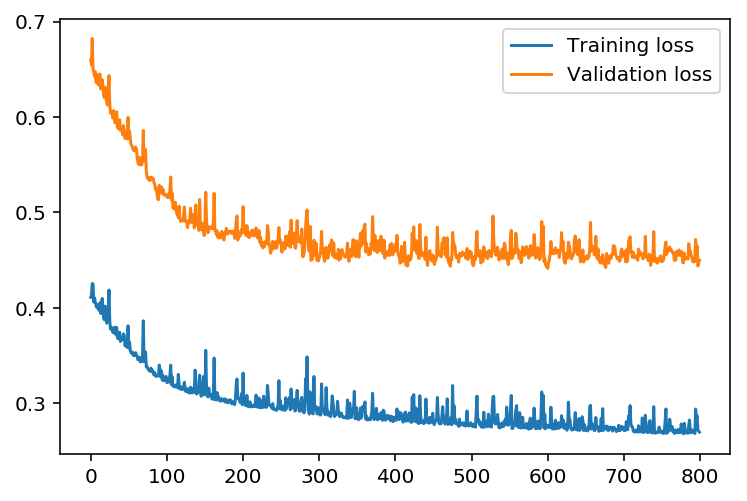

{'iterations': 1000, 'learning_rate': 0.3, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.269 validation loss: train loss :0.449


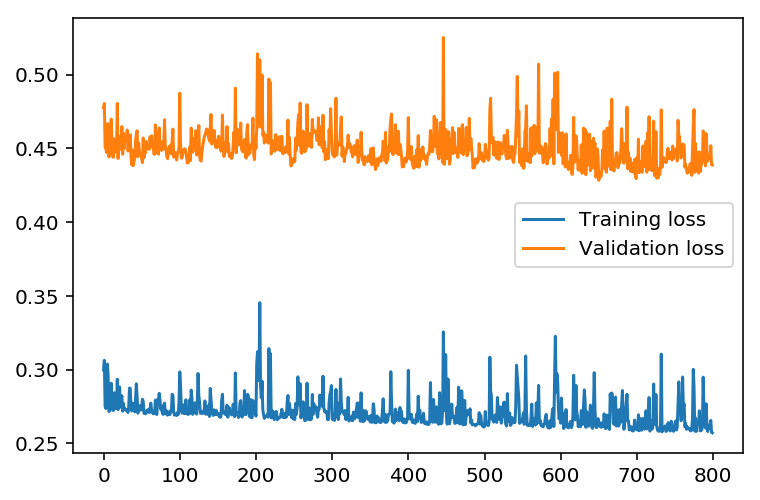

{'iterations': 1500, 'learning_rate': 0.3, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.257 validation loss: train loss :0.438


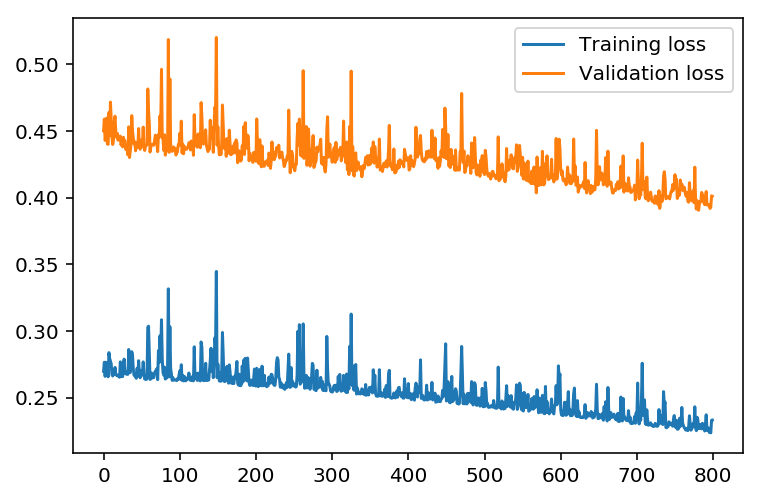

{'iterations': 2000, 'learning_rate': 0.3, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.233 validation loss: train loss :0.400


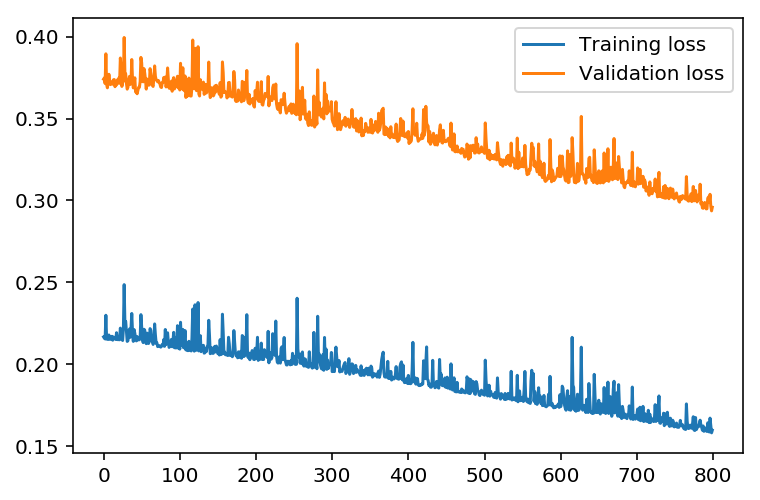

{'iterations': 3000, 'learning_rate': 0.3, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.159 validation loss: train loss :0.295


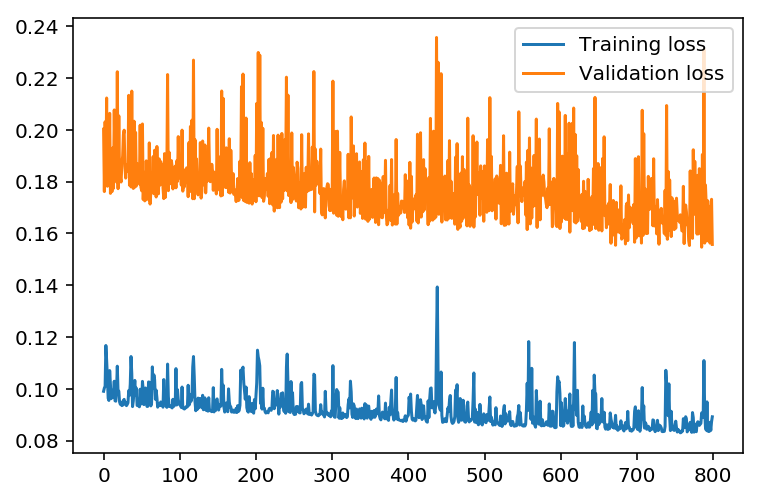

{'iterations': 5000, 'learning_rate': 0.3, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.089 validation loss: train loss :0.155


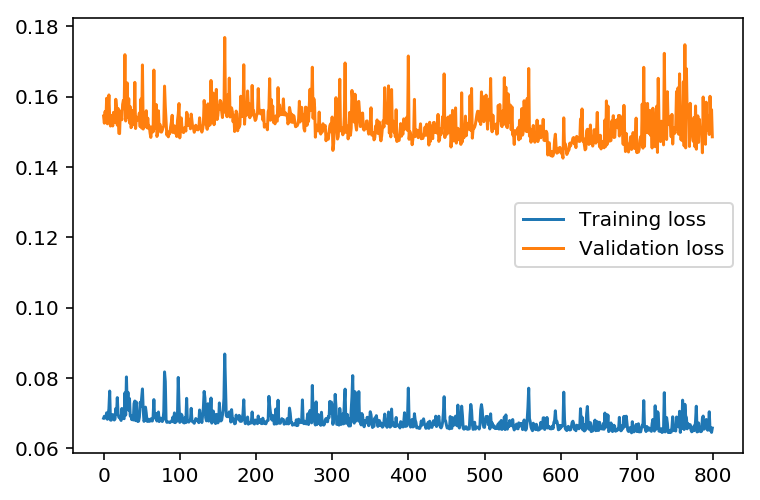

{'iterations': 8000, 'learning_rate': 0.3, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.065 validation loss: train loss :0.148


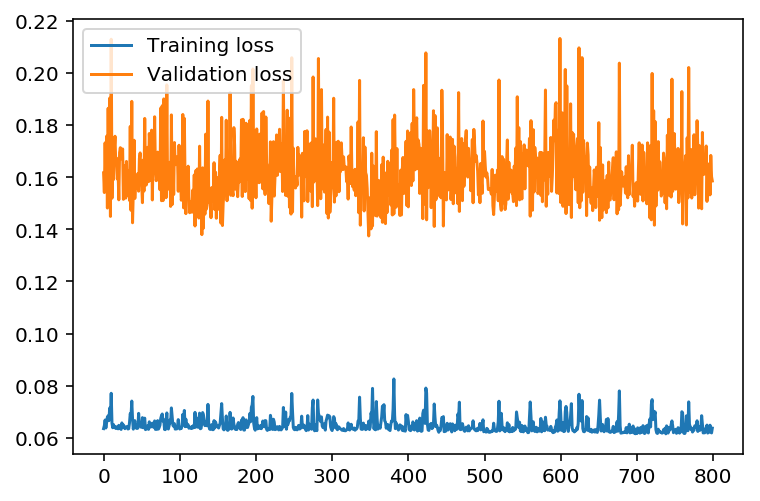

{'iterations': 10000, 'learning_rate': 0.3, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.063 validation loss: train loss :0.158


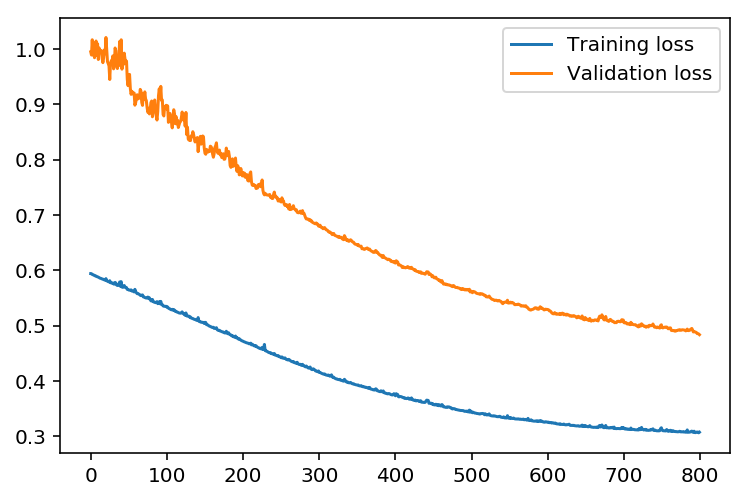

{'iterations': 1000, 'learning_rate': 0.1, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.307 validation loss: train loss :0.483


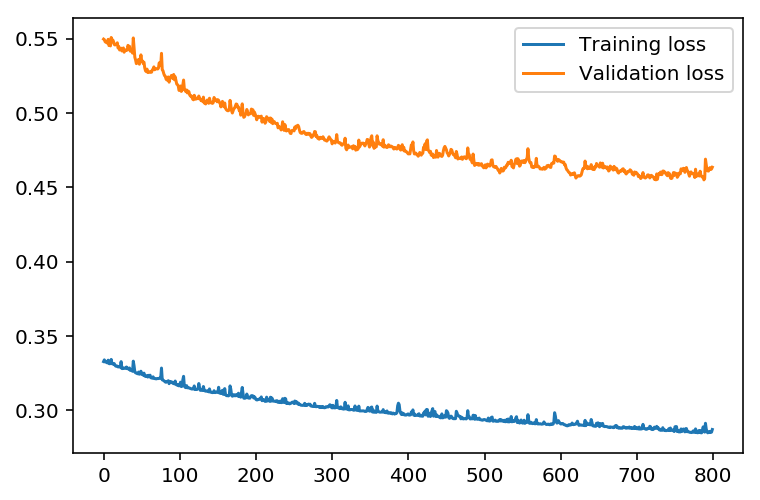

{'iterations': 1500, 'learning_rate': 0.1, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.287 validation loss: train loss :0.463


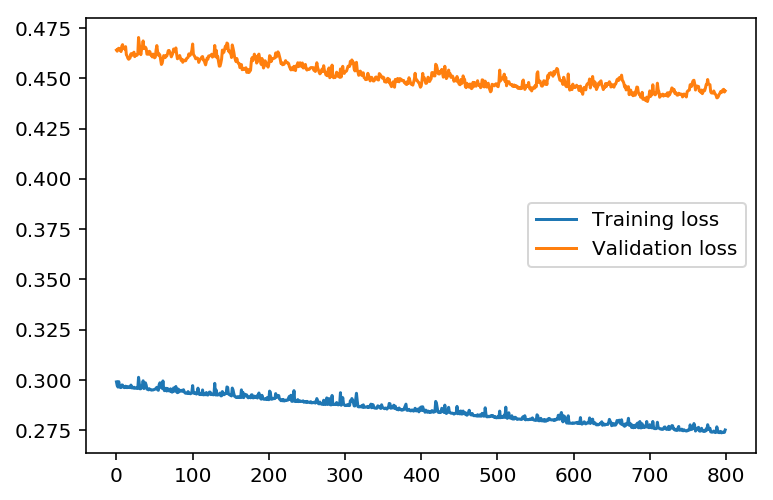

{'iterations': 2000, 'learning_rate': 0.1, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.275 validation loss: train loss :0.443


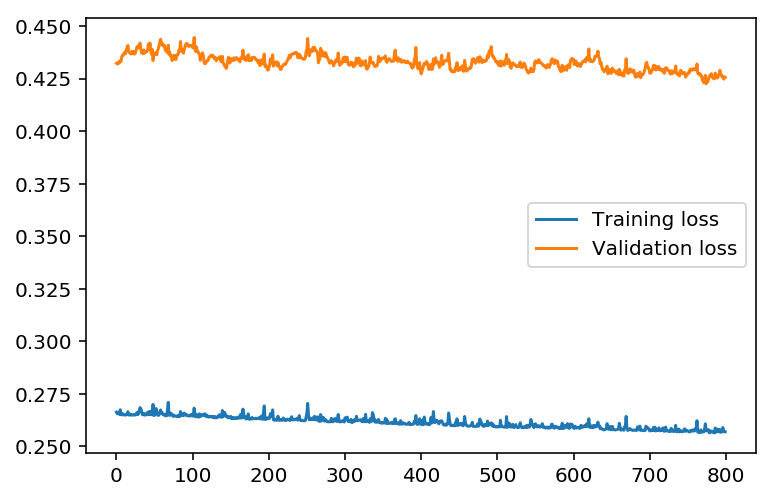

{'iterations': 3000, 'learning_rate': 0.1, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.257 validation loss: train loss :0.425


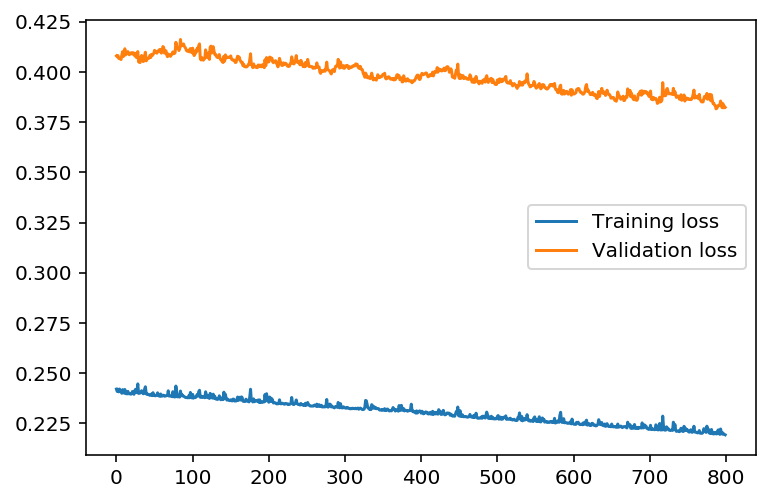

{'iterations': 5000, 'learning_rate': 0.1, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.219 validation loss: train loss :0.382


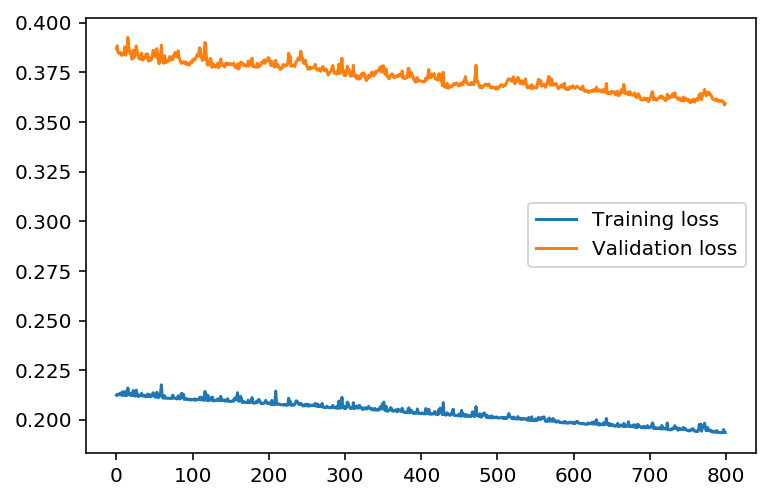

{'iterations': 8000, 'learning_rate': 0.1, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.193 validation loss: train loss :0.359


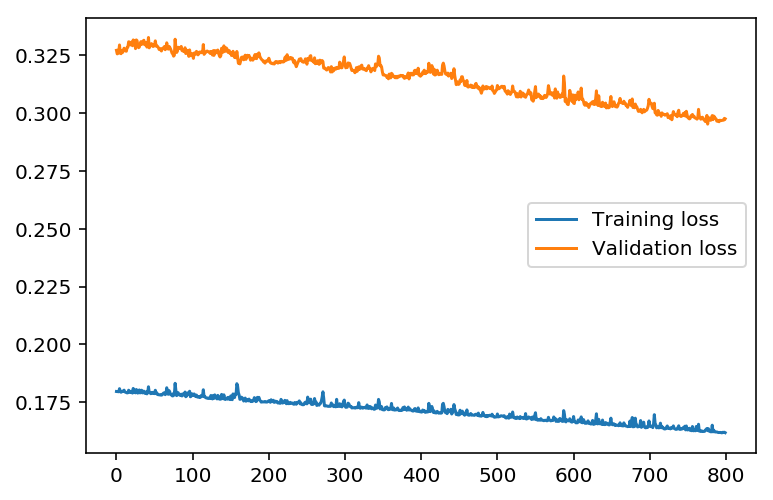

{'iterations': 10000, 'learning_rate': 0.1, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.161 validation loss: train loss :0.297


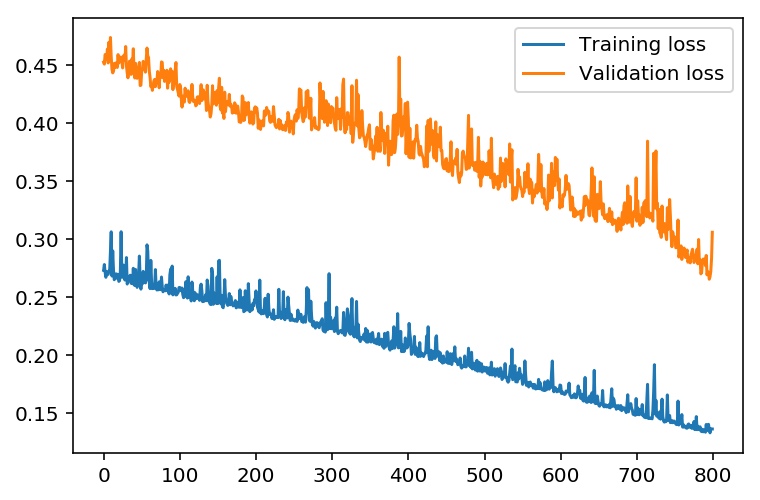

{'iterations': 1000, 'learning_rate': 0.9, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.136 validation loss: train loss :0.305


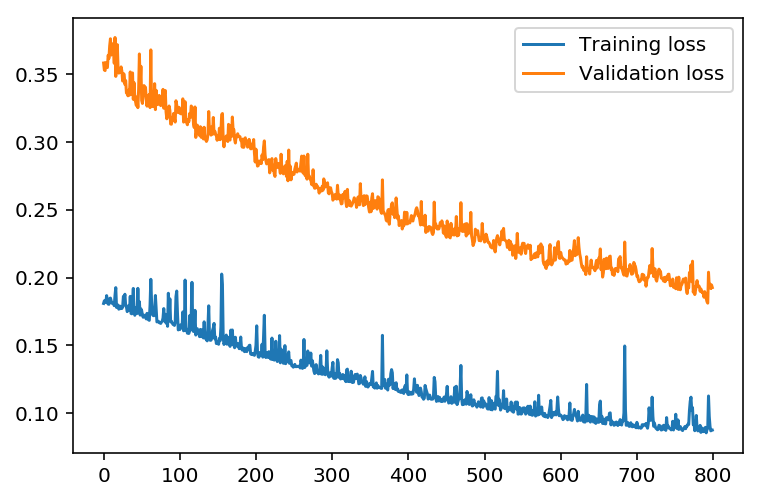

{'iterations': 1500, 'learning_rate': 0.9, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.087 validation loss: train loss :0.192


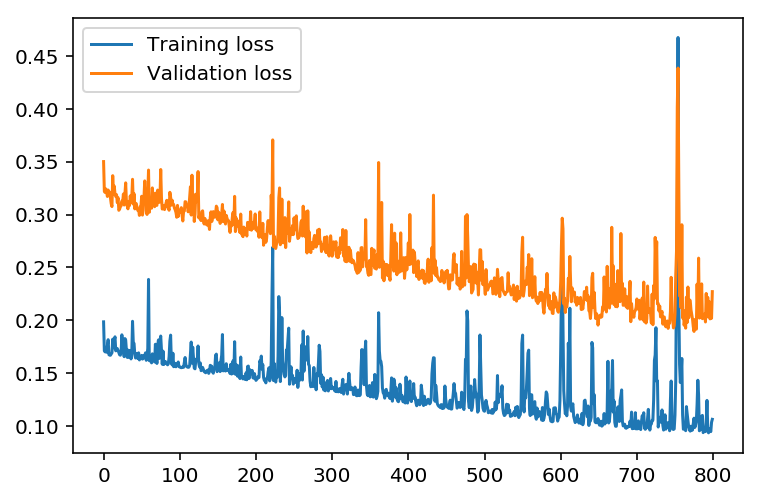

{'iterations': 2000, 'learning_rate': 0.9, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.106 validation loss: train loss :0.227


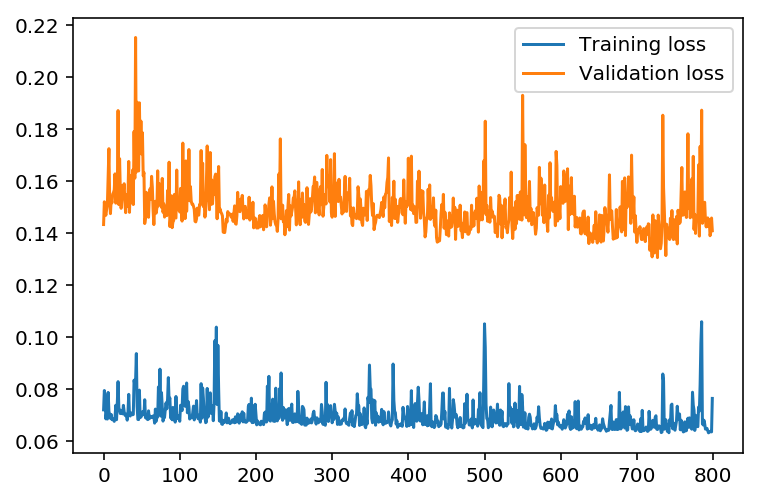

{'iterations': 3000, 'learning_rate': 0.9, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.076 validation loss: train loss :0.140


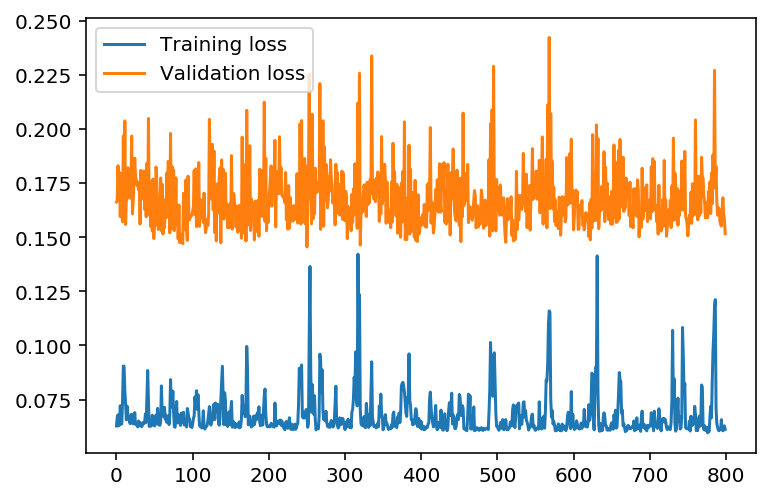

{'iterations': 5000, 'learning_rate': 0.9, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.061 validation loss: train loss :0.151


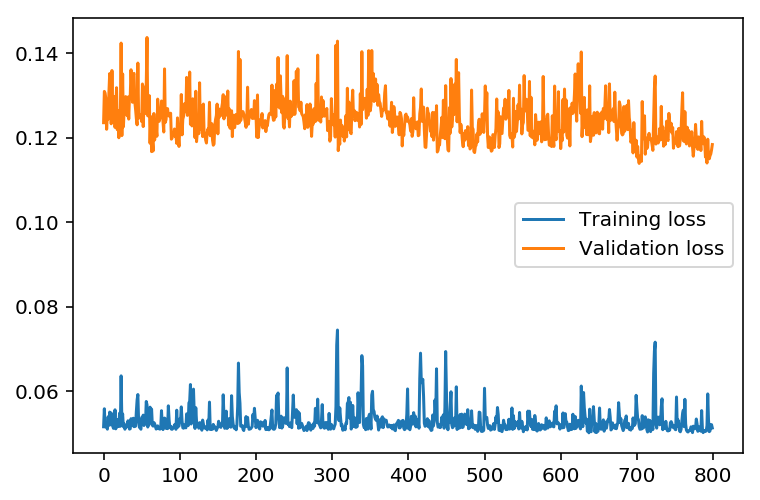

{'iterations': 8000, 'learning_rate': 0.9, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.051 validation loss: train loss :0.118


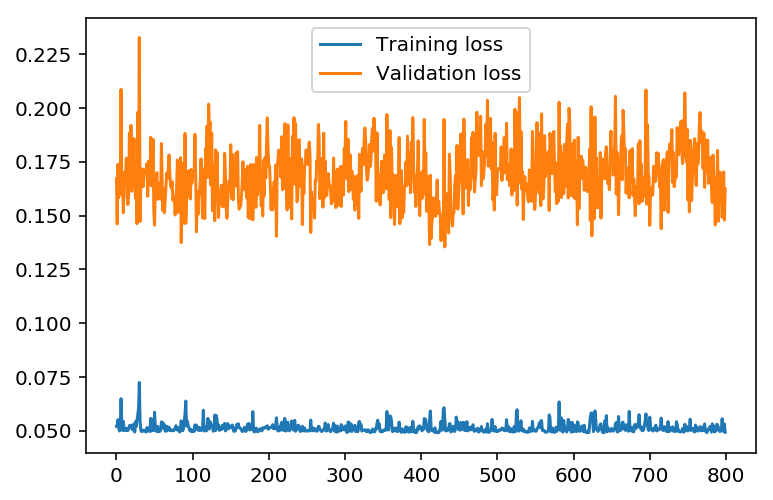

{'iterations': 10000, 'learning_rate': 0.9, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.049 validation loss: train loss :0.162


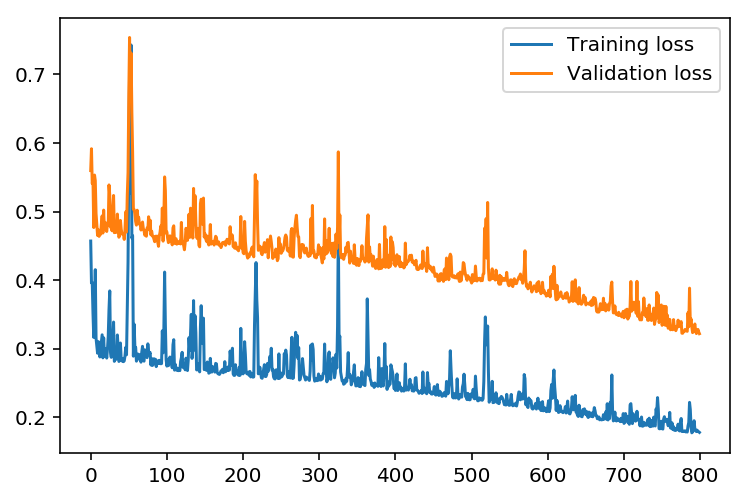

{'iterations': 1000, 'learning_rate': 0.7, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.178 validation loss: train loss :0.321


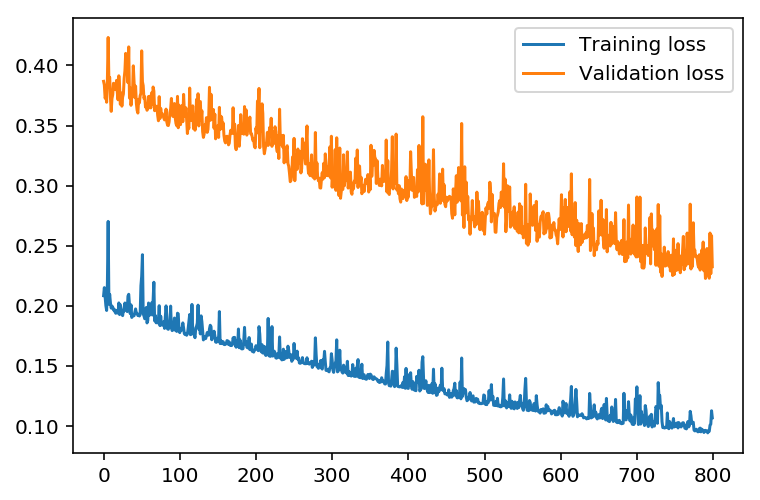

{'iterations': 1500, 'learning_rate': 0.7, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.106 validation loss: train loss :0.232


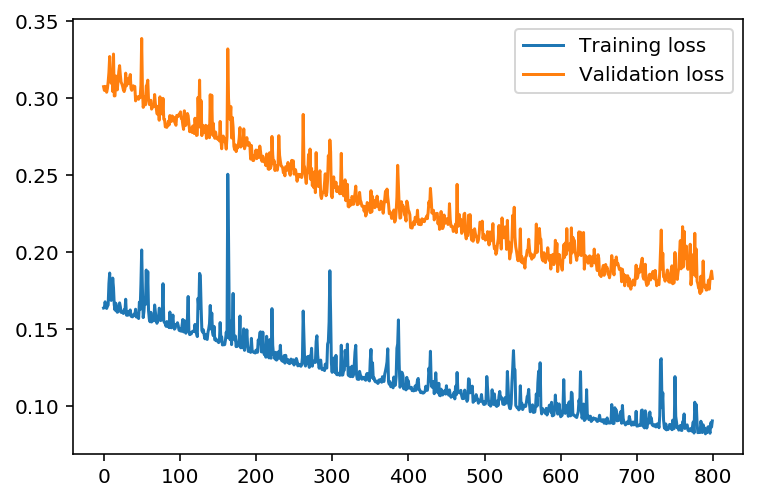

{'iterations': 2000, 'learning_rate': 0.7, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.090 validation loss: train loss :0.182


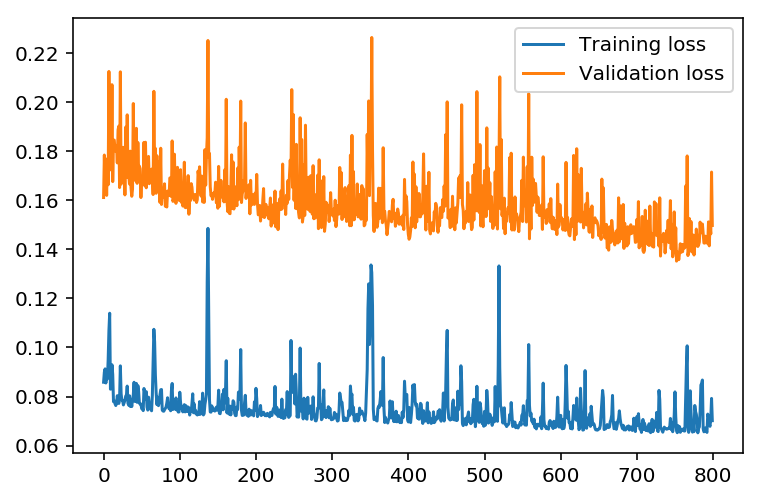

{'iterations': 3000, 'learning_rate': 0.7, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.070 validation loss: train loss :0.149


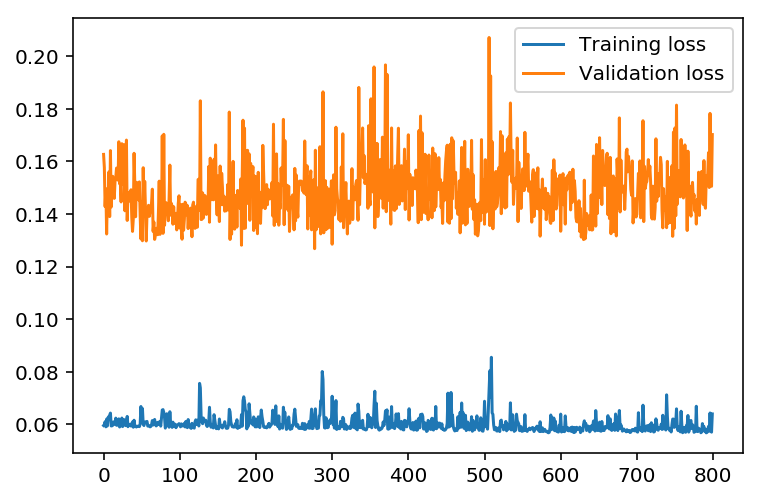

{'iterations': 5000, 'learning_rate': 0.7, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.063 validation loss: train loss :0.170


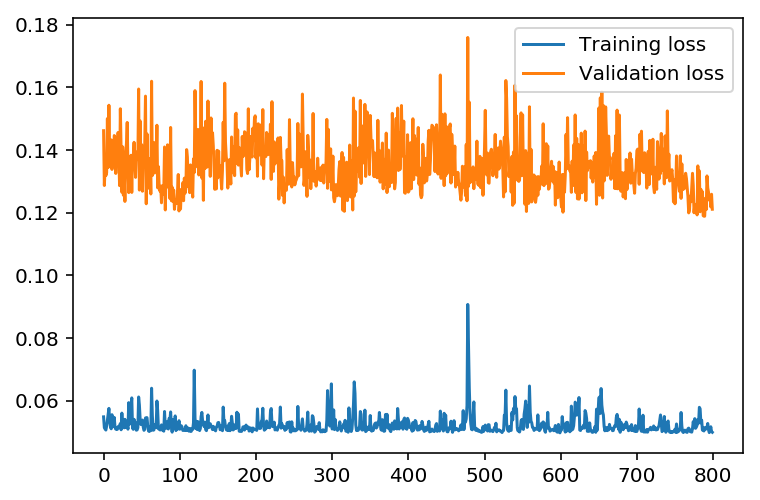

{'iterations': 8000, 'learning_rate': 0.7, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.049 validation loss: train loss :0.121


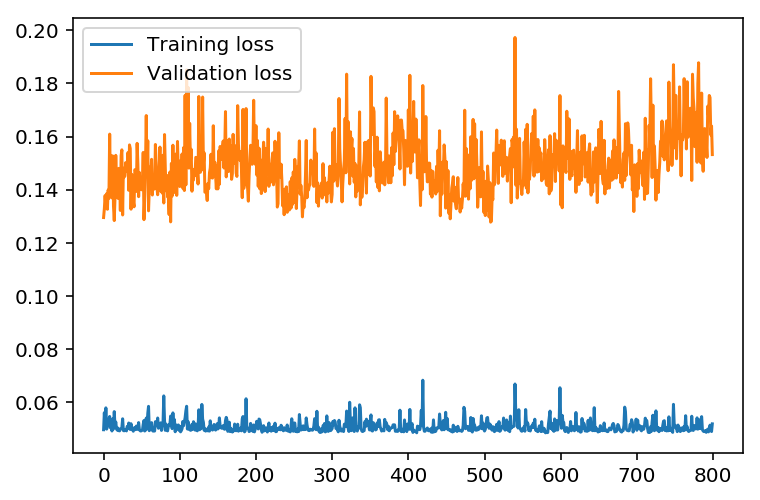

{'iterations': 10000, 'learning_rate': 0.7, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.051 validation loss: train loss :0.153


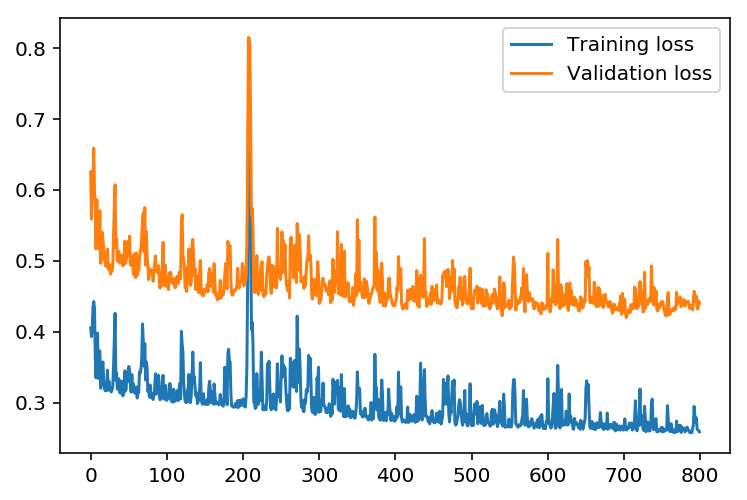

{'iterations': 1000, 'learning_rate': 0.5, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.258 validation loss: train loss :0.439


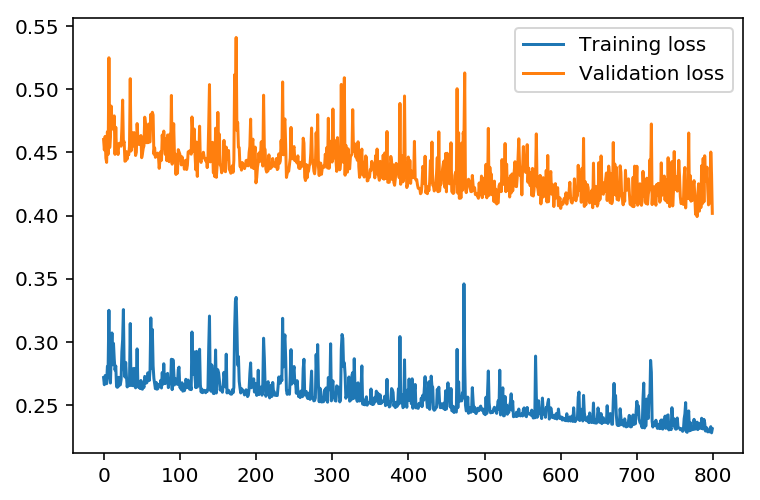

{'iterations': 1500, 'learning_rate': 0.5, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.231 validation loss: train loss :0.401


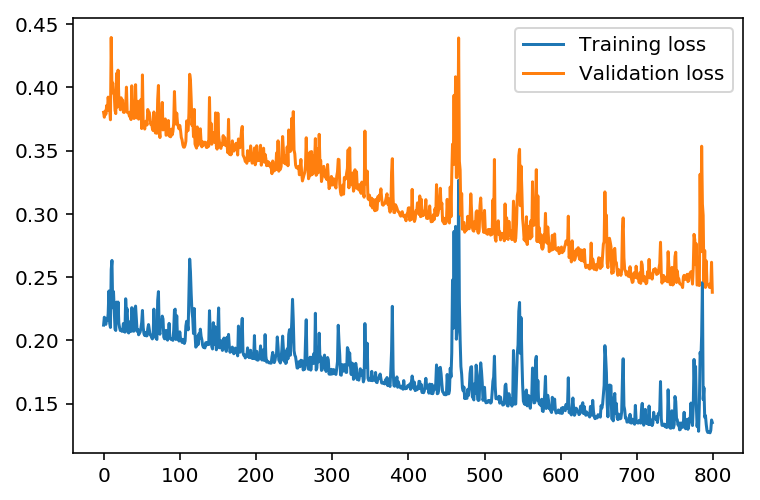

{'iterations': 2000, 'learning_rate': 0.5, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.135 validation loss: train loss :0.238


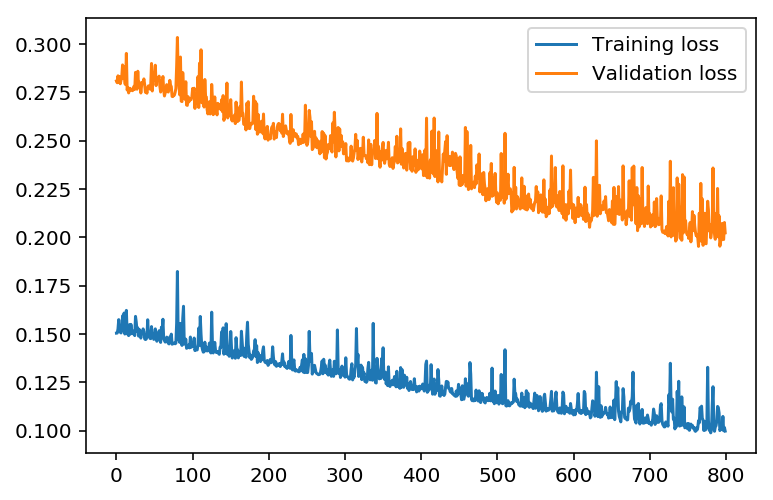

{'iterations': 3000, 'learning_rate': 0.5, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.099 validation loss: train loss :0.202


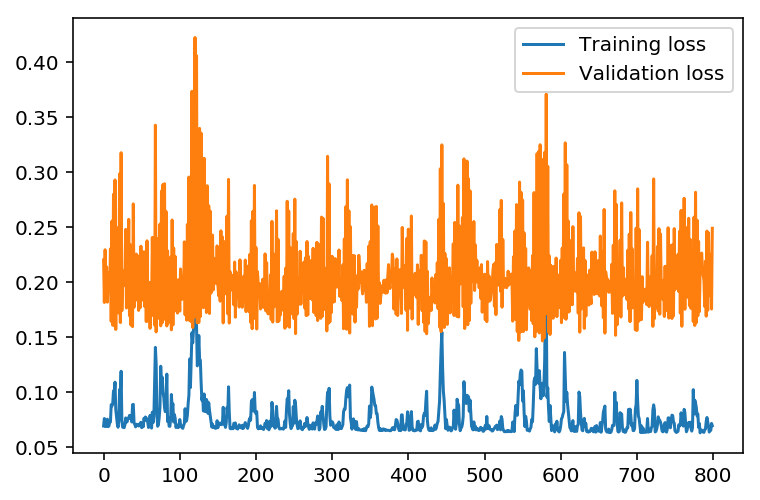

{'iterations': 5000, 'learning_rate': 0.5, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.069 validation loss: train loss :0.248


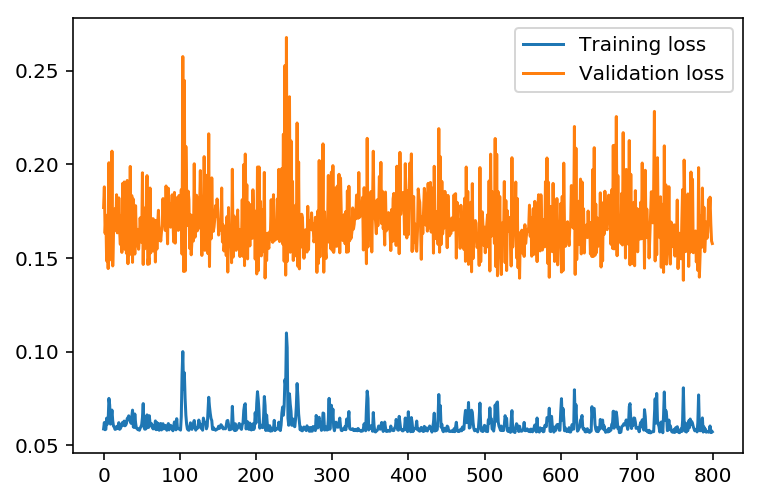

{'iterations': 8000, 'learning_rate': 0.5, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.057 validation loss: train loss :0.157


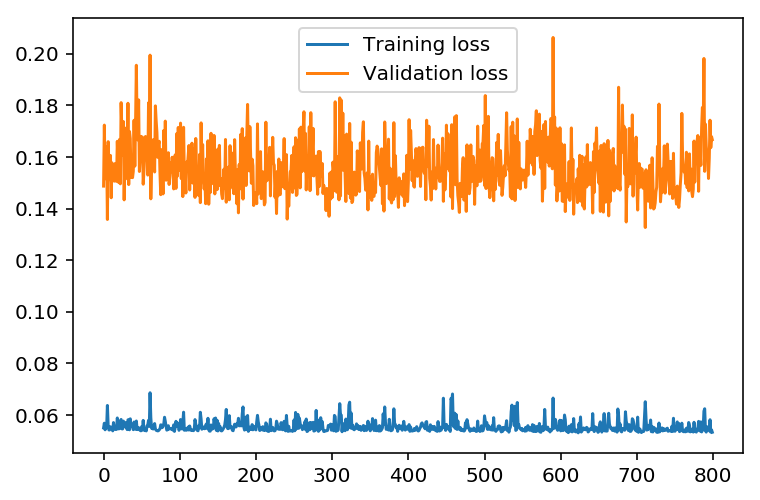

{'iterations': 10000, 'learning_rate': 0.5, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.053 validation loss: train loss :0.166


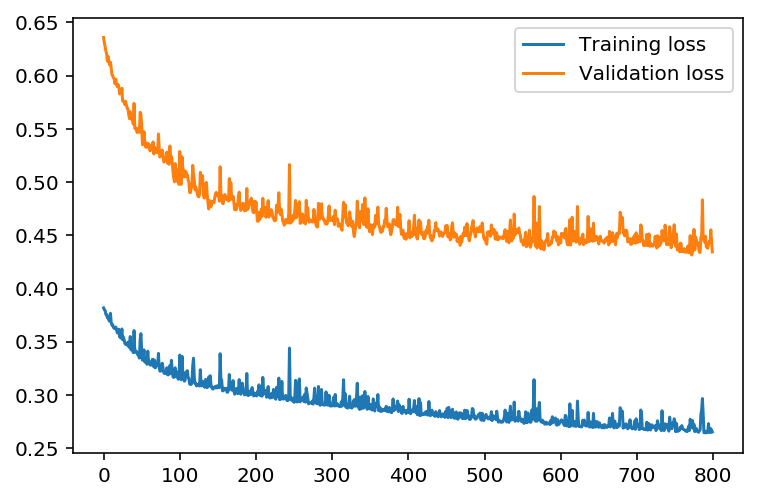

{'iterations': 1000, 'learning_rate': 0.3, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.265 validation loss: train loss :0.434


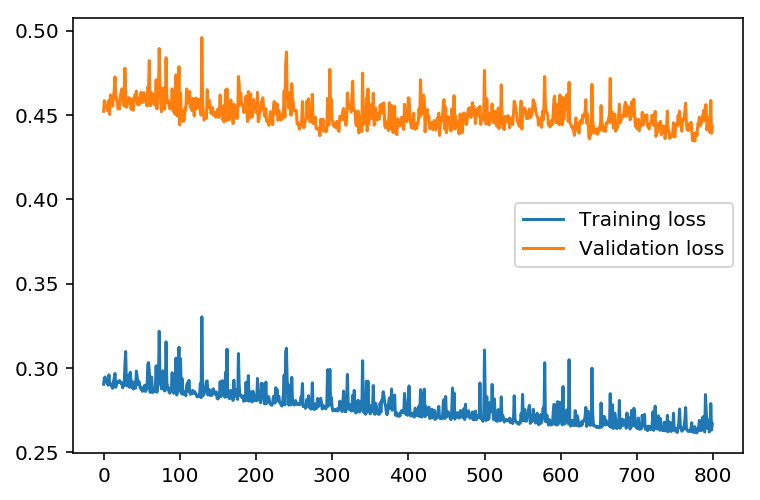

{'iterations': 1500, 'learning_rate': 0.3, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.266 validation loss: train loss :0.442


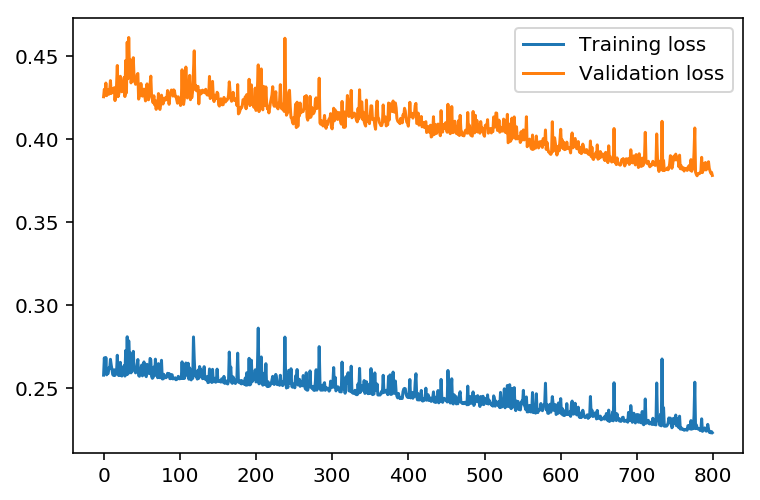

{'iterations': 2000, 'learning_rate': 0.3, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.223 validation loss: train loss :0.378


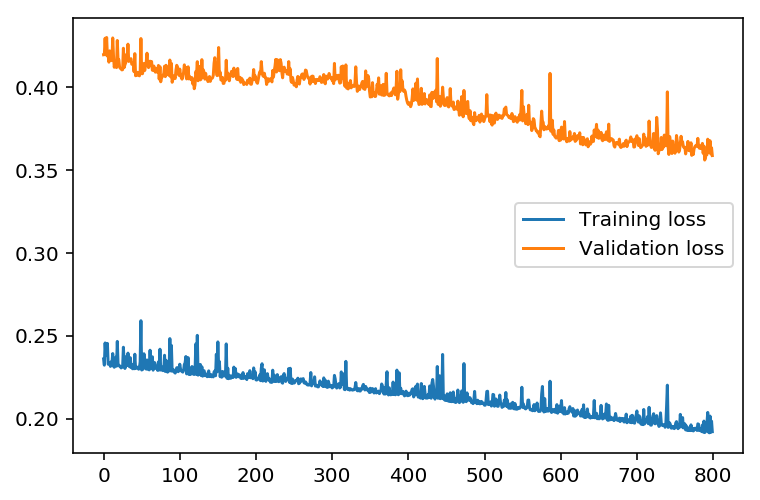

{'iterations': 3000, 'learning_rate': 0.3, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.192 validation loss: train loss :0.358


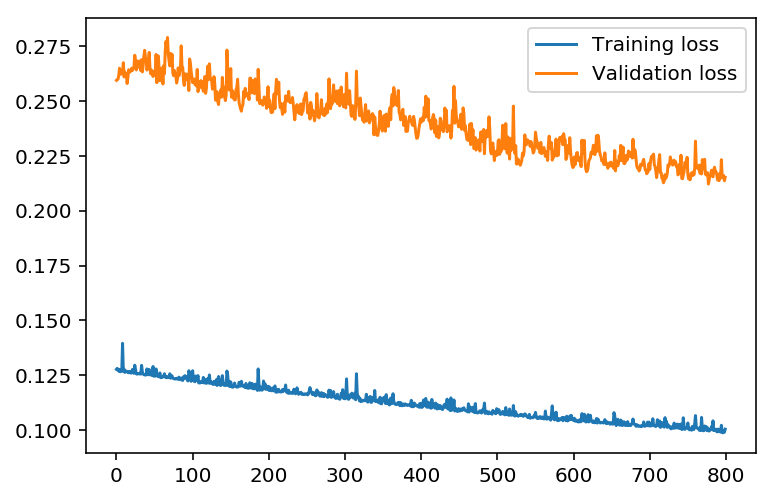

{'iterations': 5000, 'learning_rate': 0.3, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.100 validation loss: train loss :0.215


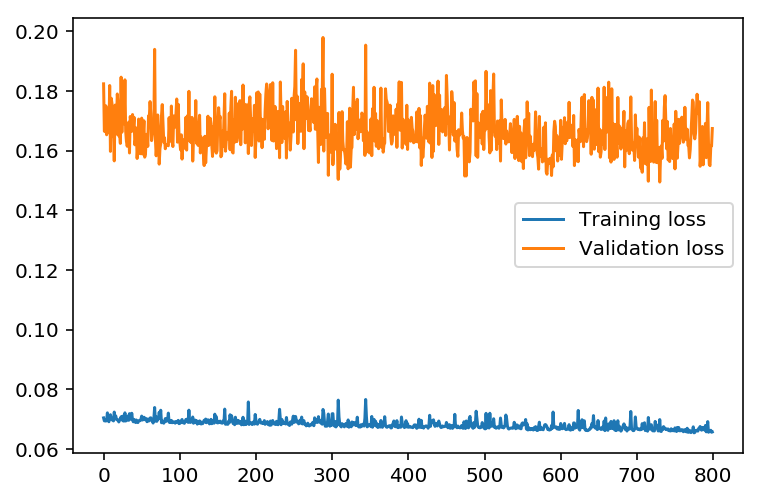

{'iterations': 8000, 'learning_rate': 0.3, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.065 validation loss: train loss :0.167


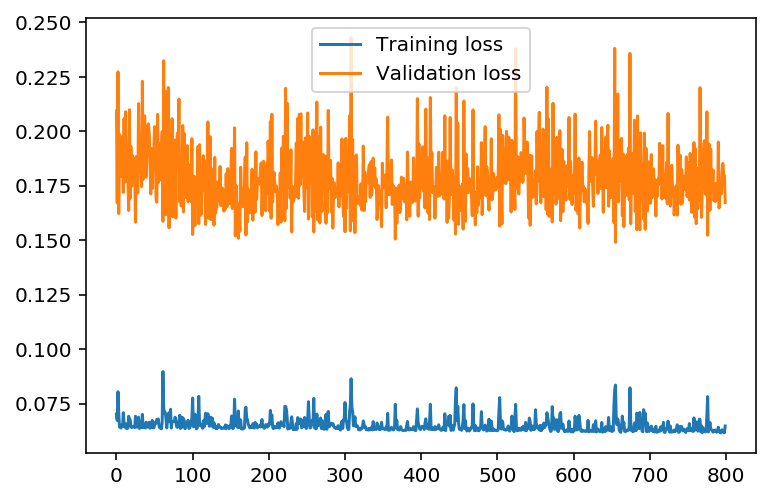

{'iterations': 10000, 'learning_rate': 0.3, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.064 validation loss: train loss :0.167


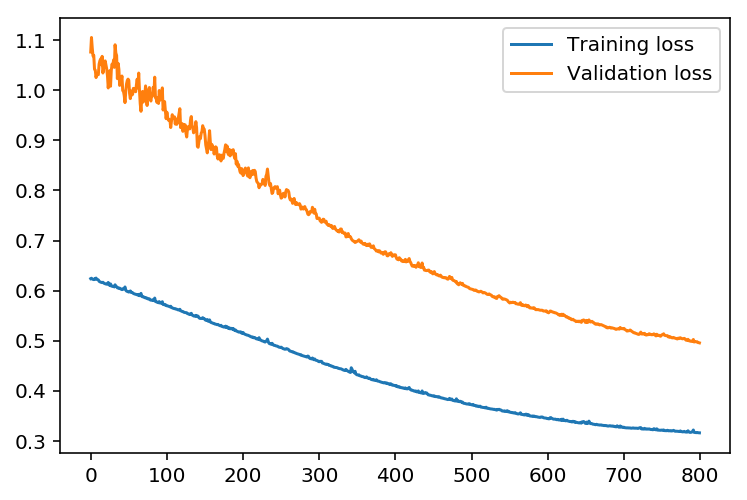

{'iterations': 1000, 'learning_rate': 0.1, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.315 validation loss: train loss :0.495


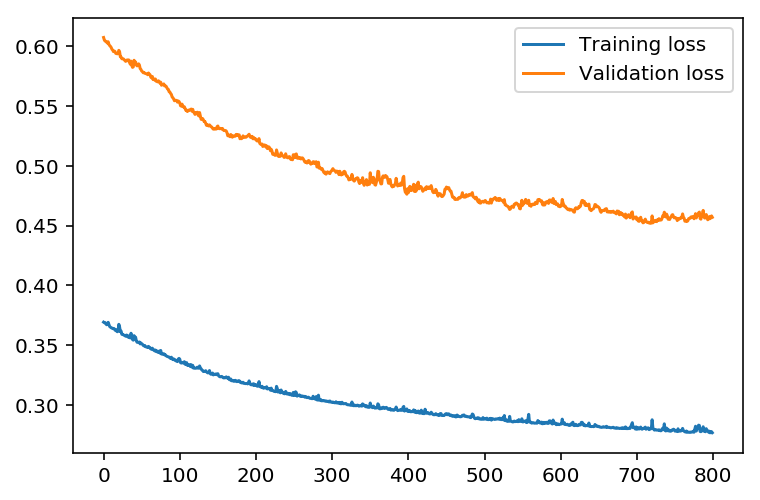

{'iterations': 1500, 'learning_rate': 0.1, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.276 validation loss: train loss :0.456


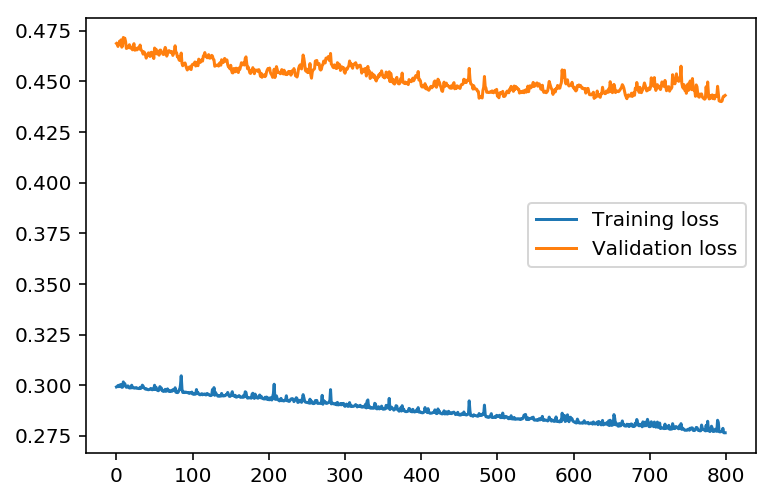

{'iterations': 2000, 'learning_rate': 0.1, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.276 validation loss: train loss :0.443


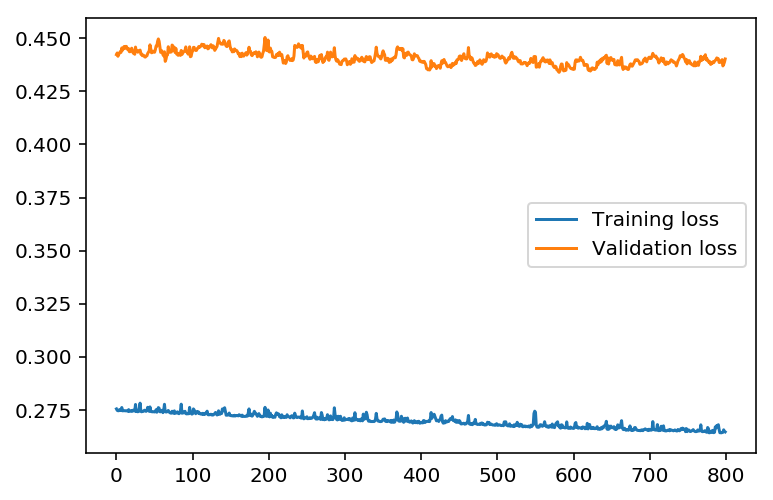

{'iterations': 3000, 'learning_rate': 0.1, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.264 validation loss: train loss :0.440


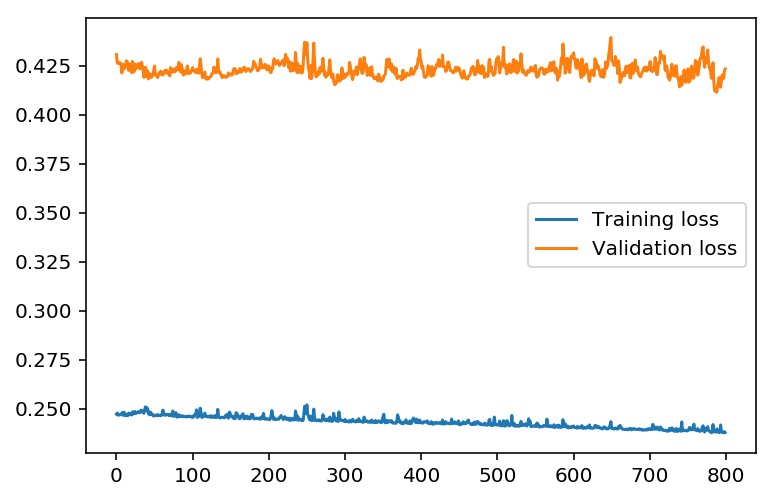

{'iterations': 5000, 'learning_rate': 0.1, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.237 validation loss: train loss :0.423


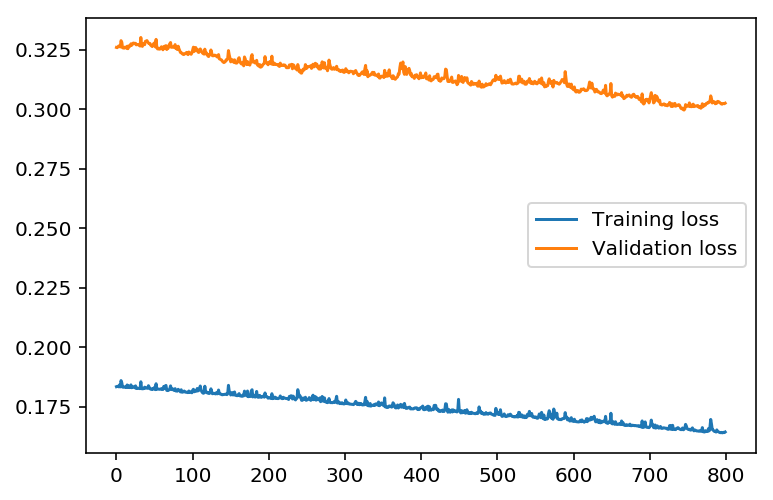

{'iterations': 8000, 'learning_rate': 0.1, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.164 validation loss: train loss :0.302


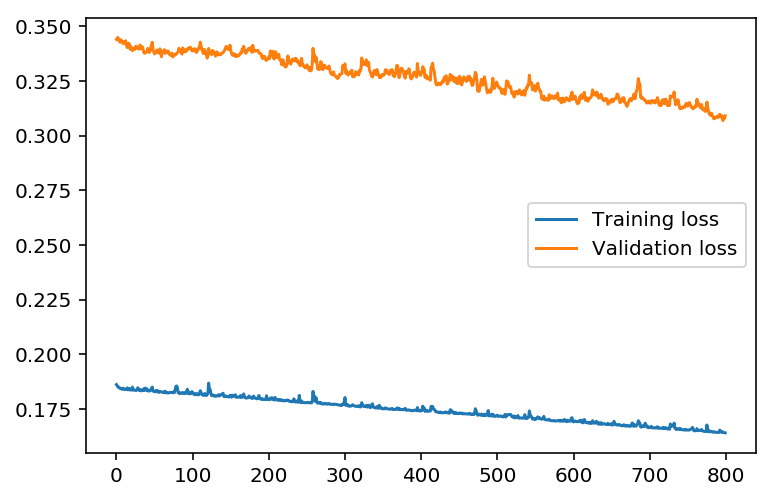

{'iterations': 10000, 'learning_rate': 0.1, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.164 validation loss: train loss :0.309


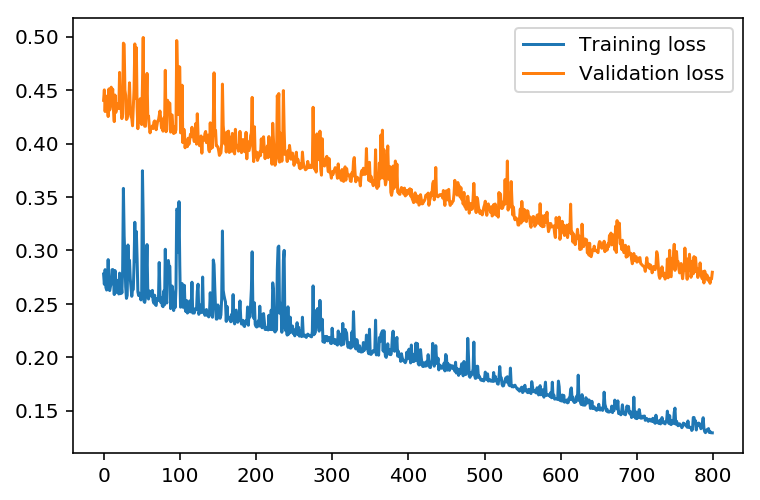

{'iterations': 1000, 'learning_rate': 0.9, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.129 validation loss: train loss :0.279


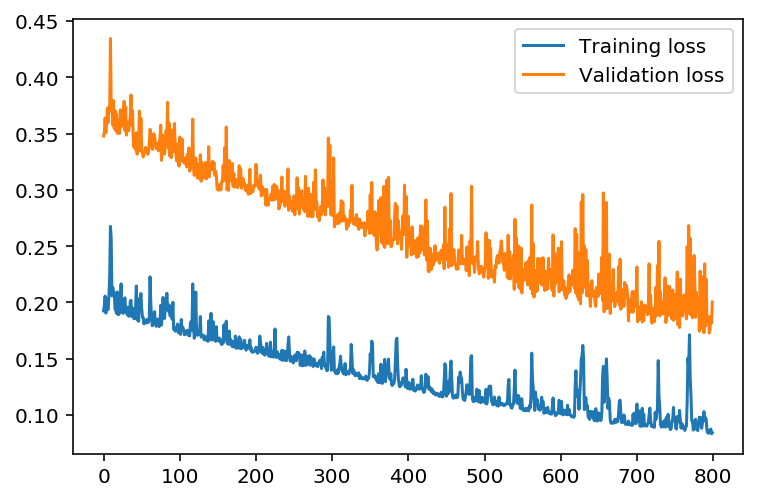

{'iterations': 1500, 'learning_rate': 0.9, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.084 validation loss: train loss :0.200


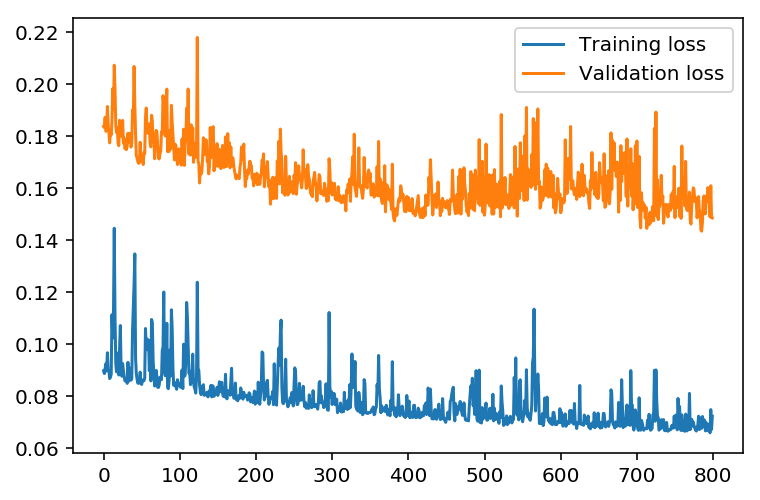

{'iterations': 2000, 'learning_rate': 0.9, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.072 validation loss: train loss :0.148


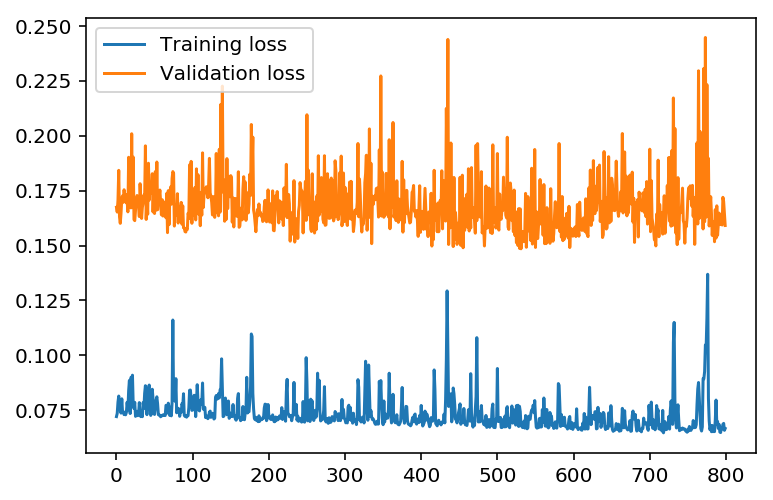

{'iterations': 3000, 'learning_rate': 0.9, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.066 validation loss: train loss :0.159


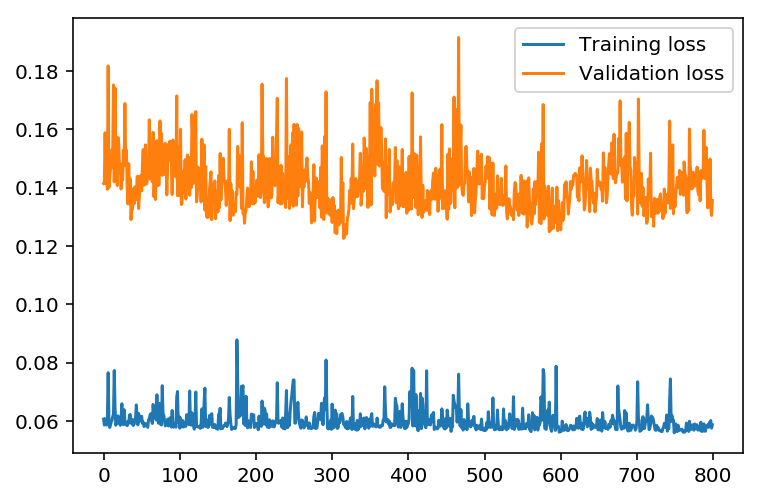

{'iterations': 5000, 'learning_rate': 0.9, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.058 validation loss: train loss :0.135


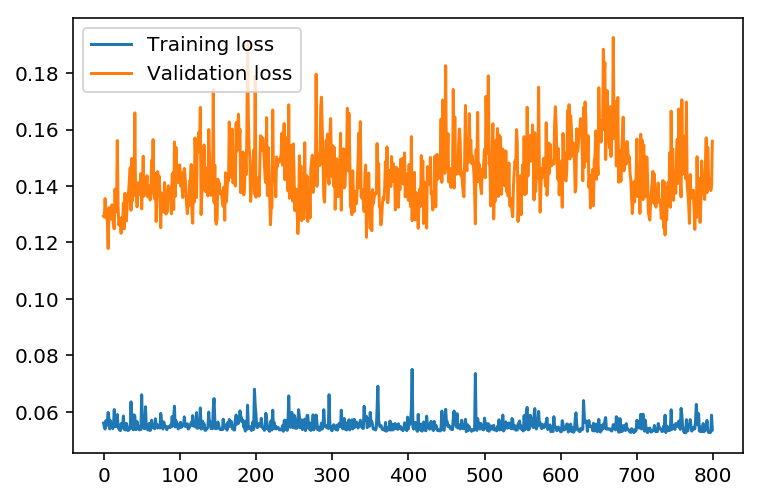

{'iterations': 8000, 'learning_rate': 0.9, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.053 validation loss: train loss :0.155


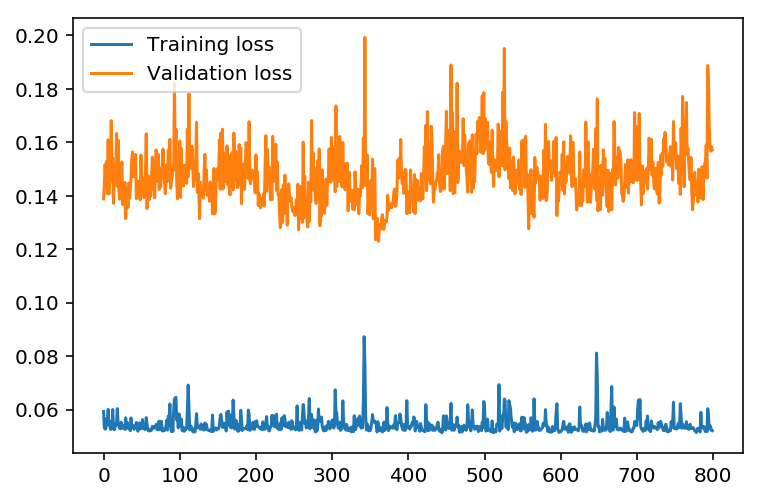

{'iterations': 10000, 'learning_rate': 0.9, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.052 validation loss: train loss :0.157


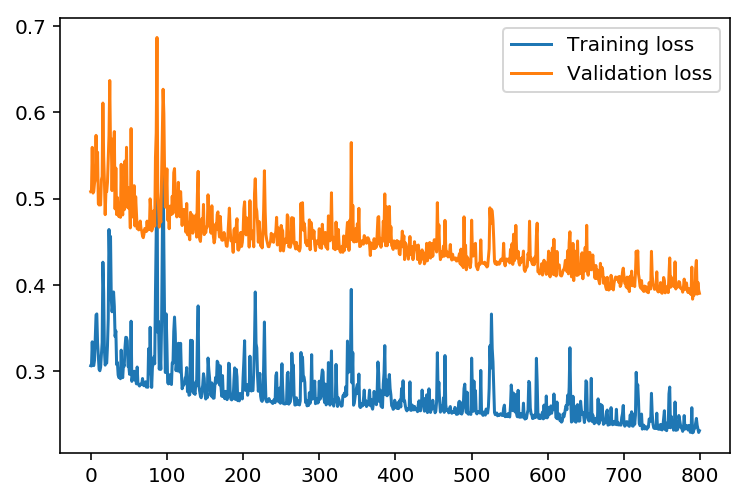

{'iterations': 1000, 'learning_rate': 0.7, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.231 validation loss: train loss :0.390


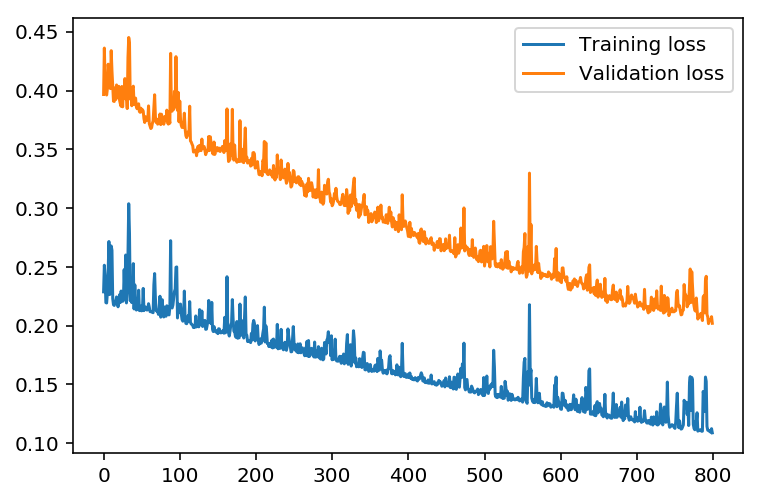

{'iterations': 1500, 'learning_rate': 0.7, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.108 validation loss: train loss :0.201


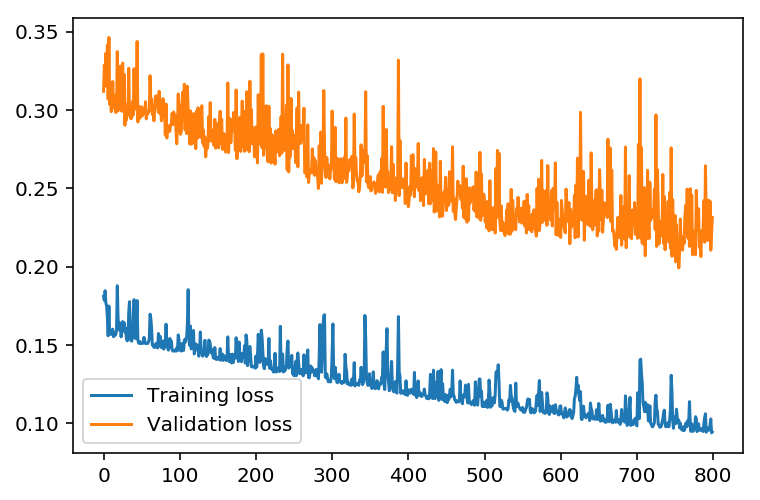

{'iterations': 2000, 'learning_rate': 0.7, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.094 validation loss: train loss :0.231


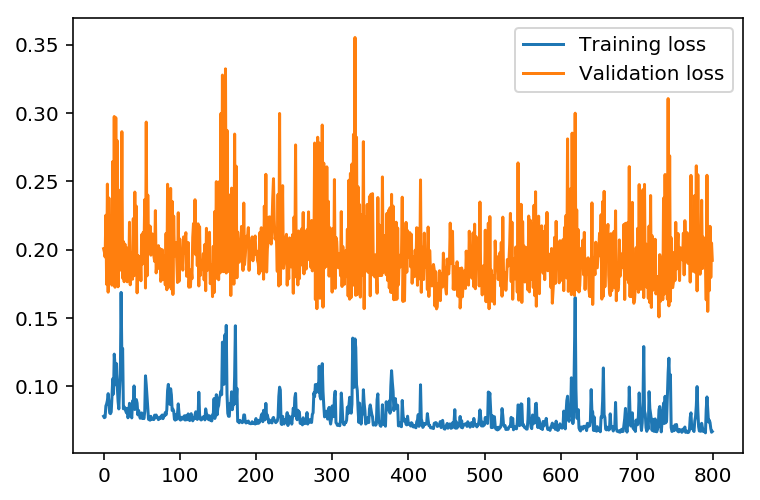

{'iterations': 3000, 'learning_rate': 0.7, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.066 validation loss: train loss :0.192


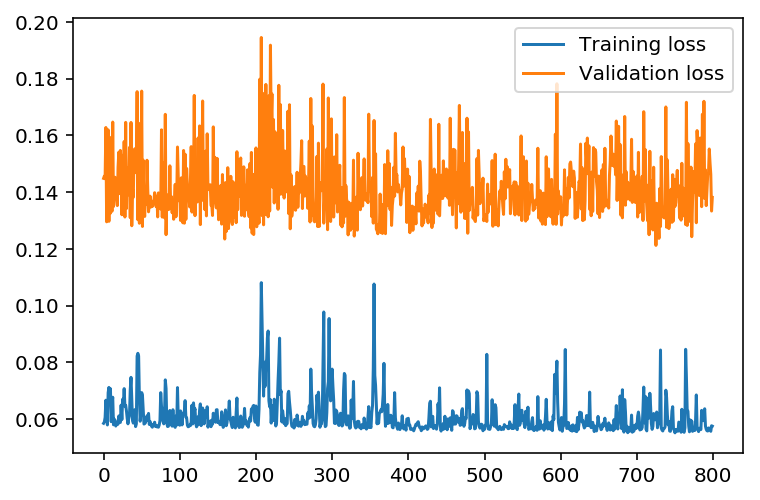

{'iterations': 5000, 'learning_rate': 0.7, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.057 validation loss: train loss :0.138


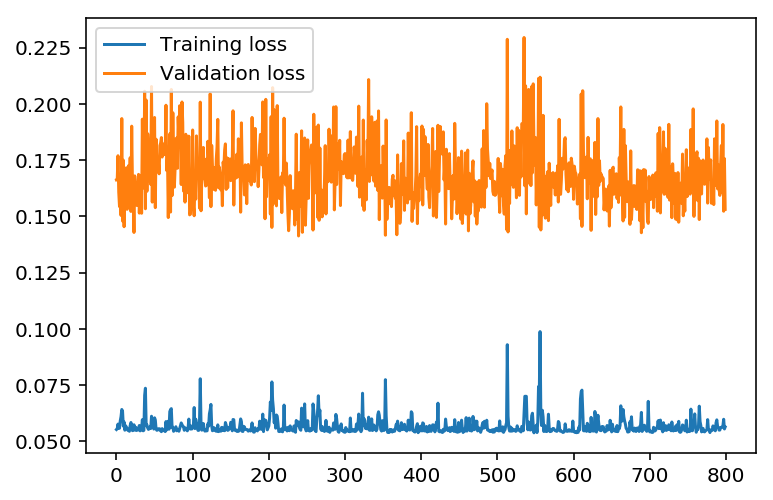

{'iterations': 8000, 'learning_rate': 0.7, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.056 validation loss: train loss :0.153


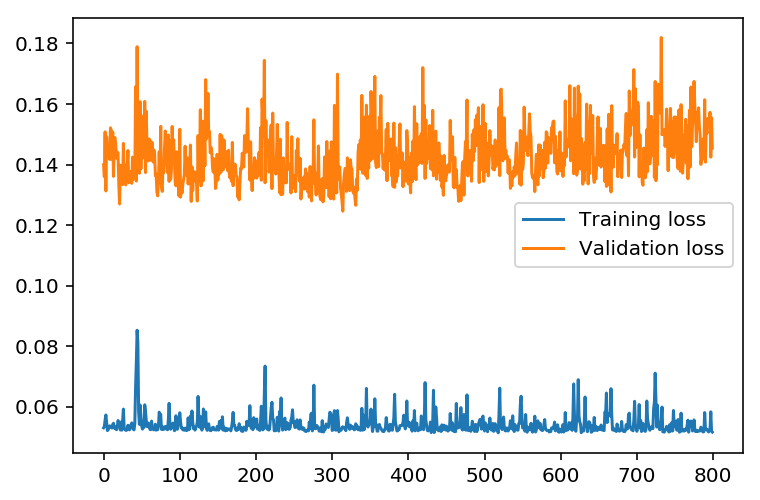

{'iterations': 10000, 'learning_rate': 0.7, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.051 validation loss: train loss :0.145


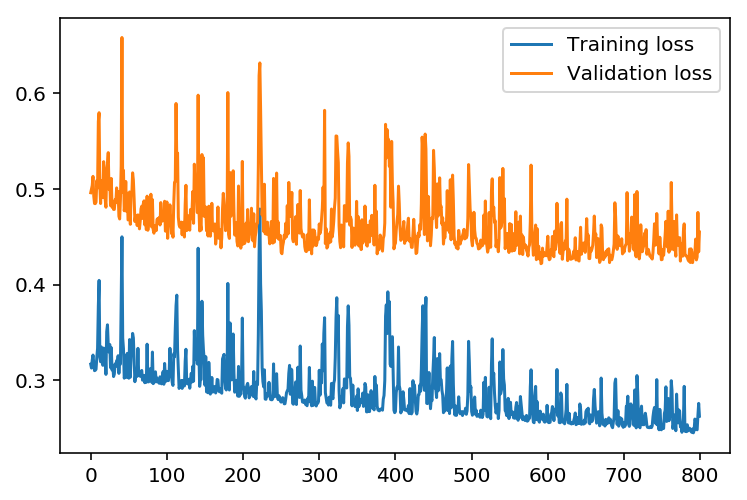

{'iterations': 1000, 'learning_rate': 0.5, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.262 validation loss: train loss :0.454


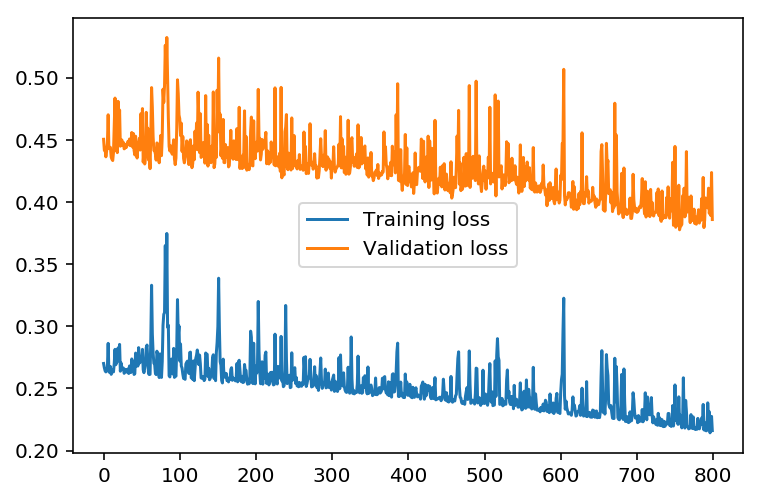

{'iterations': 1500, 'learning_rate': 0.5, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.216 validation loss: train loss :0.385


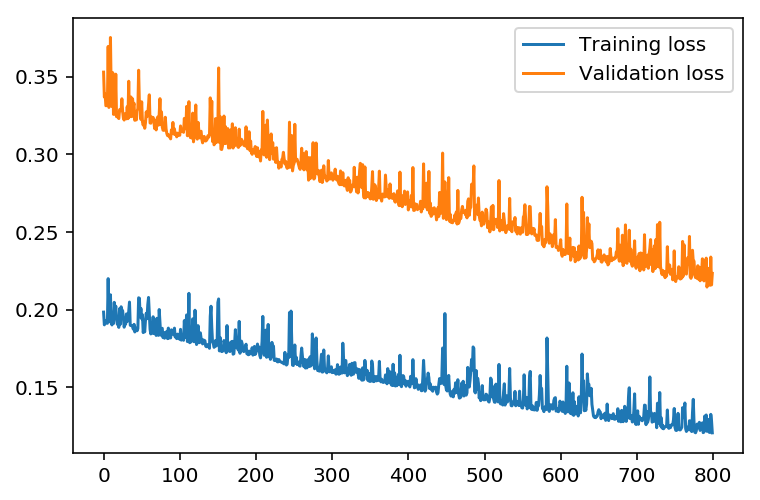

{'iterations': 2000, 'learning_rate': 0.5, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.120 validation loss: train loss :0.223


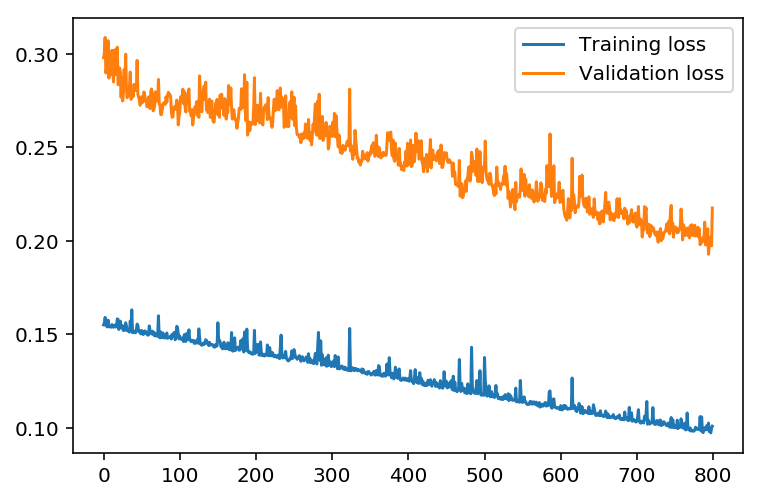

{'iterations': 3000, 'learning_rate': 0.5, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.100 validation loss: train loss :0.217


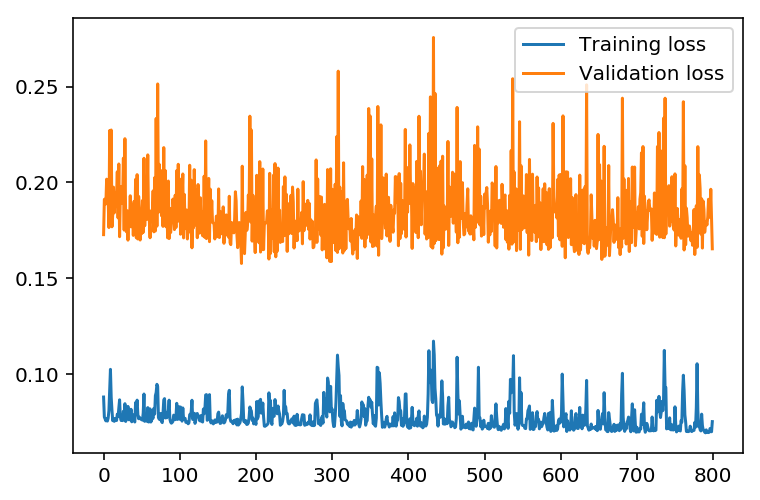

{'iterations': 5000, 'learning_rate': 0.5, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.075 validation loss: train loss :0.165


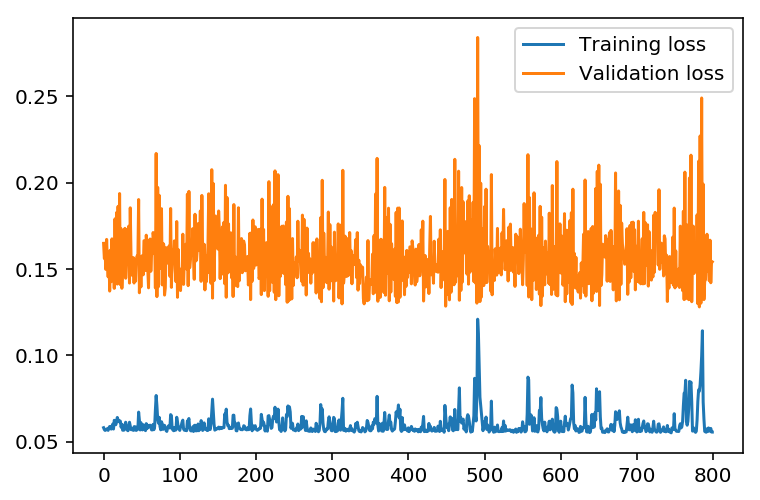

{'iterations': 8000, 'learning_rate': 0.5, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.055 validation loss: train loss :0.154


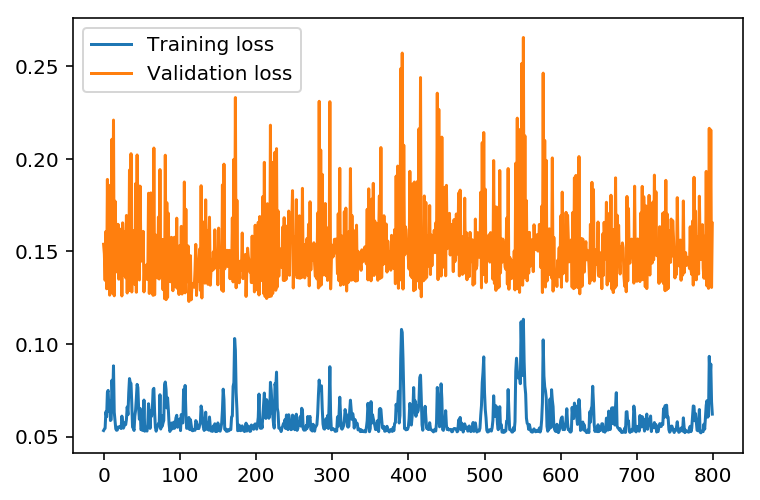

{'iterations': 10000, 'learning_rate': 0.5, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.062 validation loss: train loss :0.165


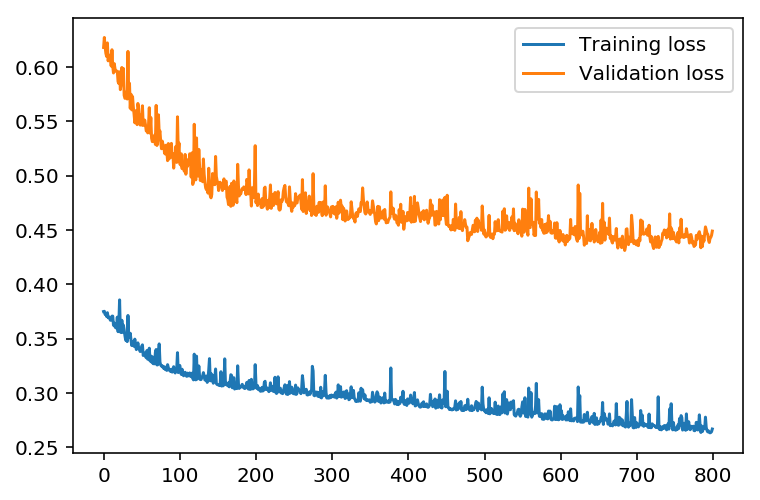

{'iterations': 1000, 'learning_rate': 0.3, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.266 validation loss: train loss :0.448


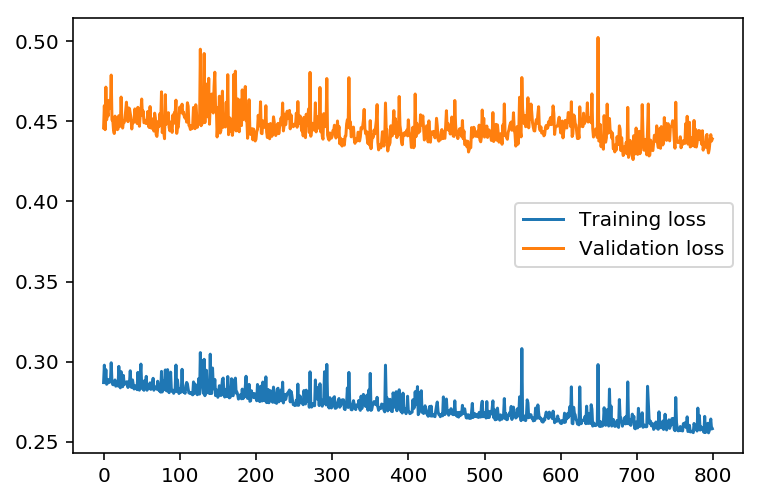

{'iterations': 1500, 'learning_rate': 0.3, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.258 validation loss: train loss :0.438


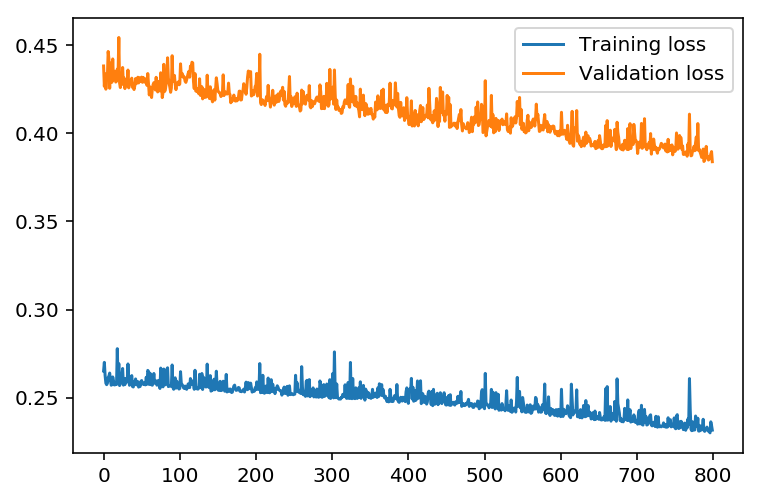

{'iterations': 2000, 'learning_rate': 0.3, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.231 validation loss: train loss :0.383


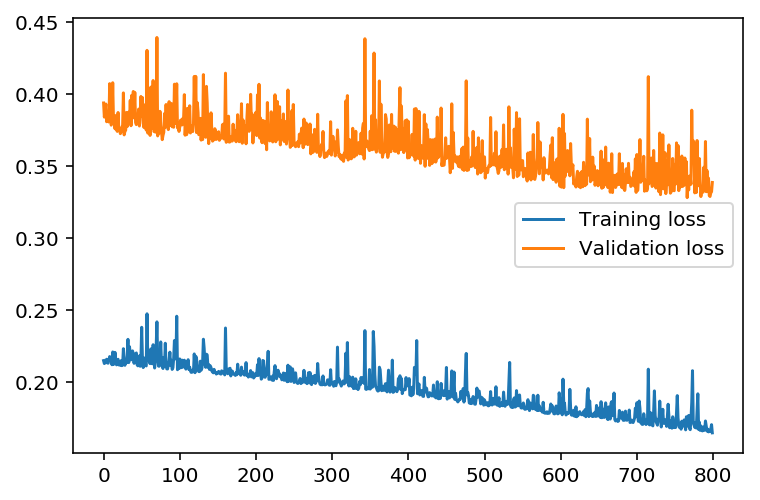

{'iterations': 3000, 'learning_rate': 0.3, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.164 validation loss: train loss :0.338


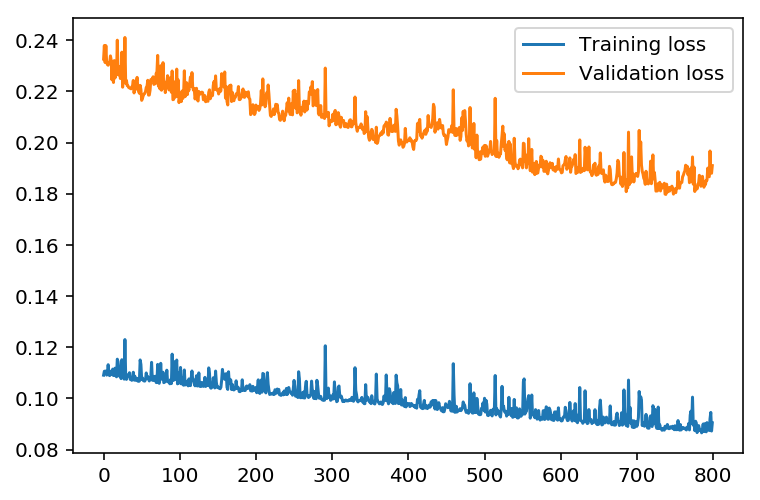

{'iterations': 5000, 'learning_rate': 0.3, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.090 validation loss: train loss :0.190


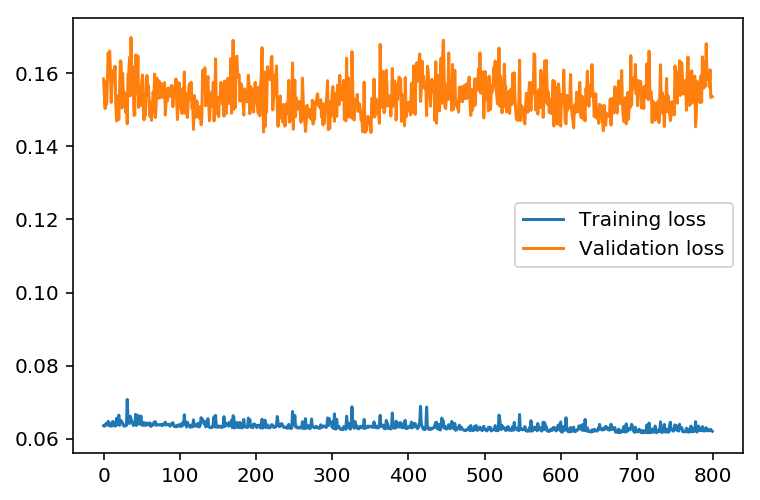

{'iterations': 8000, 'learning_rate': 0.3, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.062 validation loss: train loss :0.153


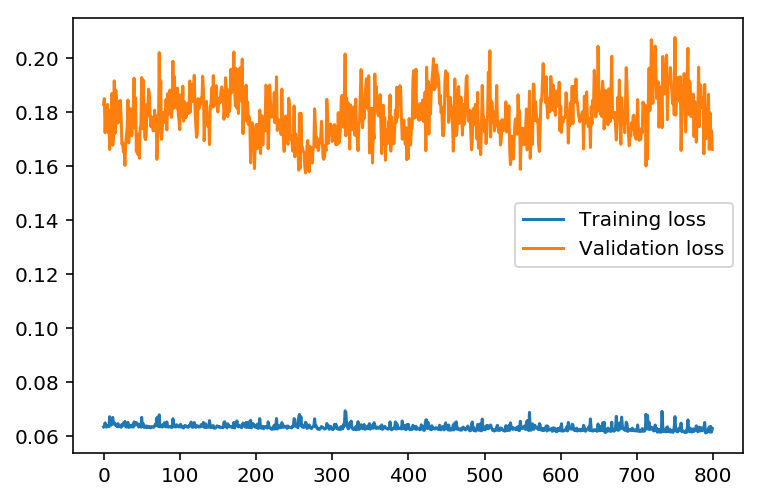

{'iterations': 10000, 'learning_rate': 0.3, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.062 validation loss: train loss :0.166


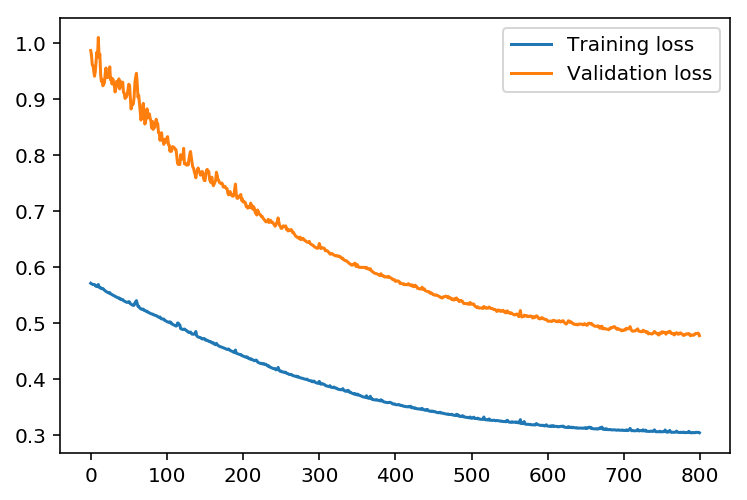

{'iterations': 1000, 'learning_rate': 0.1, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.304 validation loss: train loss :0.477


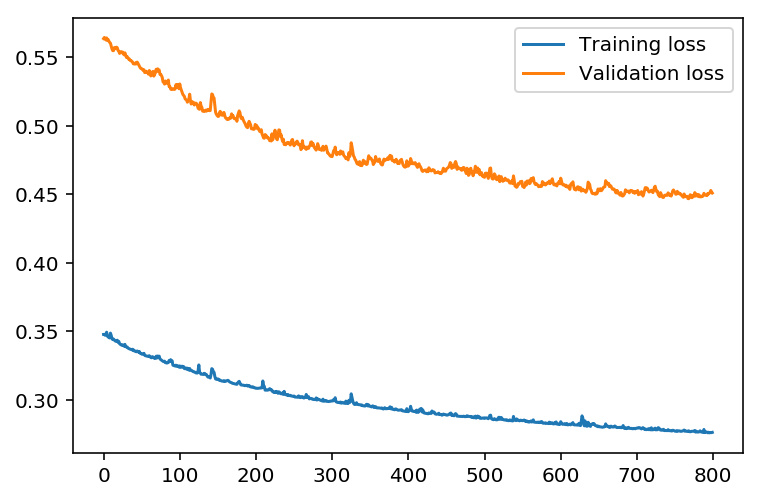

{'iterations': 1500, 'learning_rate': 0.1, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.276 validation loss: train loss :0.450


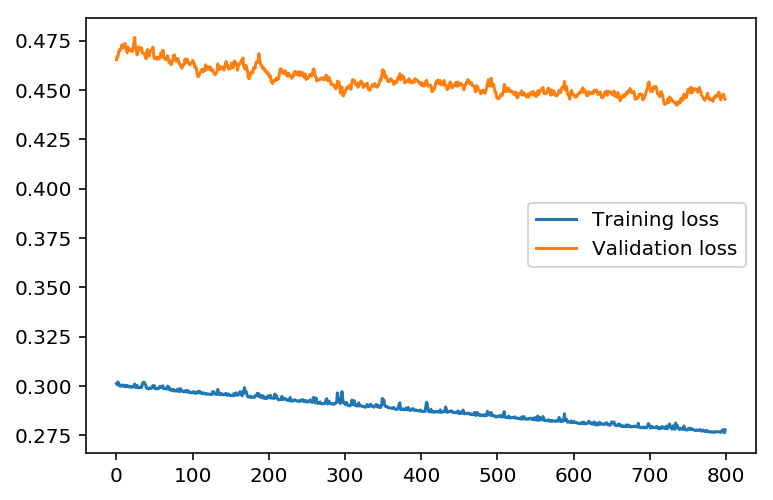

{'iterations': 2000, 'learning_rate': 0.1, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.277 validation loss: train loss :0.445


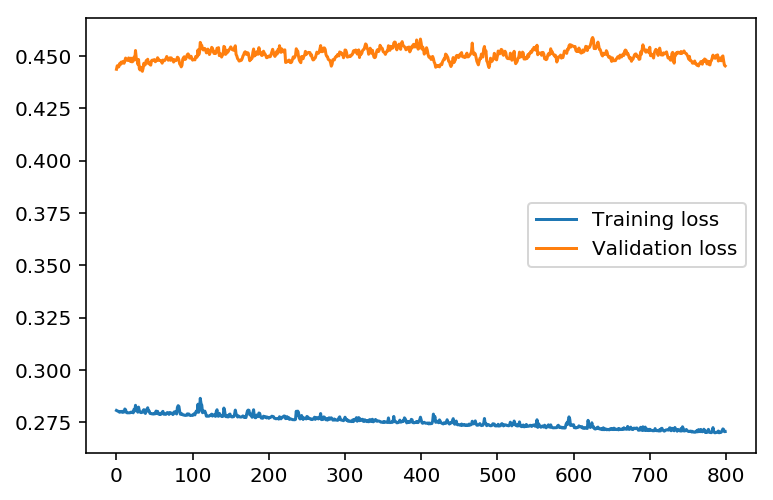

{'iterations': 3000, 'learning_rate': 0.1, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.270 validation loss: train loss :0.445


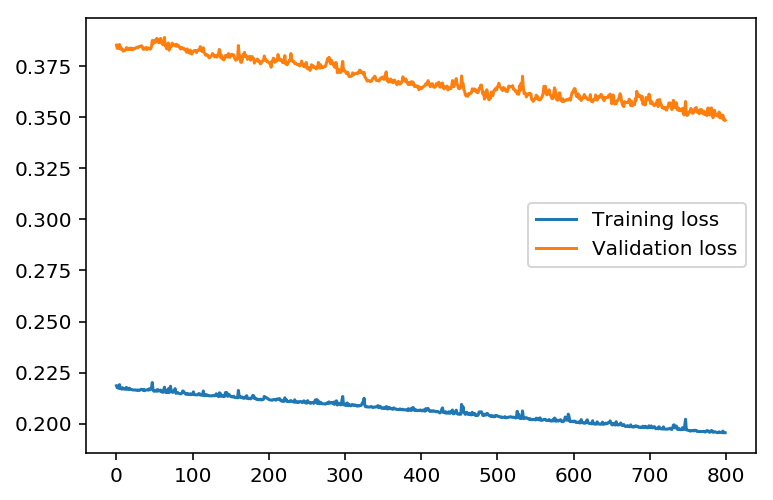

{'iterations': 5000, 'learning_rate': 0.1, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.195 validation loss: train loss :0.348


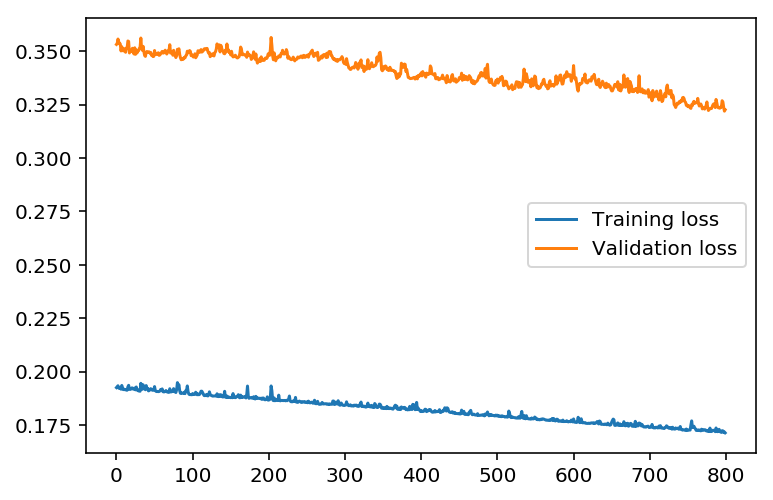

{'iterations': 8000, 'learning_rate': 0.1, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.171 validation loss: train loss :0.322


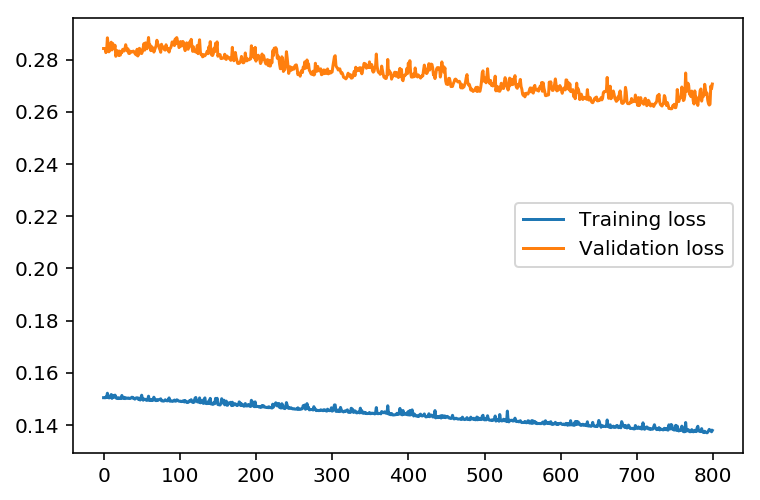

{'iterations': 10000, 'learning_rate': 0.1, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.137 validation loss: train loss :0.270


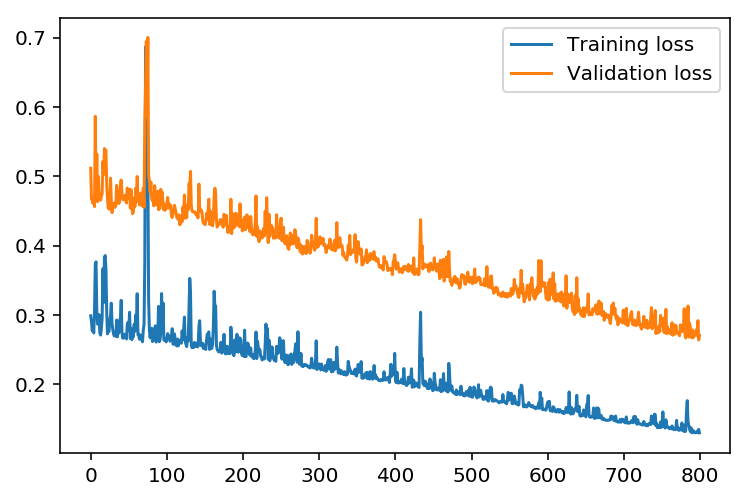

{'iterations': 1000, 'learning_rate': 0.9, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.130 validation loss: train loss :0.270


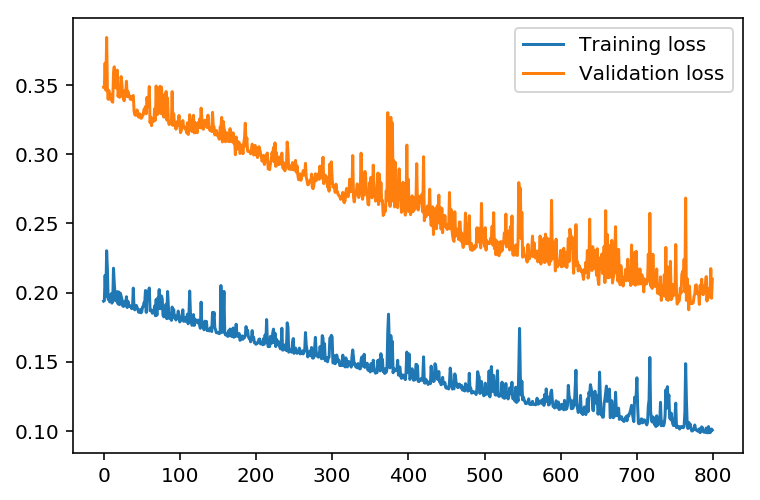

{'iterations': 1500, 'learning_rate': 0.9, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.100 validation loss: train loss :0.209


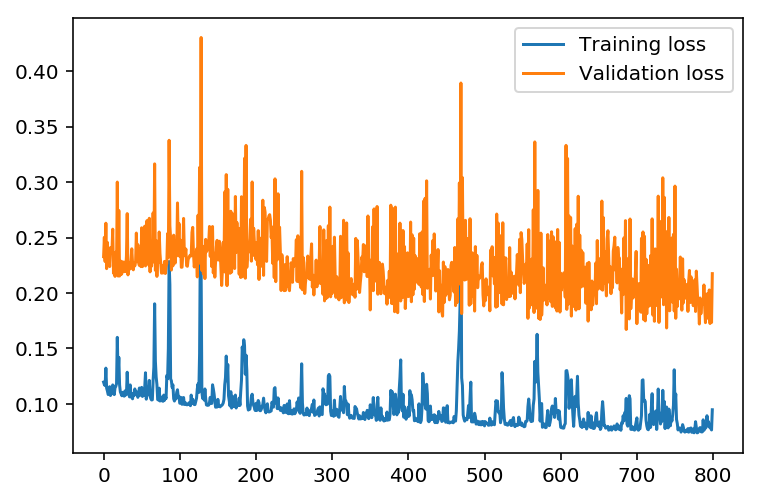

{'iterations': 2000, 'learning_rate': 0.9, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.094 validation loss: train loss :0.217


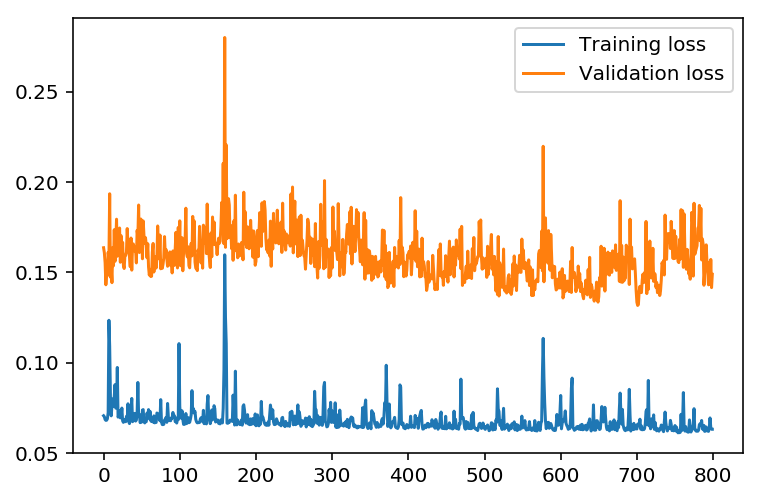

{'iterations': 3000, 'learning_rate': 0.9, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.063 validation loss: train loss :0.148


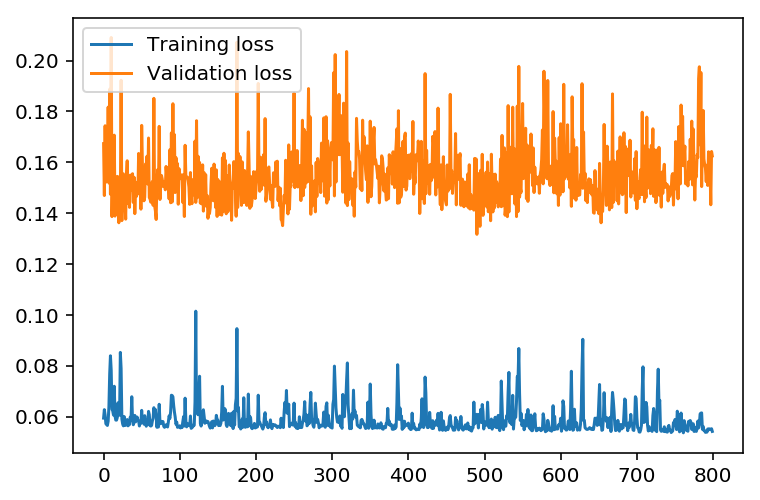

{'iterations': 5000, 'learning_rate': 0.9, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.054 validation loss: train loss :0.162


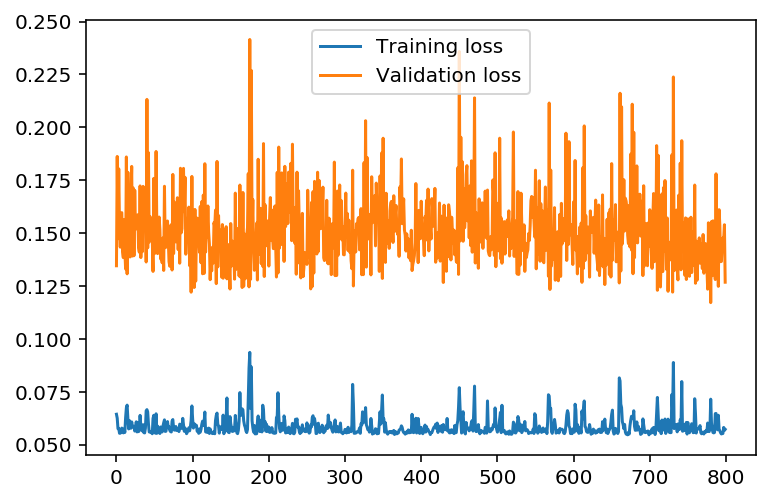

{'iterations': 8000, 'learning_rate': 0.9, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.057 validation loss: train loss :0.126


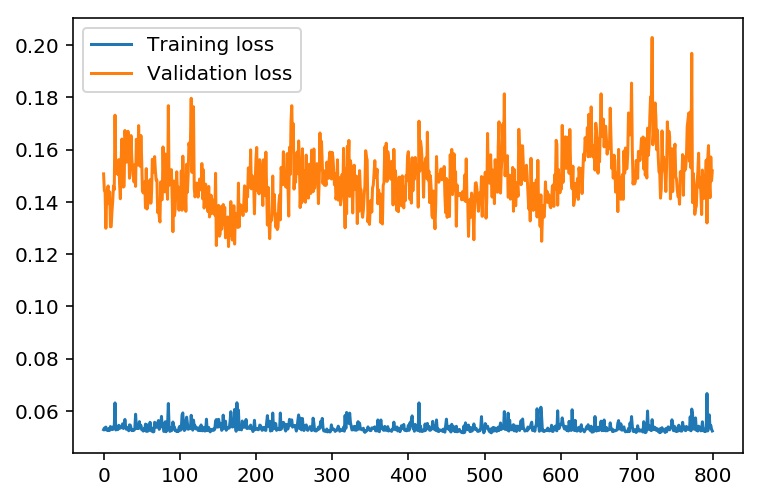

{'iterations': 10000, 'learning_rate': 0.9, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.052 validation loss: train loss :0.151


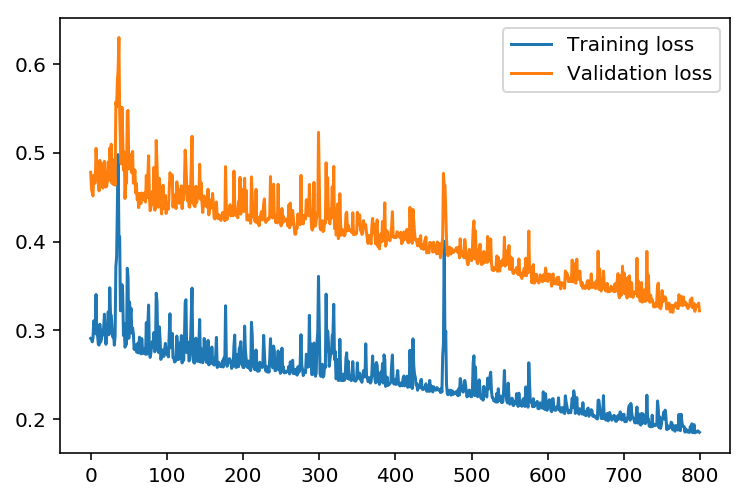

{'iterations': 1000, 'learning_rate': 0.7, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.185 validation loss: train loss :0.321


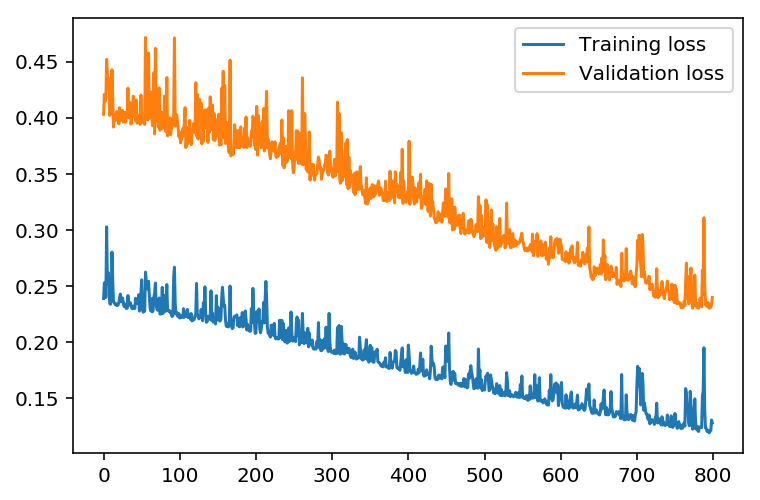

{'iterations': 1500, 'learning_rate': 0.7, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.128 validation loss: train loss :0.239


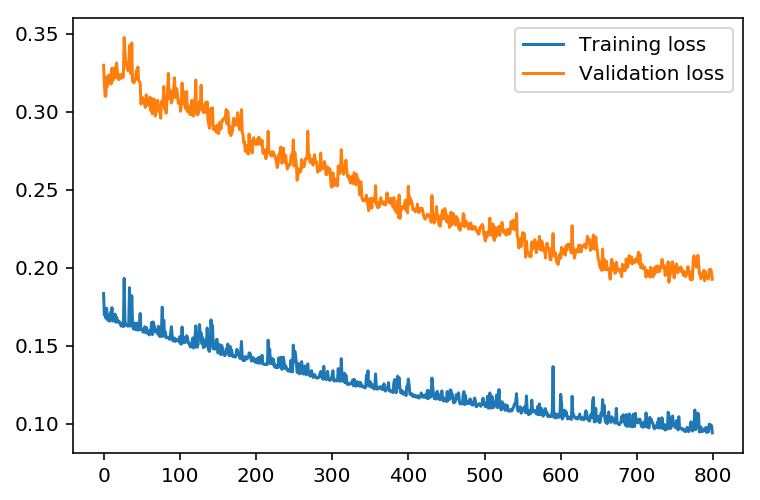

{'iterations': 2000, 'learning_rate': 0.7, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.094 validation loss: train loss :0.192


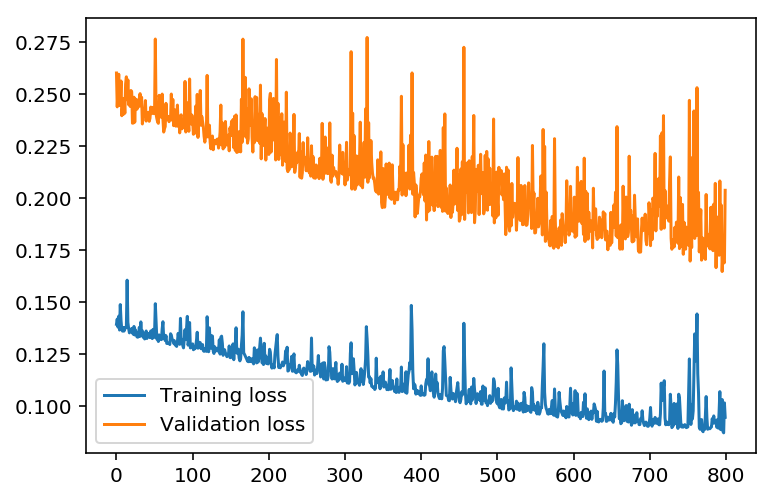

{'iterations': 3000, 'learning_rate': 0.7, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.094 validation loss: train loss :0.203


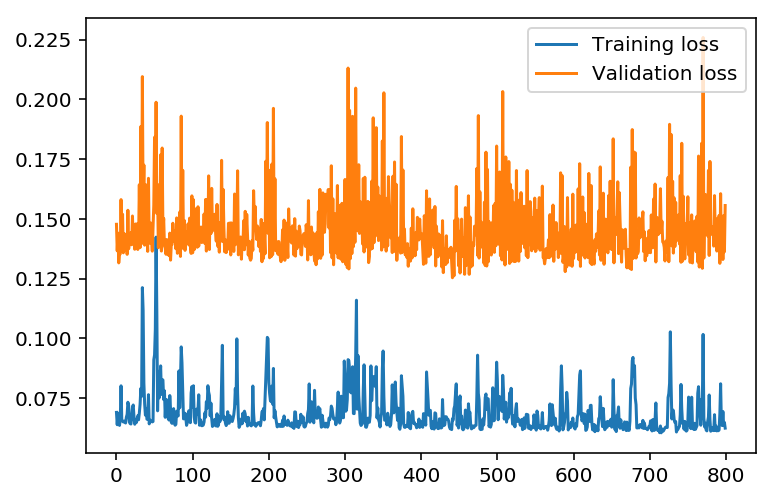

{'iterations': 5000, 'learning_rate': 0.7, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.062 validation loss: train loss :0.155


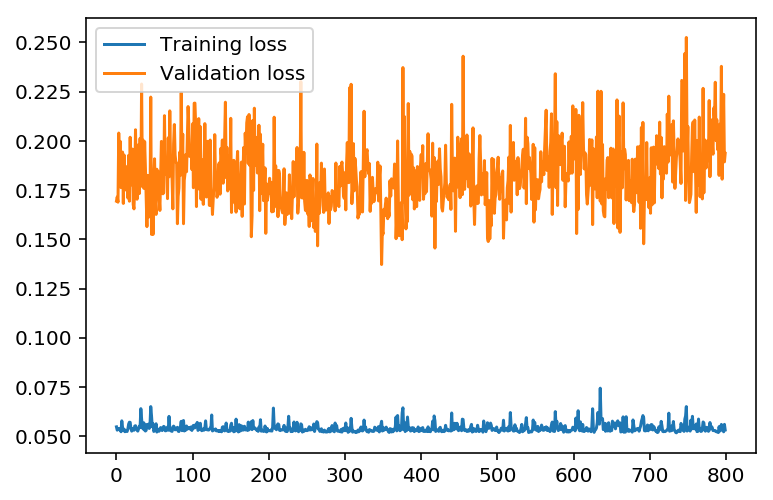

{'iterations': 8000, 'learning_rate': 0.7, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.053 validation loss: train loss :0.193


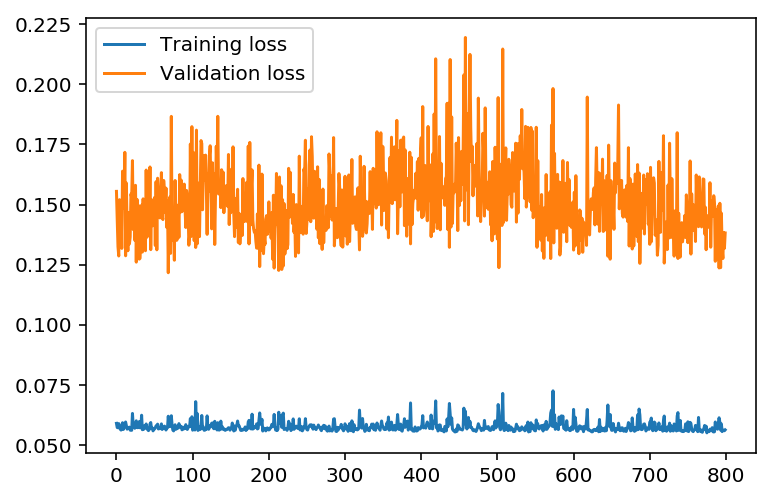

{'iterations': 10000, 'learning_rate': 0.7, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.056 validation loss: train loss :0.138


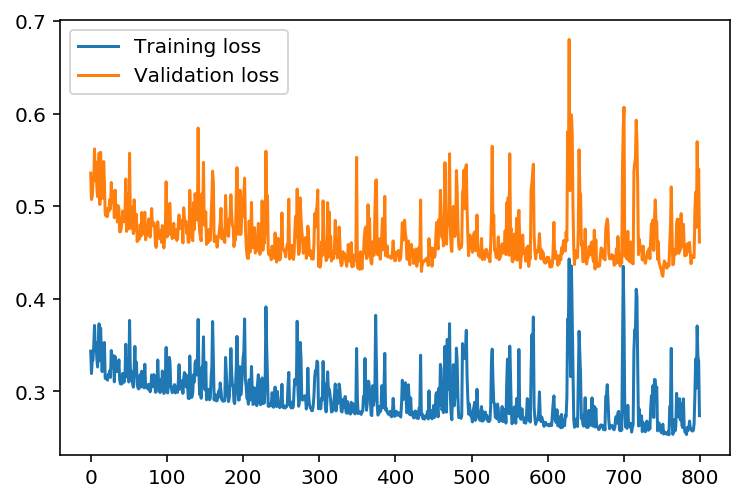

{'iterations': 1000, 'learning_rate': 0.5, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.273 validation loss: train loss :0.461


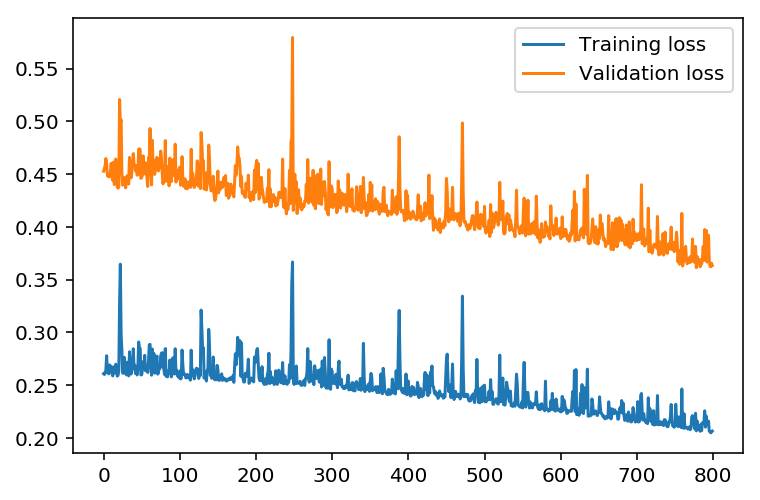

{'iterations': 1500, 'learning_rate': 0.5, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.206 validation loss: train loss :0.363


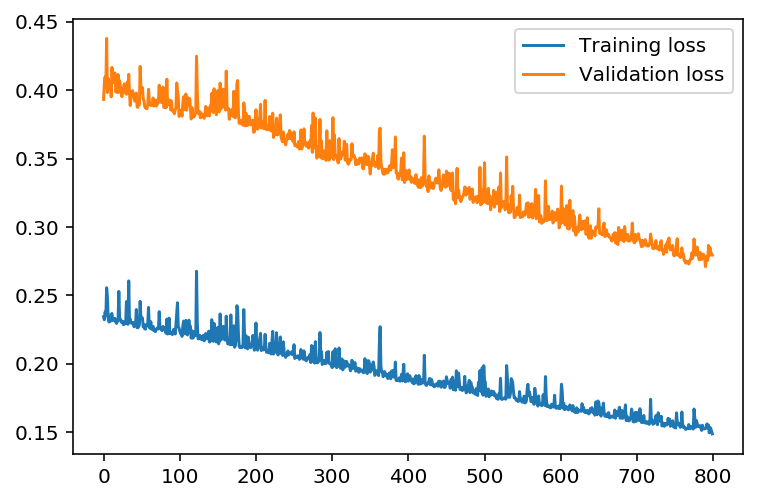

{'iterations': 2000, 'learning_rate': 0.5, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.148 validation loss: train loss :0.279


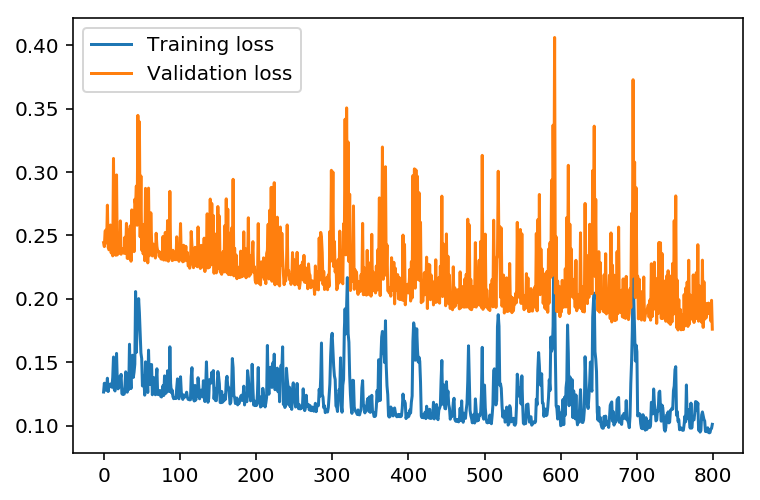

{'iterations': 3000, 'learning_rate': 0.5, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.101 validation loss: train loss :0.176


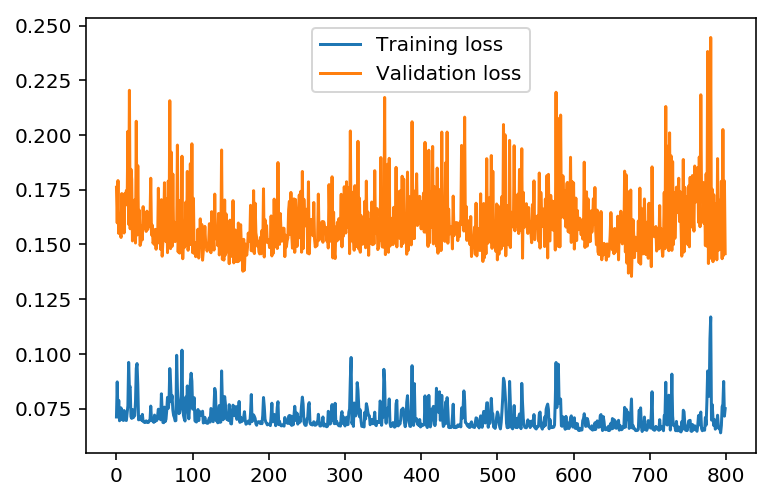

{'iterations': 5000, 'learning_rate': 0.5, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.074 validation loss: train loss :0.145


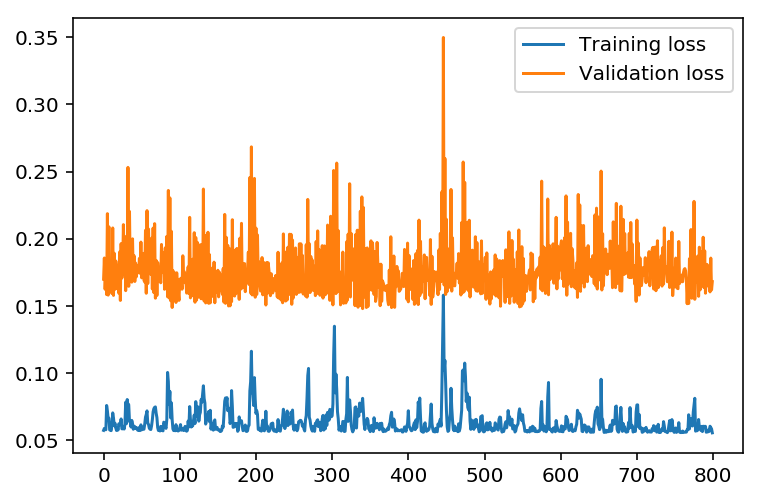

{'iterations': 8000, 'learning_rate': 0.5, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.055 validation loss: train loss :0.168


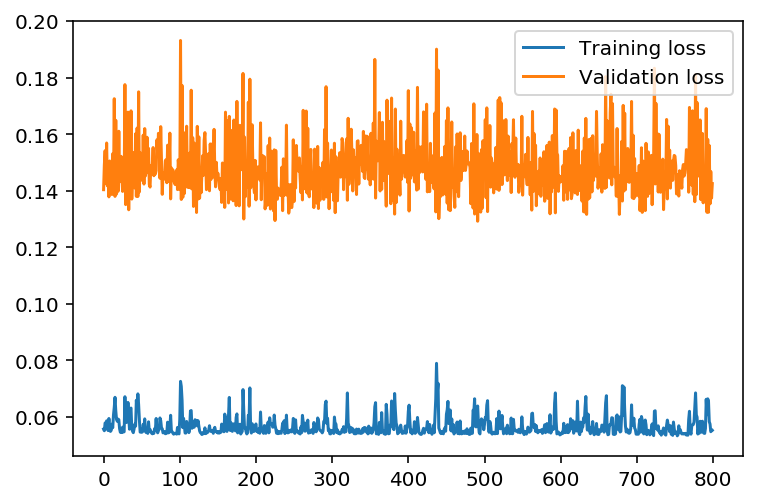

{'iterations': 10000, 'learning_rate': 0.5, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.055 validation loss: train loss :0.142


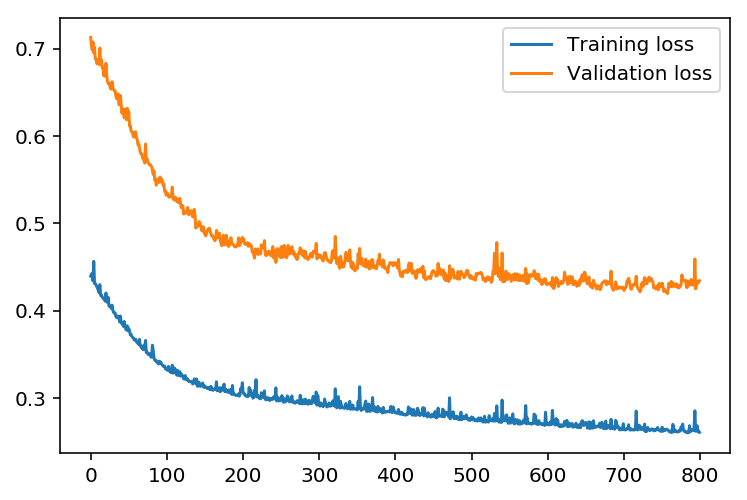

{'iterations': 1000, 'learning_rate': 0.3, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.260 validation loss: train loss :0.434


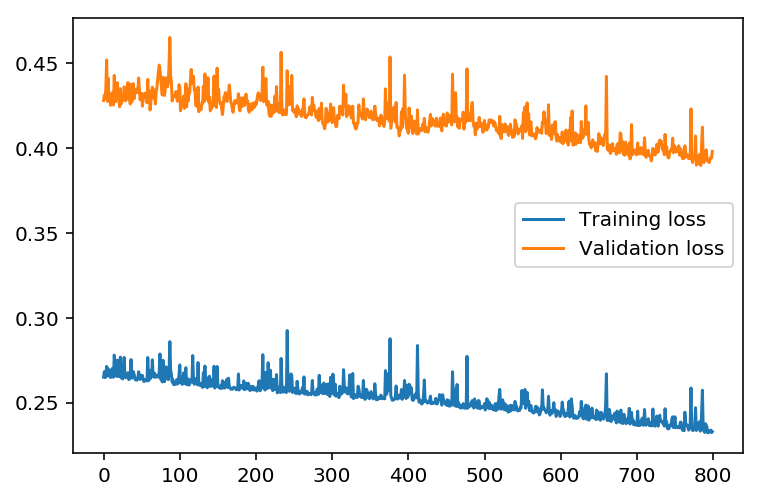

{'iterations': 1500, 'learning_rate': 0.3, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.232 validation loss: train loss :0.398


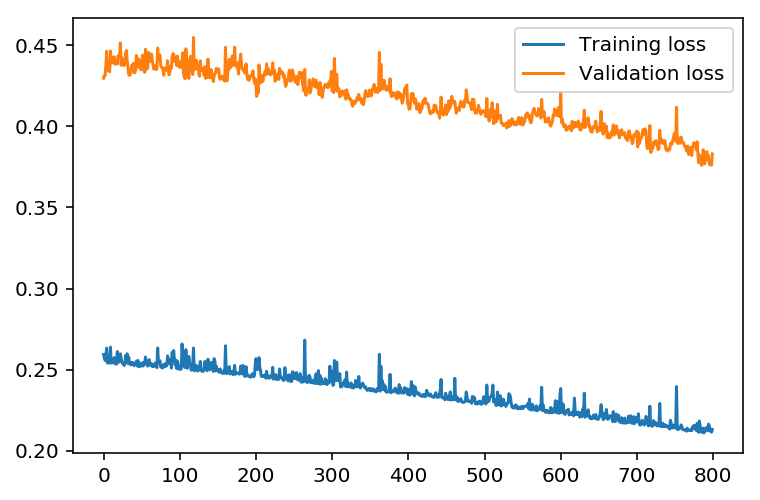

{'iterations': 2000, 'learning_rate': 0.3, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.213 validation loss: train loss :0.383


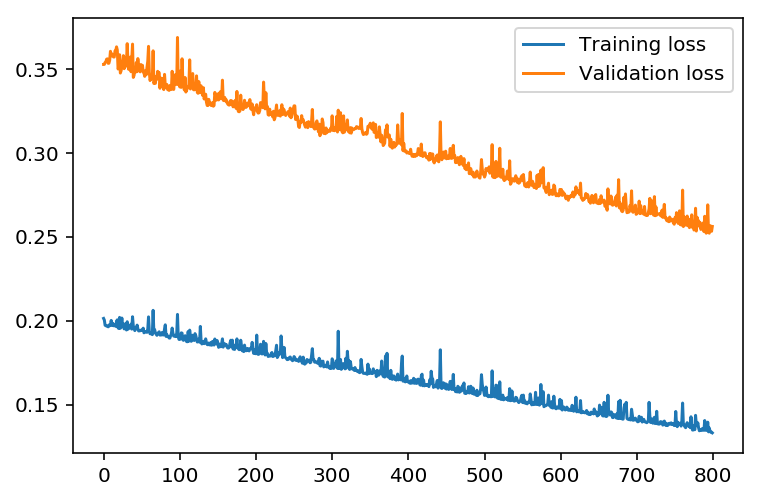

{'iterations': 3000, 'learning_rate': 0.3, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.133 validation loss: train loss :0.256


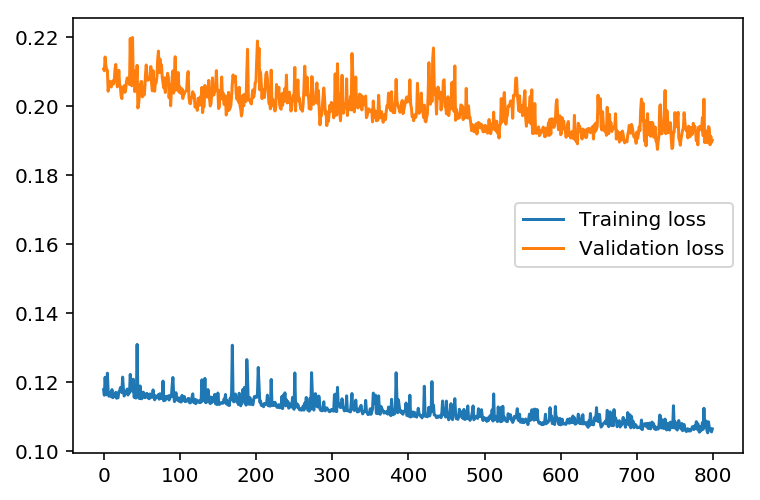

{'iterations': 5000, 'learning_rate': 0.3, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.106 validation loss: train loss :0.190


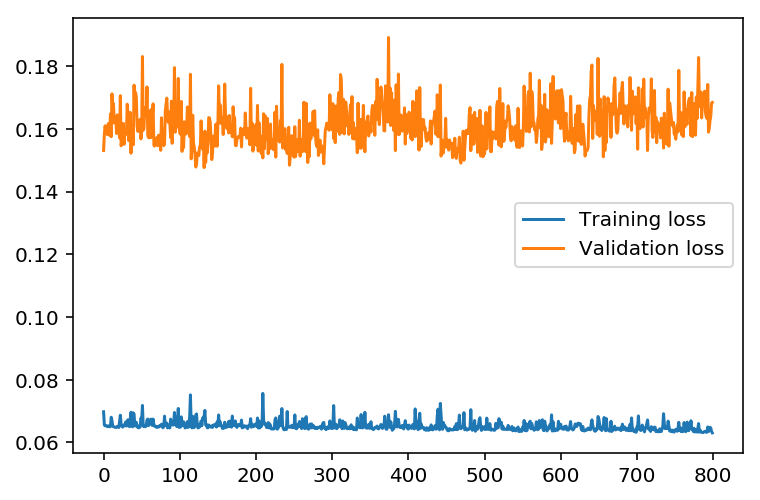

{'iterations': 8000, 'learning_rate': 0.3, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.063 validation loss: train loss :0.168


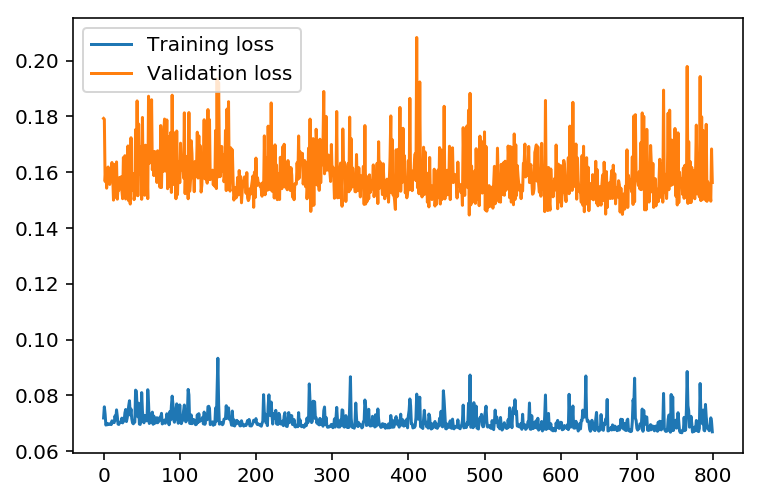

{'iterations': 10000, 'learning_rate': 0.3, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.066 validation loss: train loss :0.156


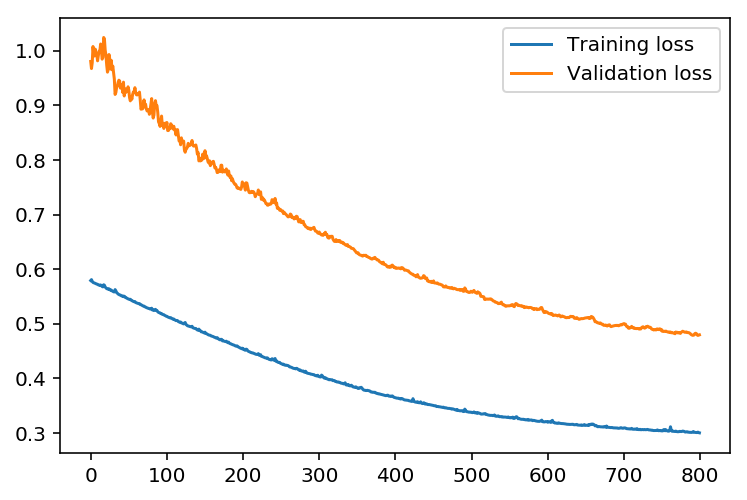

{'iterations': 1000, 'learning_rate': 0.1, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.300 validation loss: train loss :0.479


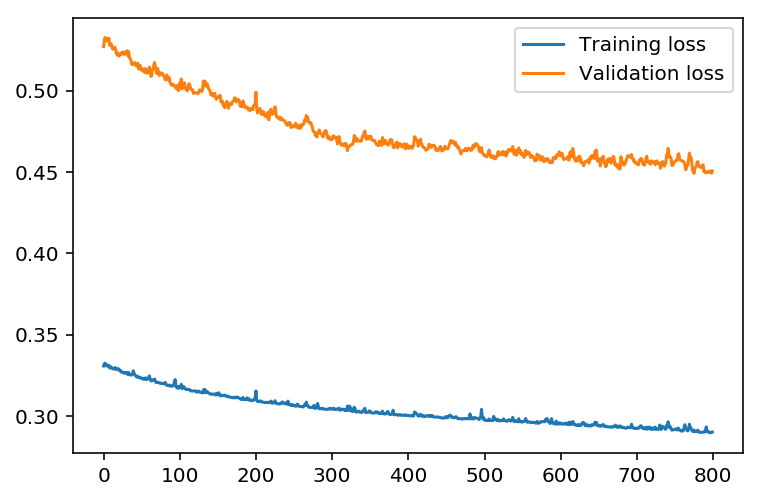

{'iterations': 1500, 'learning_rate': 0.1, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.290 validation loss: train loss :0.450


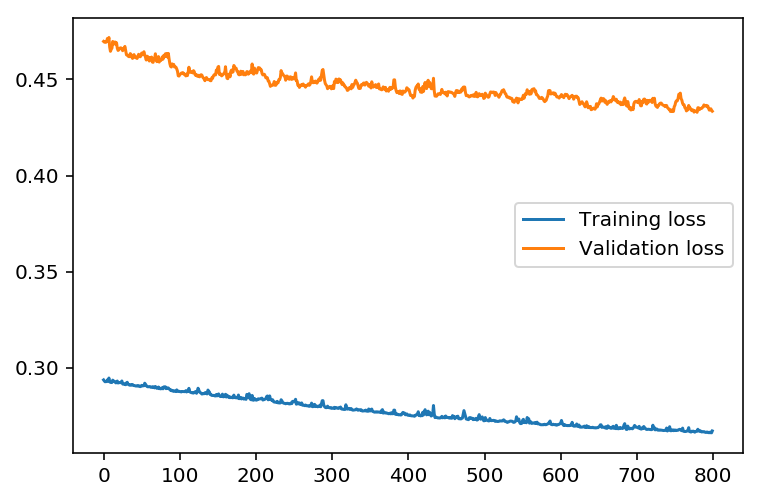

{'iterations': 2000, 'learning_rate': 0.1, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.267 validation loss: train loss :0.433


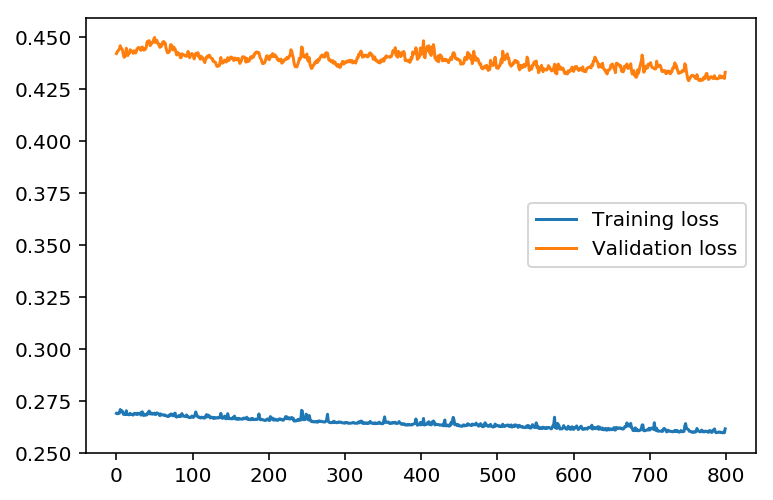

{'iterations': 3000, 'learning_rate': 0.1, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.261 validation loss: train loss :0.432


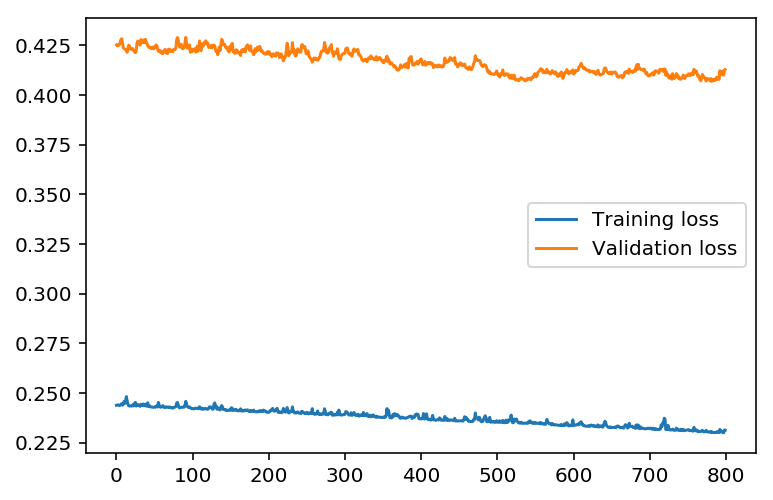

{'iterations': 5000, 'learning_rate': 0.1, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.231 validation loss: train loss :0.412


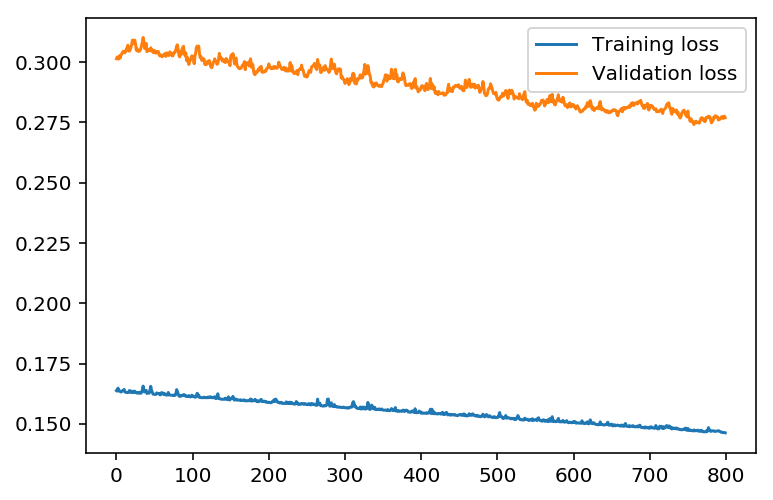

{'iterations': 8000, 'learning_rate': 0.1, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.146 validation loss: train loss :0.276


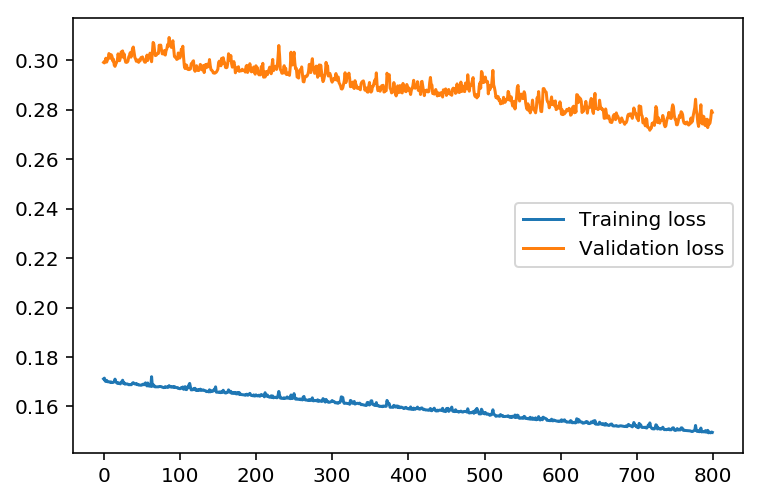

{'iterations': 10000, 'learning_rate': 0.1, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.149 validation loss: train loss :0.278


In [211]:
# 选出最好的模型
# 虽然从上面的图可以看出来学习率大收敛速度快并且logloss也很小，但是需要看最后 validation loss是否是上升趋势
# 防止过拟合
for result in results:
    losses = result['losses']
    plt.plot(losses['train'][-800:], label='Training loss')
    plt.plot(losses['validation'][-800:], label='Validation loss')
    plt.legend()
    _ = plt.ylim()
    plt.show()
    print(result['params'])
    print("train loss: " + str(losses['train'][-1])[:5] + " validation loss: " "train loss :" + str(losses['validation'][-1])[:5] )

Start train for params iterations:2000,learning_rate:0.70,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.078 ... Validation loss: 0.163

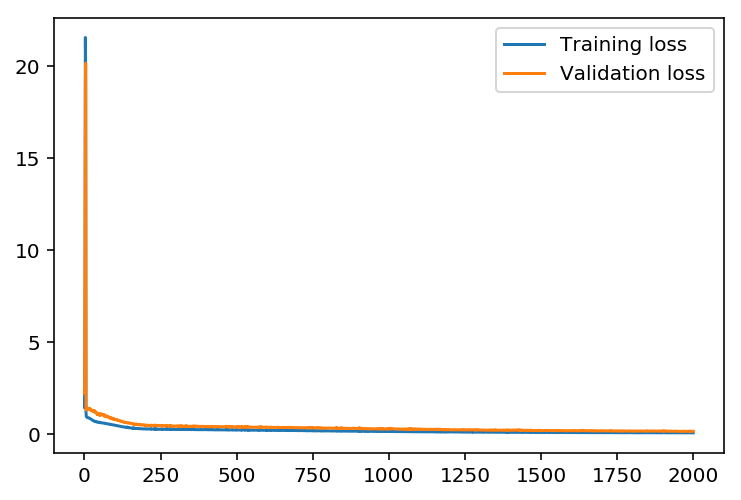

In [214]:
# 观察发现一些看上去很完美的loss数据，但是实际上都是过拟合的

# 以下是一些比较好的模型参数
# {'iterations': 2000, 'learning_rate': 0.7, 'hidden_nodes': 16, 'output_nodes': 1}
# train loss: 0.077 validation loss: train loss :0.162
network = grid_search(2000,0.7,16)['network']

### 以下是一些挑选的比较好的训练参数

```
{'iterations': 2000, 'learning_rate': 0.7, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.077 validation loss: train loss :0.162

{'iterations': 1500, 'learning_rate': 0.9, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.087 validation loss: train loss :0.192

{'iterations': 1500, 'learning_rate': 0.9, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.084 validation loss: train loss :0.200

{'iterations': 2000, 'learning_rate': 0.7, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.084 validation loss: train loss :0.176

{'iterations': 3000, 'learning_rate': 0.5, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.082 validation loss: train loss :0.182

{'iterations': 2000, 'learning_rate': 0.7, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.090 validation loss: train loss :0.182

{'iterations': 5000, 'learning_rate': 0.3, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.090 validation loss: train loss :0.190

{'iterations': 2000, 'learning_rate': 0.7, 'hidden_nodes': 10, 'output_nodes': 1}
train loss: 0.094 validation loss: train loss :0.192

{'iterations': 1500, 'learning_rate': 0.7, 'hidden_nodes': 18, 'output_nodes': 1}
train loss: 0.100 validation loss: train loss :0.216

{'iterations': 2000, 'learning_rate': 0.9, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.101 validation loss: train loss :0.195

{'iterations': 1500, 'learning_rate': 0.7, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.106 validation loss: train loss :0.232

{'iterations': 5000, 'learning_rate': 0.3, 'hidden_nodes': 14, 'output_nodes': 1}
train loss: 0.100 validation loss: train loss :0.215

{'iterations': 3000, 'learning_rate': 0.5, 'hidden_nodes': 12, 'output_nodes': 1}
train loss: 0.100 validation loss: train loss :0.217

{'iterations': 3000, 'learning_rate': 0.9, 'hidden_nodes': 20, 'output_nodes': 1}
train loss: 0.100 validation loss: train loss :0.182

{'iterations': 1500, 'learning_rate': 0.7, 'hidden_nodes': 16, 'output_nodes': 1}
train loss: 0.112 validation loss: train loss :0.224
```

## 检查预测结果

使用测试数据看看网络对数据建模的效果如何。如果完全错了，请确保网络中的每步都正确实现。

In [216]:
def check_network(network):
    fig, ax = plt.subplots(figsize=(8,4))

    mean, std = scaled_features['cnt']
    predictions = network.run(test_features).T*std + mean
    ax.plot(predictions[0], label='Prediction')
    ax.plot((test_targets['cnt']*std + mean).values, label='Data')
    ax.set_xlim(right=len(predictions))
    ax.legend()

    dates = pd.to_datetime(rides.ix[test_data.index]['dteday'])
    dates = dates.apply(lambda d: d.strftime('%b %d'))
    ax.set_xticks(np.arange(len(dates))[12::24])
    _ = ax.set_xticklabels(dates[12::24], rotation=45)
    plt.show()

Start train for params iterations:2000,learning_rate:0.70,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.083 ... Validation loss: 0.172

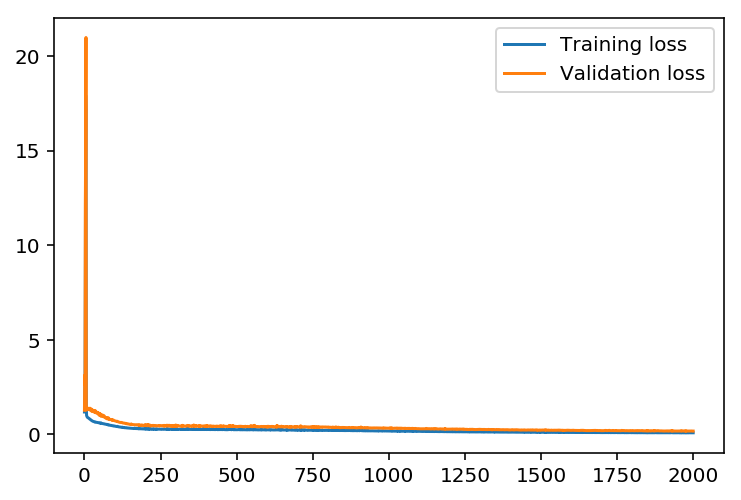

check result for train params: {'iterations': 2000, 'learning_rate': 0.7, 'hidden_nodes': 16}


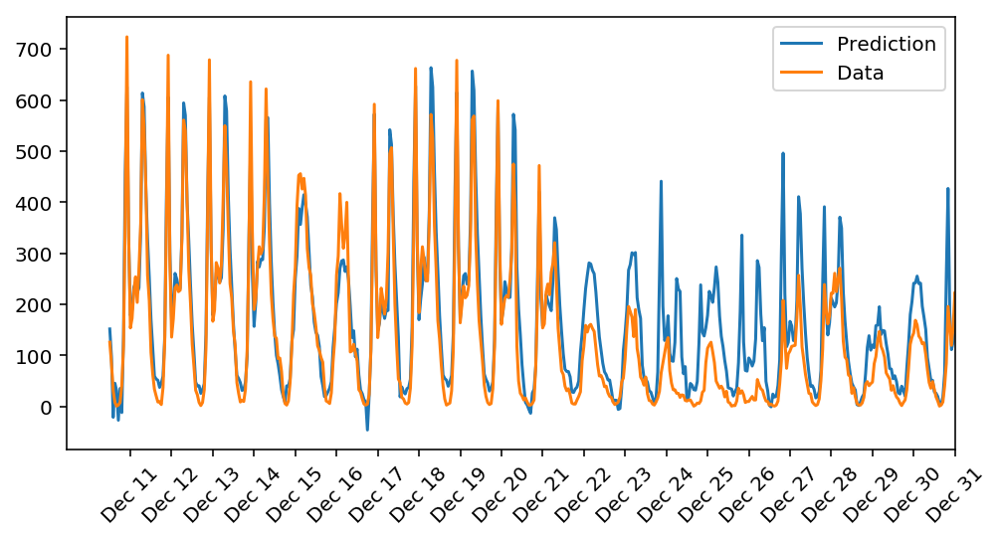

Start train for params iterations:1500,learning_rate:0.90,hidden_nodes:14,output_nodes:1
Progress: 99.9% ... Training loss: 0.082 ... Validation loss: 0.173

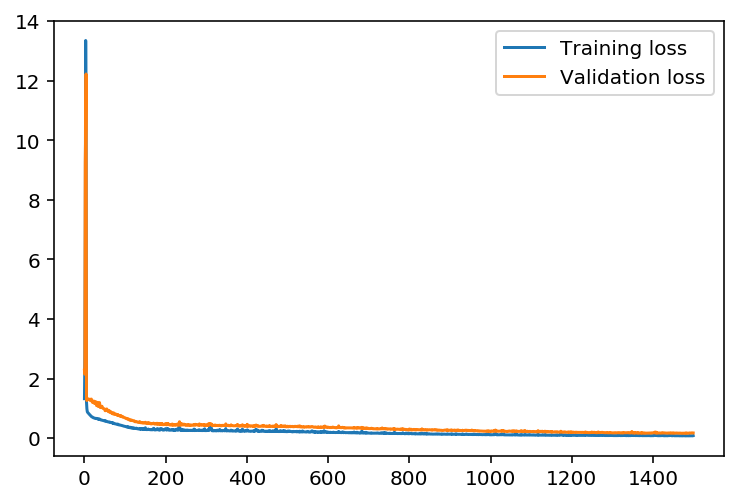

check result for train params: {'iterations': 1500, 'learning_rate': 0.9, 'hidden_nodes': 14}


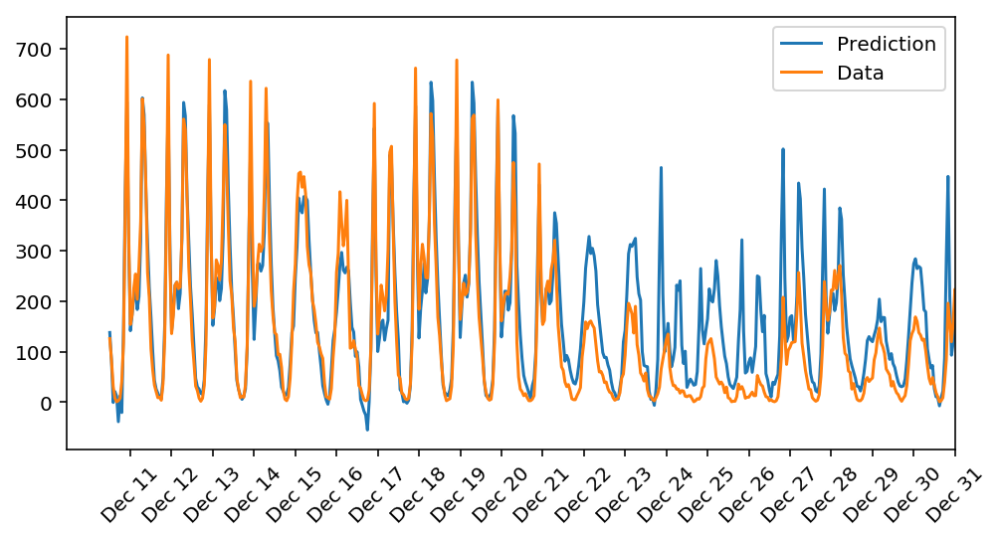

Start train for params iterations:1500,learning_rate:0.90,hidden_nodes:12,output_nodes:1
Progress: 99.9% ... Training loss: 0.096 ... Validation loss: 0.187

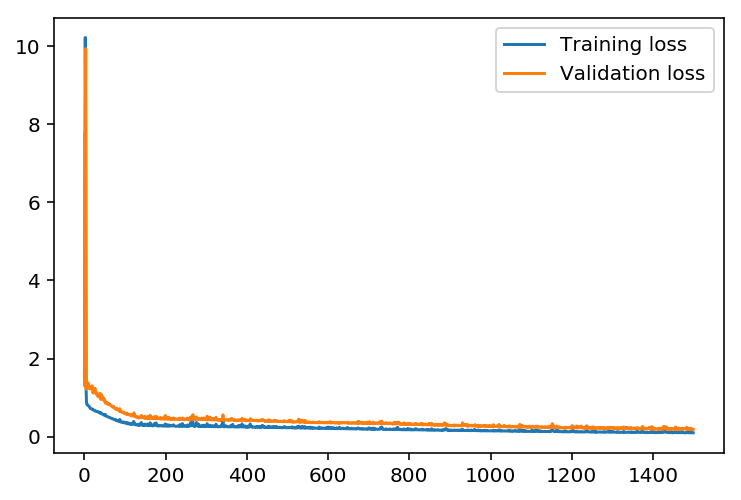

check result for train params: {'iterations': 1500, 'learning_rate': 0.9, 'hidden_nodes': 12}


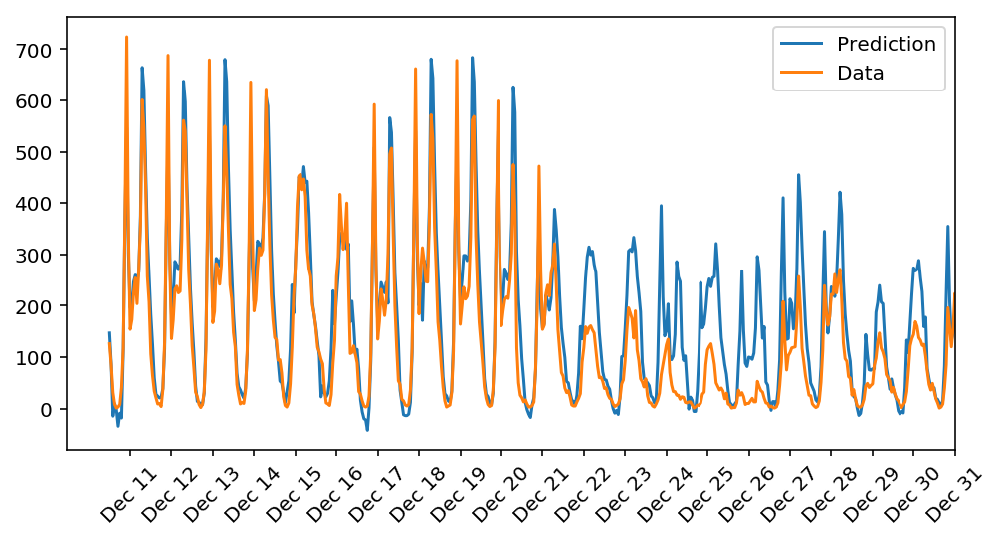

Start train for params iterations:2000,learning_rate:0.70,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.099 ... Validation loss: 0.210

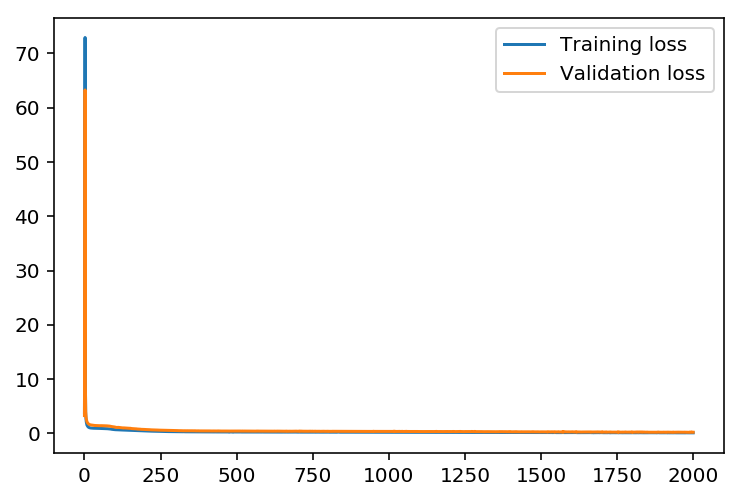

check result for train params: {'iterations': 2000, 'learning_rate': 0.7, 'hidden_nodes': 20}


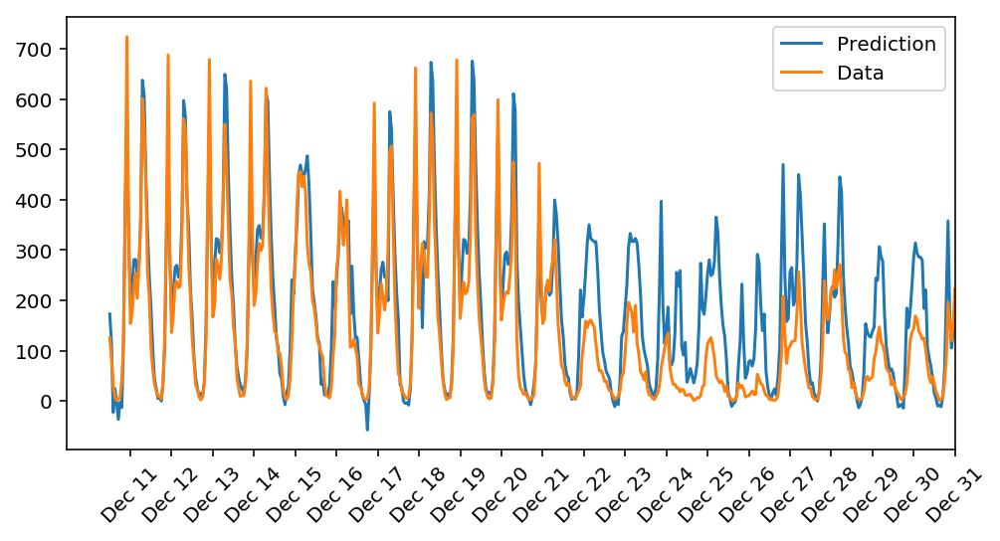

Start train for params iterations:3000,learning_rate:0.50,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.083 ... Validation loss: 0.197

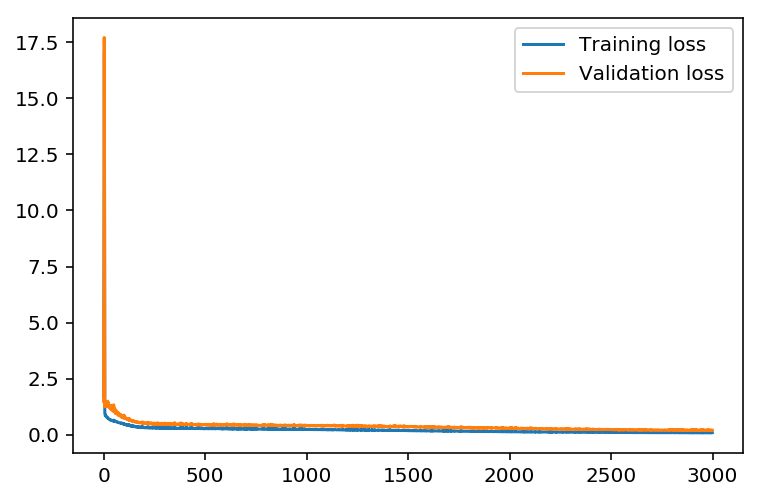

check result for train params: {'iterations': 3000, 'learning_rate': 0.5, 'hidden_nodes': 20}


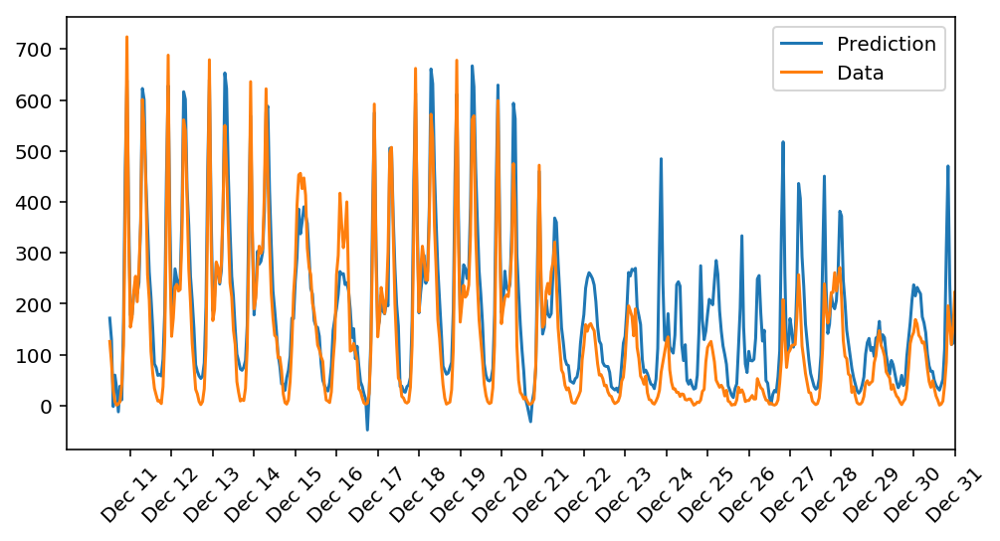

Start train for params iterations:2000,learning_rate:0.70,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.087 ... Validation loss: 0.174

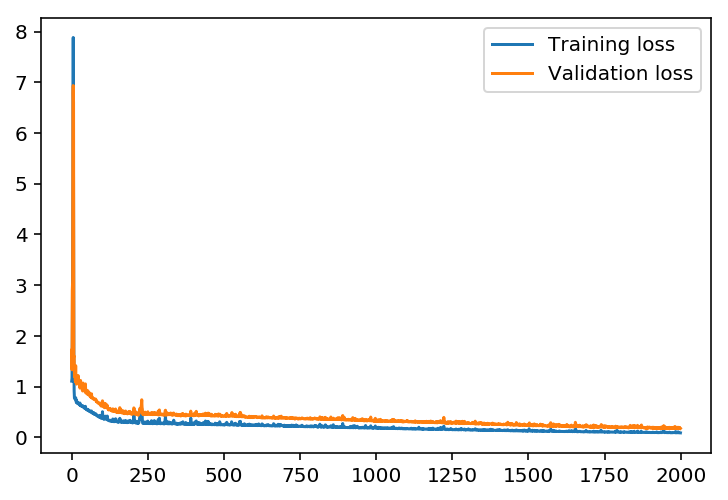

check result for train params: {'iterations': 2000, 'learning_rate': 0.7, 'hidden_nodes': 14}


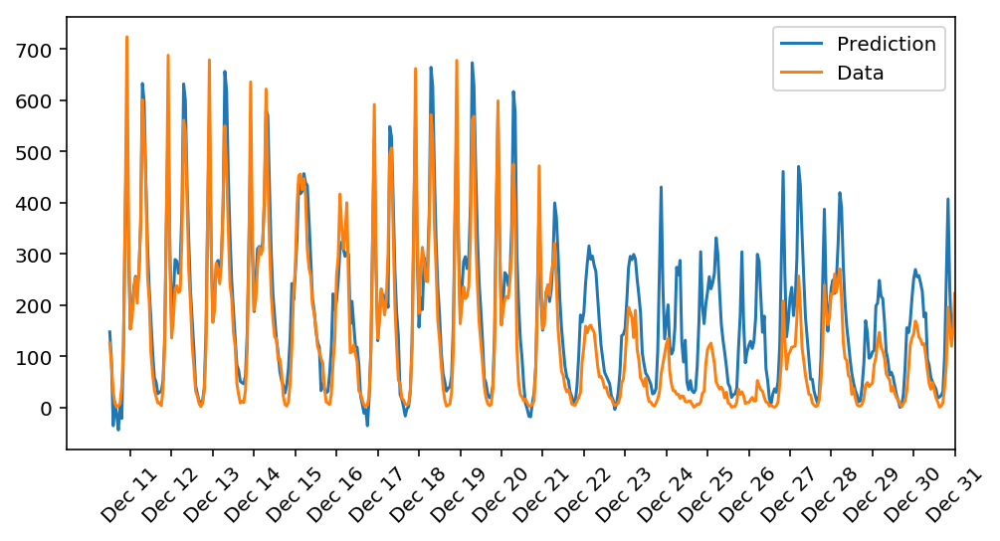

Start train for params iterations:5000,learning_rate:0.30,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.086 ... Validation loss: 0.179

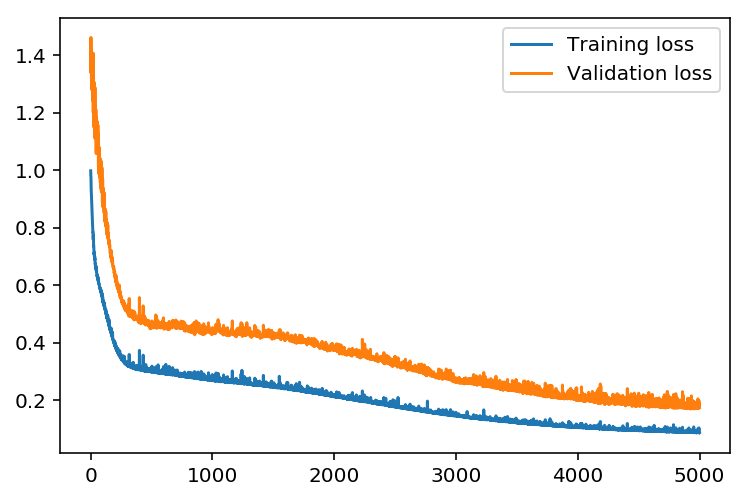

check result for train params: {'iterations': 5000, 'learning_rate': 0.3, 'hidden_nodes': 12}


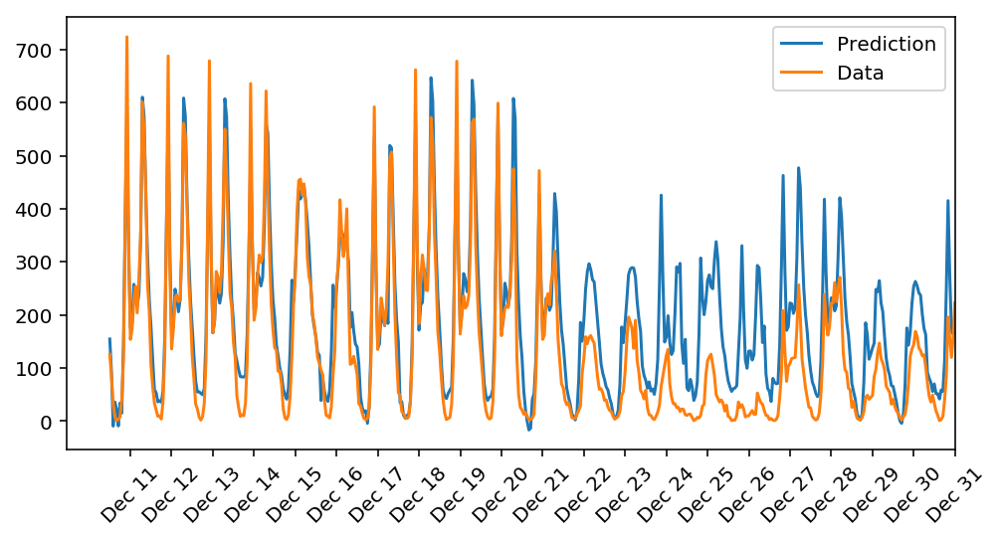

Start train for params iterations:2000,learning_rate:0.70,hidden_nodes:10,output_nodes:1
Progress: 100.0% ... Training loss: 0.087 ... Validation loss: 0.156

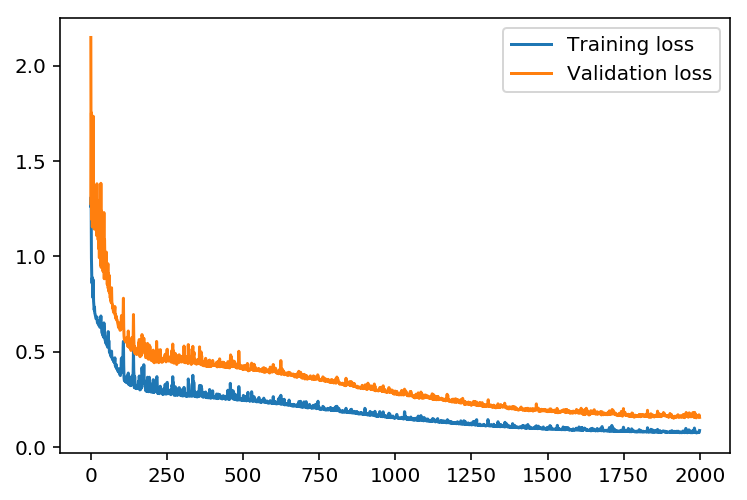

check result for train params: {'iterations': 2000, 'learning_rate': 0.7, 'hidden_nodes': 10}


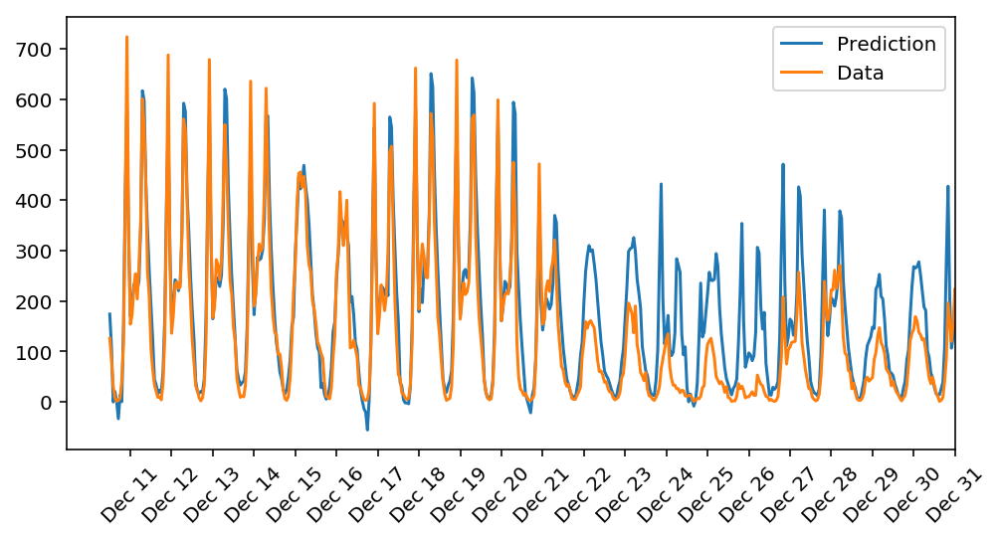

Start train for params iterations:1500,learning_rate:0.70,hidden_nodes:18,output_nodes:1
Progress: 99.9% ... Training loss: 0.116 ... Validation loss: 0.230

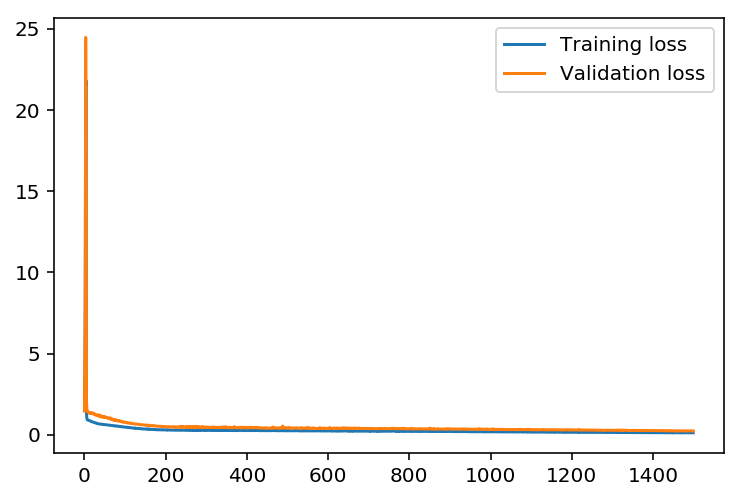

check result for train params: {'iterations': 1500, 'learning_rate': 0.7, 'hidden_nodes': 18}


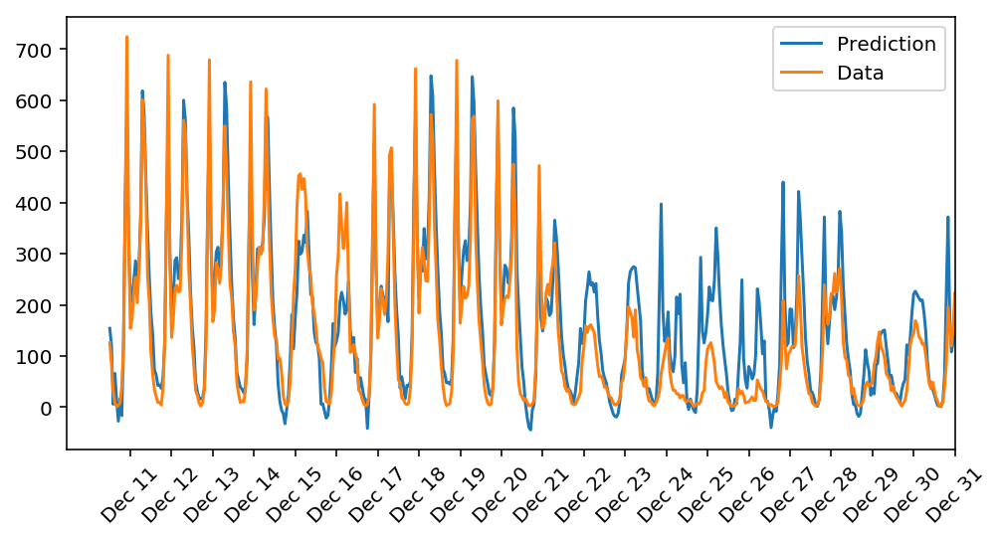

Start train for params iterations:2000,learning_rate:0.90,hidden_nodes:16,output_nodes:1
Progress: 100.0% ... Training loss: 0.098 ... Validation loss: 0.199

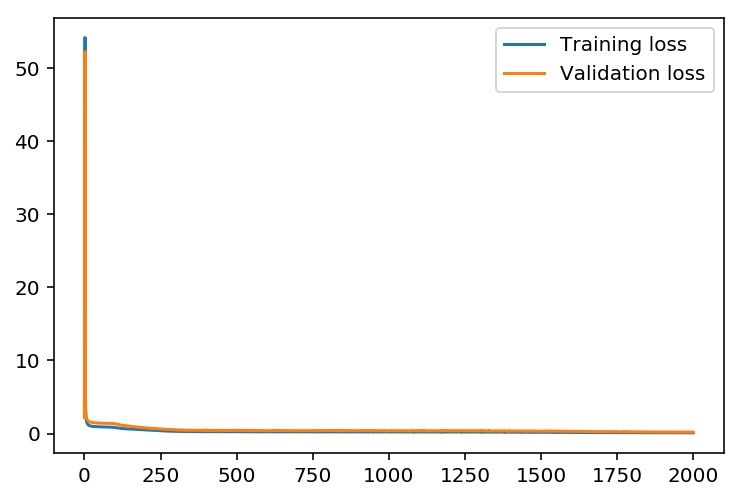

check result for train params: {'iterations': 2000, 'learning_rate': 0.9, 'hidden_nodes': 16}


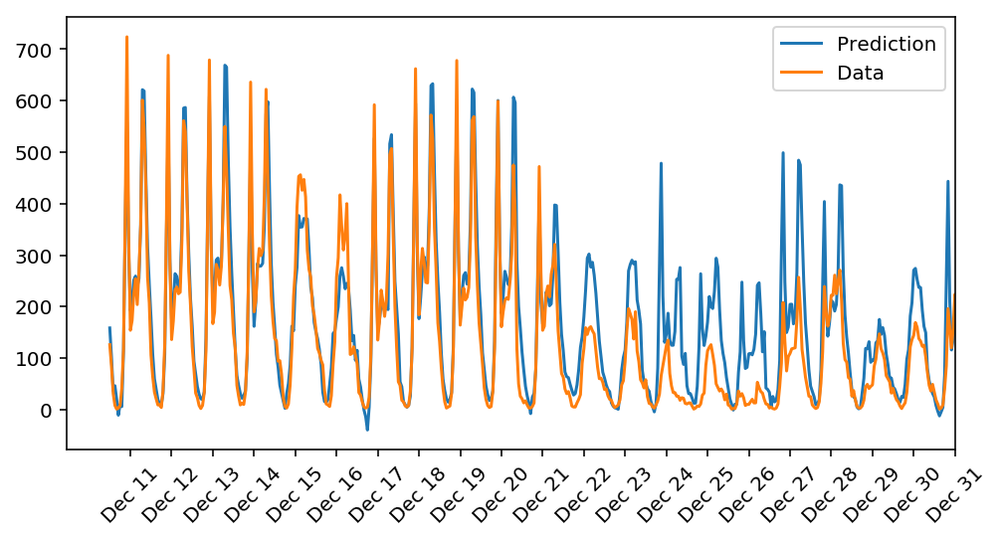

Start train for params iterations:1500,learning_rate:0.70,hidden_nodes:14,output_nodes:1
Progress: 99.9% ... Training loss: 0.115 ... Validation loss: 0.239

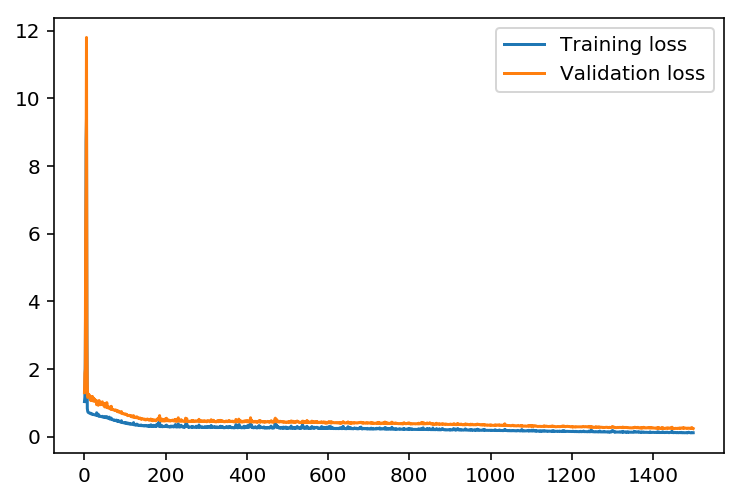

check result for train params: {'iterations': 1500, 'learning_rate': 0.7, 'hidden_nodes': 14}


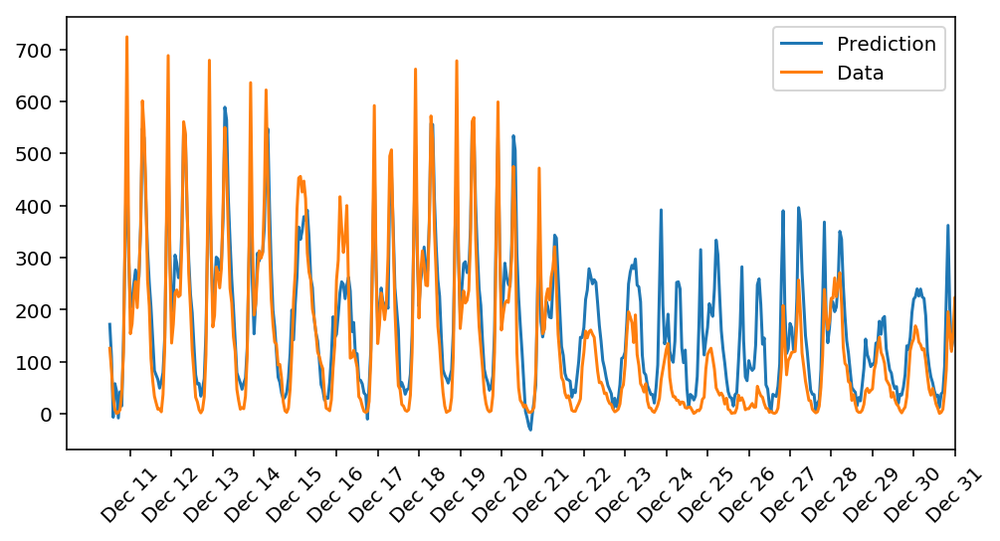

Start train for params iterations:5000,learning_rate:0.30,hidden_nodes:14,output_nodes:1
Progress: 100.0% ... Training loss: 0.089 ... Validation loss: 0.183

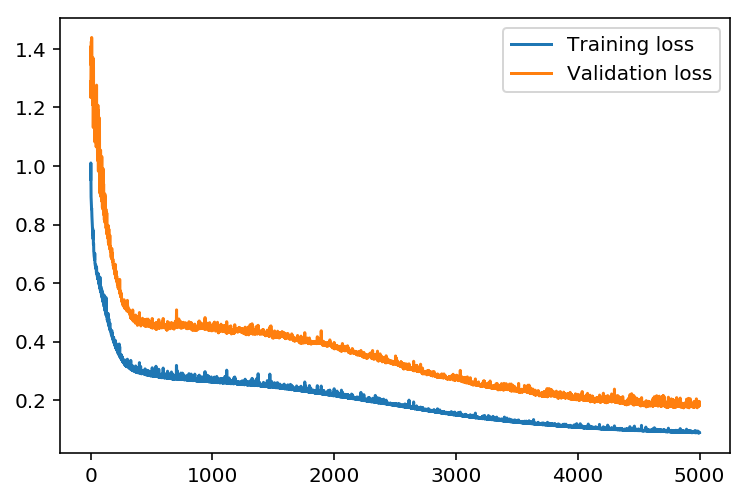

check result for train params: {'iterations': 5000, 'learning_rate': 0.3, 'hidden_nodes': 14}


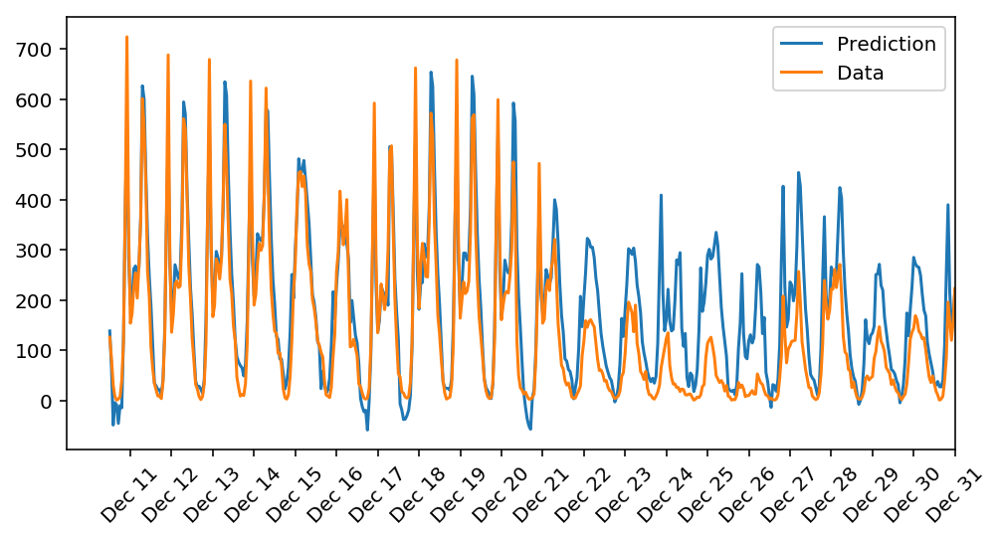

Start train for params iterations:3000,learning_rate:0.50,hidden_nodes:12,output_nodes:1
Progress: 100.0% ... Training loss: 0.101 ... Validation loss: 0.207

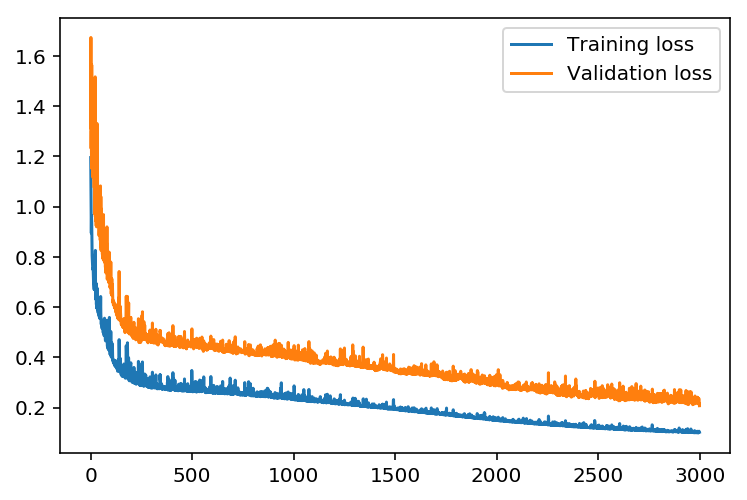

check result for train params: {'iterations': 3000, 'learning_rate': 0.5, 'hidden_nodes': 12}


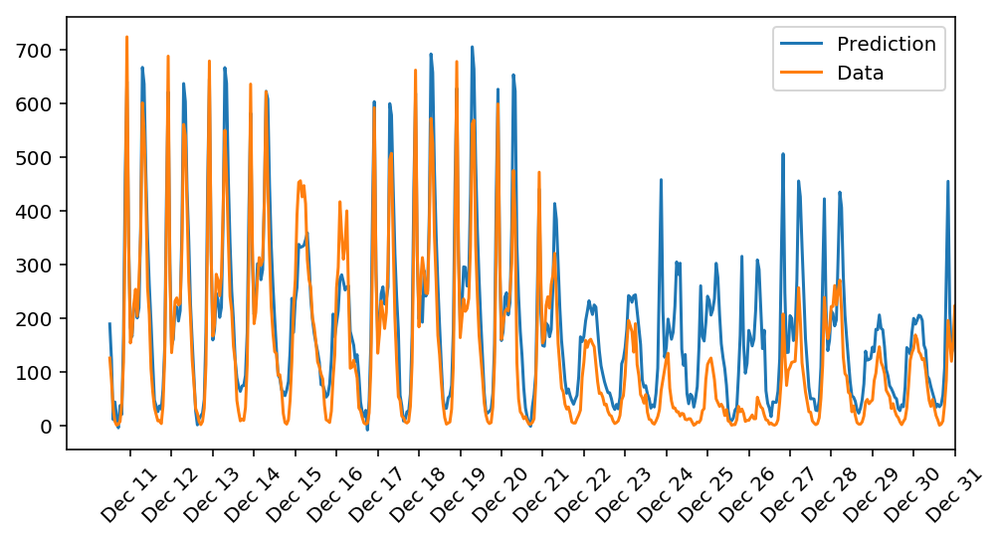

Start train for params iterations:3000,learning_rate:0.90,hidden_nodes:20,output_nodes:1
Progress: 100.0% ... Training loss: 0.077 ... Validation loss: 0.150

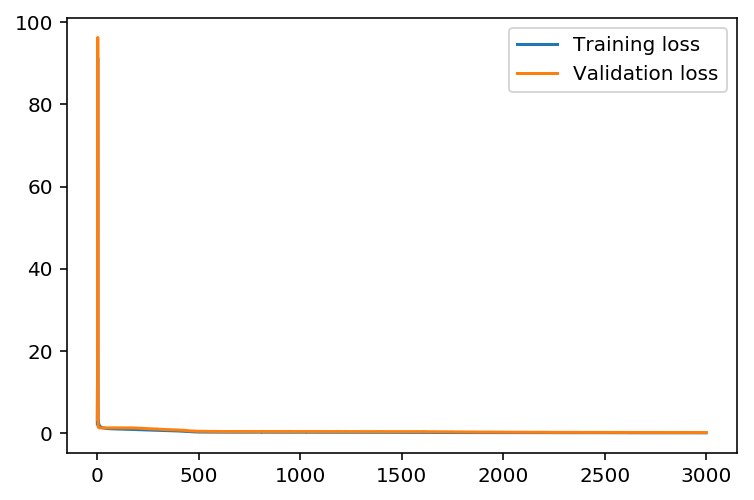

check result for train params: {'iterations': 3000, 'learning_rate': 0.9, 'hidden_nodes': 20}


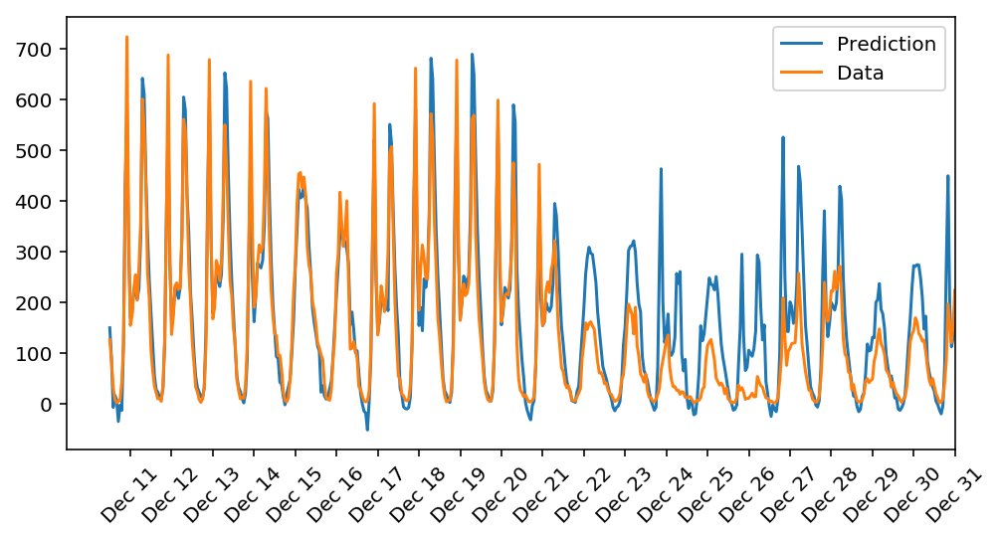

Start train for params iterations:1500,learning_rate:0.70,hidden_nodes:16,output_nodes:1
Progress: 99.9% ... Training loss: 0.104 ... Validation loss: 0.232

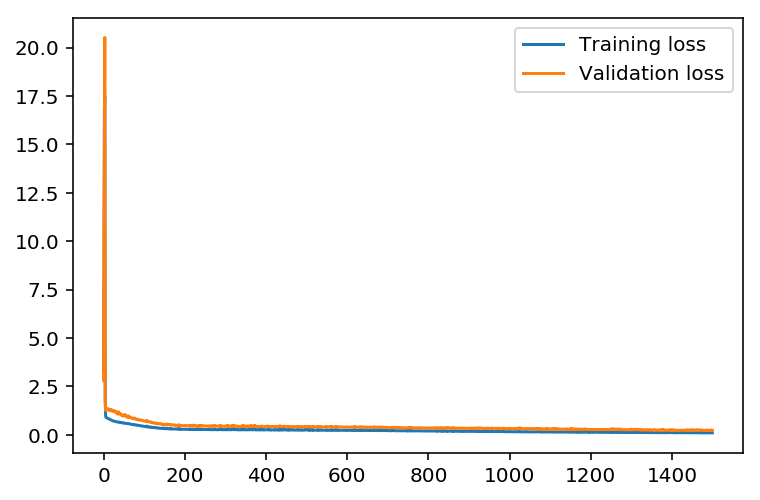

check result for train params: {'iterations': 1500, 'learning_rate': 0.7, 'hidden_nodes': 16}


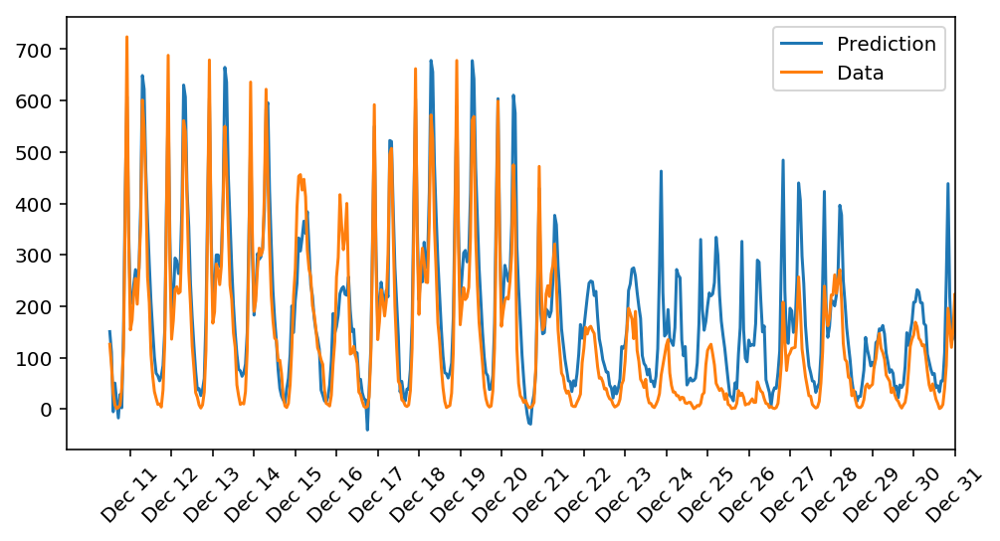

In [222]:
param_list = [{'iterations': 2000, 'learning_rate': 0.7, 'hidden_nodes': 16},\
    {'iterations': 1500, 'learning_rate': 0.9, 'hidden_nodes': 14},\
    {'iterations': 1500, 'learning_rate': 0.9, 'hidden_nodes': 12},\
    {'iterations': 2000, 'learning_rate': 0.7, 'hidden_nodes': 20},\
    {'iterations': 3000, 'learning_rate': 0.5, 'hidden_nodes': 20},\
    {'iterations': 2000, 'learning_rate': 0.7, 'hidden_nodes': 14},\
    {'iterations': 5000, 'learning_rate': 0.3, 'hidden_nodes': 12},\
    {'iterations': 2000, 'learning_rate': 0.7, 'hidden_nodes': 10},\
    {'iterations': 1500, 'learning_rate': 0.7, 'hidden_nodes': 18},\
    {'iterations': 2000, 'learning_rate': 0.9, 'hidden_nodes': 16},\
    {'iterations': 1500, 'learning_rate': 0.7, 'hidden_nodes': 14},\
    {'iterations': 5000, 'learning_rate': 0.3, 'hidden_nodes': 14},\
    {'iterations': 3000, 'learning_rate': 0.5, 'hidden_nodes': 12},\
    {'iterations': 3000, 'learning_rate': 0.9, 'hidden_nodes': 20},\
    {'iterations': 1500, 'learning_rate': 0.7, 'hidden_nodes': 16}\
]

for param in param_list:
    result = grid_search(param['iterations'],param['learning_rate'],param['hidden_nodes'])
    print("check result for train params:", param)
    check_network(result['network'])
    


## 可选：思考下你的结果（我们不会评估这道题的答案）

 
请针对你的结果回答以下问题。模型对数据的预测效果如何？哪里出现问题了？为何出现问题呢？

> **注意**：你可以通过双击该单元编辑文本。如果想要预览文本，请按 Control + Enter

#### 请将你的答案填写在下方

#### 关于学习率
- 学习率越大，模型训练时收敛的越快，可以从图看出，模型只需要经过很少次数的迭代就可以收敛，后期的迭代收敛速度变慢，但是到后期又有一个收敛过程，可以看出来较大的学习率相当于在梯度方向加冲量，让模型有机会到达全局最优解；同时大的学习率会让模型的收敛过程，出现来回震荡，所以可以看到图中有部分毛刺出现。
- 学习率越小，模型训练的收敛过程是逐渐收敛，同时loss图也显示的比较平滑，到后期因为下降方向上的值不够大，所以有时候会落入一个局部最优值得点左右摆动

#### 关于迭代次数
- 小的迭代次数训练速度快，但是因为模型可能还没有达到最优解，就停止了，所以会出现欠拟合
- 大的迭代次数训练速度慢，模型可以到达最优解，但是如果过大，就会出现过拟合，或者是出现来回震荡
> 如果可以，其实应该各一个阈值，当错误率连续变化量都小于这个阈值的时候就停止迭代，防止过拟合

#### 关于节点数
- 其实节点数的大小选择也是一个balance的问题，过多的节点数训练计算量大而且拟合程度太强，容易出现过拟合
- 而过小的节点数，虽然训练快，但是可以自动编码拟合出来的特征组合少，也就是能从数据中得到的有用深度浅，容易欠拟合

#### 关于预测效果
- 几乎尝试的几个模型中，对22~29号这几天的数据拟合的都不是太好。不过整体上0.1的MSE已经比我之前用LR模型训练的模型效果好了很多。
- 深度学习模型通过中间节点的转换来自动编码拟合更多的特征真的非常棒，但是较LR模型的缺点就是不知道怎么解释到底是哪一个特征起到了作用。

